In [1]:
from IPython.display import HTML
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
The raw code for this IPython notebook is by default hidden for easier reading.
To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [3]:
from IPython.display import display, HTML

display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

{0.5: {40: 77, 140: 18, 60: 93, 160: 8, 180: 8, 120: 20, 200: 7, 100: 25, 80: 39, 220: 3, 320: 1, 240: 1, 280: 2}, 0.9: {100: 48, 120: 17, 60: 88, 80: 44, 40: 62, 160: 9, 220: 3, 180: 5, 260: 1, 140: 14, 300: 1, 200: 2, 280: 3, 340: 1}}
{0.9: {100: 19, 60: 19, 40: 11, 80: 18, 140: 4, 180: 1, 300: 1, 200: 1, 120: 5, 280: 1, 160: 1, 220: 1}}
{0.4: 74, 0.7: 59, 0.05: 51, 0.1: 60, 0.6: 56, 0.2: 41, 0.9: 67, 0.5: 57, 0.8: 59, 0.3: 76}
{10: {0.7: 16, 0.6: 5, 0.9: 17, 0.8: 15, 0.5: 1}, 30: {0.7: 18, 0.6: 7, 0.9: 33, 0.8: 23, 0.5: 1}, 60: {0.7: 20, 0.6: 9, 0.9: 41, 0.8: 29, 0.5: 1}, 100: {0.7: 22, 0.6: 10, 0.9: 43, 0.8: 31, 0.5: 2}}


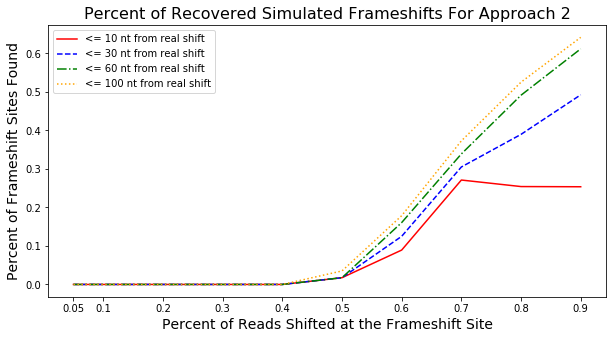

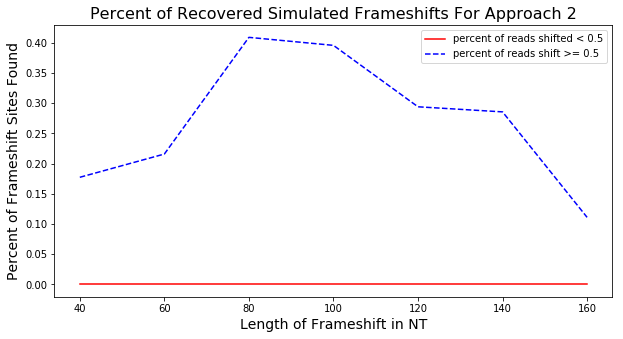

In [26]:
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.pyplot import subplot


infoFile = open("output/all_jan2014_25_to_32_starts_simulated_shifts_info", "r")
inFile = open("output/all_jan2014_25_to_32_starts_with_simulated_shifts_with_found_frameshifts", "r")

shift_percents_total = dict()
shift_lengths_total = dict()
shift_info_dict = dict()
for line in infoFile:
    cs = line.strip().split(",")
    gene = cs[0]
    shift_start = int(cs[1])
    shift_end = int(cs[2])
    direction = int(cs[3])
    percent = float(cs[4])
    #if (percent == '0.9'):
    shift_info_dict[gene] = dict()
    shift_info_dict[gene]["shift_start"] = shift_start
    shift_info_dict[gene]["shift_end"] = shift_end
    shift_info_dict[gene]["direction"] = direction
    shift_info_dict[gene]["percent"] = percent
    if percent not in shift_percents_total:
        shift_percents_total[percent] = 0
    shift_percents_total[percent] += 1
    # use floor division
    length_of_frameshift = ((shift_end-shift_start)//20)*20
    if percent < 0.5:
        percent = 0.5
    else:
        percent = 0.9
    
    if percent not in shift_lengths_total:
        shift_lengths_total[percent] = dict()
    if length_of_frameshift not in shift_lengths_total[percent]:
        shift_lengths_total[percent][length_of_frameshift] = 0
    shift_lengths_total[percent][length_of_frameshift] += 1
        
print(shift_lengths_total)
infoFile.close()
import numpy as np

p_value_dict = dict()
all_info_dict = dict()
shift_percents_found = dict()
shift_lengths_found = dict()
distances = [10, 30, 60, 100]
legend_labels = []
for dist in distances:
    shift_percents_found[dist] = dict()
    legend_labels.append("<= " + str(dist) + " nt from real shift")

for line in inFile:
    Info_string = line.strip()
    letters = inFile.readline().rstrip("\n").split(" ")
    reads_1 = inFile.readline().rstrip("\n").split(" ")
    reads_2 = inFile.readline().rstrip("\n").split(" ")
    percents = inFile.readline().rstrip("\n").split(",")
    percents = [float(x) for x in percents]
    blank = inFile.readline()
    gene_name = Info_string.split("\t")[0].split(" ")[1]
    p_value  = float(Info_string.split("\t")[1].split(" ")[1])
    p_value_dict[gene_name] = p_value
    all_info_dict[gene_name] = dict()
    all_info_dict[gene_name]["letters"] = letters
    all_info_dict[gene_name]["read_1"] = reads_1
    all_info_dict[gene_name]["read_2"] = reads_2
    all_info_dict[gene_name]["percents"] = percents
    all_info_dict[gene_name]["Info_string"] = Info_string

    
    if (gene_name in shift_info_dict):
        detected_shift = int(Info_string.split("\t")[3].split(" ")[1])
        detected_shift_end = detected_shift + int(Info_string.split("\t")[4].split(" ")[1])
        
        real_shift = shift_info_dict[gene_name]["shift_start"]
        real_shift_end = shift_info_dict[gene_name]["shift_end"]
        
        for dist in distances:
            if (abs(detected_shift-real_shift) <= dist and abs(detected_shift_end-real_shift_end) <= dist):
                percent = shift_info_dict[gene_name]["percent"]
                if percent not in shift_percents_found[dist]:
                    shift_percents_found[dist][percent] = 0
                shift_percents_found[dist][percent] +=1 
        
        # do lengths statistics for detection level of 30
        if (abs(detected_shift-real_shift) <= 30 and abs(detected_shift_end-real_shift_end) <= 30):
            percent = shift_info_dict[gene_name]["percent"]
            if percent < 0.5:
                percent = 0.5
            else:
                percent = 0.9
            
            length_of_frameshift = ((real_shift_end-real_shift)//20)*20
            if percent not in shift_lengths_found:
                shift_lengths_found[percent] = dict()
            if length_of_frameshift not in shift_lengths_found[percent]:
                shift_lengths_found[percent][length_of_frameshift] = 0
            shift_lengths_found[percent][length_of_frameshift] += 1    

inFile.close()
print(shift_lengths_found)
import matplotlib.pyplot as plt
plt.figure(1, figsize=(10, 5))
xs = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
colors = ["red", "blue" , "green", "orange"]
linestyles = ['-', '--', '-.', ':']
n = 0
for dist in distances:
    ys = []
    for x in xs:
        if (x in shift_percents_found[dist]):
            ys.append(shift_percents_found[dist][x]/shift_percents_total[x])
        else:
            ys.append(0.0)
    plt.plot(xs, ys, c=colors[n],linestyle=linestyles[n])
    n += 1
plt.title('Percent of Recovered Simulated Frameshifts For Approach 2',fontsize=16)
plt.xlabel('Percent of Reads Shifted at the Frameshift Site',fontsize=14)
plt.xticks(xs, xs)
plt.ylabel('Percent of Frameshift Sites Found',fontsize=14)
plt.legend(legend_labels)
print(shift_percents_total)
print(shift_percents_found)

plt.figure(2, figsize=(10, 5))
xs = [40, 60, 80, 100, 120, 140, 160]
n = 0
for percent in [0.5, 0.9]:
    ys = []
    for x in xs:
        if (percent in shift_lengths_found and x in shift_lengths_found[percent]):
            ys.append(shift_lengths_found[percent][x]/shift_lengths_total[percent][x])
        else:
            ys.append(0.0)
    plt.plot(xs, ys, c=colors[n],linestyle=linestyles[n])
    n += 1
plt.title('Percent of Recovered Simulated Frameshifts For Approach 2',fontsize=16)
plt.xlabel('Length of Frameshift in NT',fontsize=14)
plt.xticks(xs, xs)
plt.ylabel('Percent of Frameshift Sites Found',fontsize=14)
plt.legend(["percent of reads shifted < 0.5", "percent of reads shift >= 0.5"])


# For Approach 2
## p-value threshold 1*10^-4
## 82 out of 600  simulated frameshifts recovered
## 80 other (including YIL009C-A and YOR239W) frameshifts found

In [5]:
print(len(shift_info_dict))
print(len(all_info_dict))
print(shift_percents_total)
print(shift_percents_found)

600
162
{0.4: 74, 0.7: 59, 0.05: 51, 0.1: 60, 0.6: 56, 0.2: 41, 0.9: 67, 0.5: 57, 0.8: 59, 0.3: 76}
{0.7: 18, 0.6: 7, 0.9: 33, 0.8: 23, 0.5: 1}


Gene: YAL035W	p-value: 2.568739617795228e-09	gene-length: 3010	shift-start-position: 780	shift-length 110
Simulated Percent: 0.7


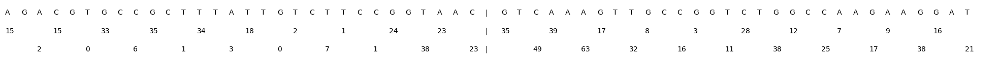

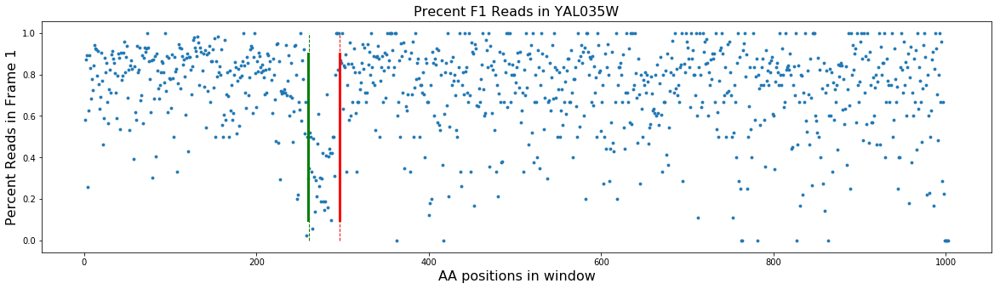


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBL045C	p-value: 2.5039844139109172e-11	gene-length: 1375	shift-start-position: 225	shift-length 116
Simulated Percent: 0.6


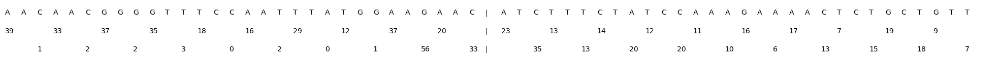

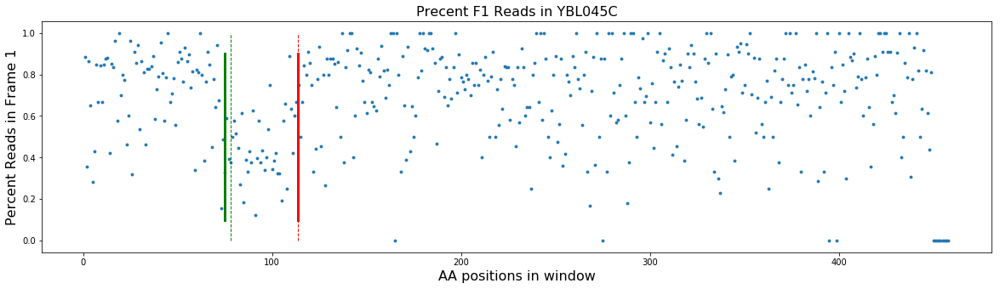


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBL041W	p-value: 1.4525886731834649e-09	gene-length: 727	shift-start-position: 285	shift-length 113
Simulated Percent: 0.9


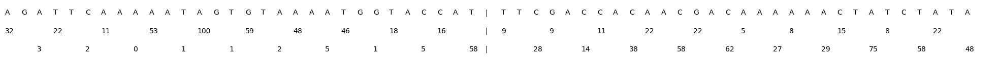

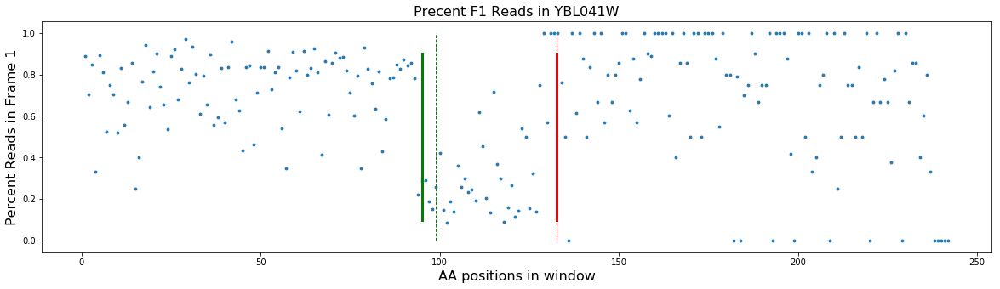


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR009C	p-value: 3.761422731973093e-08	gene-length: 313	shift-start-position: 195	shift-length 76
Simulated Percent: 0.9


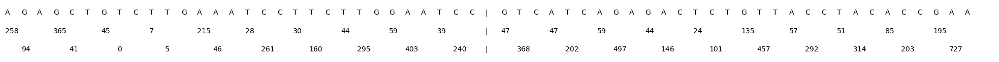

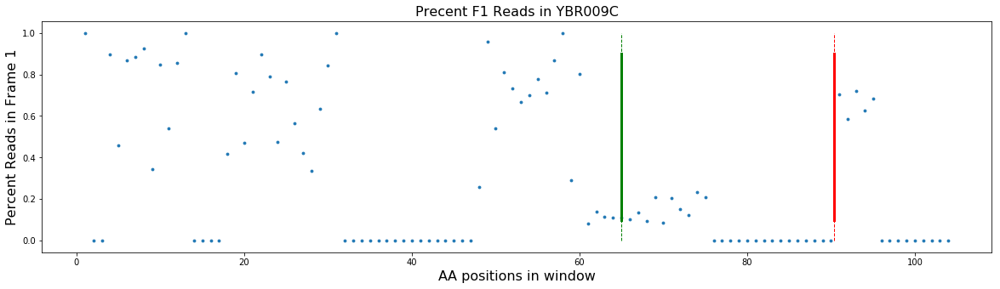


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR010W	p-value: 1.4687656475747248e-06	gene-length: 412	shift-start-position: 204	shift-length 43
Simulated Percent: 0.6


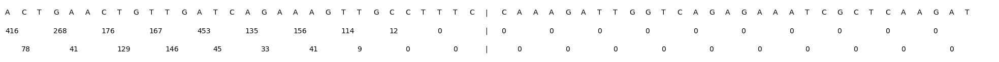

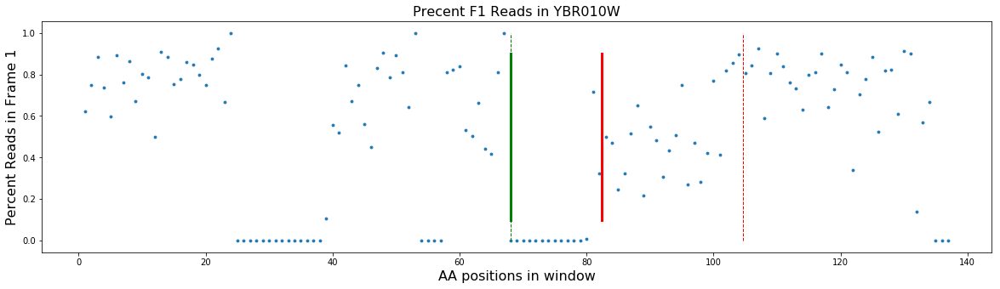


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR058C-A	p-value: 4.394739725329249e-05	gene-length: 244	shift-start-position: 96	shift-length 52
Simulated Percent: 0.8


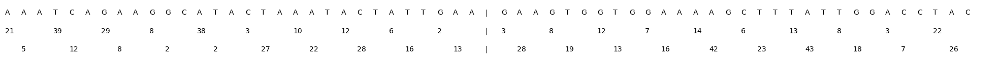

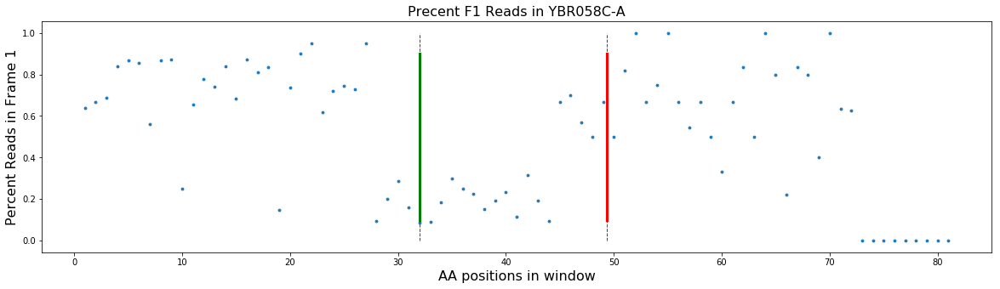


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR143C	p-value: 1.5595764060298088e-70	gene-length: 1315	shift-start-position: 774	shift-length 89
Simulated Percent: 0.9


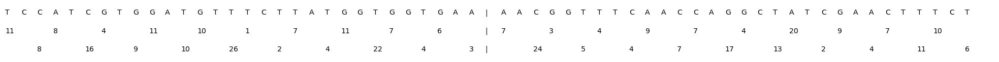

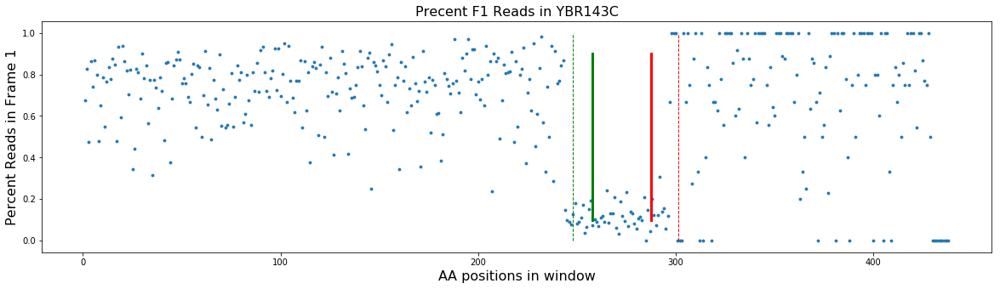


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR149W	p-value: 3.851708850644096e-06	gene-length: 1036	shift-start-position: 255	shift-length 86
Simulated Percent: 0.7


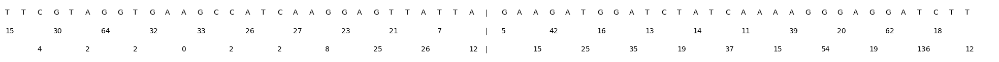

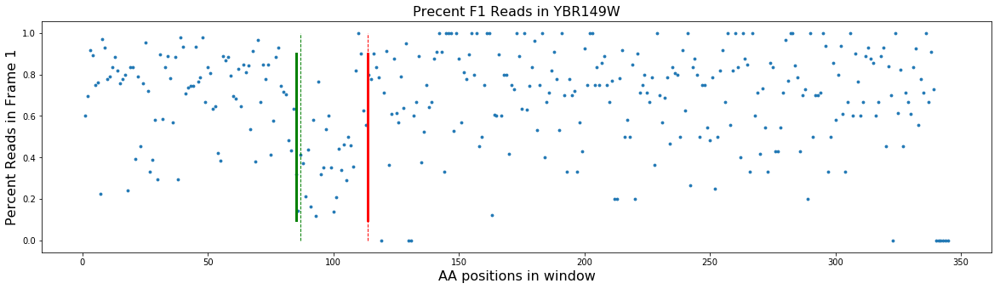


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR286W	p-value: 4.527534090900858e-33	gene-length: 1615	shift-start-position: 675	shift-length 35
Simulated Percent: 0.9


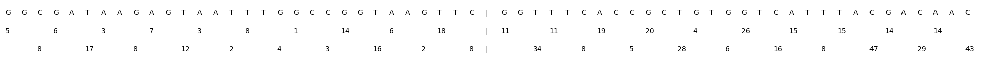

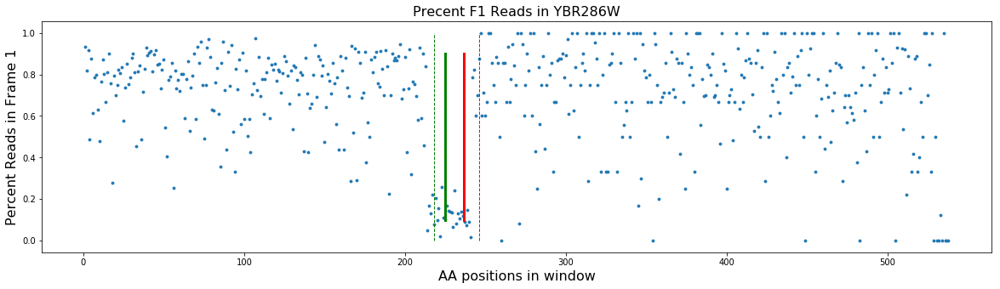


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YCL050C	p-value: 2.985306667895903e-08	gene-length: 967	shift-start-position: 414	shift-length 80
Simulated Percent: 0.9


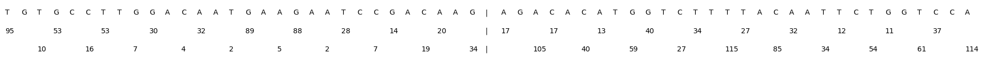

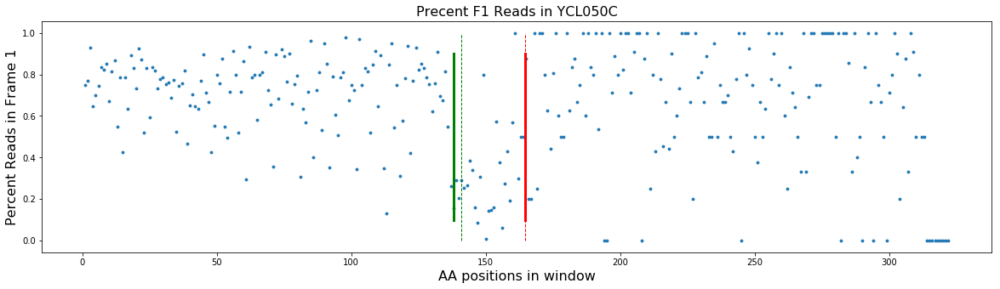


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YCR004C	p-value: 7.872664248673021e-18	gene-length: 745	shift-start-position: 171	shift-length 139
Simulated Percent: 0.9


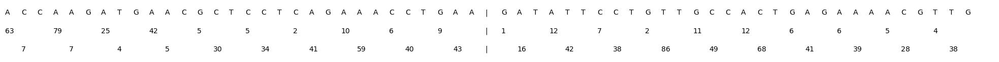

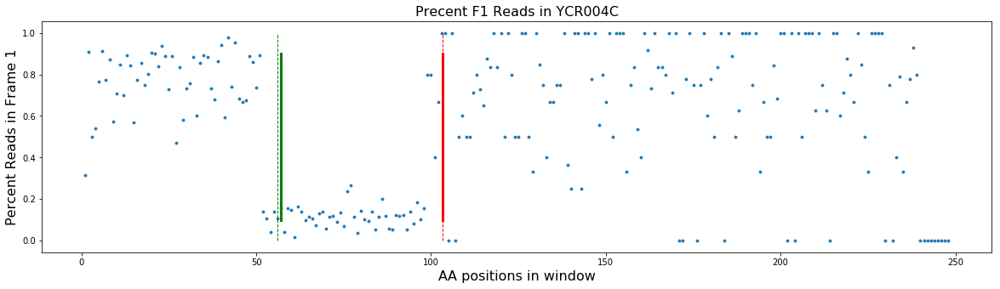


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL208W	p-value: 1.9709157943054794e-06	gene-length: 472	shift-start-position: 300	shift-length 83
Simulated Percent: 0.7


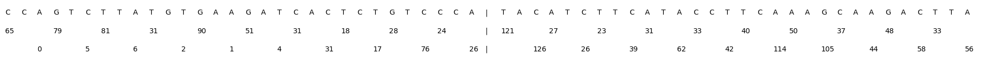

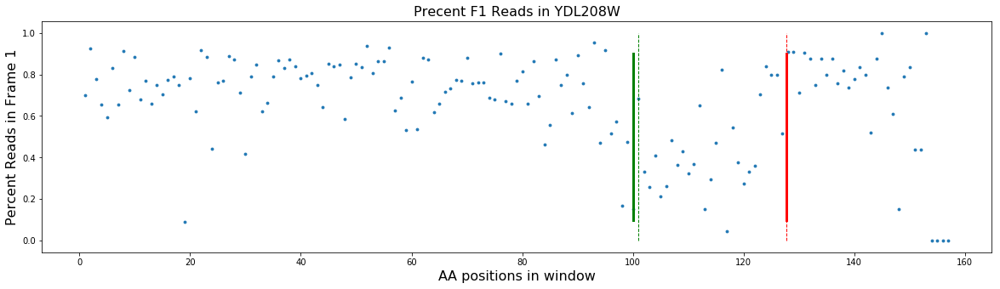


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL055C	p-value: 2.0054471320258922e-13	gene-length: 1087	shift-start-position: 621	shift-length 79
Simulated Percent: 0.6


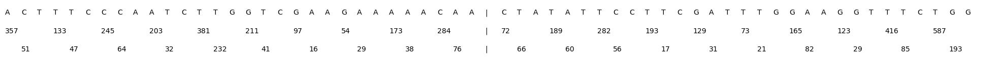

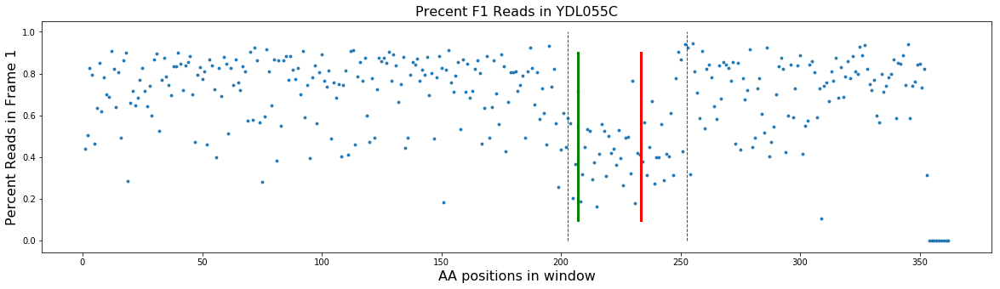


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL014W	p-value: 6.0804288939174015e-05	gene-length: 985	shift-start-position: 531	shift-length 58
Simulated Percent: 0.9


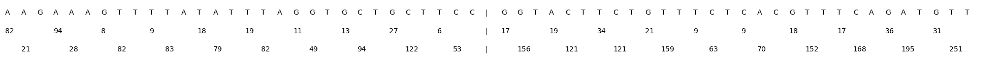

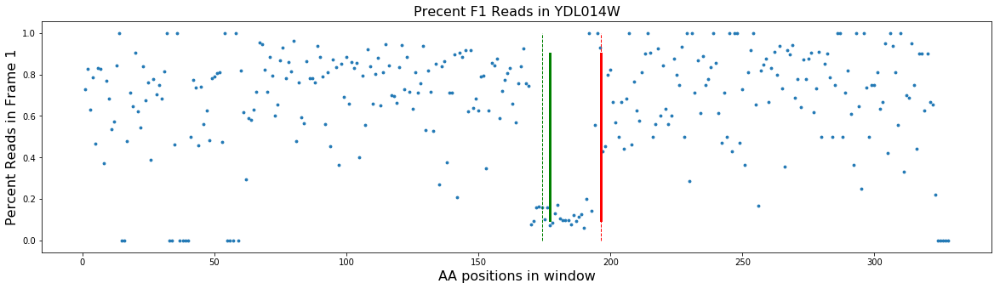


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR098C	p-value: 2.4413026309906502e-05	gene-length: 859	shift-start-position: 66	shift-length 82
Simulated Percent: 0.9


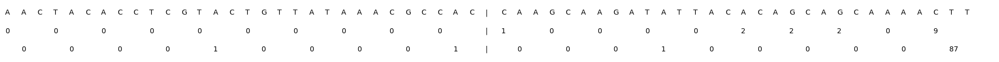

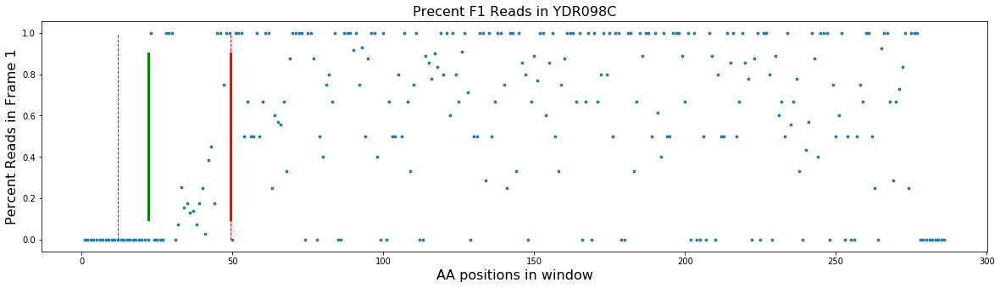


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR233C	p-value: 3.6003433655285124e-07	gene-length: 889	shift-start-position: 384	shift-length 74
Simulated Percent: 0.8


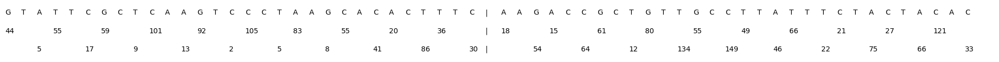

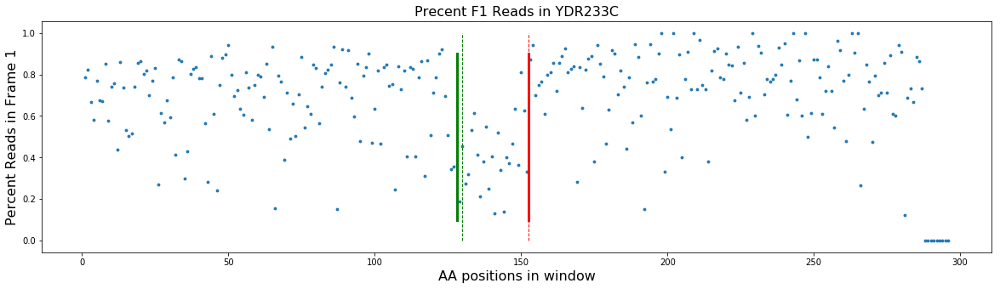


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR429C	p-value: 1.4683640834238213e-30	gene-length: 826	shift-start-position: 630	shift-length 41
Simulated Percent: 0.9


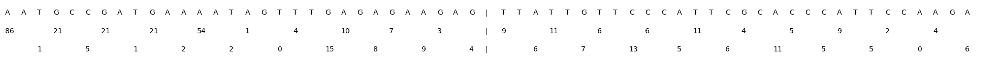

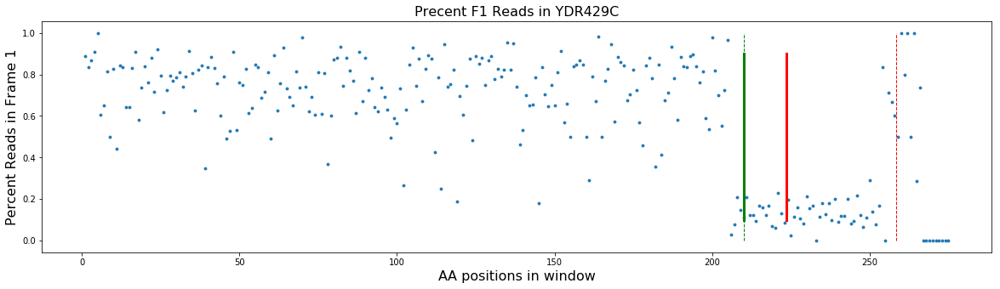


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR529C	p-value: 4.0959508258201235e-09	gene-length: 385	shift-start-position: 225	shift-length 104
Simulated Percent: 0.9


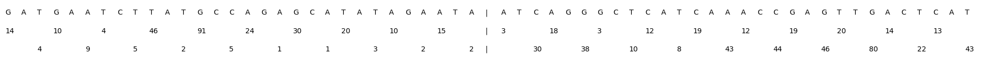

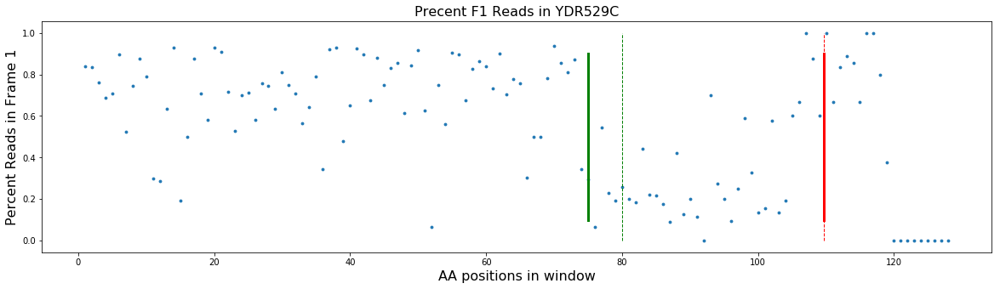


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YEL027W	p-value: 2.287857892215029e-16	gene-length: 484	shift-start-position: 135	shift-length 200
Simulated Percent: 0.9


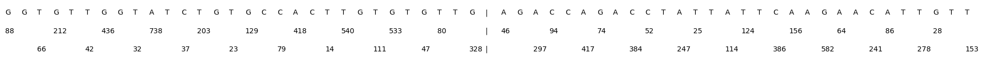

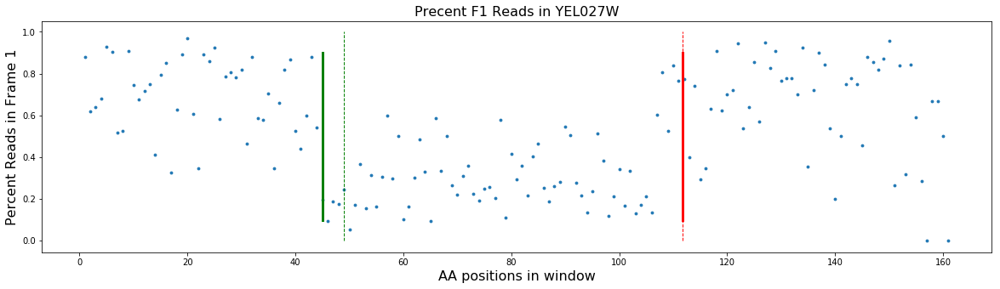


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YEL002C	p-value: 1.667802796169485e-06	gene-length: 1294	shift-start-position: 849	shift-length 77
Simulated Percent: 0.8


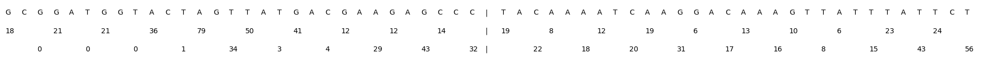

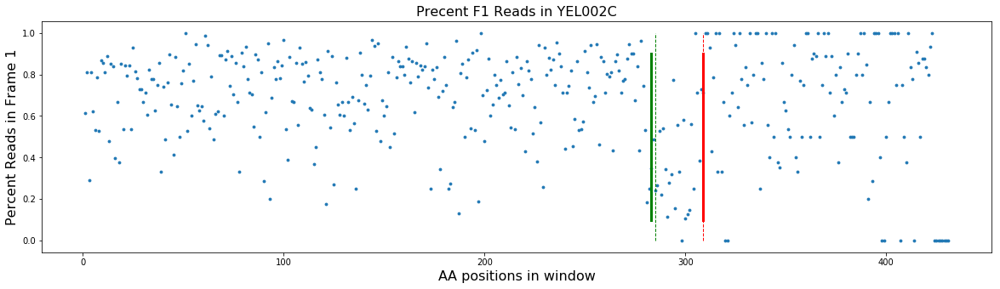


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER056C	p-value: 6.266442977988664e-05	gene-length: 1603	shift-start-position: 900	shift-length 83
Simulated Percent: 0.7


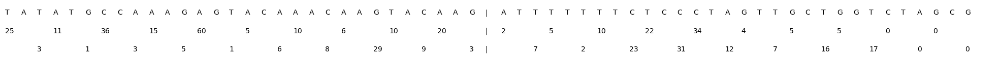

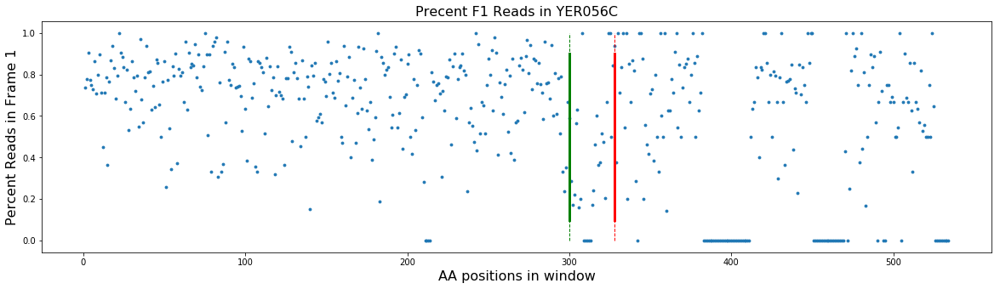


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER072W	p-value: 6.0962018806060005e-05	gene-length: 391	shift-start-position: 315	shift-length 37
Simulated Percent: 0.6


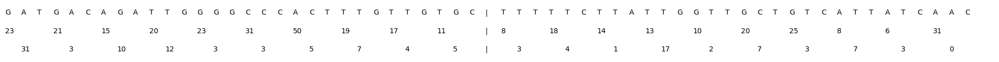

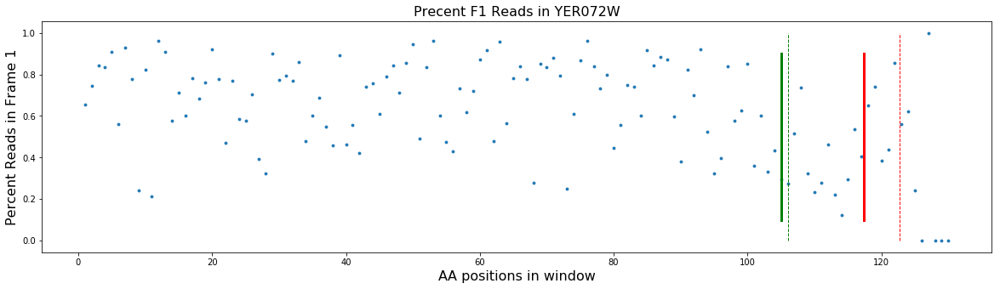


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER087C-B	p-value: 1.4802494477035692e-07	gene-length: 250	shift-start-position: 138	shift-length 86
Simulated Percent: 0.8


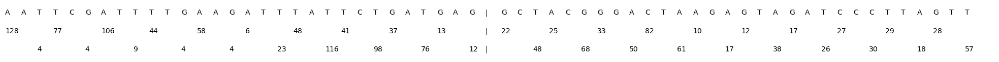

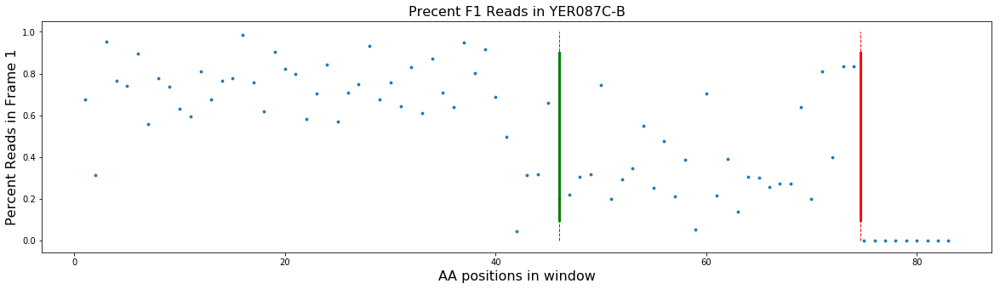


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER091C	p-value: 1.6700860200989763e-72	gene-length: 2305	shift-start-position: 1167	shift-length 310
Simulated Percent: 0.9


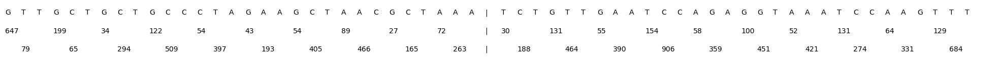

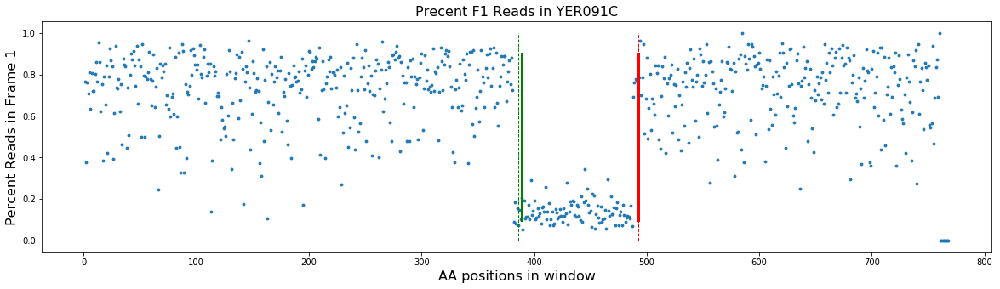


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER110C	p-value: 4.142501512667012e-09	gene-length: 3343	shift-start-position: 828	shift-length 88
Simulated Percent: 0.6


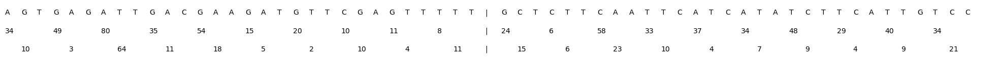

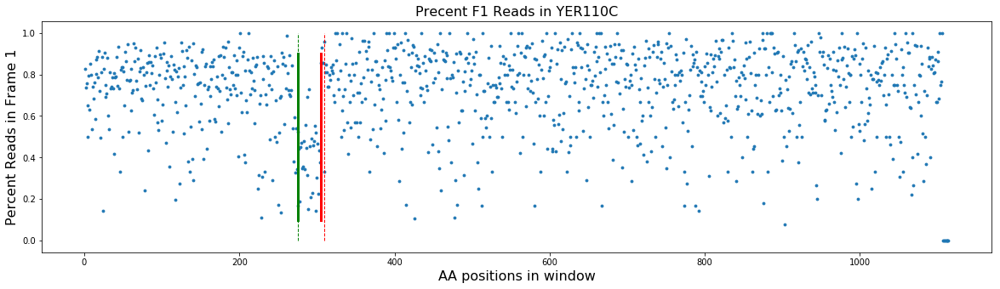


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER145C	p-value: 3.301018704895401e-08	gene-length: 1216	shift-start-position: 852	shift-length 73
Simulated Percent: 0.7


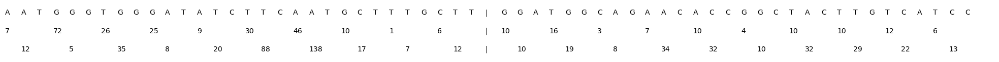

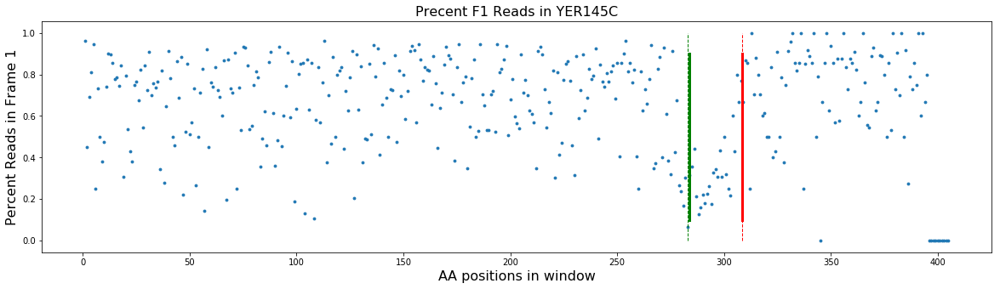


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER156C	p-value: 2.550657464441772e-35	gene-length: 1018	shift-start-position: 390	shift-length 38
Simulated Percent: 0.8


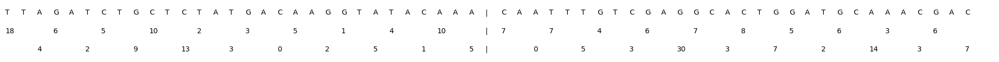

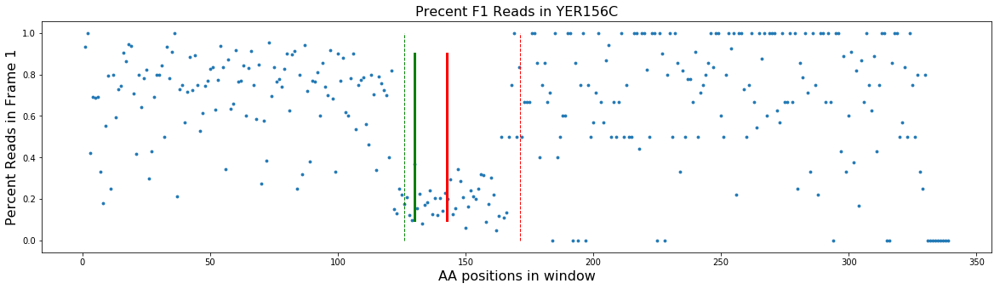


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER177W	p-value: 6.861480040859834e-09	gene-length: 805	shift-start-position: 153	shift-length 47
Simulated Percent: 0.8


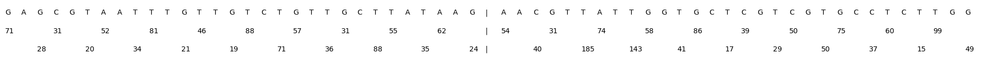

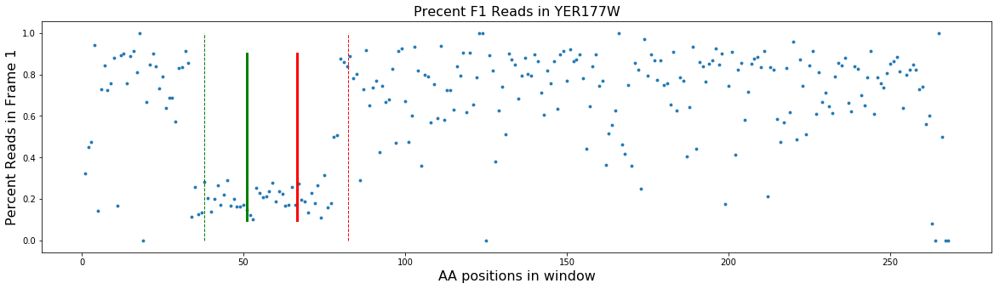


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER178W	p-value: 6.262380851057123e-20	gene-length: 1264	shift-start-position: 336	shift-length 100
Simulated Percent: 0.8


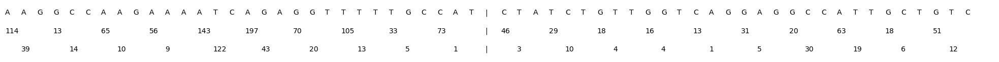

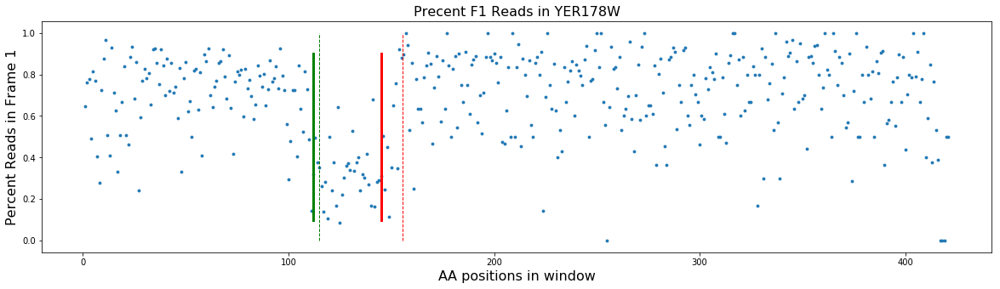


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YFR004W	p-value: 1.376037761482582e-13	gene-length: 922	shift-start-position: 324	shift-length 38
Simulated Percent: 0.7


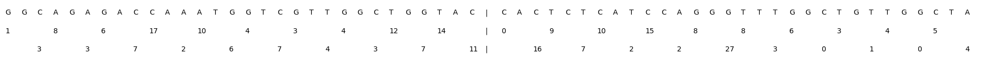

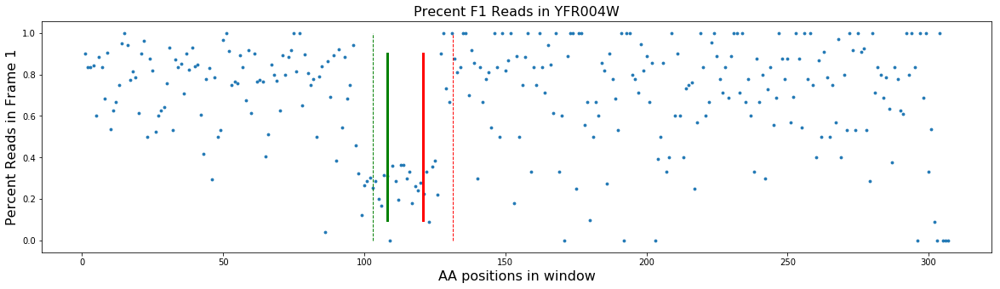


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YFR044C	p-value: 2.658410530588338e-10	gene-length: 1447	shift-start-position: 897	shift-length 119
Simulated Percent: 0.7


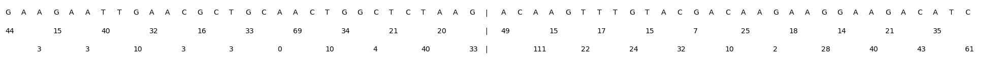

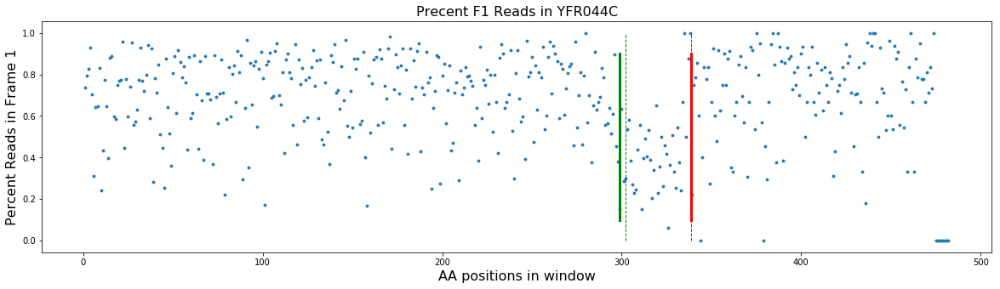


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YFR050C	p-value: 8.999521381153321e-14	gene-length: 802	shift-start-position: 498	shift-length 64
Simulated Percent: 0.9


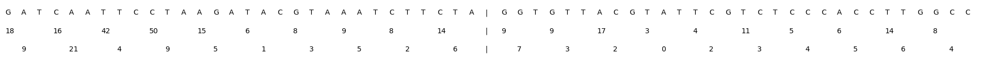

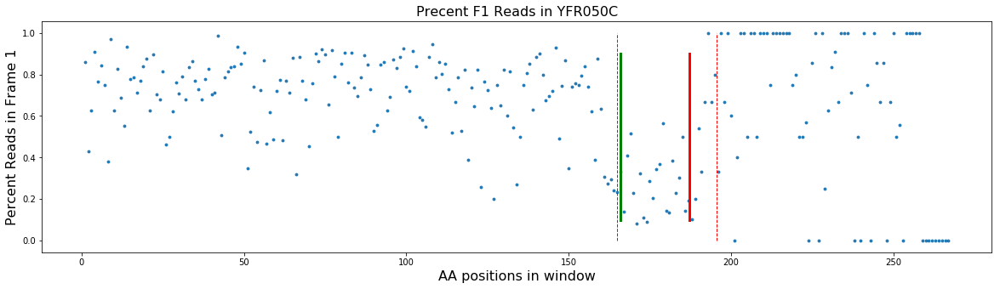


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL256W	p-value: 3.4850720532428454e-09	gene-length: 1150	shift-start-position: 945	shift-length 80
Simulated Percent: 0.8


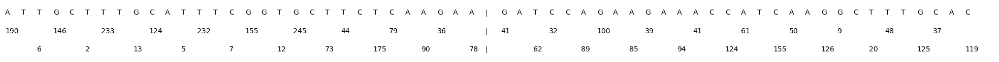

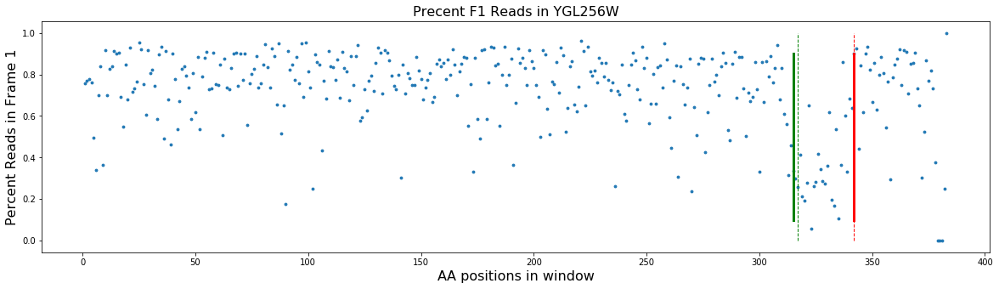


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL255W	p-value: 7.796776993585157e-07	gene-length: 1132	shift-start-position: 654	shift-length 77
Simulated Percent: 0.7


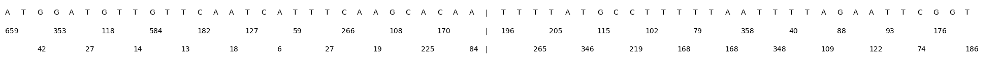

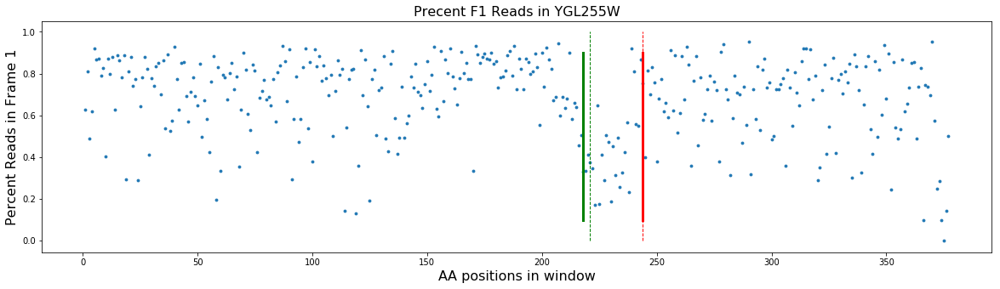


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL225W	p-value: 9.545226537678173e-14	gene-length: 1015	shift-start-position: 180	shift-length 203
Simulated Percent: 0.7


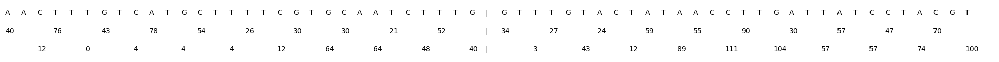

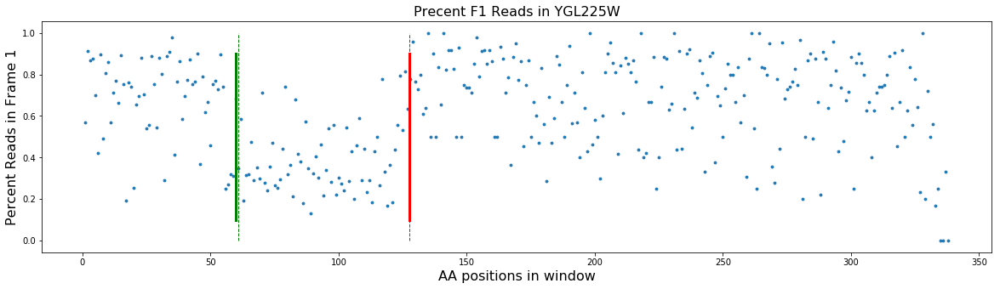


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL202W	p-value: 6.526773215171406e-06	gene-length: 1504	shift-start-position: 909	shift-length 58
Simulated Percent: 0.8


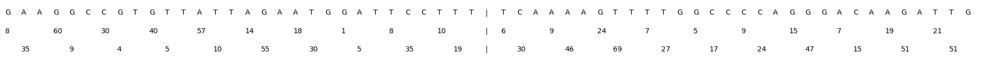

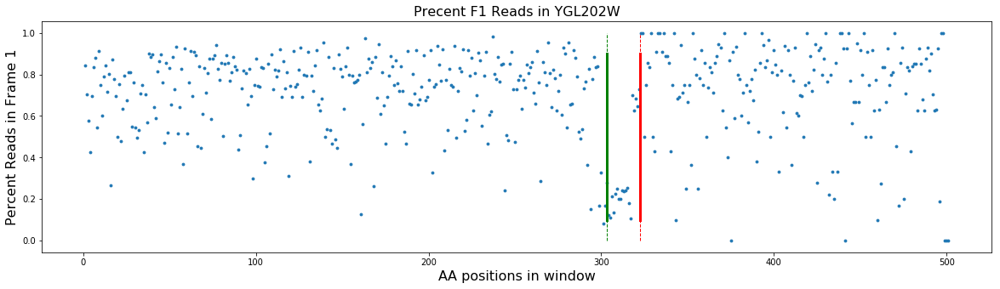


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL200C	p-value: 7.877345977181718e-06	gene-length: 613	shift-start-position: 408	shift-length 56
Simulated Percent: 0.8


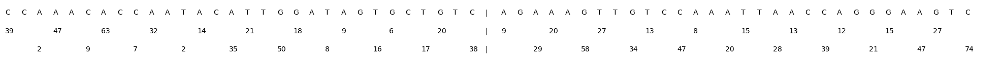

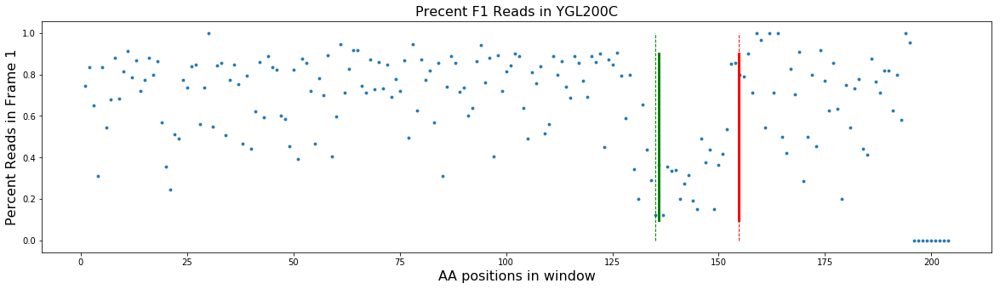


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL191W	p-value: 5.261942356405352e-07	gene-length: 391	shift-start-position: 252	shift-length 43
Simulated Percent: 0.8


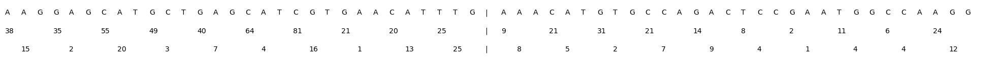

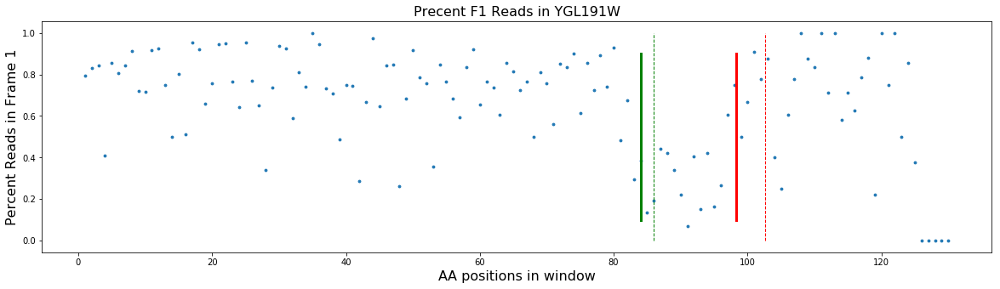


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL106W	p-value: 2.670207400896801e-05	gene-length: 451	shift-start-position: 93	shift-length 46
Simulated Percent: 0.8


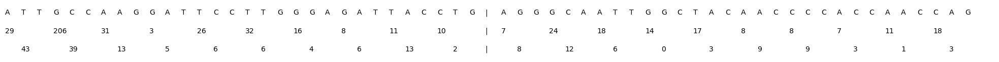

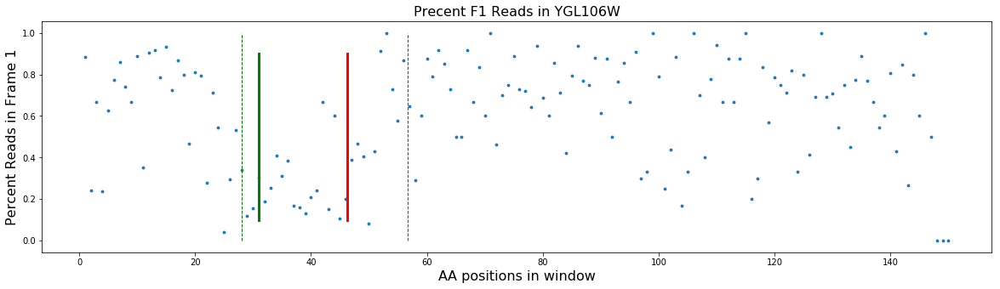


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL026C	p-value: 2.9047040677170764e-37	gene-length: 2125	shift-start-position: 603	shift-length 74
Simulated Percent: 0.8


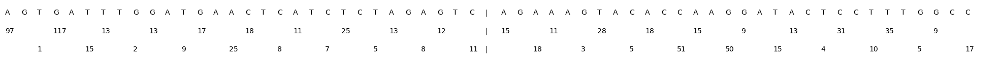

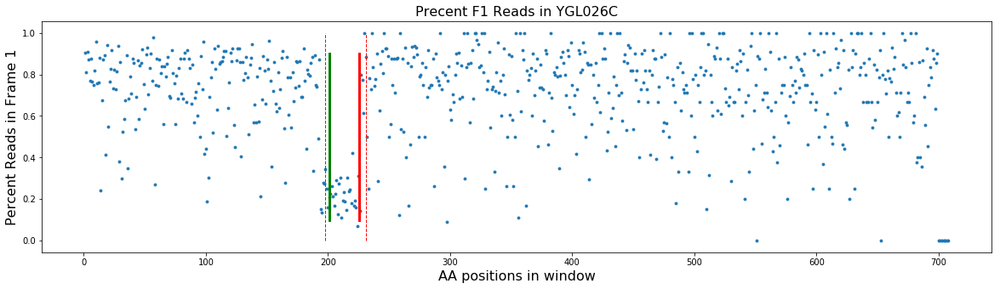


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL012W	p-value: 1.3157279705161096e-14	gene-length: 1423	shift-start-position: 1191	shift-length 121
Simulated Percent: 0.8


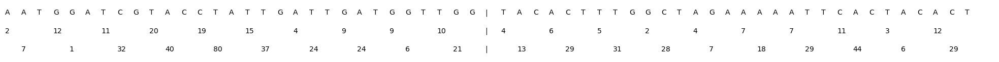

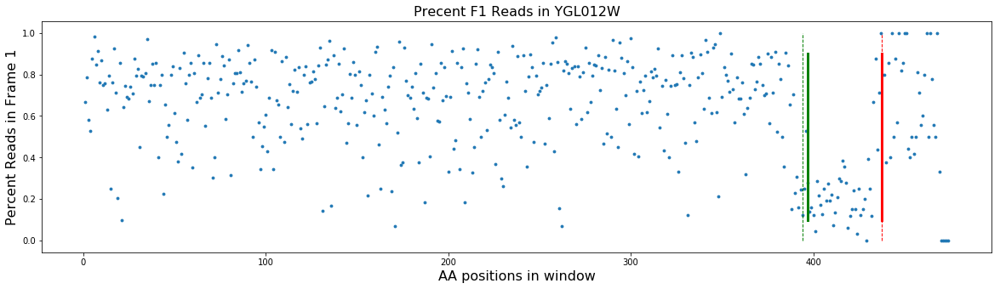


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR026W	p-value: 2.668240770618307e-05	gene-length: 838	shift-start-position: 84	shift-length 119
Simulated Percent: 0.8


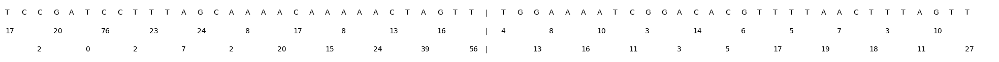

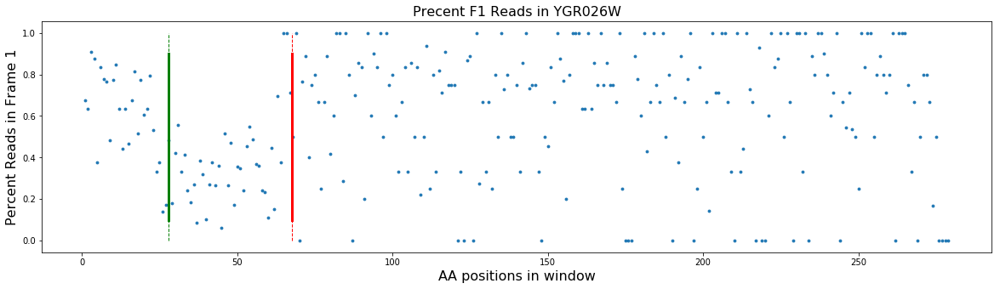


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR055W	p-value: 1.552987188409903e-05	gene-length: 1726	shift-start-position: 1143	shift-length 61
Simulated Percent: 0.9


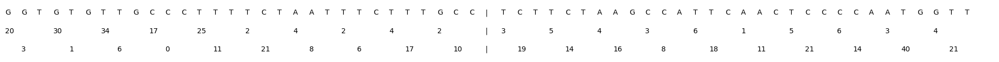

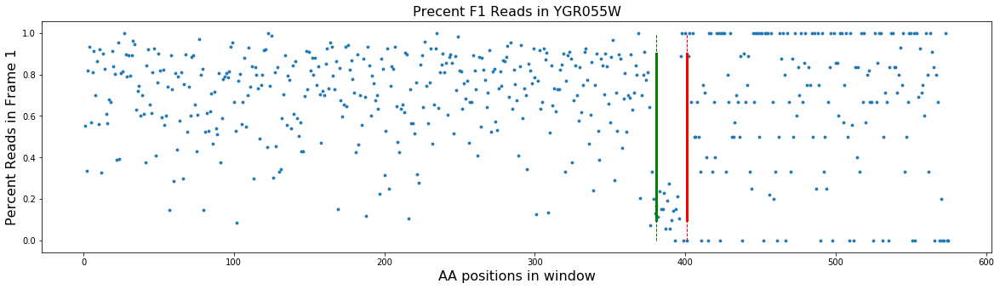


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR061C	p-value: 5.213258381989691e-13	gene-length: 4078	shift-start-position: 3303	shift-length 64
Simulated Percent: 0.8


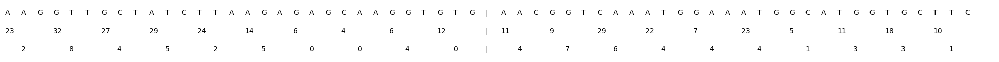

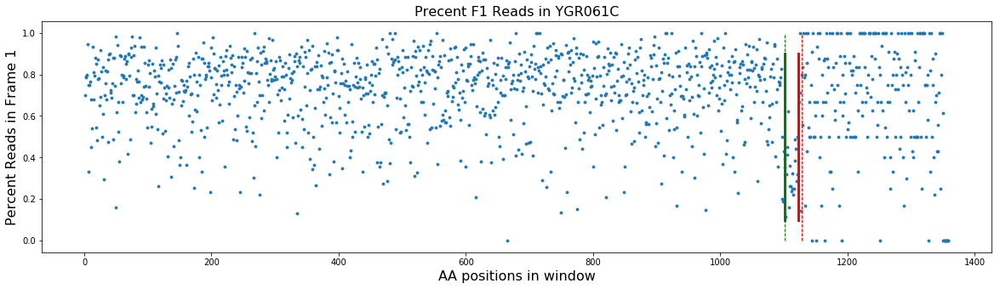


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR082W	p-value: 4.464190231775833e-05	gene-length: 553	shift-start-position: 357	shift-length 59
Simulated Percent: 0.9


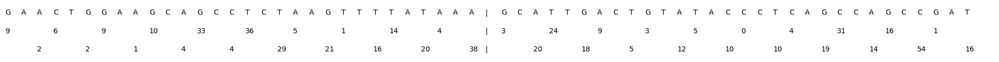

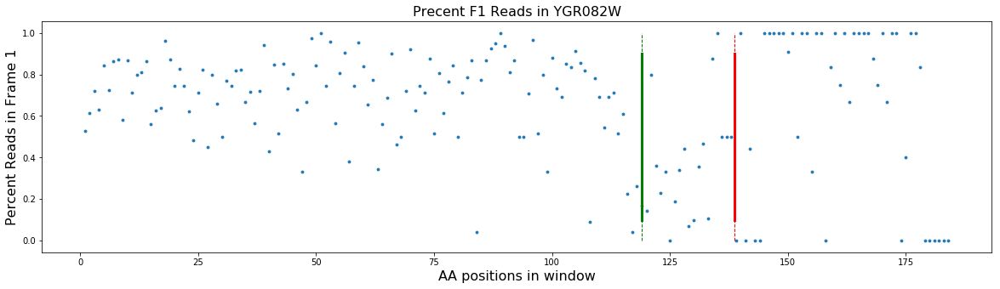


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR157W	p-value: 6.635375858194561e-14	gene-length: 2611	shift-start-position: 132	shift-length 164
Simulated Percent: 0.9


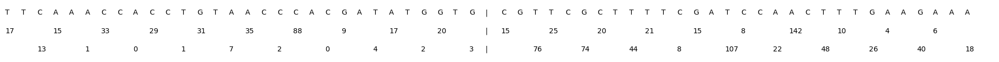

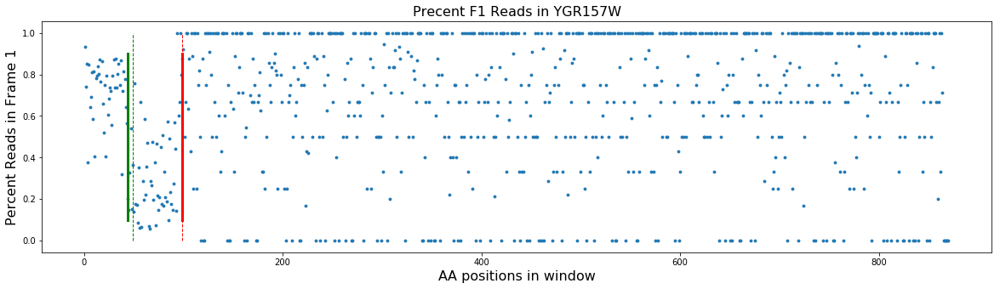


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR162W	p-value: 5.04037576252581e-16	gene-length: 2860	shift-start-position: 111	shift-length 289
Simulated Percent: 0.9


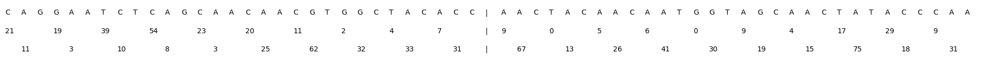

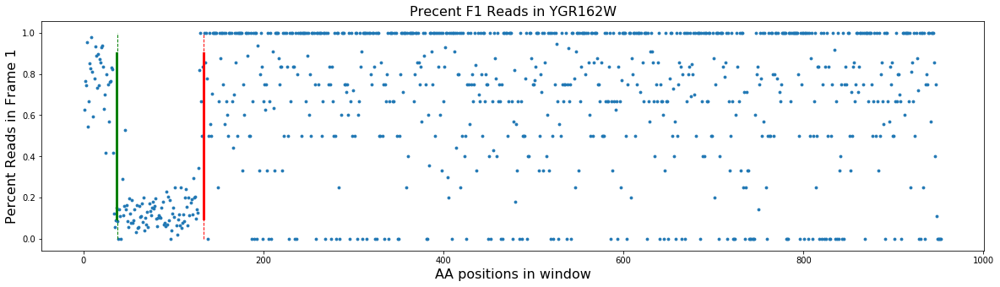


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR282C	p-value: 2.1608501187063547e-66	gene-length: 943	shift-start-position: 492	shift-length 74
Simulated Percent: 0.9


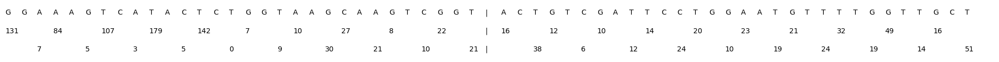

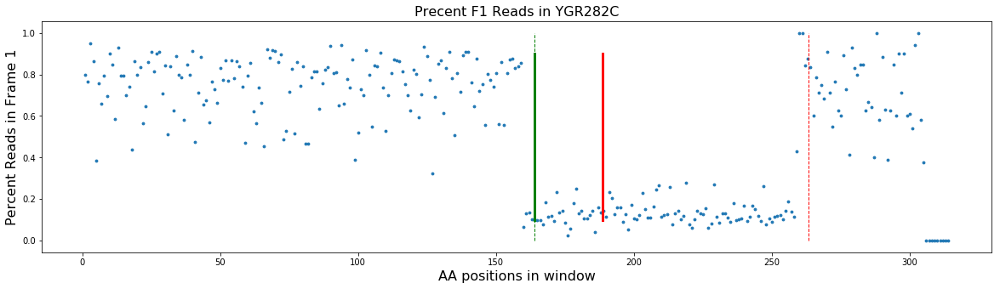


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR284C	p-value: 5.034621187651495e-09	gene-length: 934	shift-start-position: 690	shift-length 67
Simulated Percent: 0.8


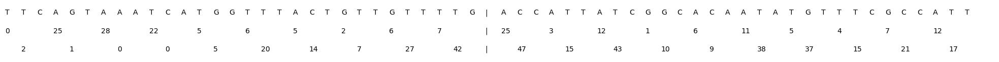

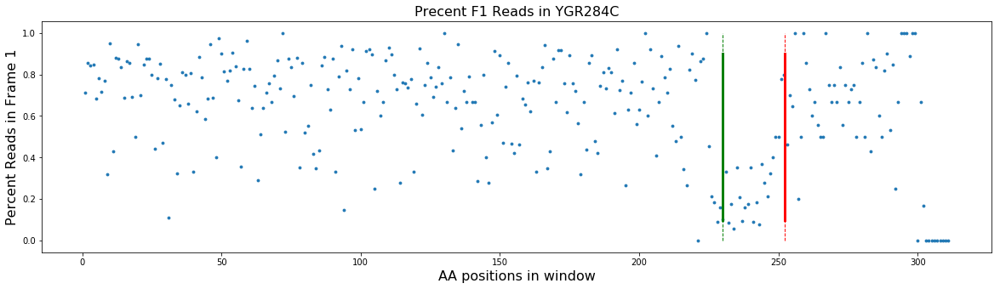


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YHR007C	p-value: 2.25009239701716e-16	gene-length: 1594	shift-start-position: 1362	shift-length 35
Simulated Percent: 0.7


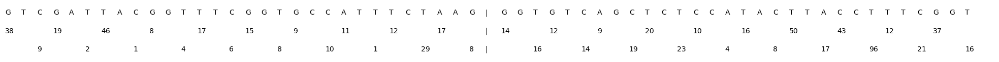

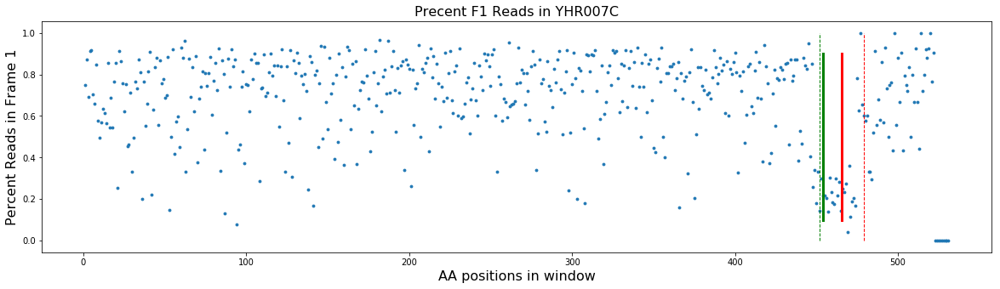


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YHR026W	p-value: 9.396176694117732e-05	gene-length: 643	shift-start-position: 117	shift-length 37
Simulated Percent: 0.7


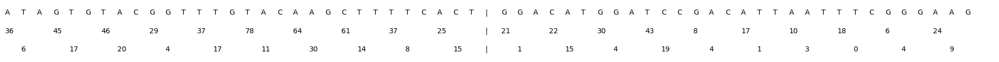

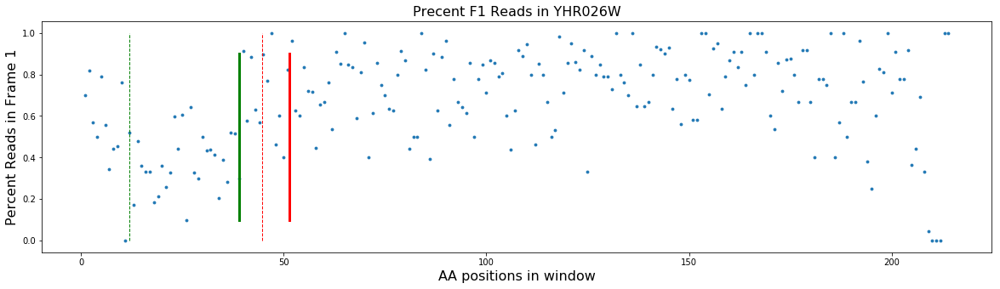


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YHR094C	p-value: 6.745390861497665e-18	gene-length: 1714	shift-start-position: 1170	shift-length 115
Simulated Percent: 0.7


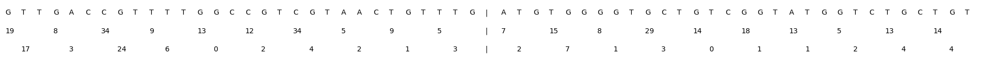

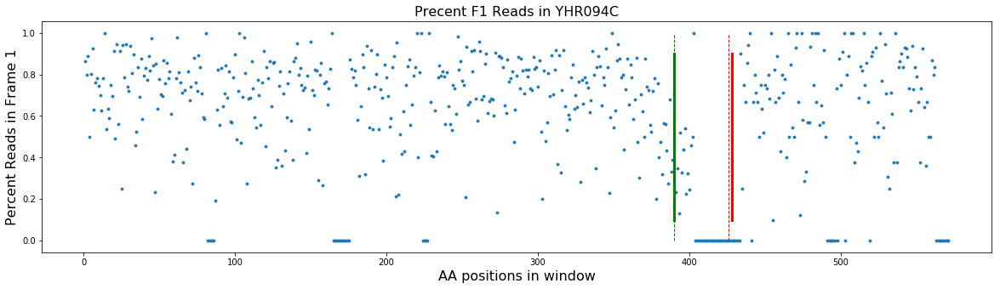


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YHR162W	p-value: 1.355560360018663e-11	gene-length: 391	shift-start-position: 150	shift-length 131
Simulated Percent: 0.8


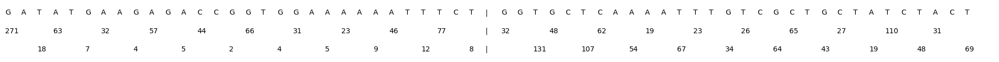

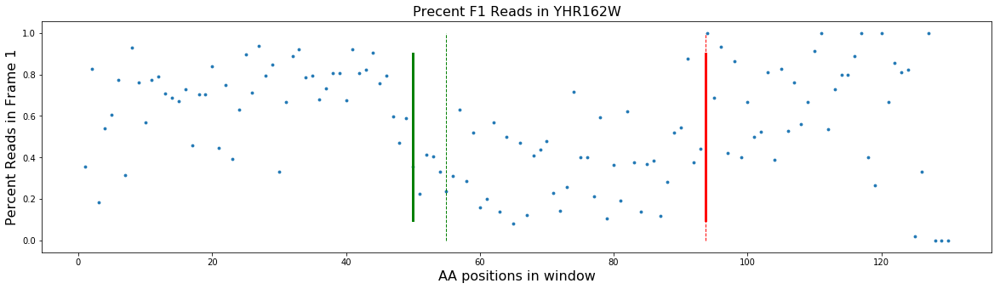


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YHR190W	p-value: 1.3272177980917647e-10	gene-length: 1336	shift-start-position: 828	shift-length 113
Simulated Percent: 0.6


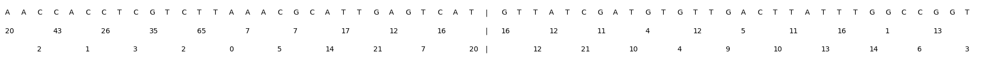

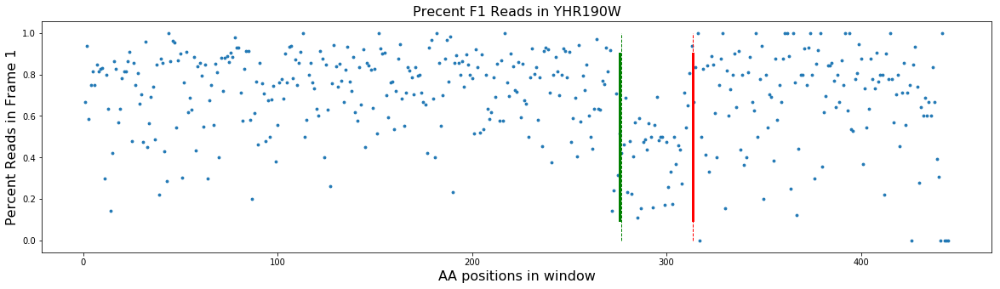


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YIL053W	p-value: 5.451651968603417e-06	gene-length: 754	shift-start-position: 126	shift-length 83
Simulated Percent: 0.9


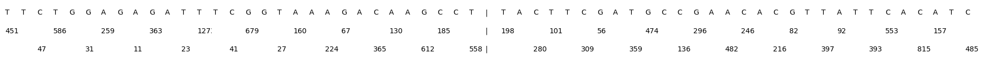

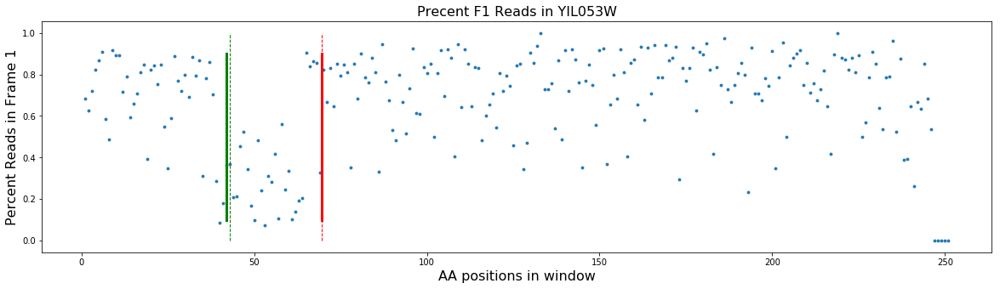


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YIL043C	p-value: 8.875603163100576e-07	gene-length: 856	shift-start-position: 675	shift-length 101
Simulated Percent: 0.5


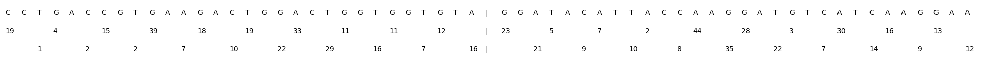

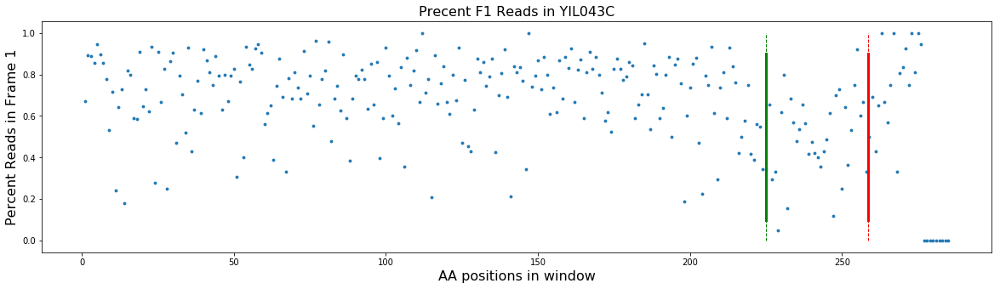


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJL143W	p-value: 7.418842091646388e-07	gene-length: 478	shift-start-position: 276	shift-length 98
Simulated Percent: 0.6


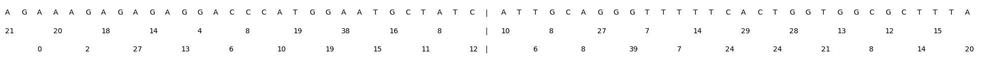

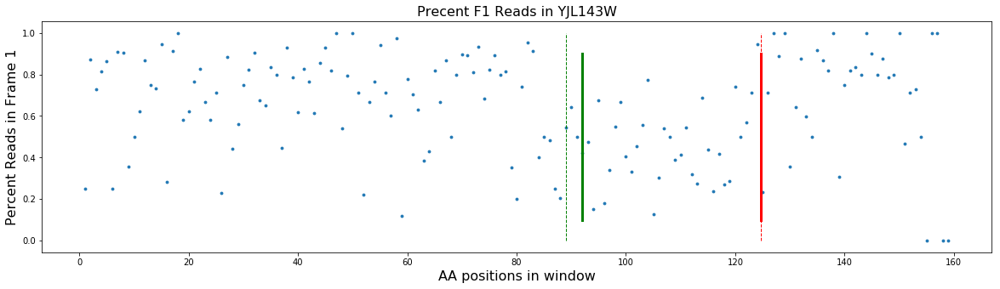


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJL111W	p-value: 7.872733670347961e-07	gene-length: 1654	shift-start-position: 72	shift-length 46
Simulated Percent: 0.7


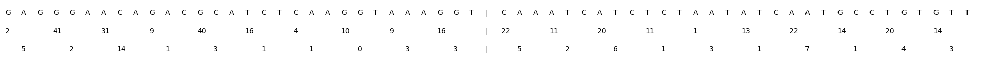

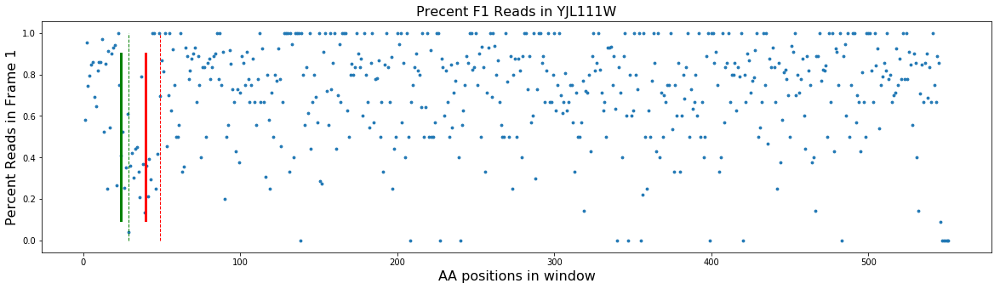


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJL080C	p-value: 3.900138850218045e-12	gene-length: 3670	shift-start-position: 129	shift-length 34
Simulated Percent: 0.9


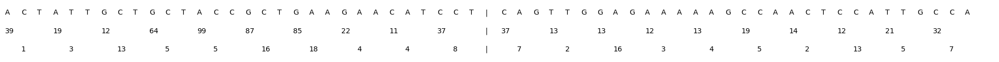

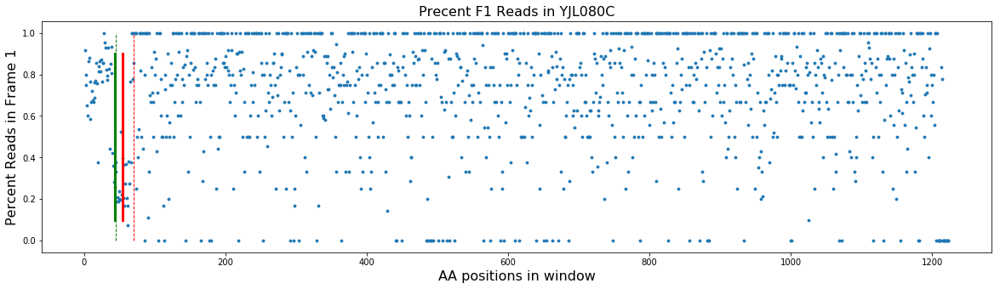


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJL052W	p-value: 3.5788379377231786e-38	gene-length: 1000	shift-start-position: 435	shift-length 79
Simulated Percent: 0.8


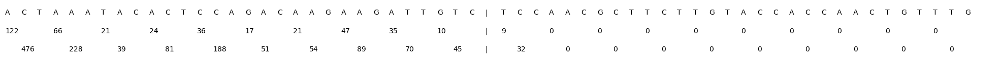

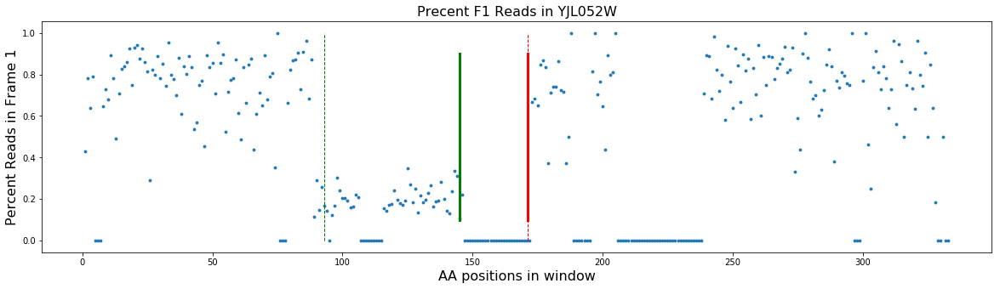


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJR016C	p-value: 4.4054311580868324e-08	gene-length: 1759	shift-start-position: 612	shift-length 89
Simulated Percent: 0.7


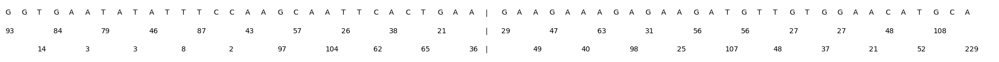

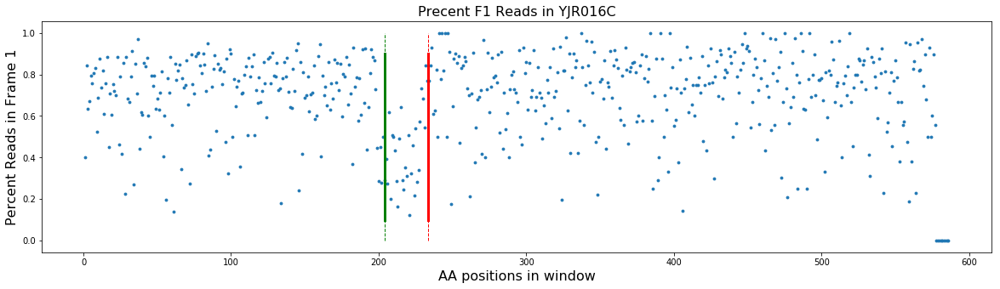


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJR065C	p-value: 1.4264539362729532e-11	gene-length: 1351	shift-start-position: 1002	shift-length 115
Simulated Percent: 0.9


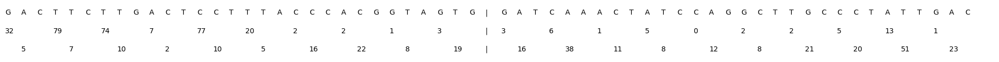

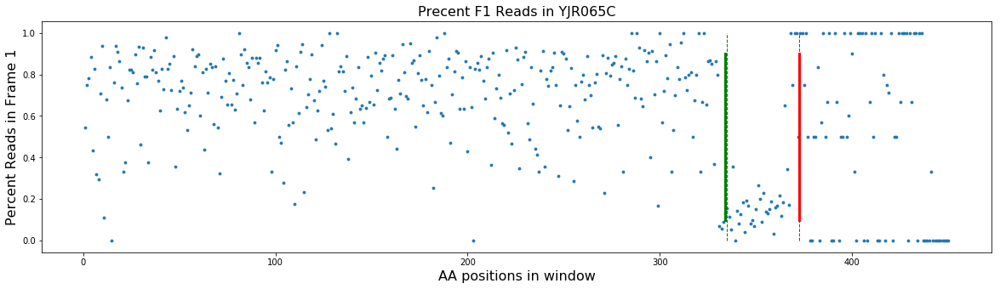


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJR069C	p-value: 6.211893722391655e-35	gene-length: 595	shift-start-position: 402	shift-length 68
Simulated Percent: 0.9


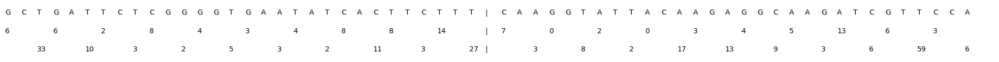

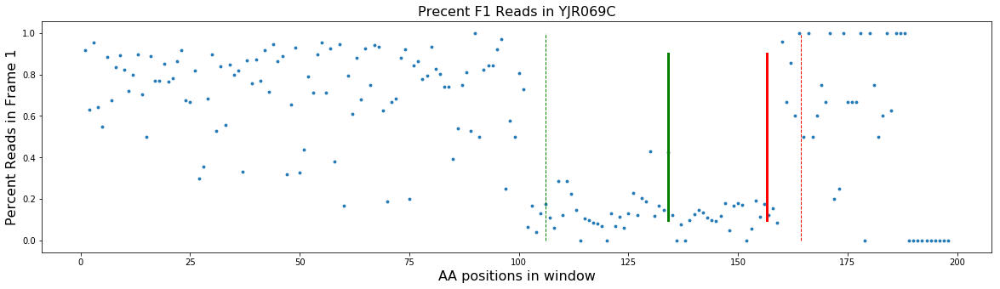


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YJR073C	p-value: 1.2354417654431551e-09	gene-length: 622	shift-start-position: 447	shift-length 143
Simulated Percent: 0.7


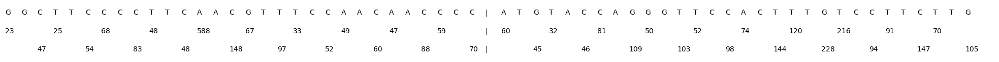

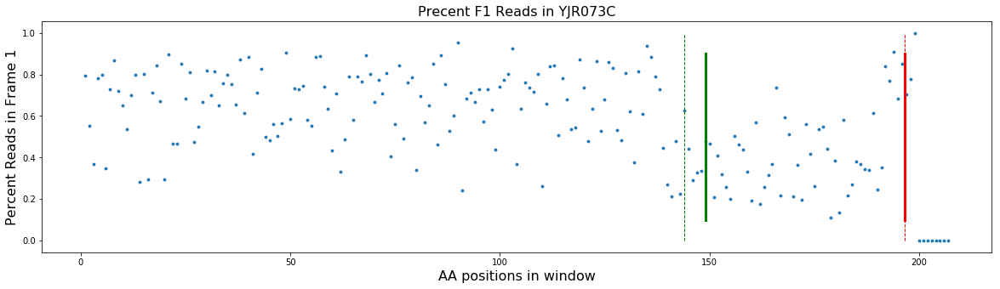


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKL164C	p-value: 8.367861674317129e-06	gene-length: 1027	shift-start-position: 54	shift-length 31
Simulated Percent: 0.2


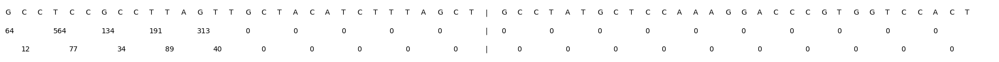

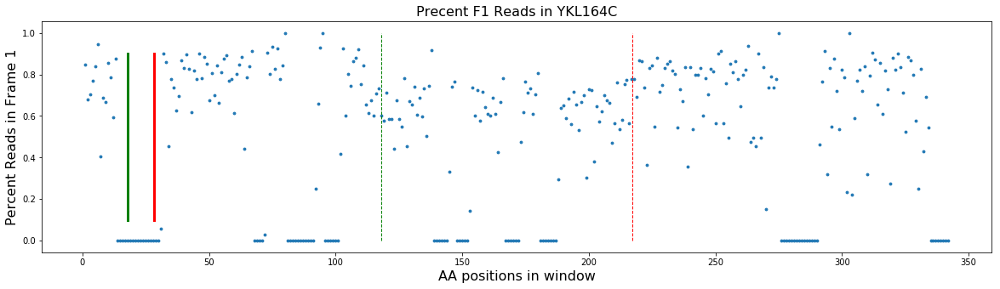


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKL117W	p-value: 2.7881146520140393e-45	gene-length: 652	shift-start-position: 528	shift-length 44
Simulated Percent: 0.9


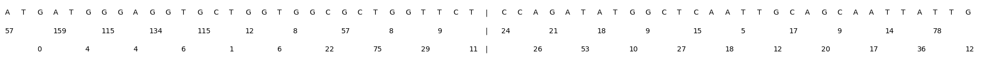

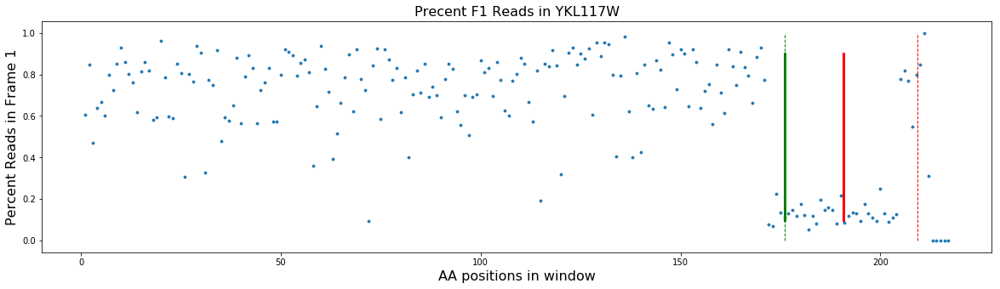


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKL080W	p-value: 1.768348564140157e-12	gene-length: 1180	shift-start-position: 477	shift-length 94
Simulated Percent: 0.8


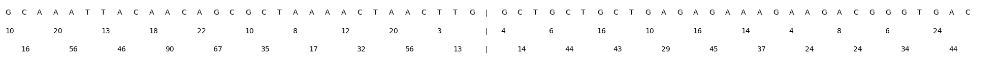

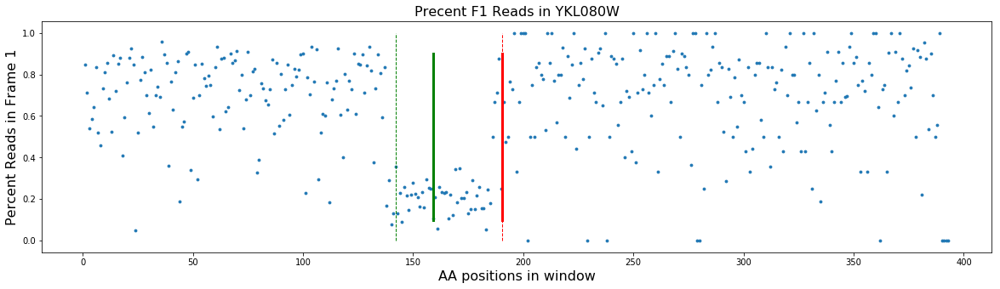


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKR001C	p-value: 4.687499861061151e-10	gene-length: 2116	shift-start-position: 1158	shift-length 38
Simulated Percent: 0.8


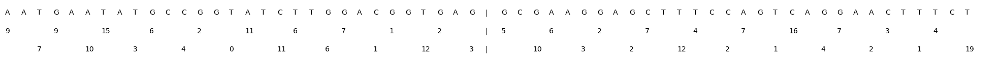

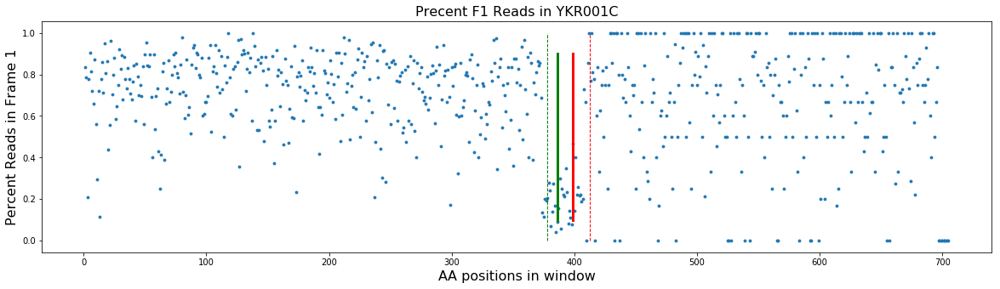


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKR042W	p-value: 1.21502750369137e-49	gene-length: 1099	shift-start-position: 642	shift-length 41
Simulated Percent: 0.8


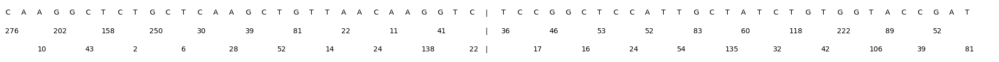

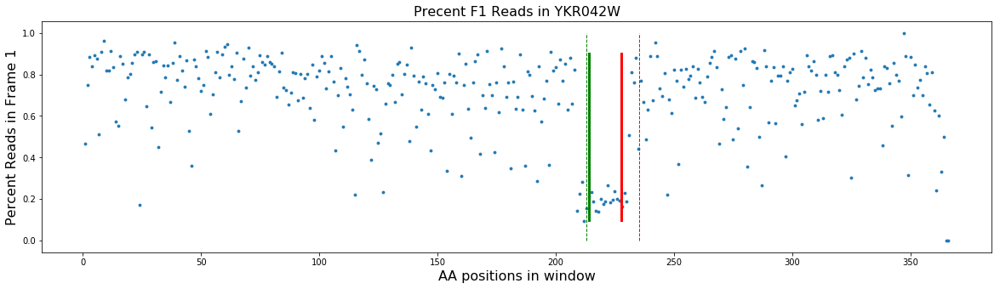


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLL039C	p-value: 5.63930059813847e-07	gene-length: 1147	shift-start-position: 588	shift-length 79
Simulated Percent: 0.9


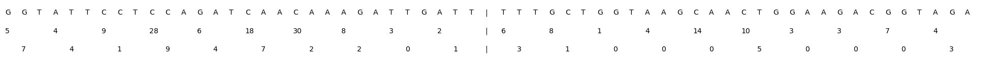

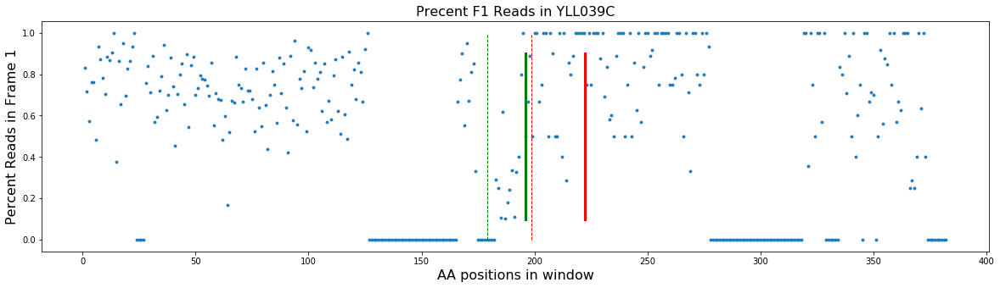


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR044C	p-value: 1.78495648064771e-05	gene-length: 1693	shift-start-position: 435	shift-length 58
Simulated Percent: 0.9


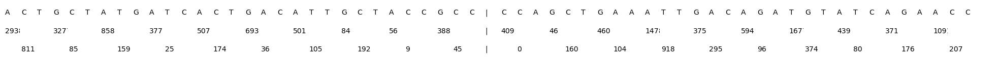

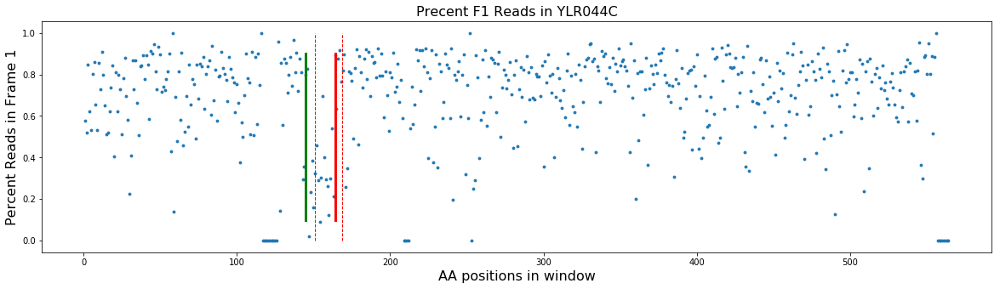


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR058C	p-value: 1.020809875381284e-09	gene-length: 1411	shift-start-position: 627	shift-length 89
Simulated Percent: 0.9


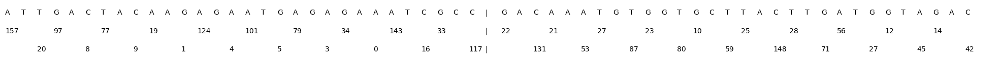

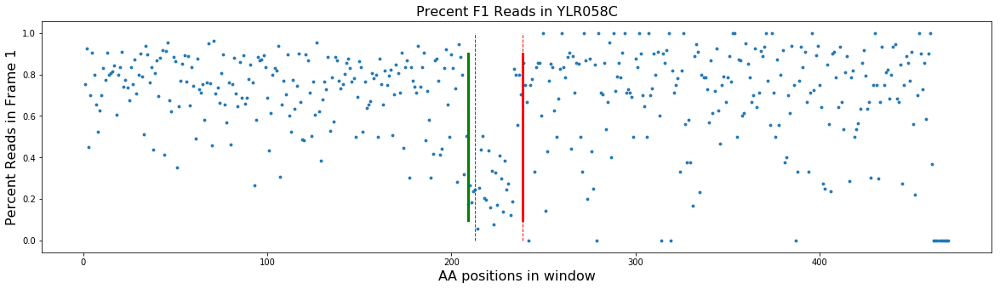


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR175W	p-value: 1.7272939911775747e-05	gene-length: 1453	shift-start-position: 411	shift-length 68
Simulated Percent: 0.7


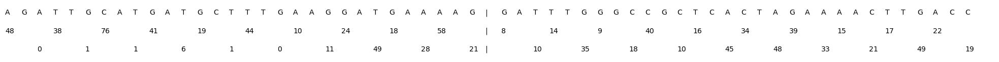

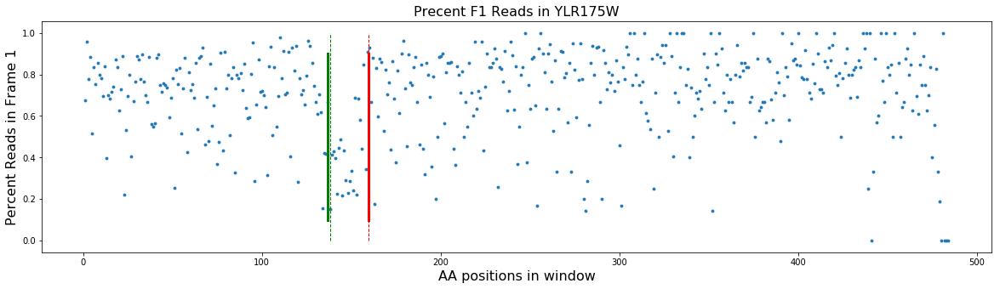


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR342W	p-value: 4.728504034228363e-11	gene-length: 5632	shift-start-position: 327	shift-length 68
Simulated Percent: 0.9


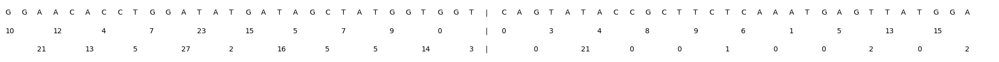

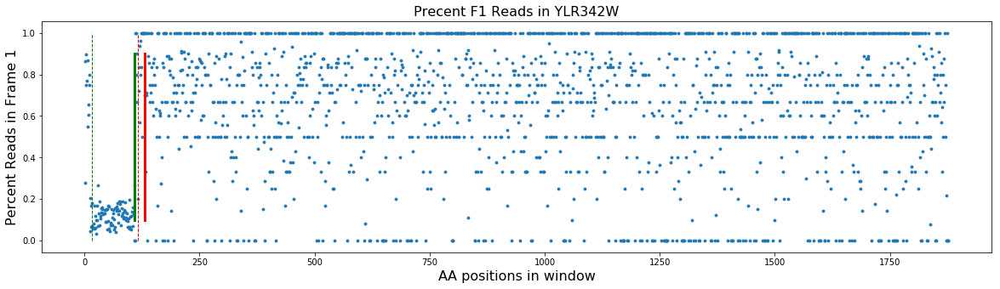


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR372W	p-value: 1.6968786064800043e-10	gene-length: 1039	shift-start-position: 534	shift-length 64
Simulated Percent: 0.9


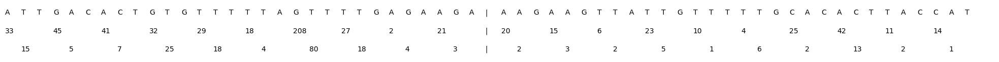

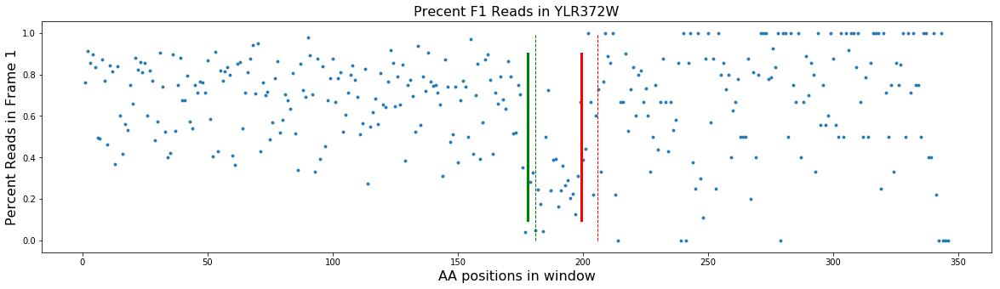


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR390W-A	p-value: 2.251041342665864e-58	gene-length: 718	shift-start-position: 549	shift-length 95
Simulated Percent: 0.9


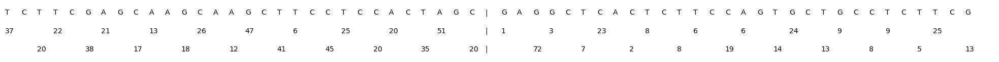

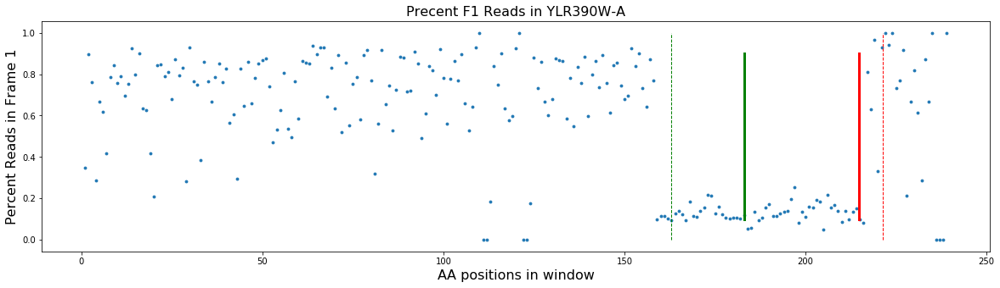


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR447C	p-value: 1.689551117117822e-05	gene-length: 1039	shift-start-position: 279	shift-length 68
Simulated Percent: 0.7


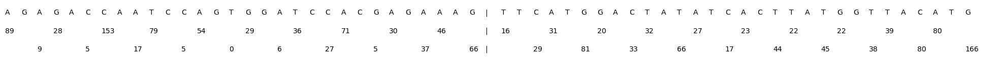

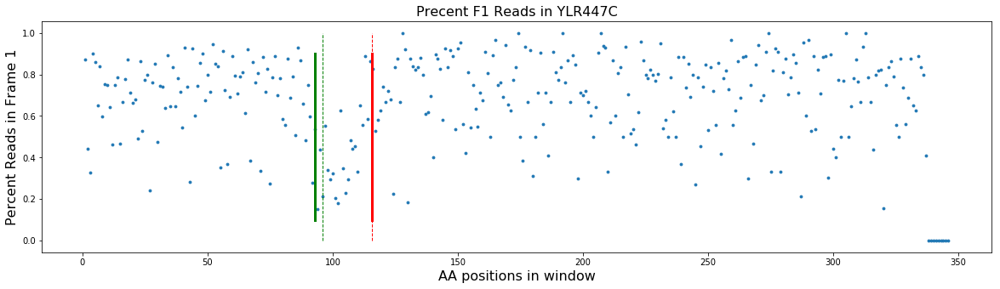


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR449W	p-value: 9.52380075719379e-08	gene-length: 1180	shift-start-position: 405	shift-length 77
Simulated Percent: 0.9


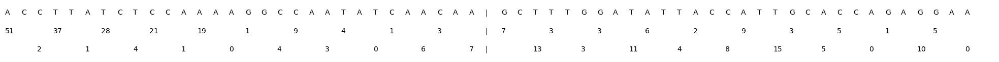

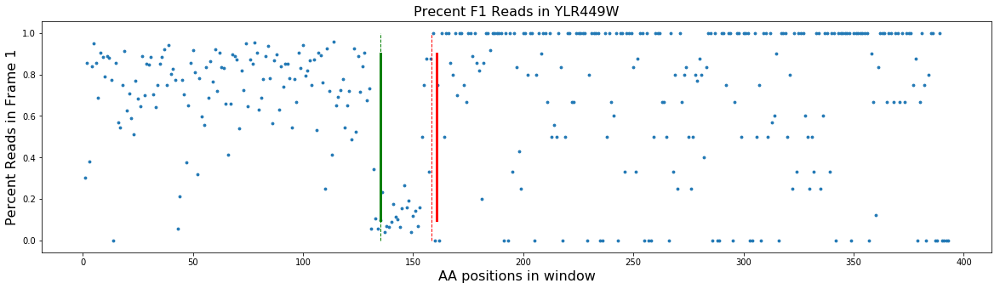


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YML126C	p-value: 5.095631113566737e-06	gene-length: 1477	shift-start-position: 1341	shift-length 56
Simulated Percent: 0.8


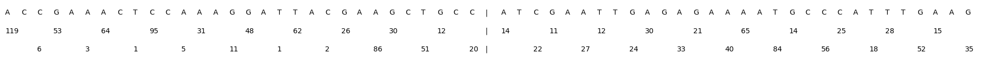

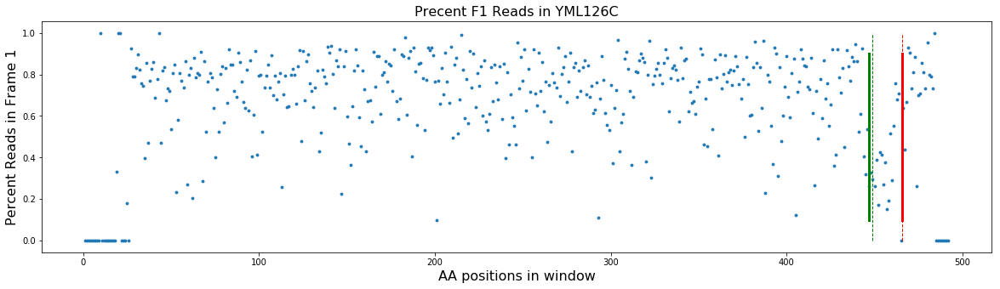


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YML092C	p-value: 6.510250466162925e-14	gene-length: 754	shift-start-position: 135	shift-length 64
Simulated Percent: 0.9


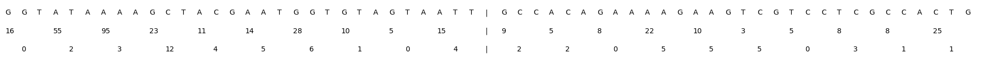

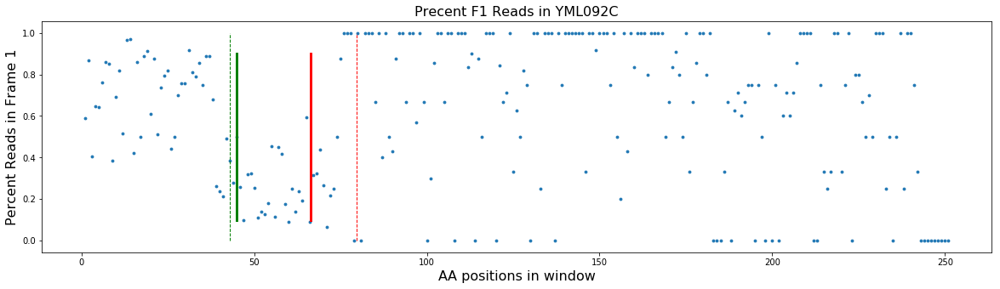


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YML063W	p-value: 1.1077835548279128e-11	gene-length: 769	shift-start-position: 522	shift-length 113
Simulated Percent: 0.8


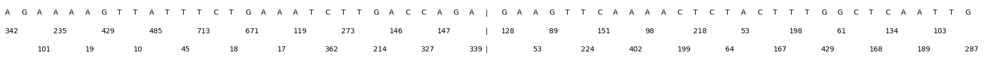

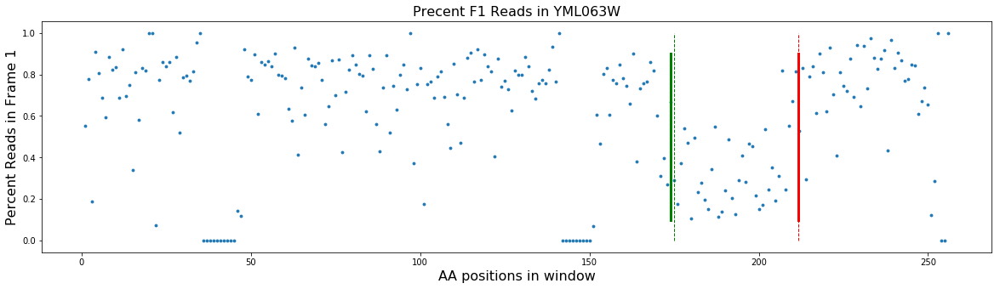


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YML028W	p-value: 1.6998488117044894e-16	gene-length: 592	shift-start-position: 249	shift-length 56
Simulated Percent: 0.8


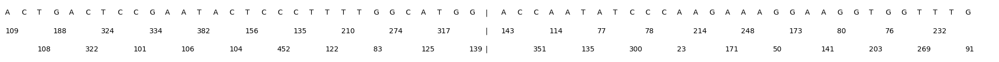

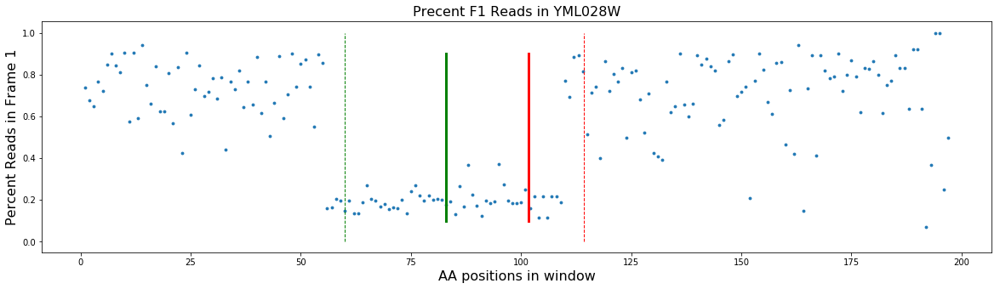


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YML008C	p-value: 2.9105207857315894e-06	gene-length: 1153	shift-start-position: 975	shift-length 80
Simulated Percent: 0.6


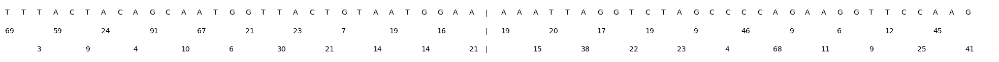

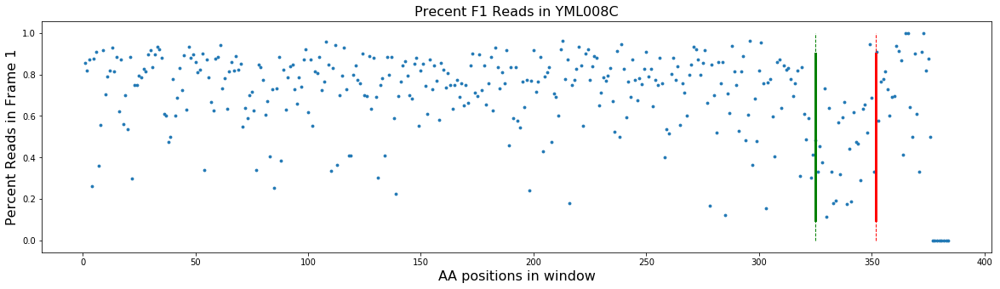


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR058W	p-value: 2.91639614099094e-14	gene-length: 1912	shift-start-position: 1647	shift-length 155
Simulated Percent: 0.7


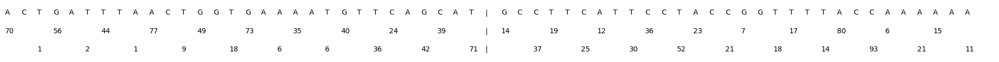

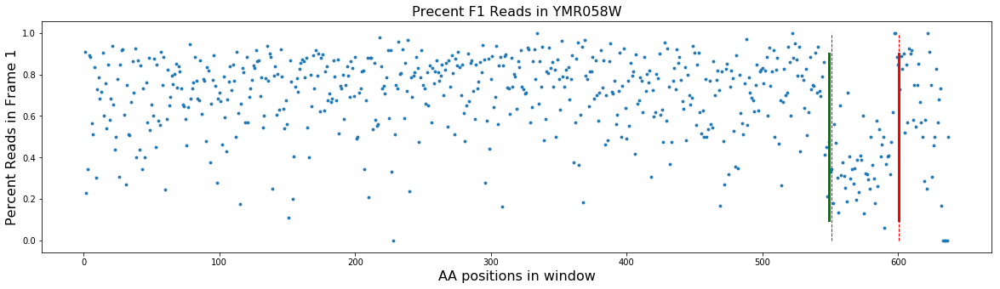


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR108W	p-value: 3.037513481274178e-06	gene-length: 2065	shift-start-position: 93	shift-length 103
Simulated Percent: 0.7


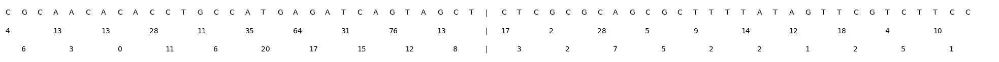

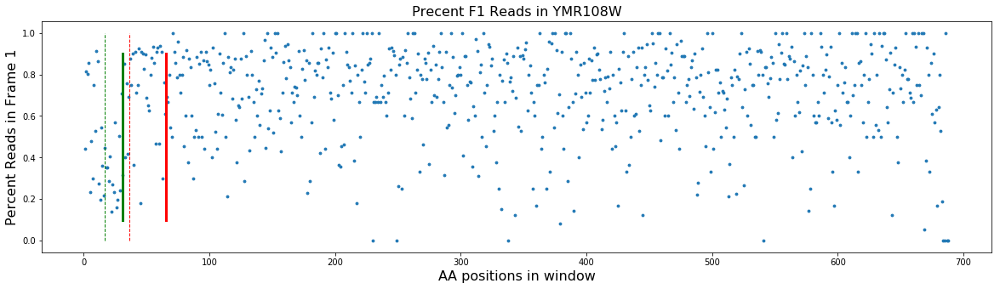


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR146C	p-value: 1.0867189687747414e-66	gene-length: 1045	shift-start-position: 528	shift-length 71
Simulated Percent: 0.9


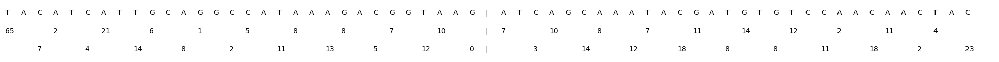

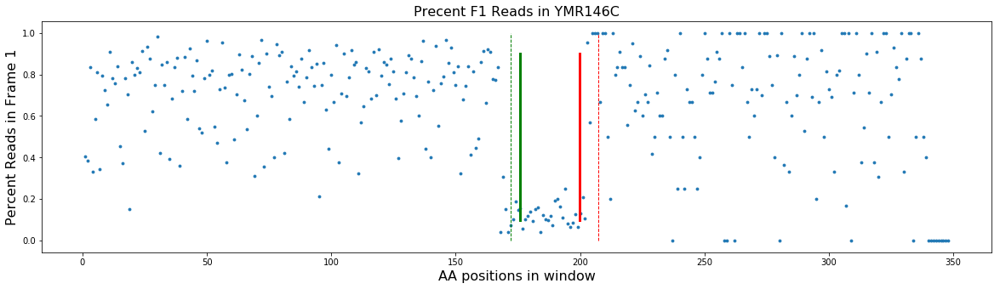


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR203W	p-value: 2.0837118394321622e-07	gene-length: 1165	shift-start-position: 354	shift-length 67
Simulated Percent: 0.8


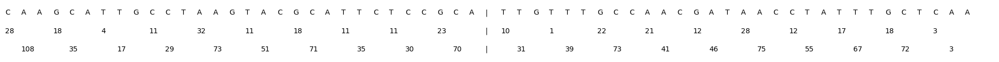

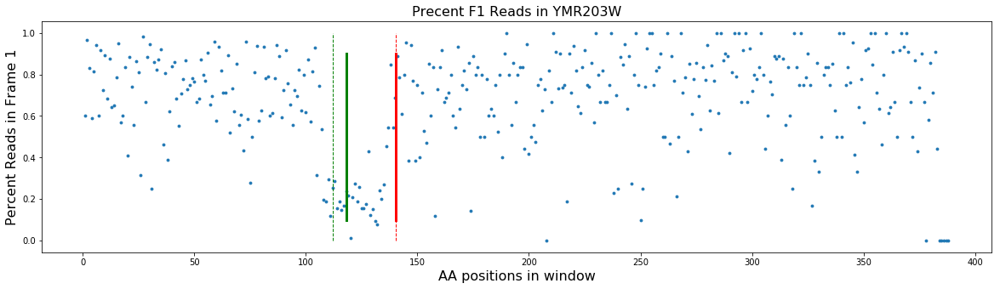


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR226C	p-value: 3.5110094826140026e-14	gene-length: 805	shift-start-position: 477	shift-length 35
Simulated Percent: 0.8


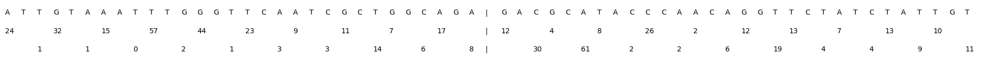

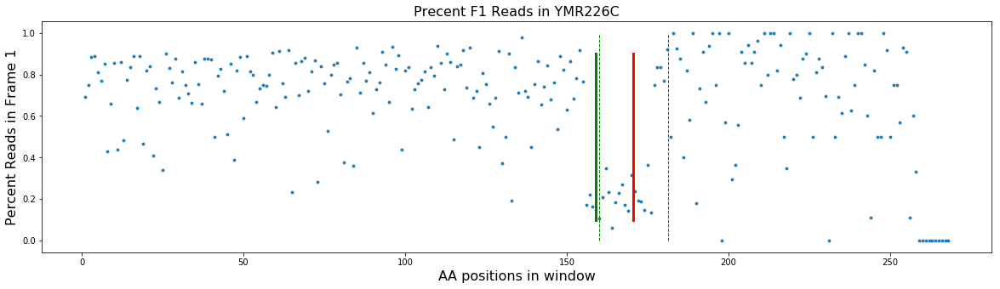


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR235C	p-value: 1.2647679216198206e-15	gene-length: 1225	shift-start-position: 438	shift-length 115
Simulated Percent: 0.9


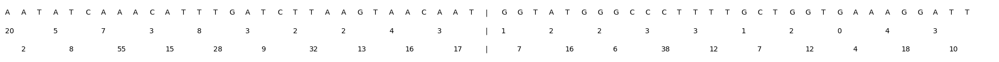

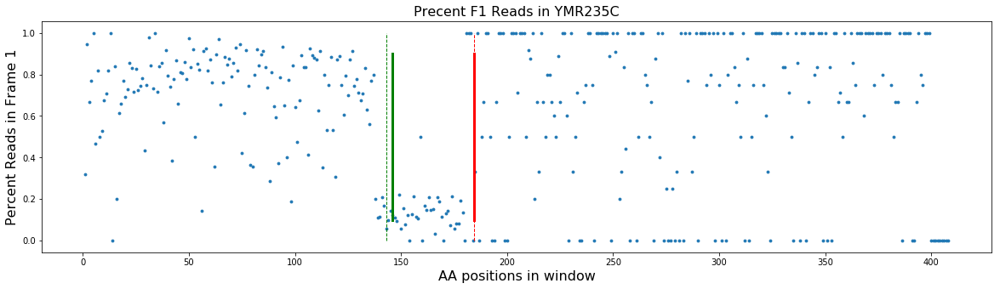


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR256C	p-value: 9.564043338916242e-05	gene-length: 184	shift-start-position: 84	shift-length 31
Simulated Percent: 0.6


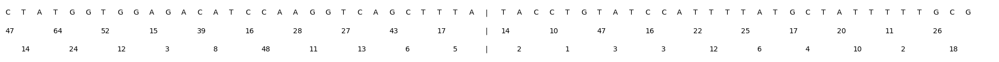

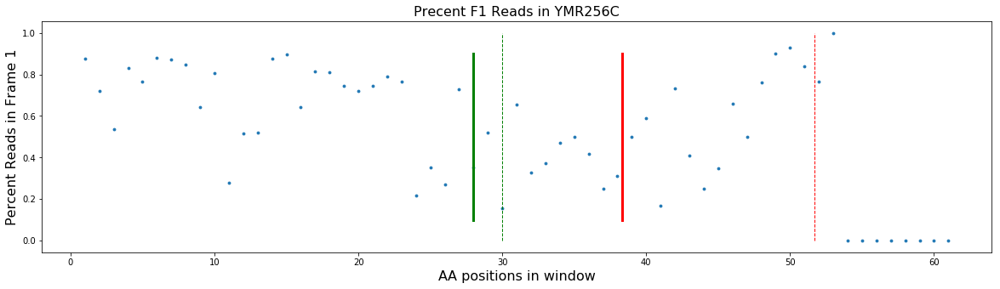


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR276W	p-value: 3.2256396933677145e-12	gene-length: 1123	shift-start-position: 885	shift-length 110
Simulated Percent: 0.8


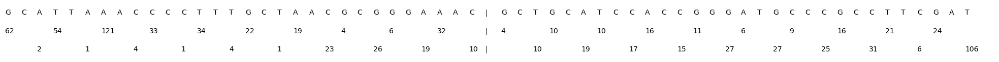

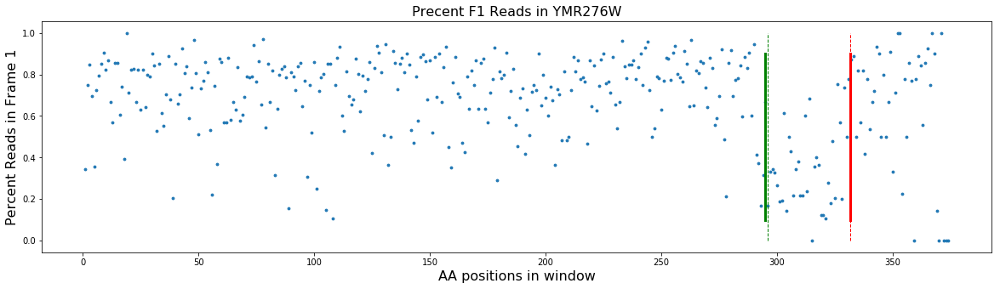


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR315W	p-value: 2.9657967429021237e-10	gene-length: 1051	shift-start-position: 360	shift-length 82
Simulated Percent: 0.9


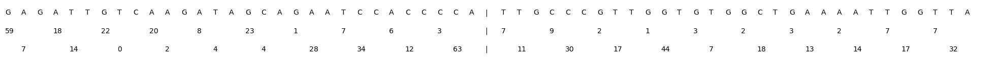

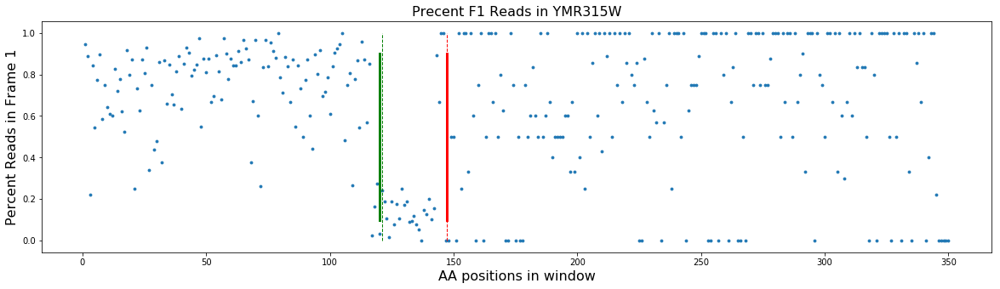


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL300W	p-value: 5.17943112307839e-10	gene-length: 310	shift-start-position: 93	shift-length 89
Simulated Percent: 0.7


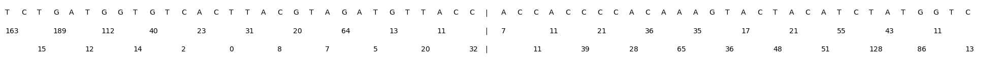

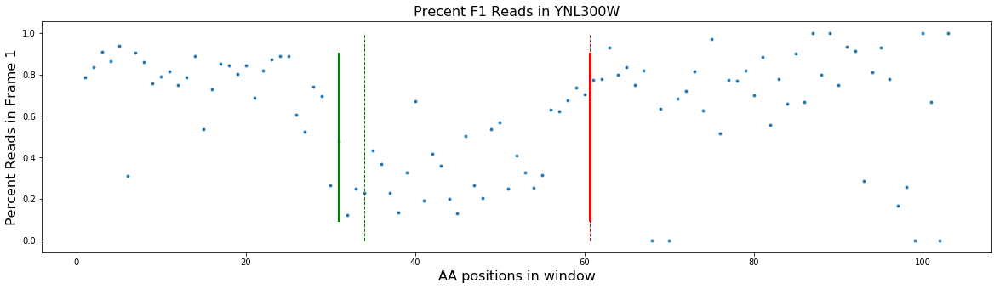


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL134C	p-value: 7.151156198199513e-10	gene-length: 1132	shift-start-position: 498	shift-length 94
Simulated Percent: 0.9


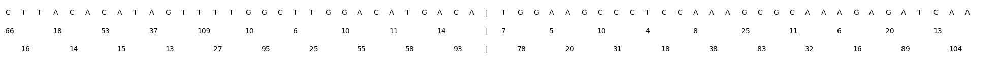

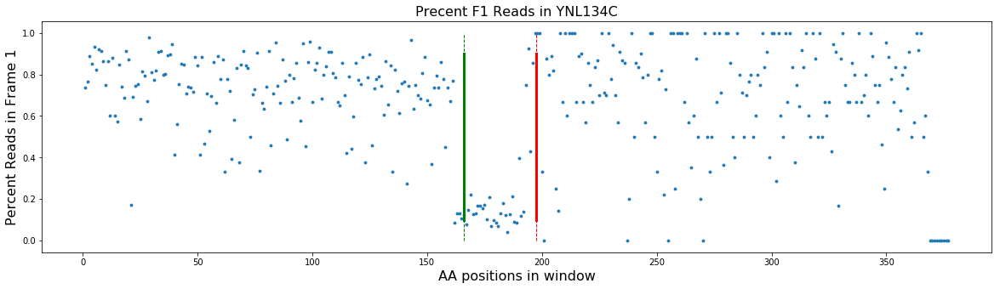


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL131W	p-value: 4.1627144038530655e-05	gene-length: 460	shift-start-position: 87	shift-length 106
Simulated Percent: 0.5


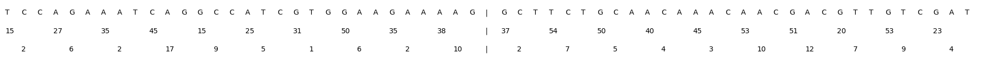

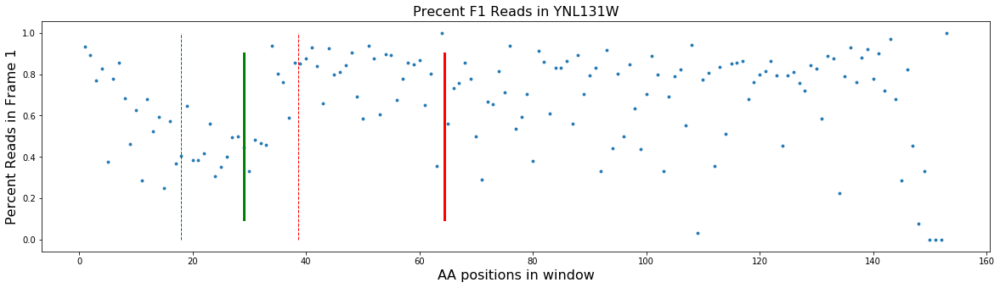


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNR057C	p-value: 5.557779871065092e-07	gene-length: 715	shift-start-position: 183	shift-length 95
Simulated Percent: 0.6


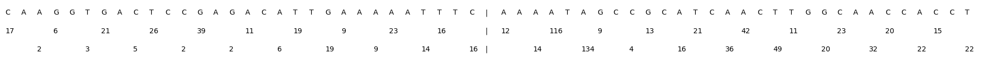

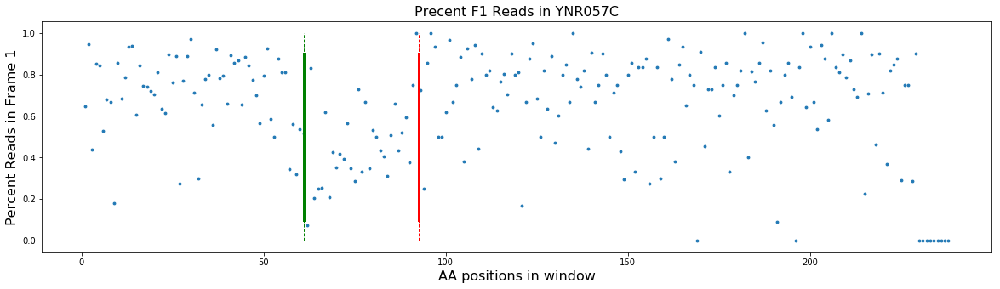


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL109W	p-value: 3.5916532430094525e-08	gene-length: 343	shift-start-position: 42	shift-length 55
Simulated Percent: 0.9


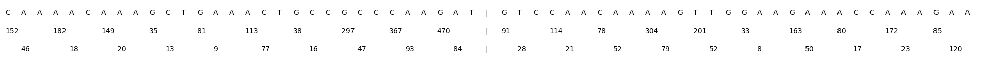

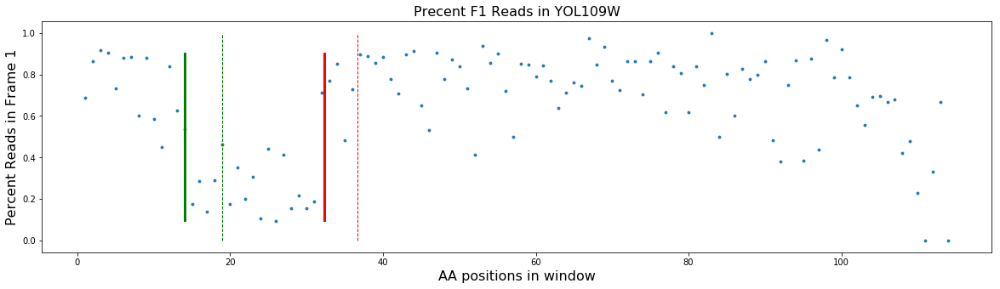


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL058W	p-value: 4.954637274819858e-06	gene-length: 1264	shift-start-position: 468	shift-length 71
Simulated Percent: 0.7


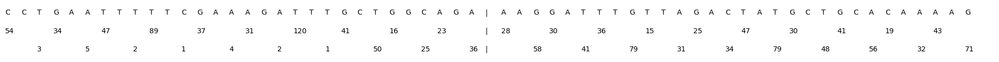

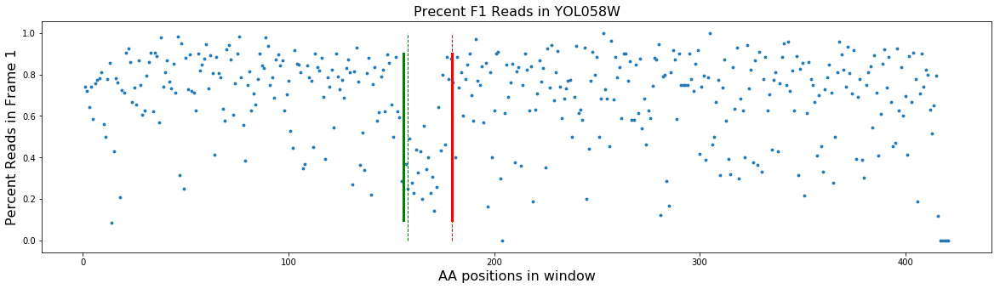


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL039W	p-value: 7.501248990925184e-07	gene-length: 322	shift-start-position: 93	shift-length 47
Simulated Percent: 0.8


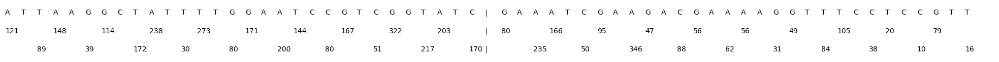

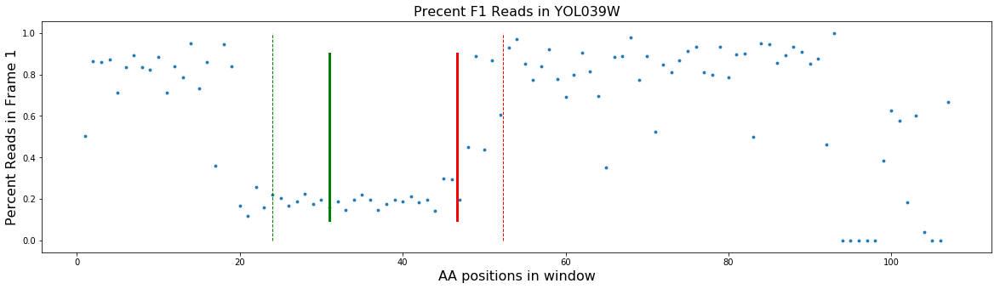


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL038W	p-value: 1.9097287121795613e-11	gene-length: 766	shift-start-position: 522	shift-length 64
Simulated Percent: 0.9


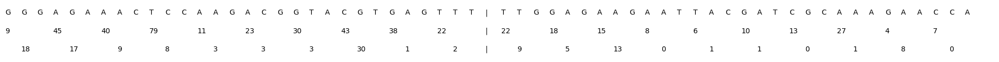

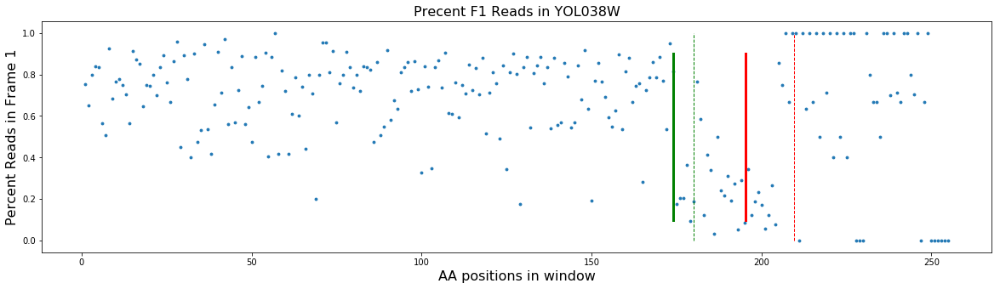


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL012C	p-value: 6.326939542165068e-13	gene-length: 406	shift-start-position: 255	shift-length 32
Simulated Percent: 0.8


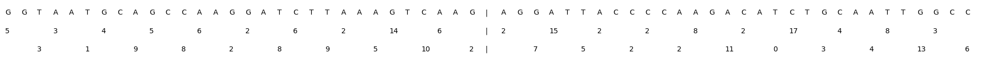

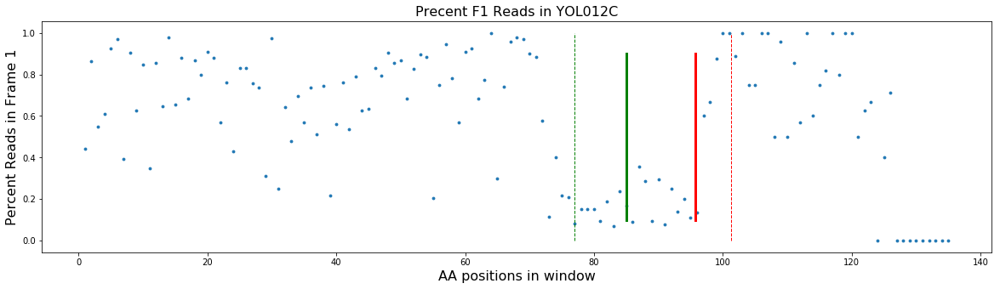


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR153W	p-value: 1.5011178816507326e-13	gene-length: 4537	shift-start-position: 3225	shift-length 38
Simulated Percent: 0.9


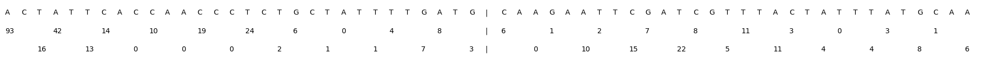

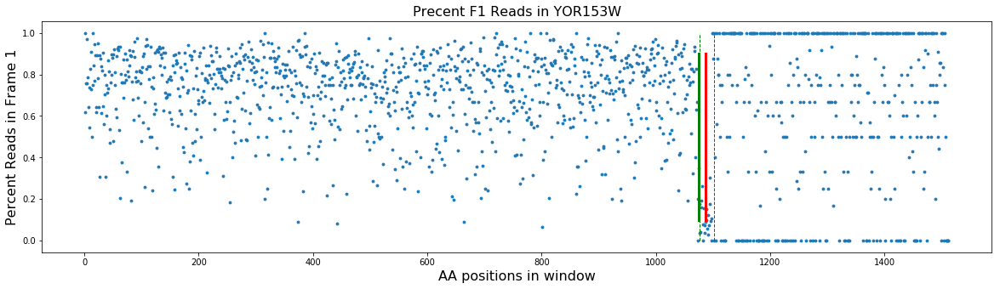


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR259C	p-value: 7.59242999511399e-12	gene-length: 1315	shift-start-position: 810	shift-length 103
Simulated Percent: 0.9


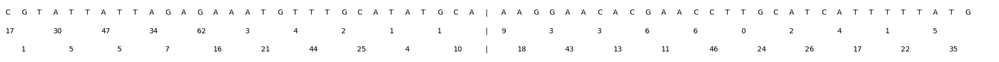

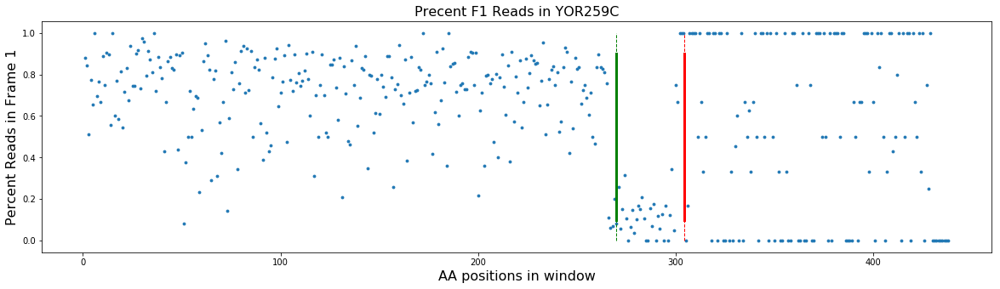


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR270C	p-value: 7.949713840662135e-08	gene-length: 2524	shift-start-position: 1503	shift-length 49
Simulated Percent: 0.9


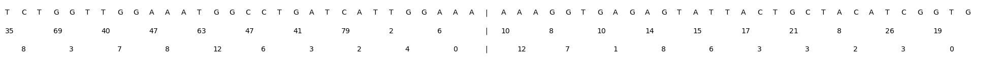

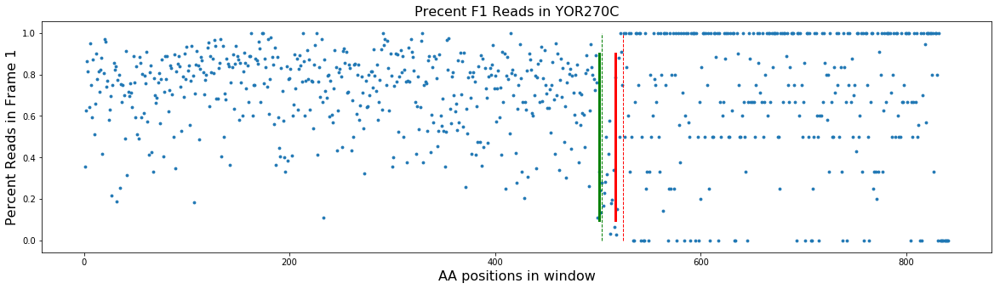


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL265W	p-value: 4.928199701378922e-18	gene-length: 1828	shift-start-position: 273	shift-length 143
Simulated Percent: 0.8


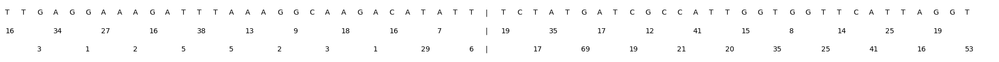

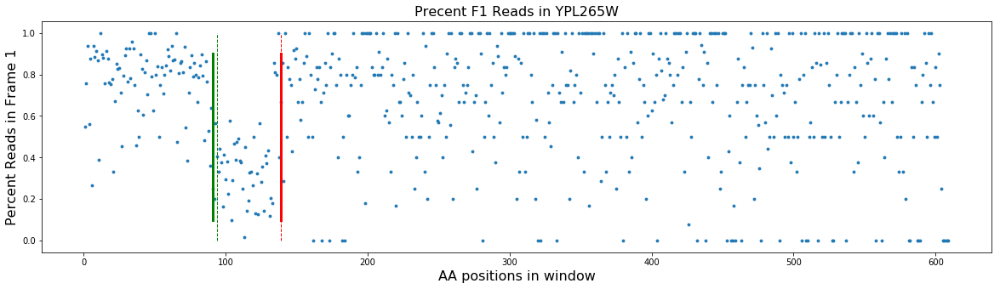


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL231W	p-value: 1.8352701963533897e-11	gene-length: 5665	shift-start-position: 2667	shift-length 104
Simulated Percent: 0.9


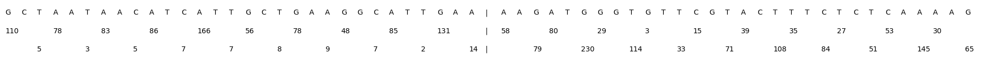

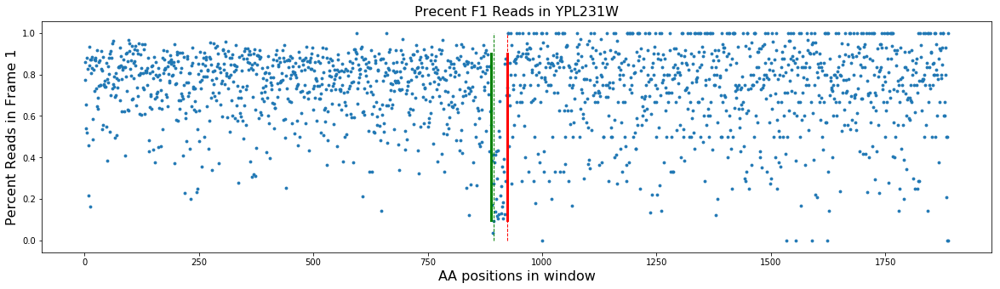


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL154C	p-value: 4.097387929728545e-32	gene-length: 1219	shift-start-position: 333	shift-length 178
Simulated Percent: 0.8


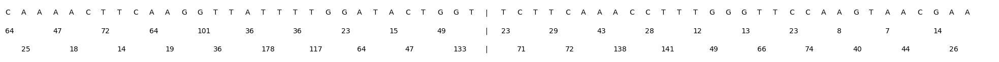

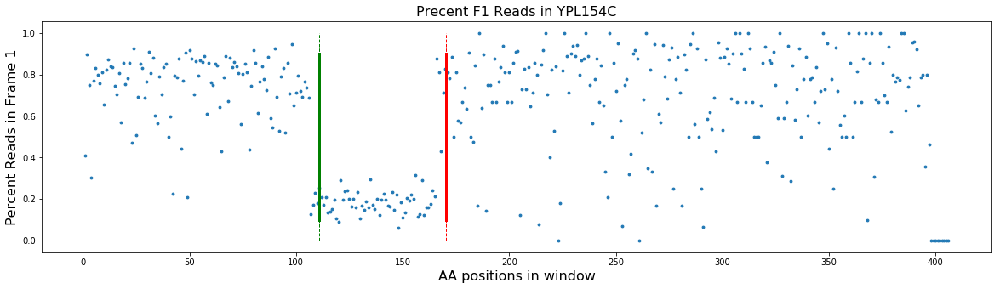


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL127C	p-value: 1.2160236223135873e-32	gene-length: 778	shift-start-position: 318	shift-length 236
Simulated Percent: 0.9


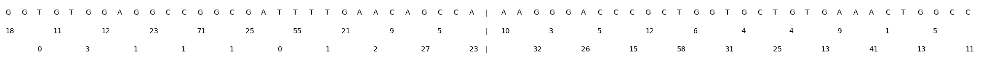

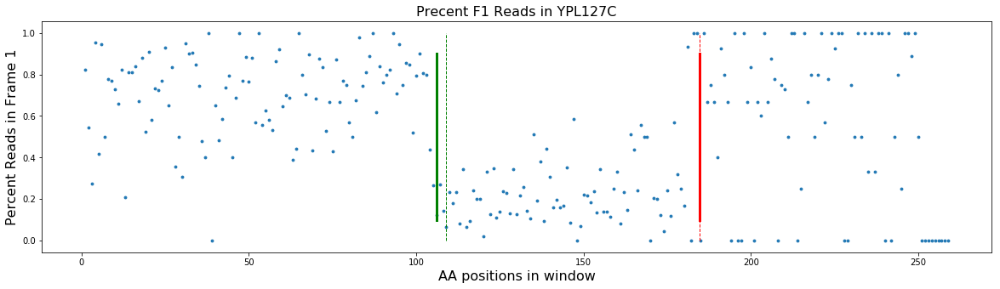


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL106C	p-value: 3.90438157695363e-62	gene-length: 2083	shift-start-position: 390	shift-length 83
Simulated Percent: 0.9


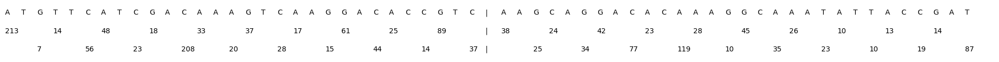

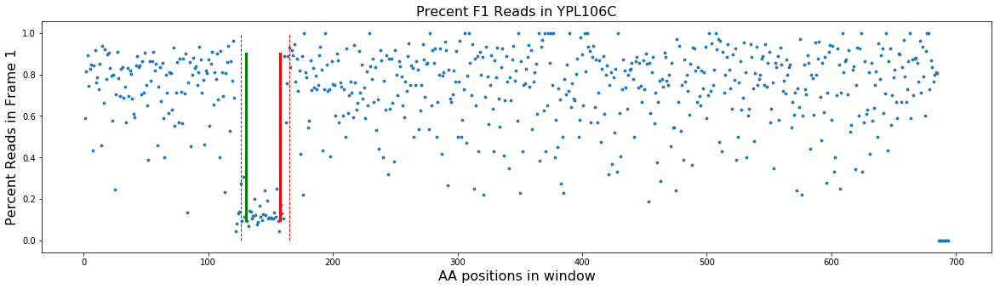


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL004C	p-value: 5.438504657184137e-07	gene-length: 1027	shift-start-position: 228	shift-length 70
Simulated Percent: 0.9


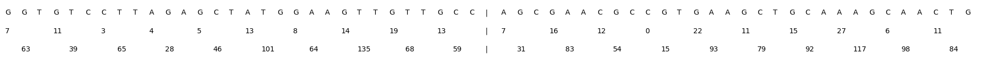

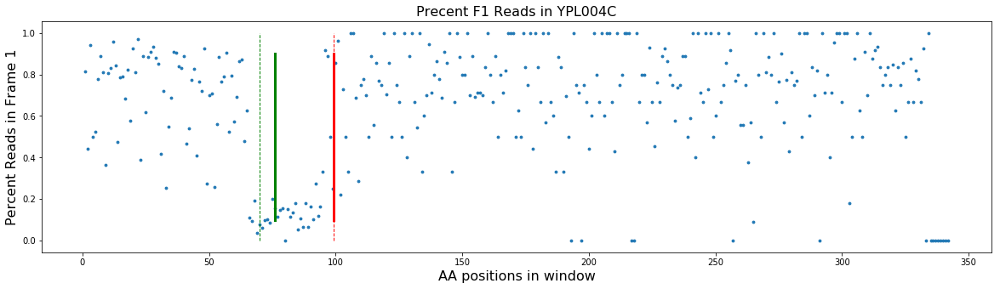


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPR033C	p-value: 7.332170952260288e-17	gene-length: 1642	shift-start-position: 1101	shift-length 127
Simulated Percent: 0.7


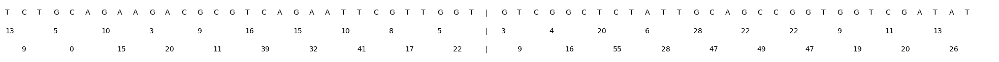

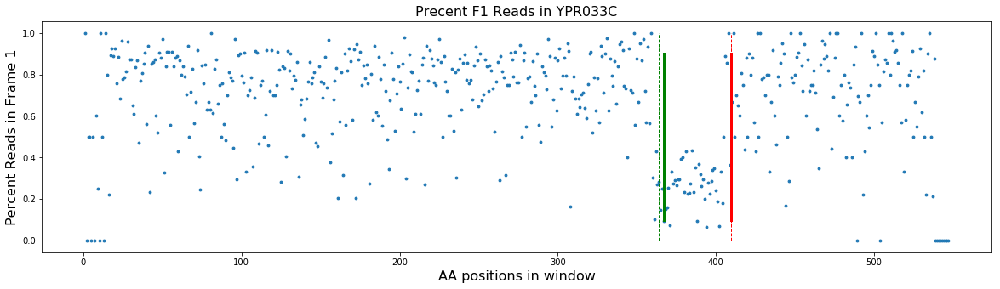


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPR145W	p-value: 1.7677461698919848e-63	gene-length: 1720	shift-start-position: 1116	shift-length 56
Simulated Percent: 0.9


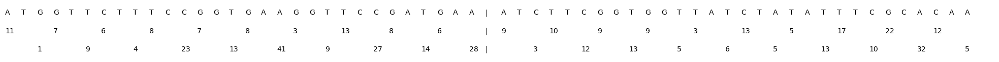

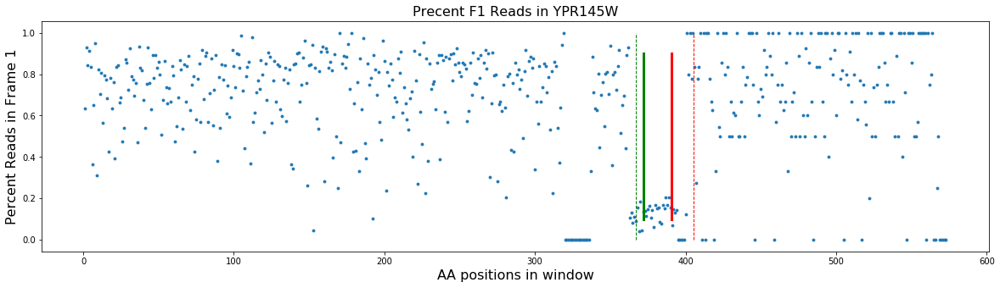


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPR165W	p-value: 1.839401142185345e-12	gene-length: 631	shift-start-position: 222	shift-length 143
Simulated Percent: 0.9


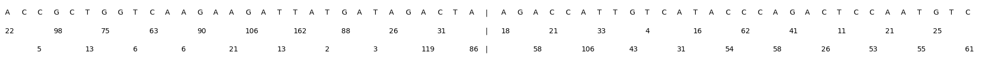

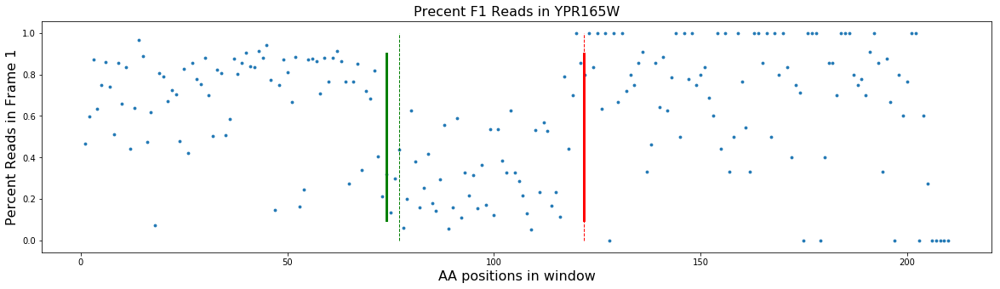


--------------------------------------------------------------------------------------------------------------------------------------------



In [6]:
for gene_name in shift_info_dict:
    if gene_name not in all_info_dict:
        continue
    Info_string = all_info_dict[gene_name]["Info_string"]
    letters = all_info_dict[gene_name]["letters"]
    reads_1 = all_info_dict[gene_name]["read_1"]
    reads_2 = all_info_dict[gene_name]["read_2"]
    percents = all_info_dict[gene_name]["percents"]
        
    print(Info_string)
    print("Simulated Percent: " + str(shift_info_dict[gene_name]["percent"]))
    table_vals = []
    #print(letters)
    #print(reads_1)
    #print(reads_2)
    table_vals.append(letters)
    table_vals.append(reads_1)
    table_vals.append(reads_2)
    
    # Draw table
    plt.figure(1, figsize=(35, 2))
    ax = subplot(111, frame_on=False) 
    ax.xaxis.set_visible(False) 
    ax.yaxis.set_visible(False)
    the_table = ax.table(cellText=table_vals, cellLoc='left', bbox=(0, 0, 1, 1))
    the_table.auto_set_font_size(False)
    the_table.set_fontsize(14)
    for key, cell in the_table.get_celld().items():
        cell.set_linewidth(0)
    plt.show()
    
    xs = [i+1 for i in range(0,len(percents))]
    fig, ax = plt.subplots(figsize=(20, 5))
    plt.scatter(xs, percents, s=8)
    shift = int(Info_string.split("\t")[3].split(" ")[1])/3
    shift_end = shift + int(Info_string.split("\t")[4].split(" ")[1])/3
    #plt.ylim(0.0, 1.0)
    plt.plot([shift, shift], [0.10, 0.9], 'k-', lw=3, c="green")
    real_start = shift_info_dict[gene_name]["shift_start"]/3
    plt.plot([real_start, real_start], [0.0, 1.0], '--', lw=1, c="green")
    plt.plot([shift_end, shift_end], [0.10, 0.9], 'k-', lw=3, c="red")
    real_end = shift_info_dict[gene_name]["shift_end"]/3
    plt.plot([real_end, real_end], [0.0, 1.0], '--', lw=1, c="red")
    #plt.plot([522, 522], [0.0, 1.0], '--', lw=1, c="red")
    ax.autoscale_view()
    plt.title('Precent F1 Reads in ' + gene_name,fontsize=16)
    plt.xlabel('AA positions in window',fontsize=16)
    plt.ylabel('Percent Reads in Frame 1',fontsize=16)
    plt.show()
    print("\n" + '-'*140 + "\n")

Gene: YAL054C	p-value: 4.71671627390799e-10	gene-length: 2143	shift-start-position: 879	shift-length 47


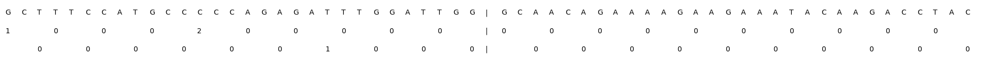

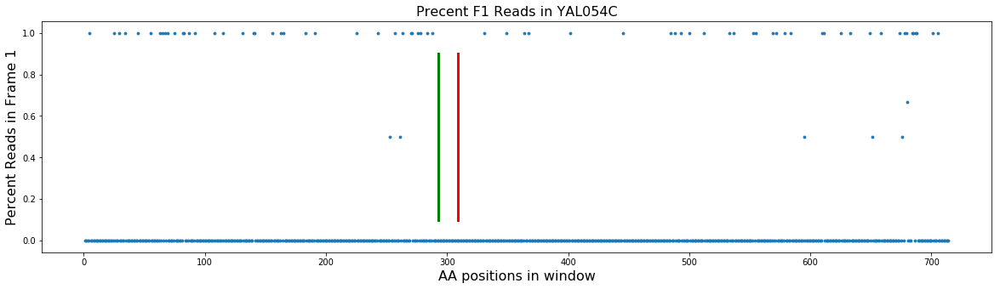


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YAR035W	p-value: 3.4972065152112606e-24	gene-length: 2065	shift-start-position: 1716	shift-length 31


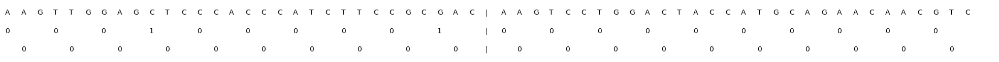

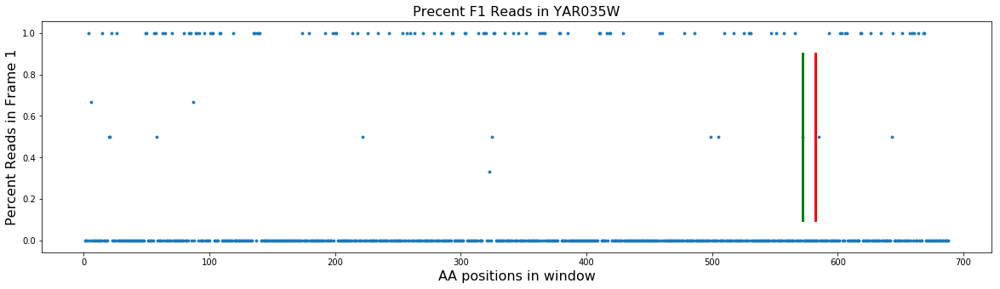


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR033W	p-value: 6.331239048798447e-08	gene-length: 2761	shift-start-position: 2250	shift-length 32


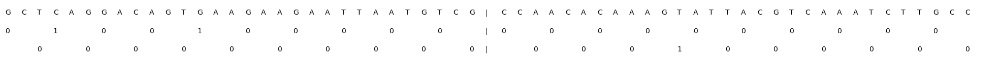

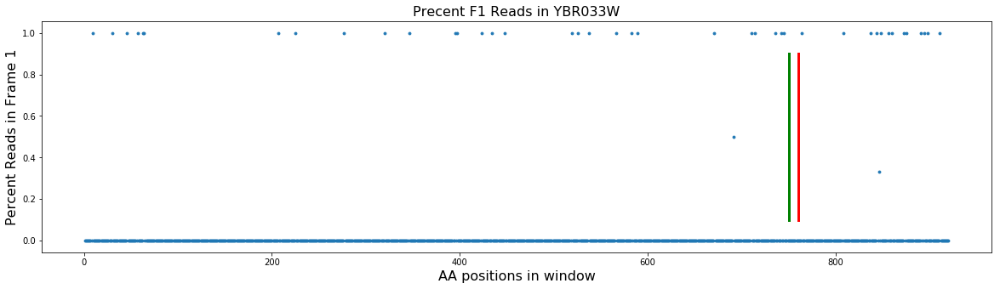


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR045C	p-value: 3.902513909745732e-08	gene-length: 1921	shift-start-position: 1305	shift-length 31


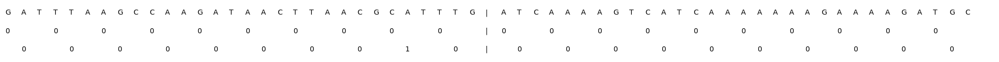

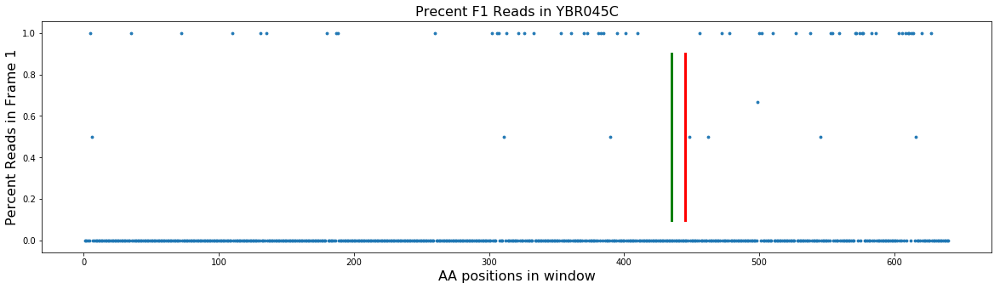


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR073W	p-value: 7.557843355019234e-10	gene-length: 2878	shift-start-position: 75	shift-length 163


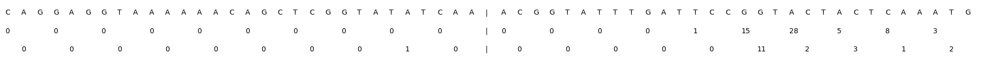

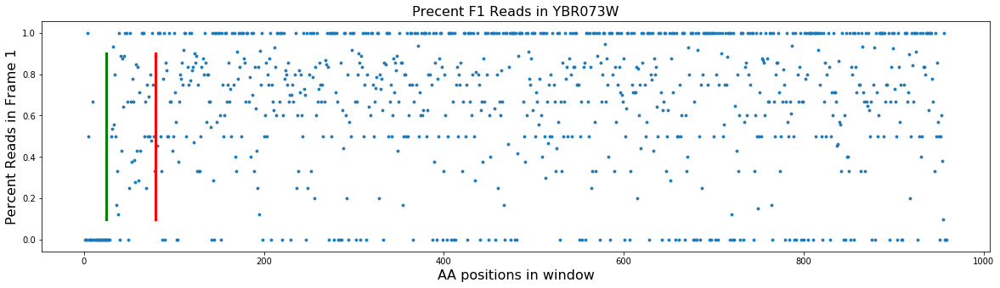


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR245C	p-value: 7.997444465298618e-09	gene-length: 3391	shift-start-position: 153	shift-length 89


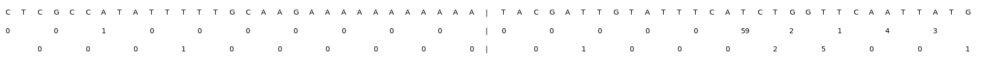

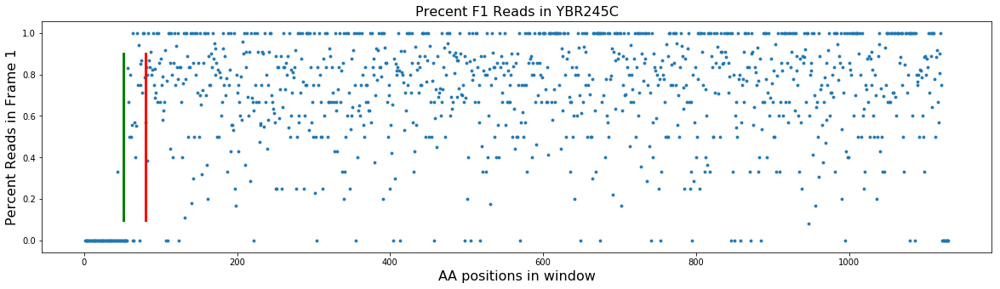


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR259W	p-value: 1.6331192531429885e-08	gene-length: 2068	shift-start-position: 543	shift-length 59


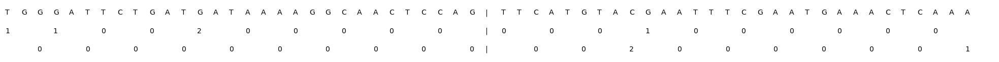

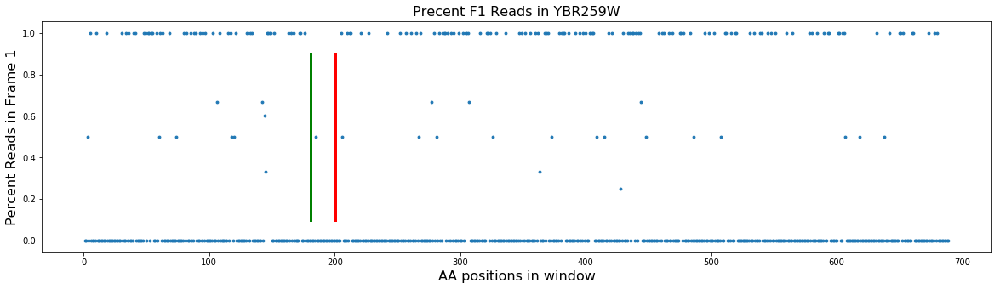


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YBR270C	p-value: 4.688675884239306e-14	gene-length: 1639	shift-start-position: 1146	shift-length 31


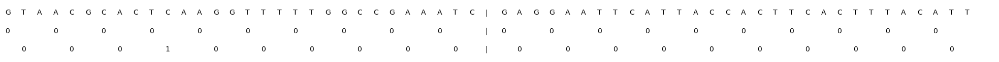

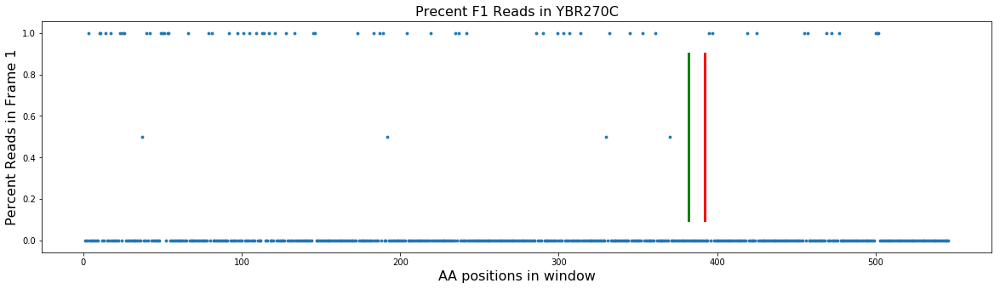


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YCR032W	p-value: 1.0931095090970133e-136	gene-length: 6505	shift-start-position: 4404	shift-length 32


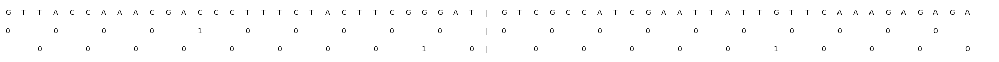

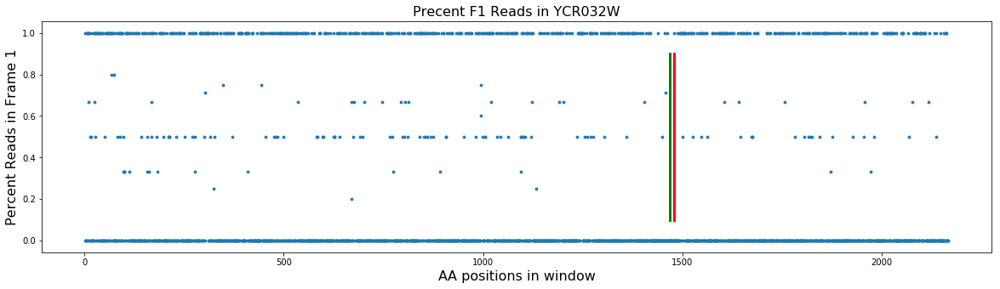


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL231C	p-value: 2.2659611653617383e-10	gene-length: 3379	shift-start-position: 792	shift-length 44


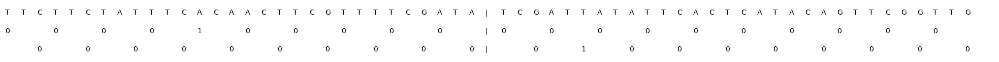

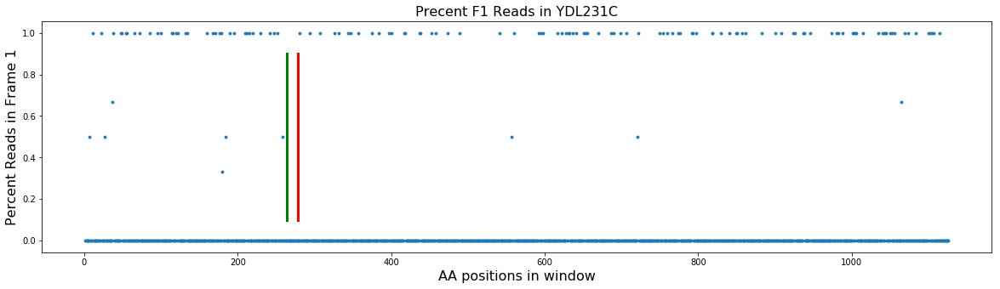


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL211C	p-value: 2.2341205438134938e-24	gene-length: 1120	shift-start-position: 1056	shift-length 46


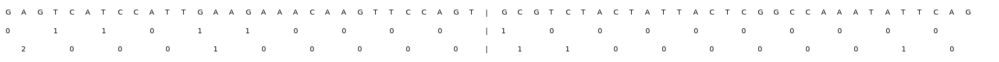

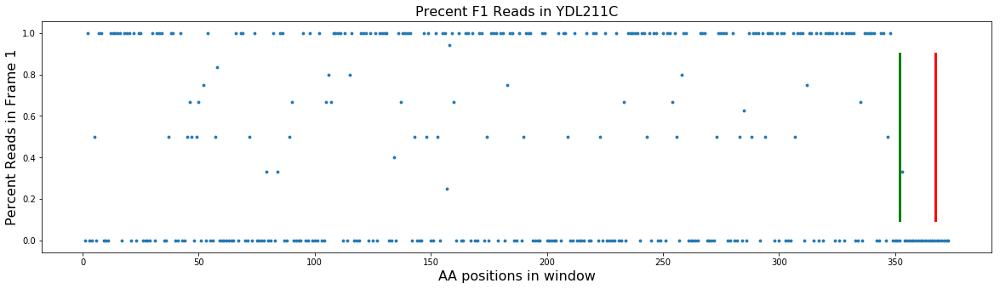


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDL109C	p-value: 4.4677207639544997e-13	gene-length: 1945	shift-start-position: 1308	shift-length 35


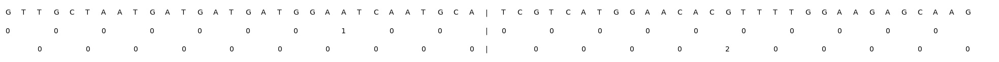

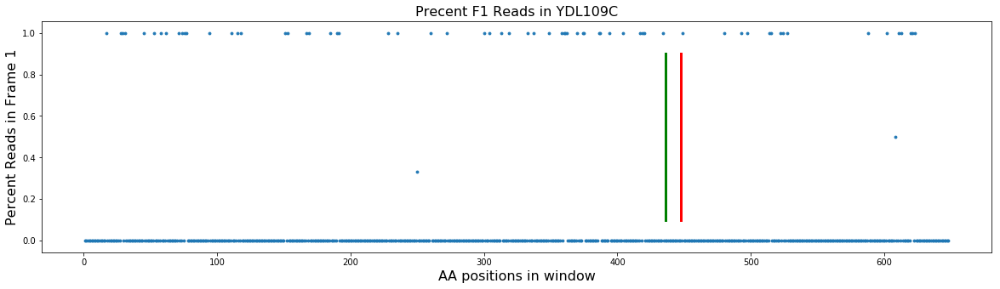


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR082W	p-value: 2.2961291817510457e-08	gene-length: 1486	shift-start-position: 1053	shift-length 31


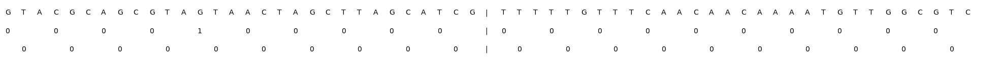

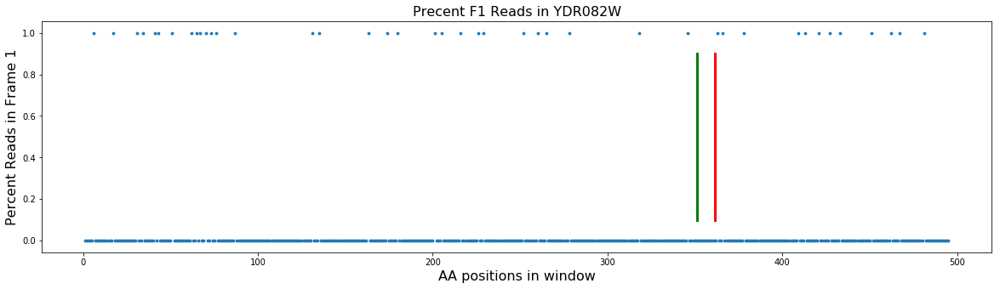


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR106W	p-value: 3.930895386796636e-15	gene-length: 856	shift-start-position: 705	shift-length 38


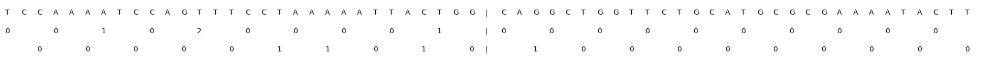

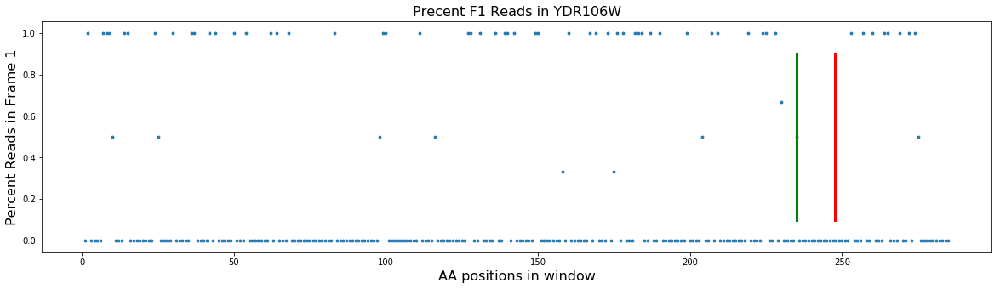


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR249C	p-value: 7.531659549670998e-06	gene-length: 1123	shift-start-position: 483	shift-length 56


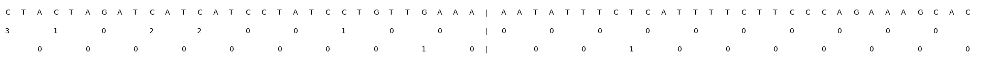

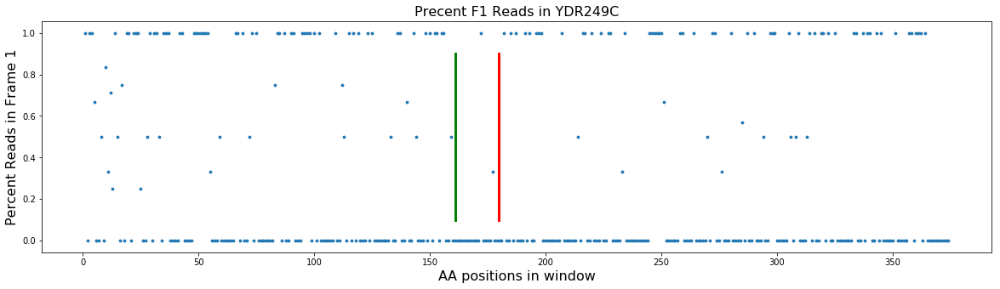


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR285W	p-value: 1.0007789682322698e-13	gene-length: 2629	shift-start-position: 1872	shift-length 38


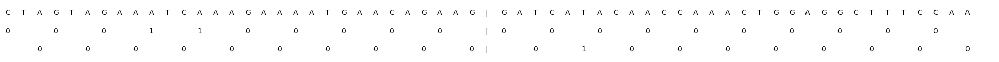

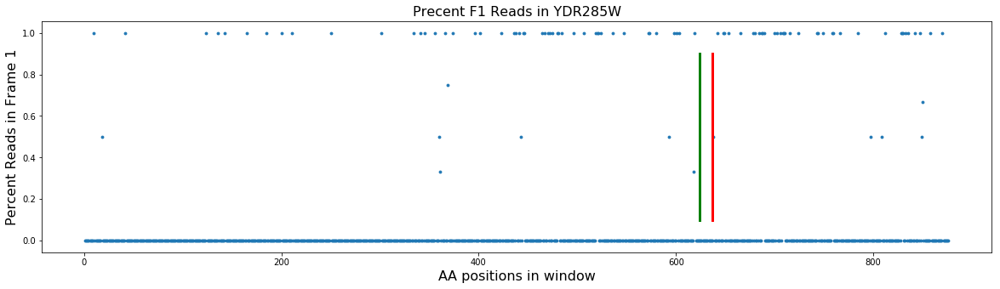


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YDR409W	p-value: 1.138189958096167e-05	gene-length: 2716	shift-start-position: 1050	shift-length 80


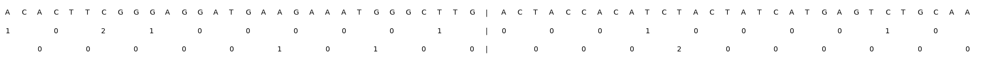

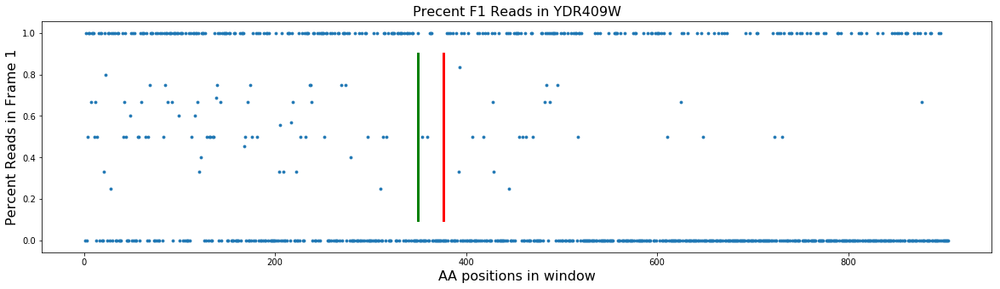


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER184C	p-value: 9.662040667128654e-23	gene-length: 2386	shift-start-position: 1737	shift-length 40


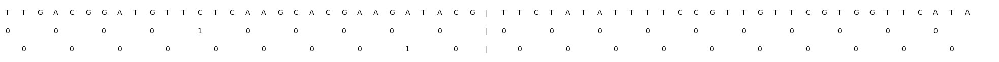

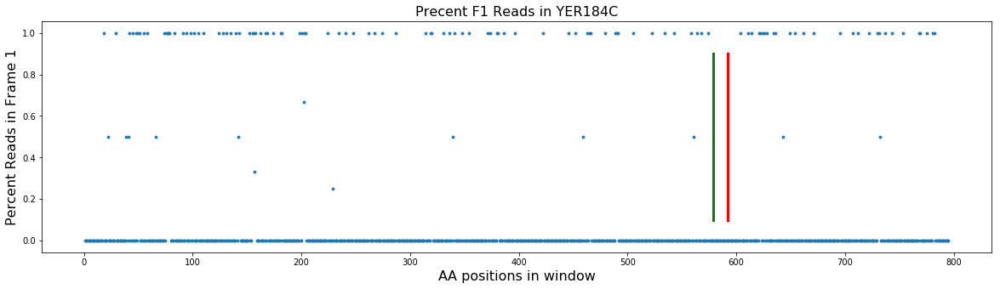


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YER185W	p-value: 8.238126612582149e-08	gene-length: 913	shift-start-position: 531	shift-length 83


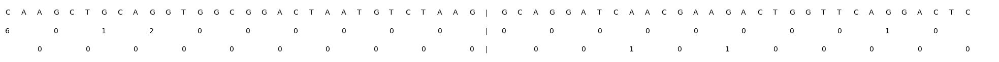

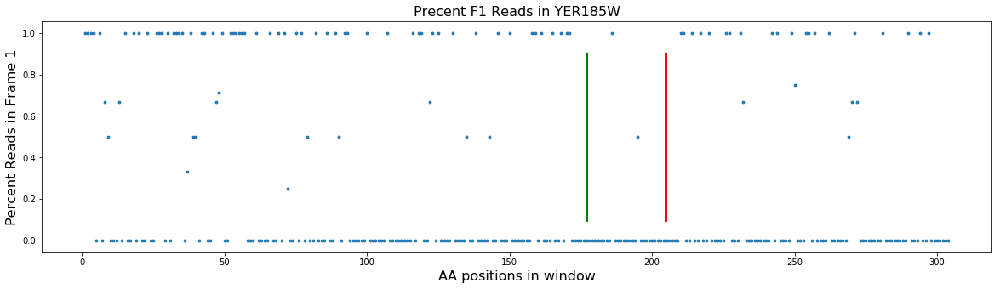


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL263W	p-value: 7.48930631608389e-09	gene-length: 1144	shift-start-position: 969	shift-length 41


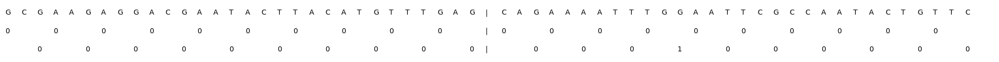

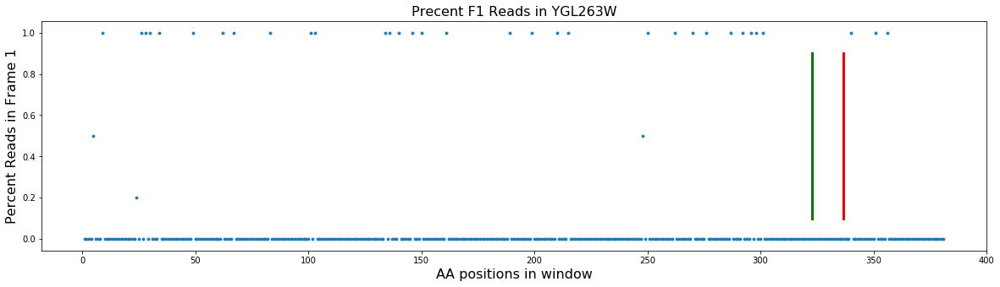


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGL220W	p-value: 8.285942104869148e-07	gene-length: 364	shift-start-position: 78	shift-length 61


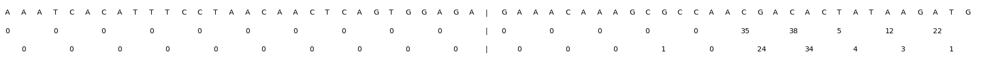

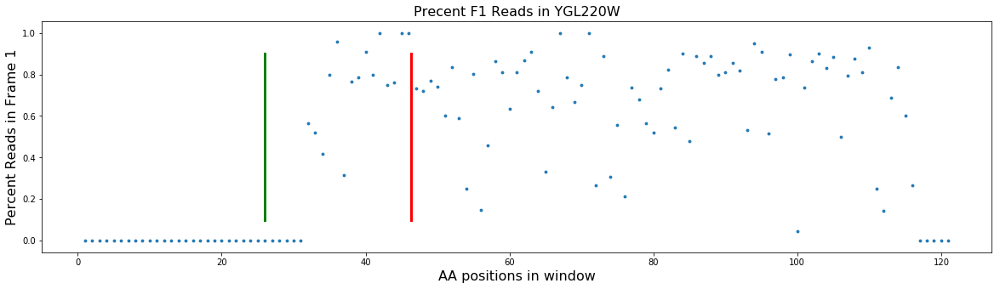


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR070W	p-value: 1.0539451540900799e-33	gene-length: 3469	shift-start-position: 2754	shift-length 32


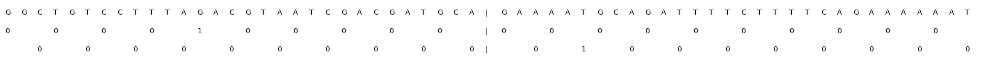

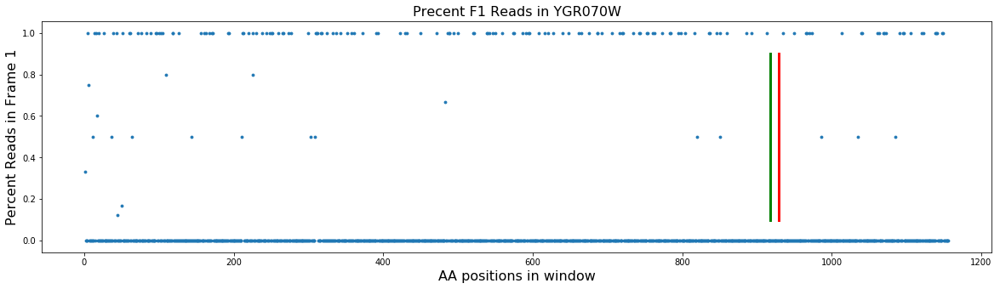


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YGR168C	p-value: 1.3687516608492182e-23	gene-length: 1132	shift-start-position: 1014	shift-length 35


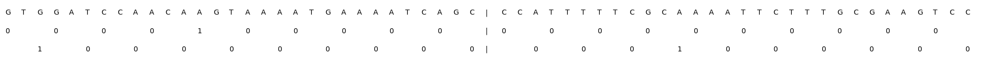

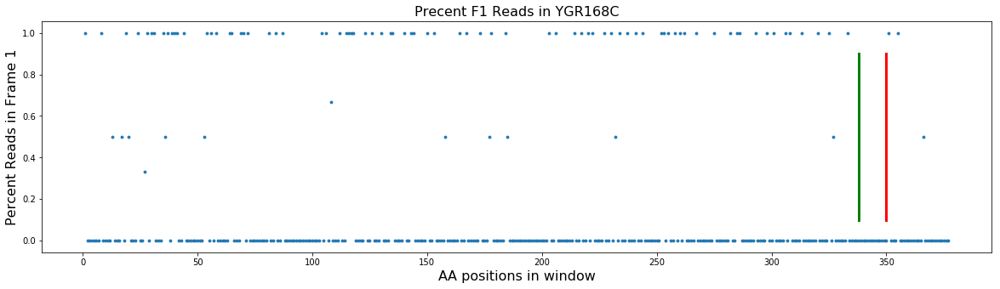


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YIL013C	p-value: 5.992574051196147e-10	gene-length: 4237	shift-start-position: 1887	shift-length 67


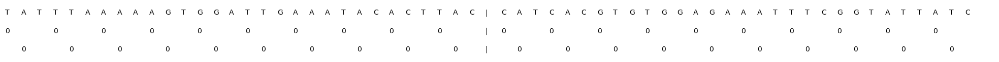

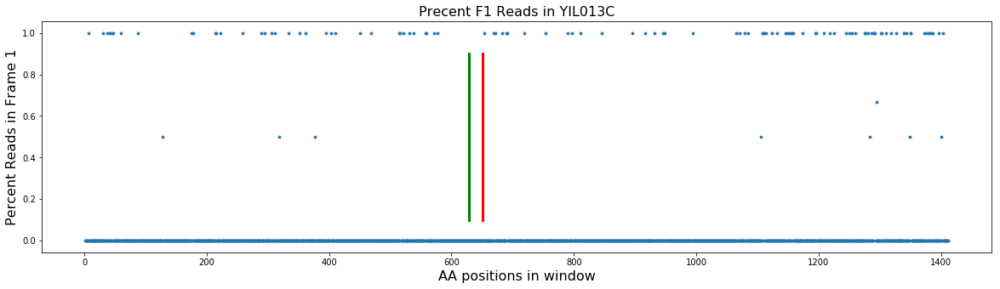


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YIL009C-A	p-value: 8.65133590204192e-36	gene-length: 548	shift-start-position: 279	shift-length 265


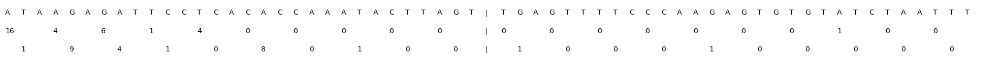

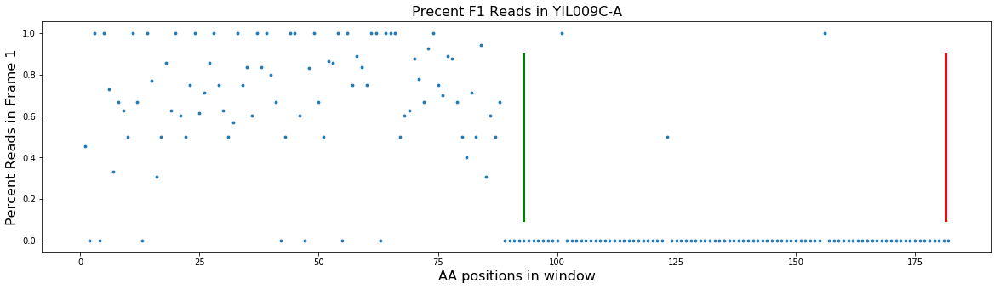


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YIR028W	p-value: 5.7103049253691056e-05	gene-length: 1909	shift-start-position: 1623	shift-length 37


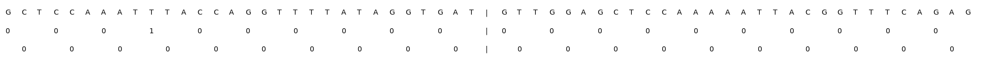

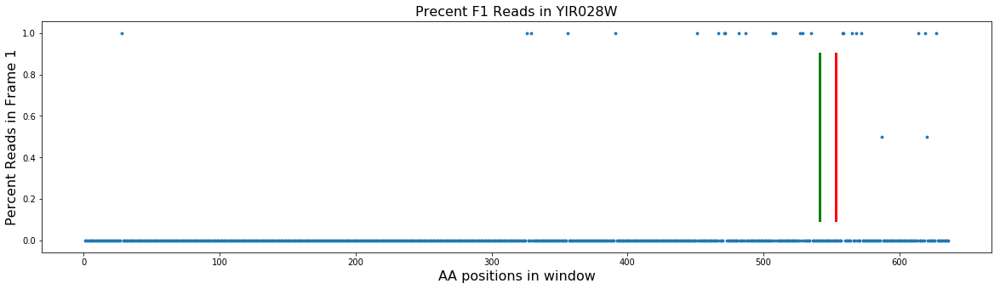


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YKL222C	p-value: 1.1365078363959627e-13	gene-length: 2119	shift-start-position: 1110	shift-length 40


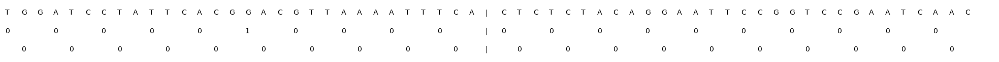

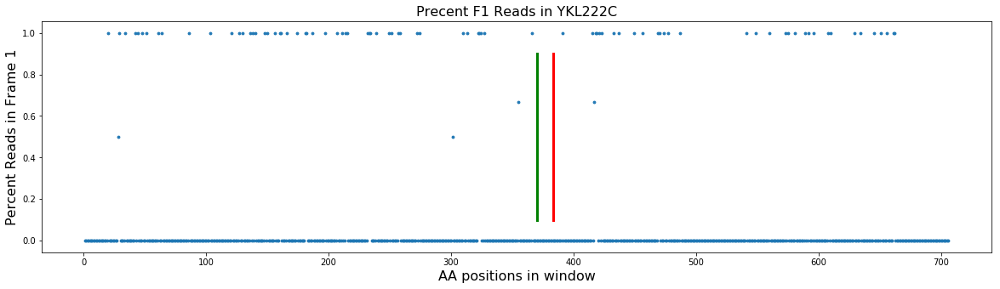


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR152C	p-value: 7.01741504365053e-34	gene-length: 1732	shift-start-position: 1497	shift-length 31


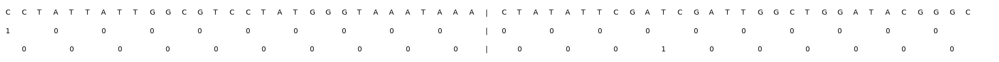

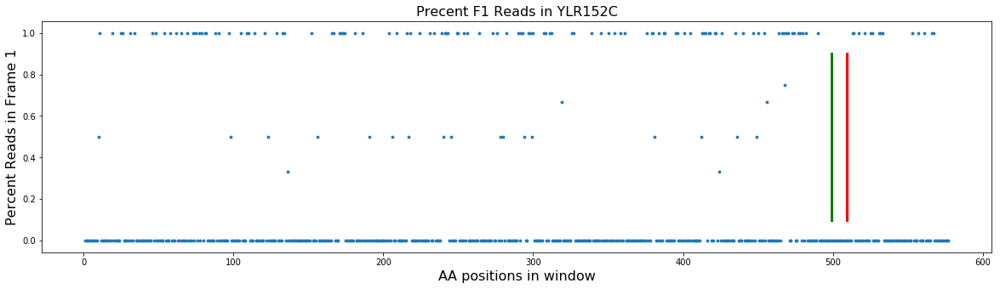


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YLR411W	p-value: 1.1684442491991989e-05	gene-length: 727	shift-start-position: 471	shift-length 31


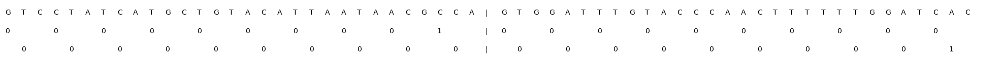

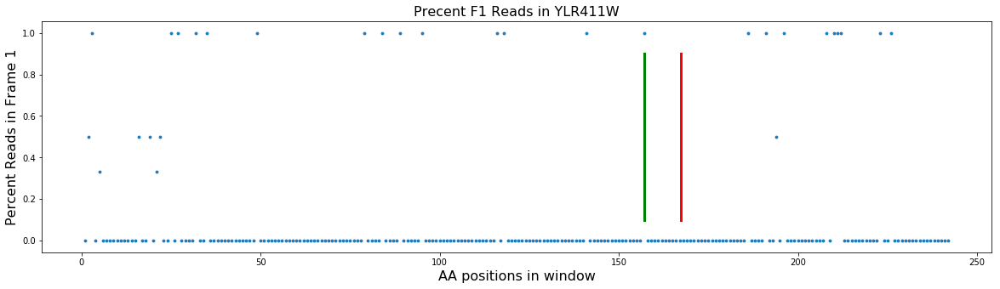


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR056C	p-value: 1.695622166224528e-09	gene-length: 931	shift-start-position: 750	shift-length 37


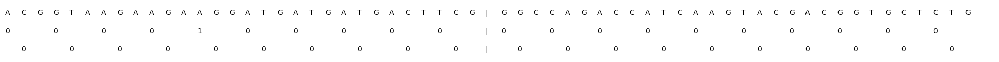

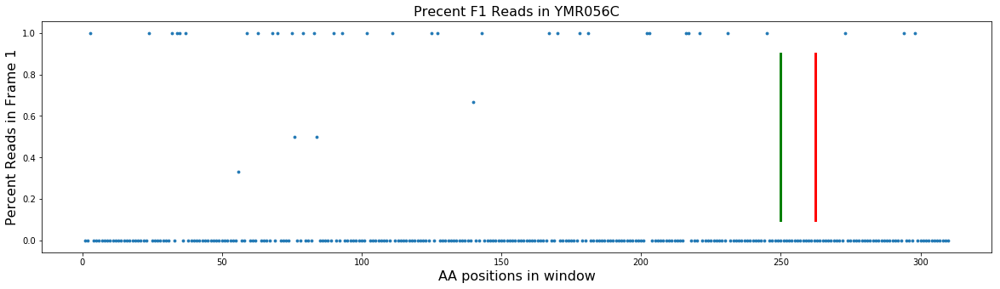


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR064W	p-value: 7.941494907409162e-05	gene-length: 1558	shift-start-position: 36	shift-length 61


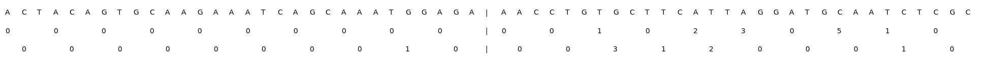

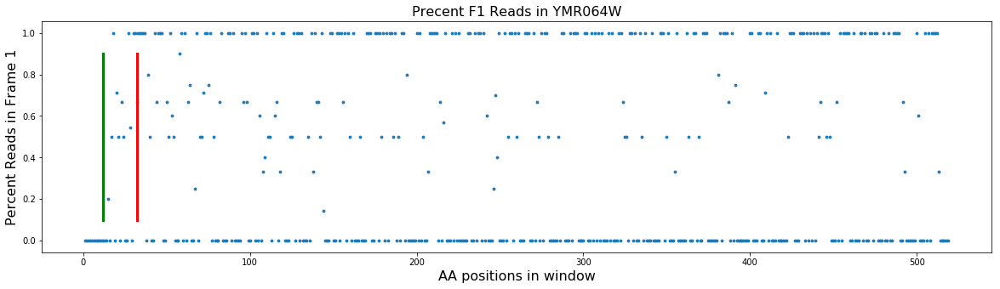


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YMR280C	p-value: 1.3416788735635595e-29	gene-length: 4303	shift-start-position: 1299	shift-length 32


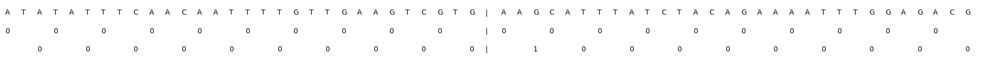

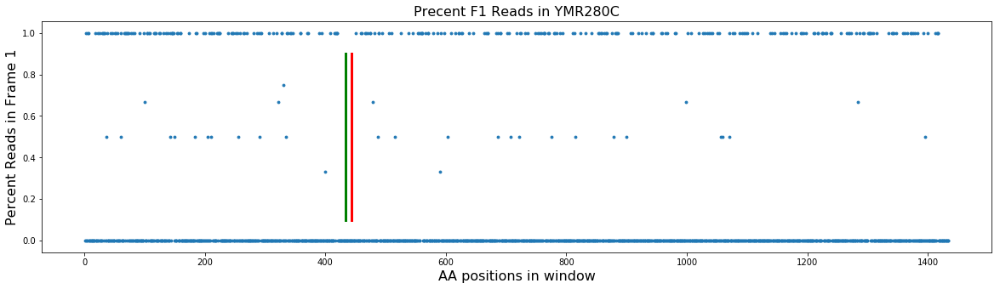


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL279W	p-value: 9.613112927617208e-08	gene-length: 1987	shift-start-position: 768	shift-length 41


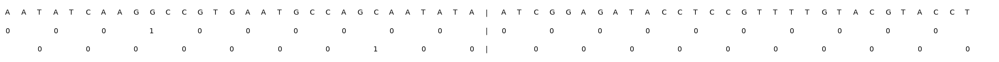

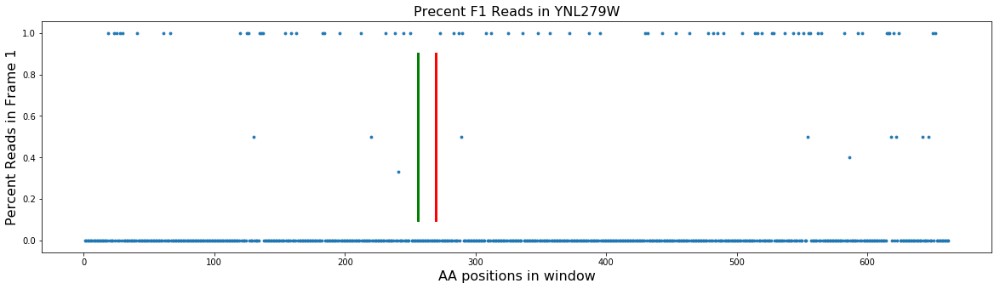


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL187W	p-value: 9.170915970360722e-10	gene-length: 1075	shift-start-position: 756	shift-length 43


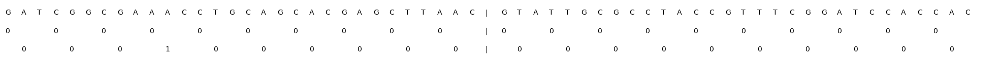

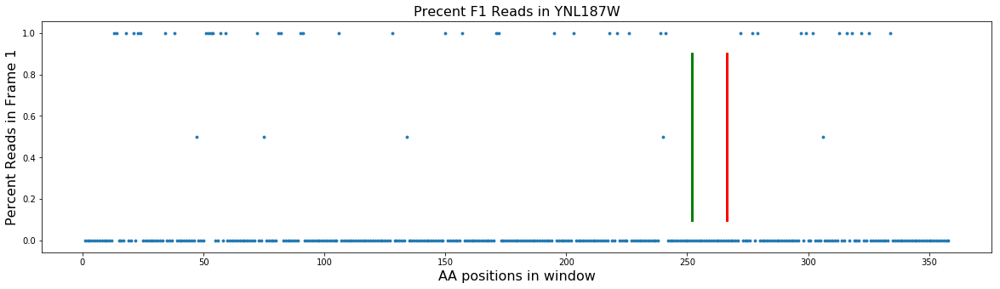


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YNL093W	p-value: 6.808055398252202e-12	gene-length: 664	shift-start-position: 453	shift-length 32


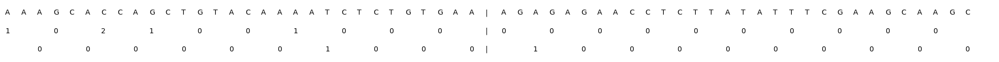

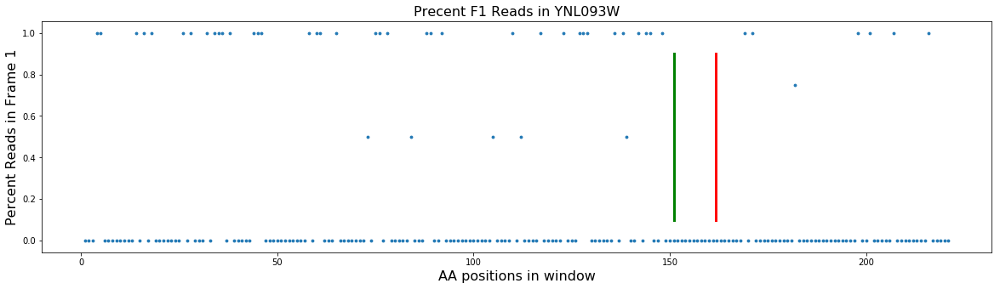


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL075C	p-value: 8.741930420449534e-06	gene-length: 3886	shift-start-position: 2178	shift-length 31


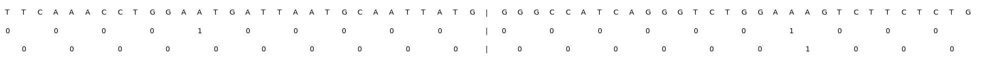

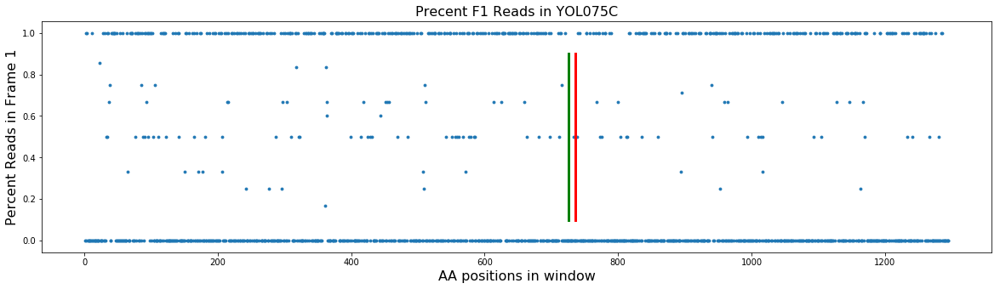


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOL068C	p-value: 1.2934592549479605e-05	gene-length: 1513	shift-start-position: 63	shift-length 59


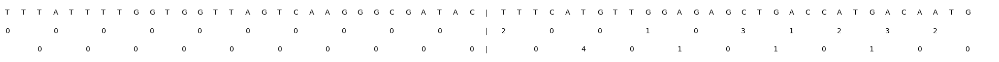

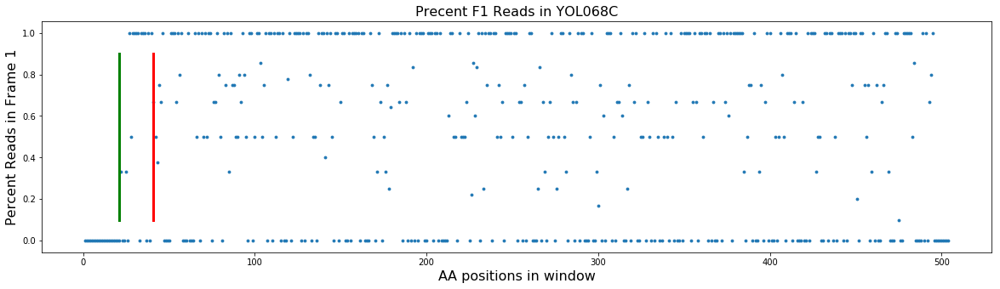


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR011W	p-value: 6.148921636171908e-75	gene-length: 4186	shift-start-position: 3147	shift-length 43


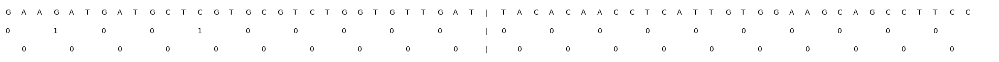

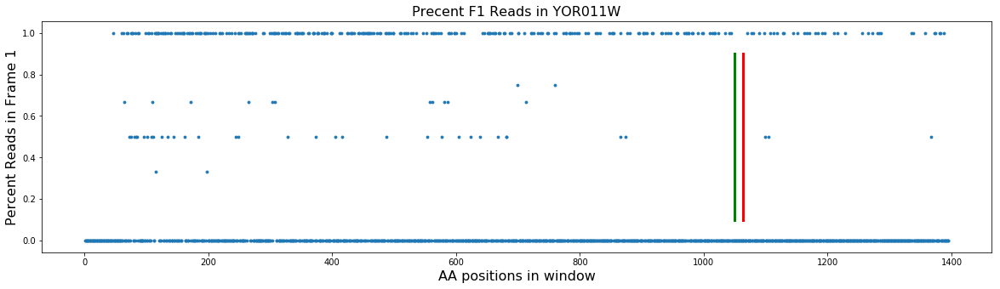


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR030W	p-value: 1.2771496764397643e-05	gene-length: 1861	shift-start-position: 1119	shift-length 32


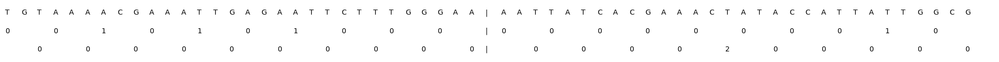

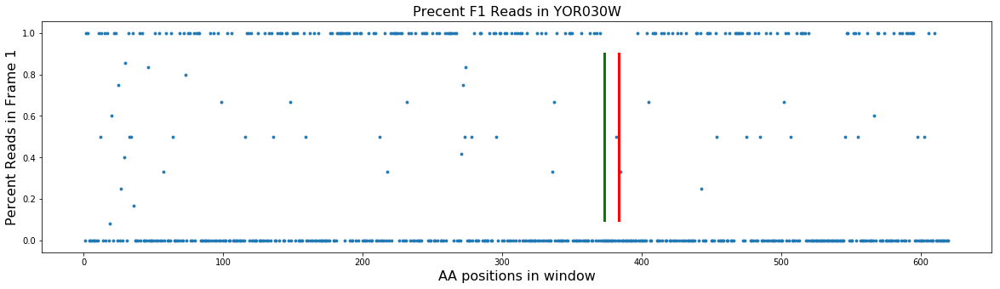


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR100C	p-value: 4.021704448424561e-06	gene-length: 985	shift-start-position: 606	shift-length 38


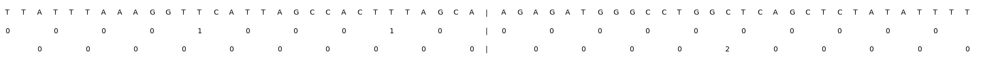

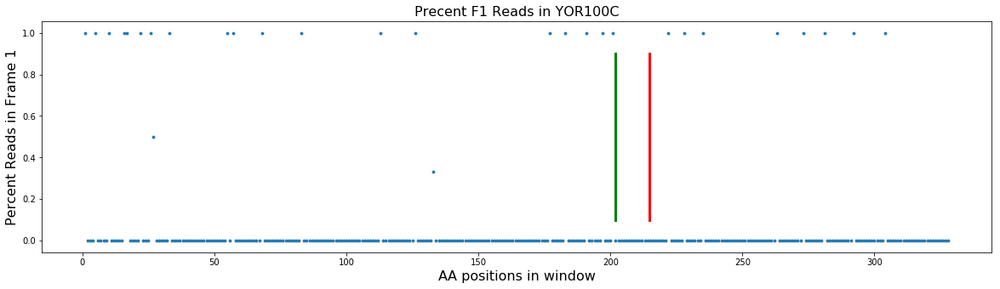


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR129C	p-value: 3.723529661559959e-07	gene-length: 2683	shift-start-position: 2298	shift-length 55


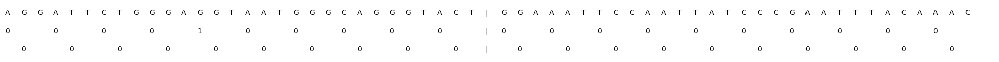

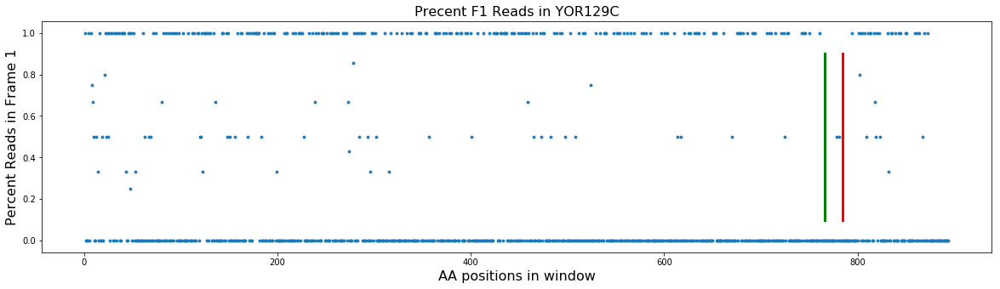


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR137C	p-value: 5.093851260691301e-05	gene-length: 1870	shift-start-position: 159	shift-length 41


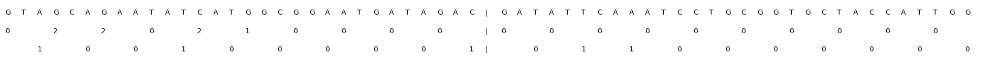

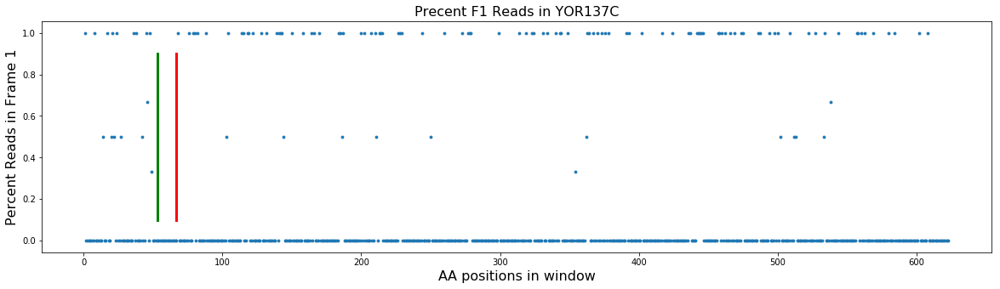


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR178C	p-value: 4.849736681416911e-05	gene-length: 2383	shift-start-position: 651	shift-length 61


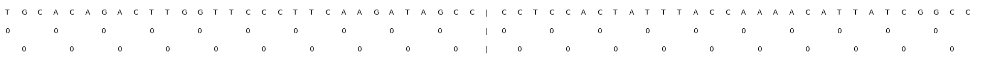

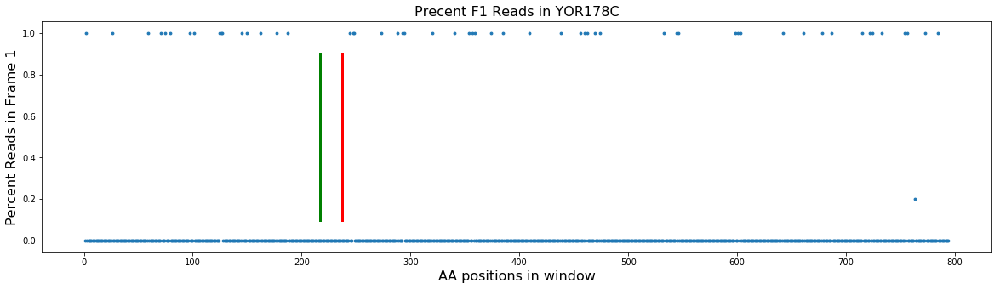


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR239W	p-value: 5.264083347128624e-205	gene-length: 1889	shift-start-position: 834	shift-length 1051


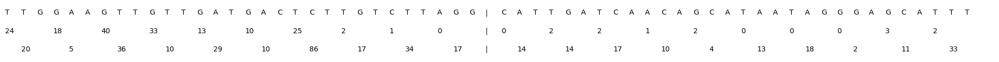

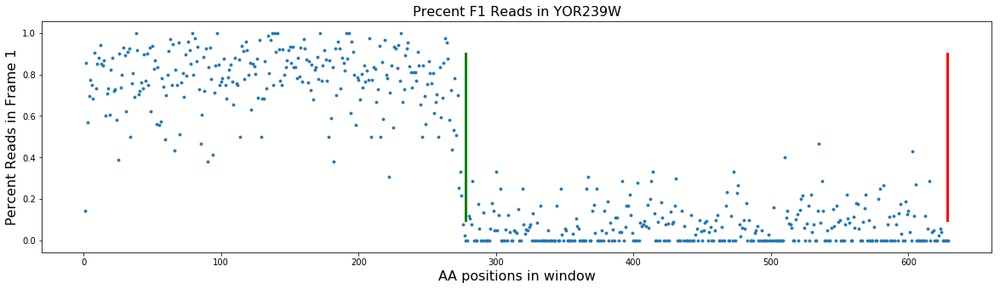


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YOR389W	p-value: 2.4961114880684897e-06	gene-length: 1876	shift-start-position: 348	shift-length 113


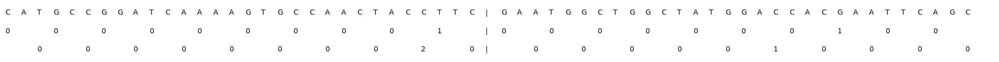

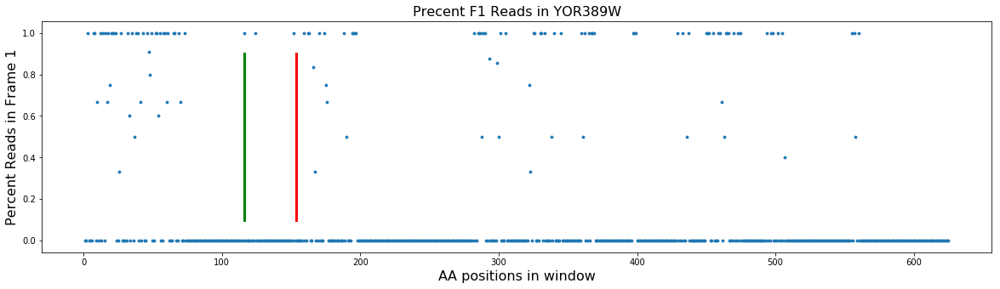


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL248C	p-value: 2.038282846736585e-14	gene-length: 2647	shift-start-position: 2394	shift-length 38


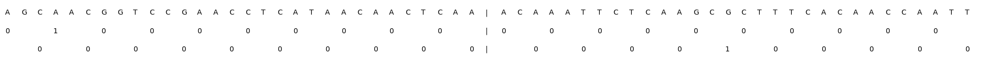

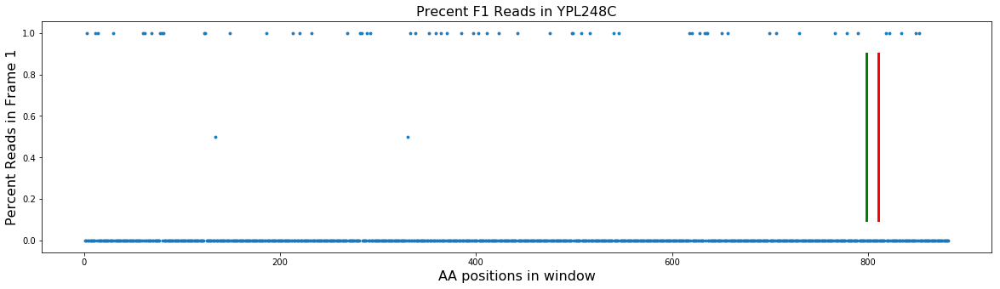


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL052W	p-value: 1.8406044606030324e-18	gene-length: 881	shift-start-position: 261	shift-length 32


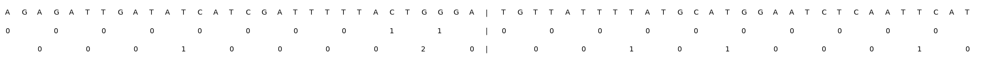

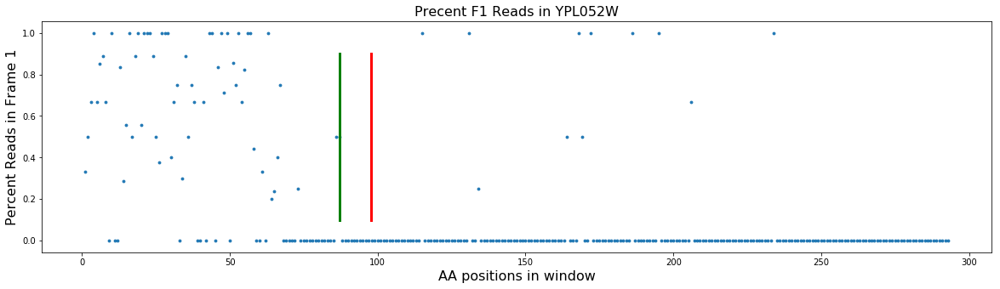


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPL036W	p-value: 1.7885771925955265e-11	gene-length: 2845	shift-start-position: 1152	shift-length 32


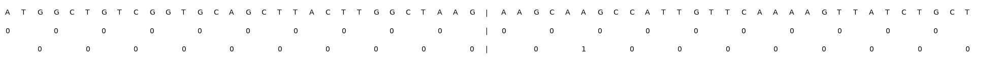

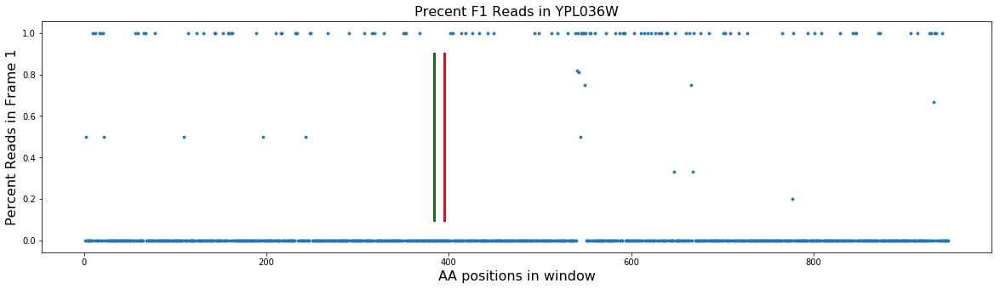


--------------------------------------------------------------------------------------------------------------------------------------------

Gene: YPR015C	p-value: 9.7061924818555e-10	gene-length: 745	shift-start-position: 639	shift-length 44


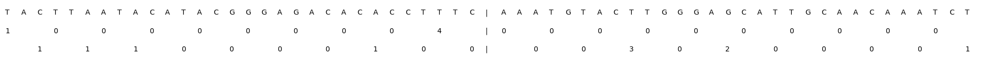

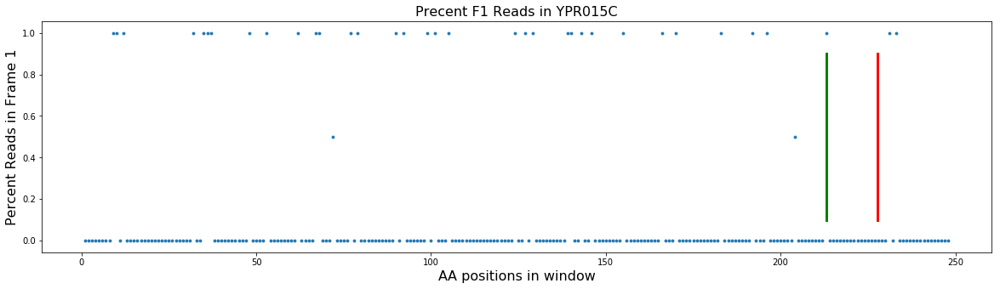


--------------------------------------------------------------------------------------------------------------------------------------------



In [28]:
for gene_name in all_info_dict:
    if gene_name in shift_info_dict:
        continue
    Info_string = all_info_dict[gene_name]["Info_string"]
    letters = all_info_dict[gene_name]["letters"]
    reads_1 = all_info_dict[gene_name]["read_1"]
    reads_2 = all_info_dict[gene_name]["read_2"]
    percents = all_info_dict[gene_name]["percents"]
        
    print(Info_string)
    table_vals = []
    #print(letters)
    #print(reads_1)
    #print(reads_2)
    table_vals.append(letters)
    table_vals.append(reads_1)
    table_vals.append(reads_2)
    
    # Draw table
    plt.figure(1, figsize=(35, 2))
    ax = subplot(111, frame_on=False) 
    ax.xaxis.set_visible(False) 
    ax.yaxis.set_visible(False)
    the_table = ax.table(cellText=table_vals, cellLoc='left', bbox=(0, 0, 1, 1))
    the_table.auto_set_font_size(False)
    the_table.set_fontsize(14)
    for key, cell in the_table.get_celld().items():
        cell.set_linewidth(0)
    plt.show()
    
    xs = [i+1 for i in range(0,len(percents))]
    fig, ax = plt.subplots(figsize=(20, 5))
    plt.scatter(xs, percents, s=8)
    shift = int(Info_string.split("\t")[3].split(" ")[1])/3
    shift_end = shift + int(Info_string.split("\t")[4].split(" ")[1])/3
    #plt.ylim(0.0, 1.0)
    plt.plot([shift, shift], [0.10, 0.9], 'k-', lw=3, c="green")
    plt.plot([shift_end, shift_end], [0.10, 0.9], 'k-', lw=3, c="red")
    #plt.plot([522, 522], [0.0, 1.0], '--', lw=1, c="red")
    ax.autoscale_view()
    plt.title('Precent F1 Reads in ' + gene_name,fontsize=16)
    plt.xlabel('AA positions in window',fontsize=16)
    plt.ylabel('Percent Reads in Frame 1',fontsize=16)
    plt.show()
    print("\n" + '-'*140 + "\n")

Simulated Percent: 0.4
159 212


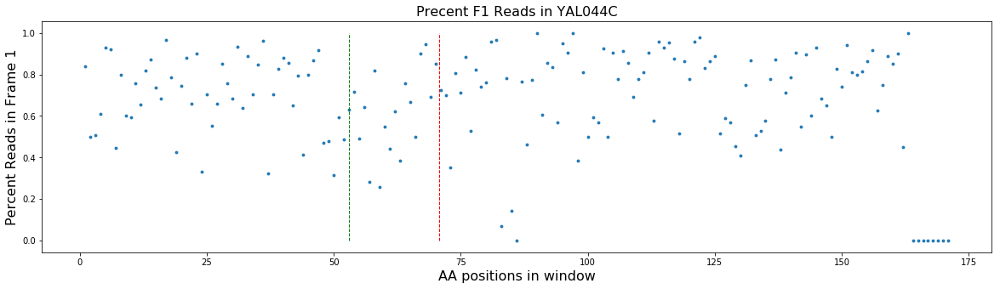

Simulated Percent: 0.4
2004 2056


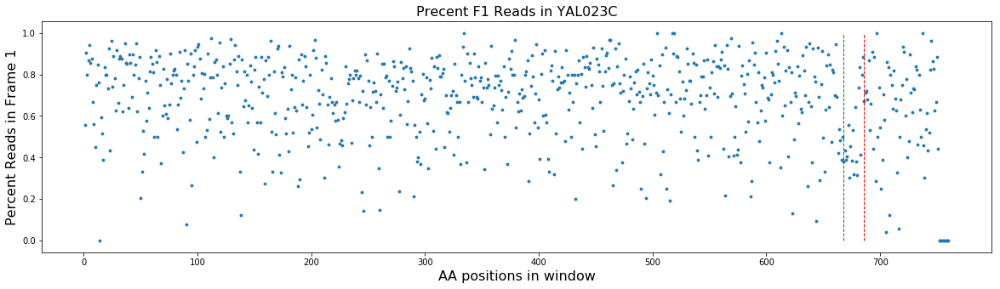

Simulated Percent: 0.05
954 1094


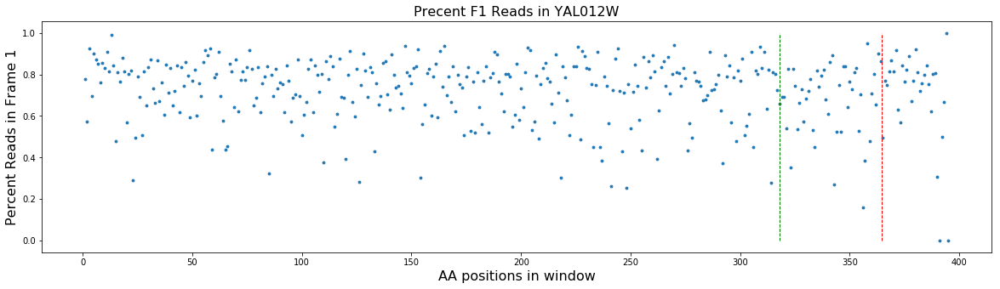

Simulated Percent: 0.1
288 340


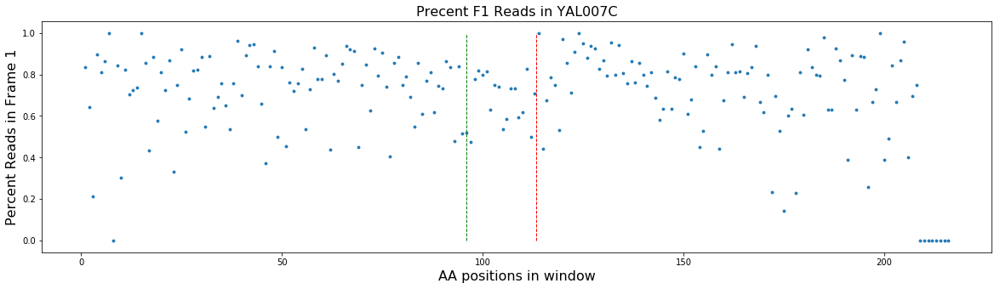

Simulated Percent: 0.6
75 214


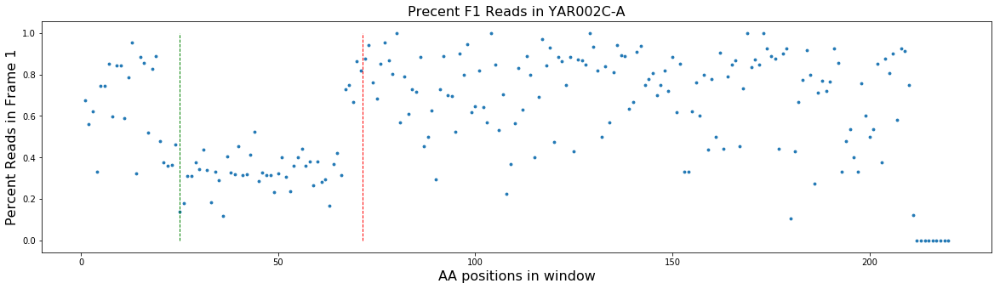

Simulated Percent: 0.7
144 223


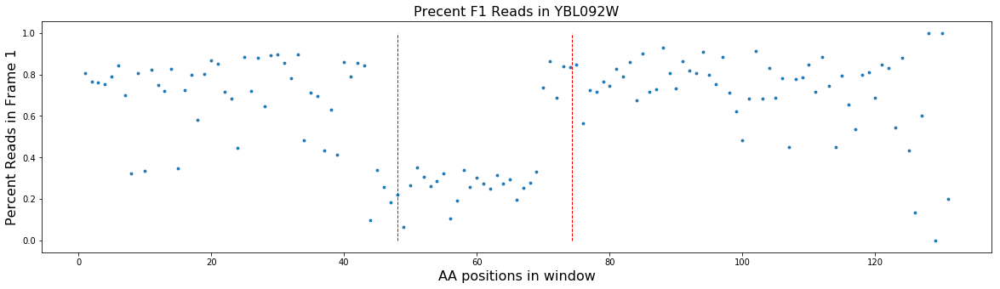

Simulated Percent: 0.2
57 119


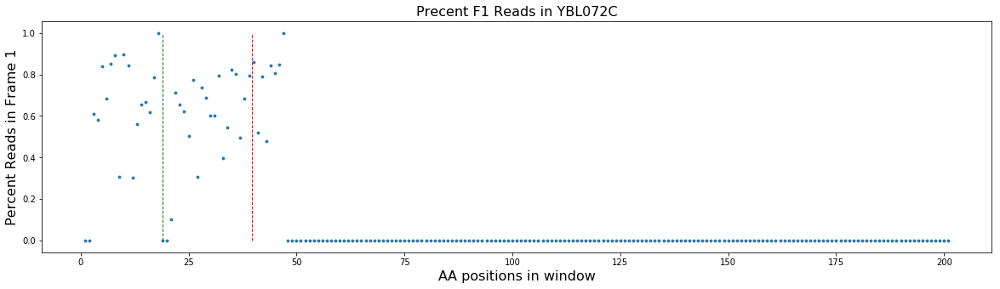

Simulated Percent: 0.4
171 227


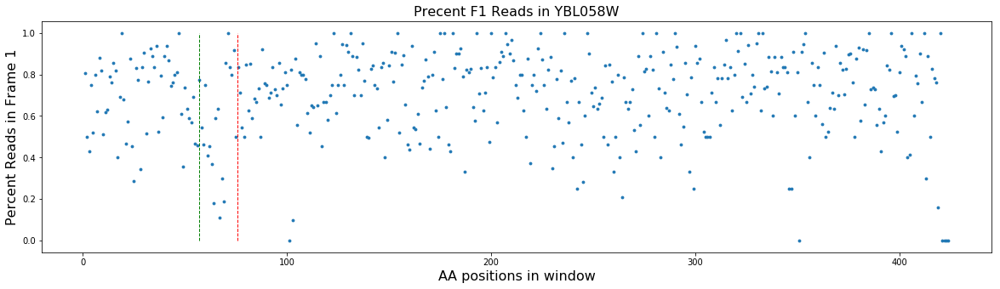

Simulated Percent: 0.1
351 517


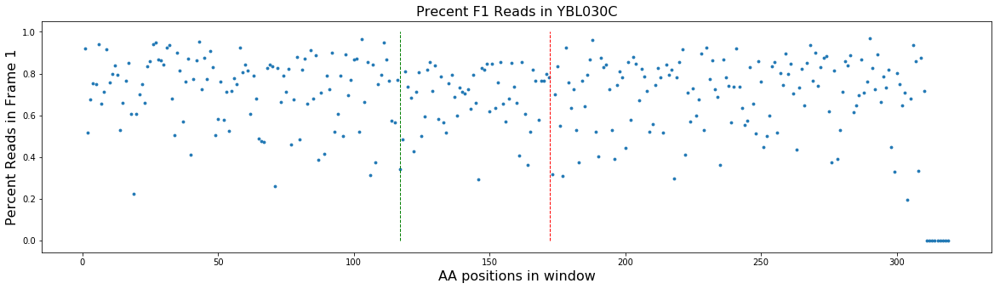

Simulated Percent: 0.05
219 277


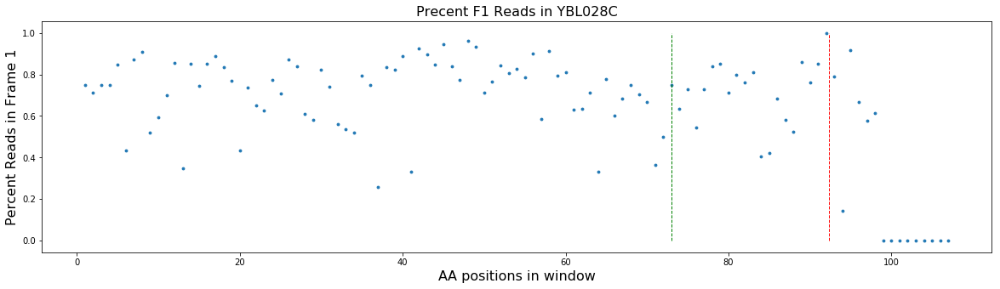

Simulated Percent: 0.05
228 283


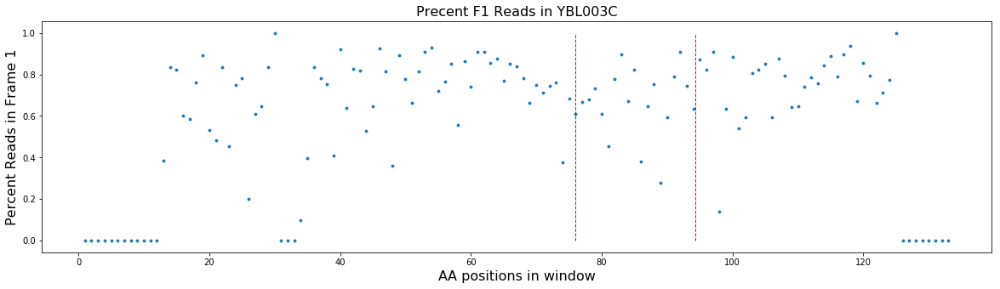

Simulated Percent: 0.5
63 145


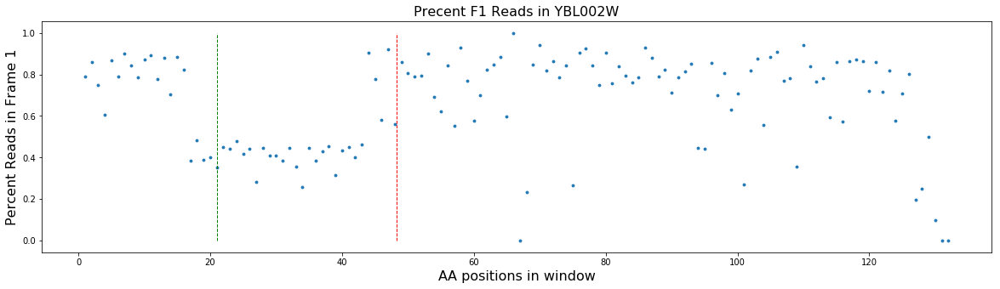

Simulated Percent: 0.1
219 295


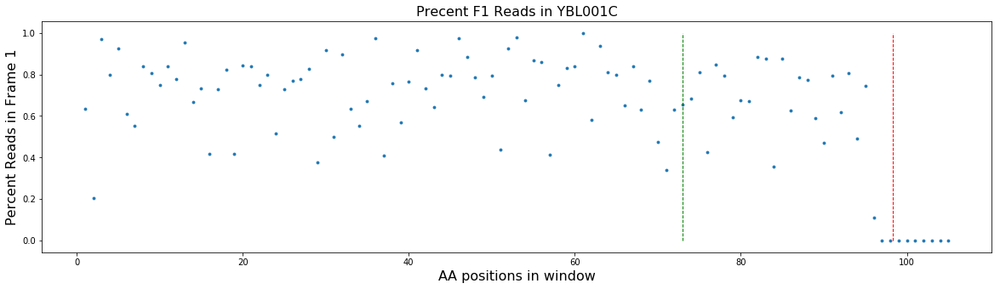

Simulated Percent: 0.7
429 493


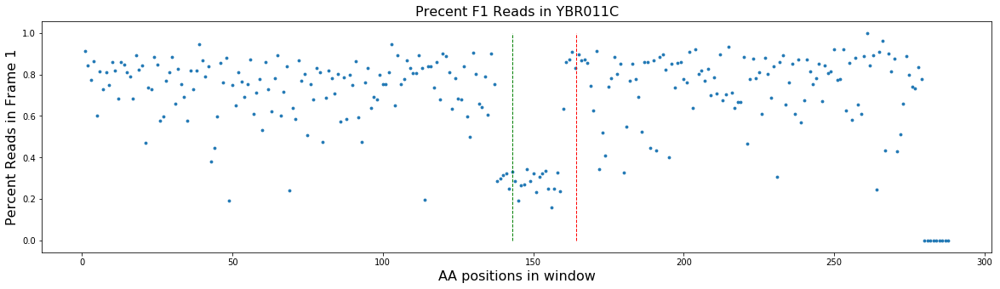

Simulated Percent: 0.9
93 170


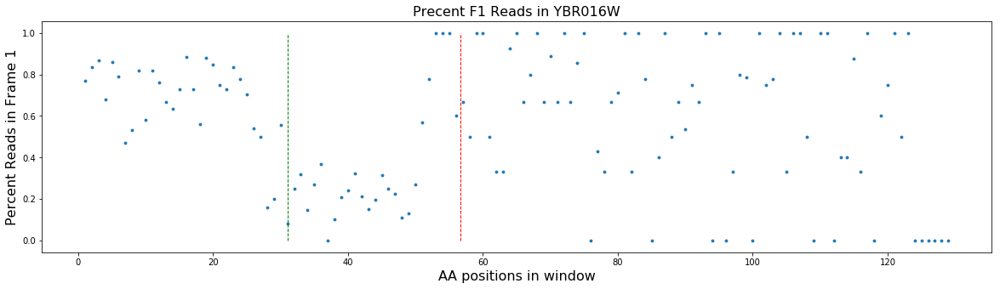

Simulated Percent: 0.5
1056 1108


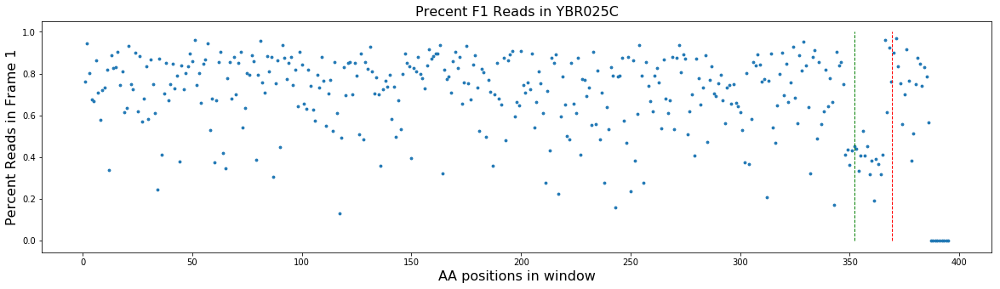

Simulated Percent: 0.8
516 569


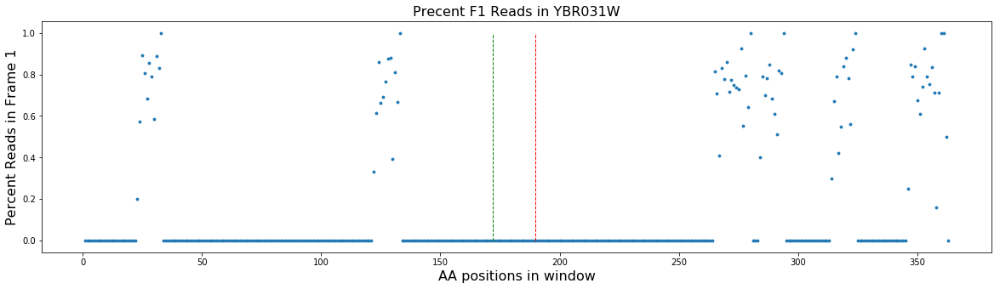

Simulated Percent: 0.5
576 676


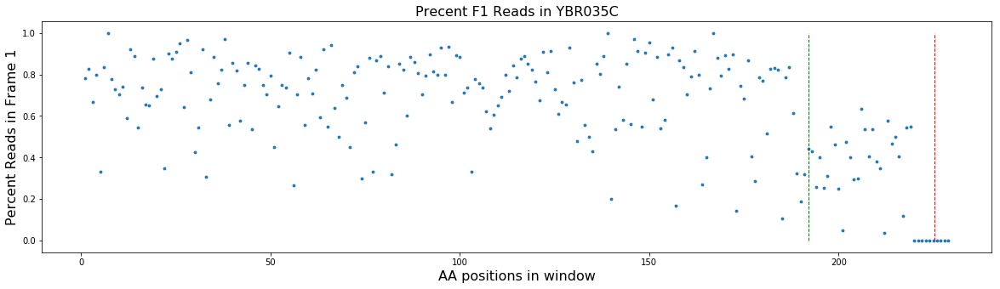

Simulated Percent: 0.5
663 754


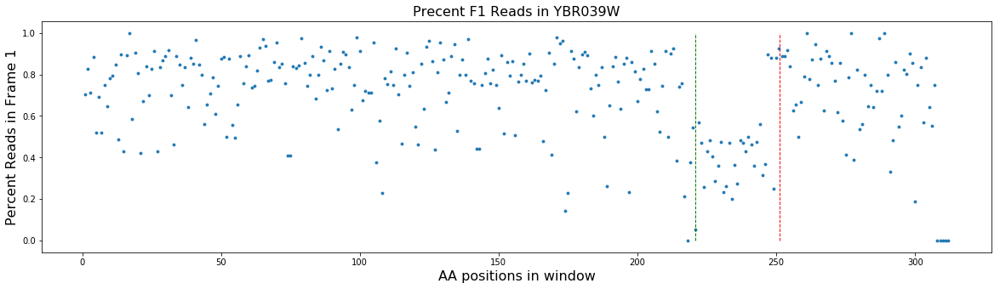

Simulated Percent: 0.3
69 136


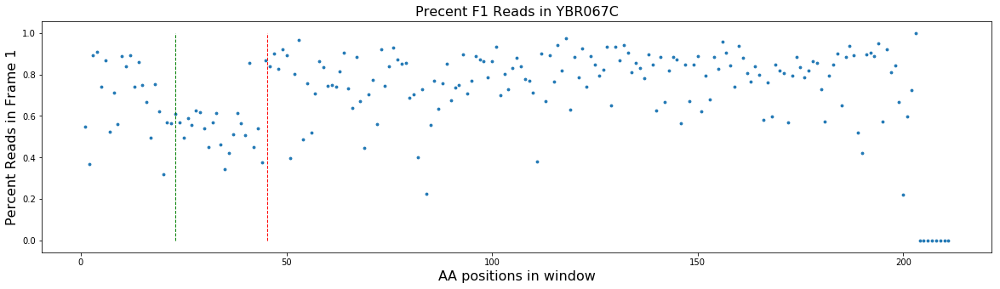

Simulated Percent: 0.3
1254 1451


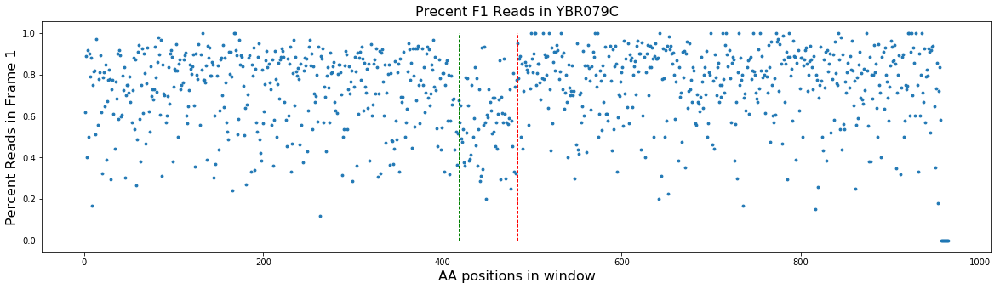

Simulated Percent: 0.3
78 134


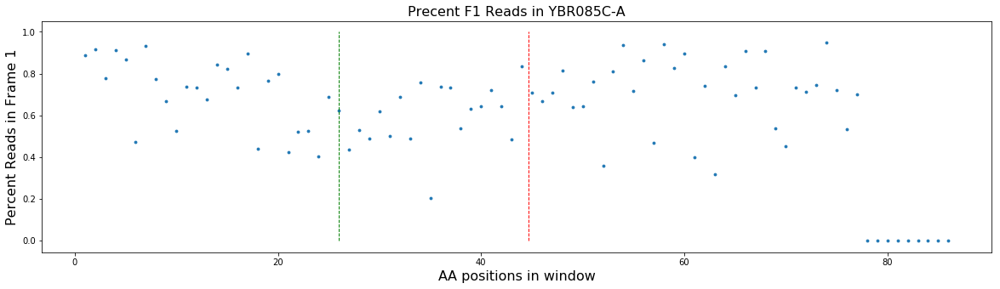

Simulated Percent: 0.1
1134 1285


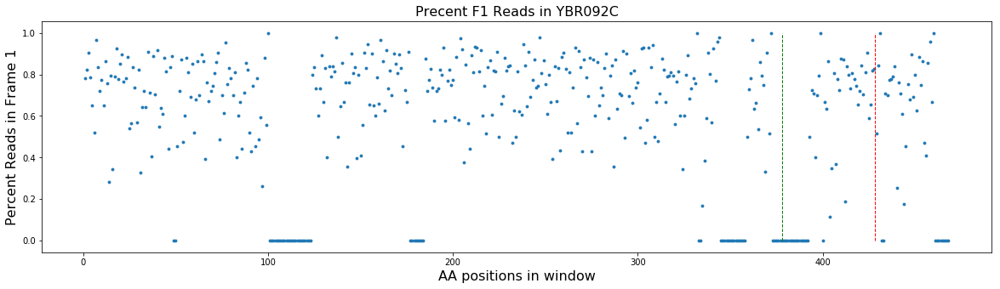

Simulated Percent: 0.3
45 178


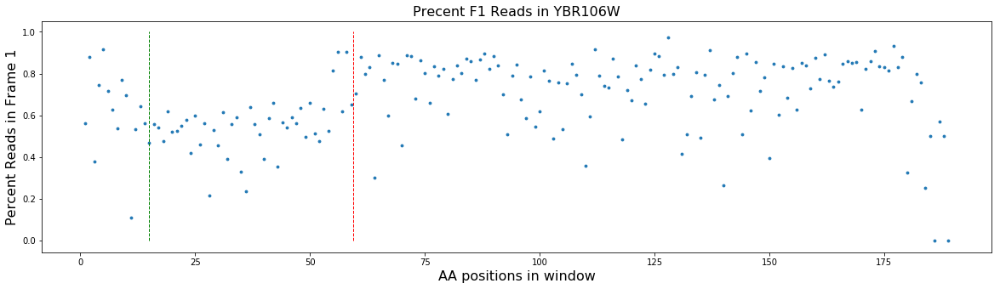

Simulated Percent: 0.05
33 106


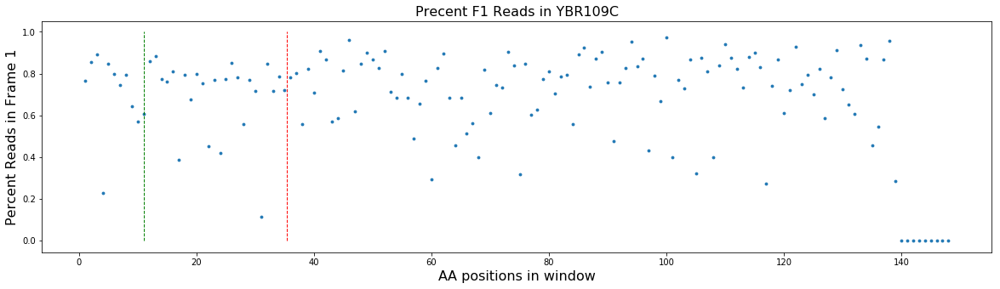

Simulated Percent: 0.8
438 505


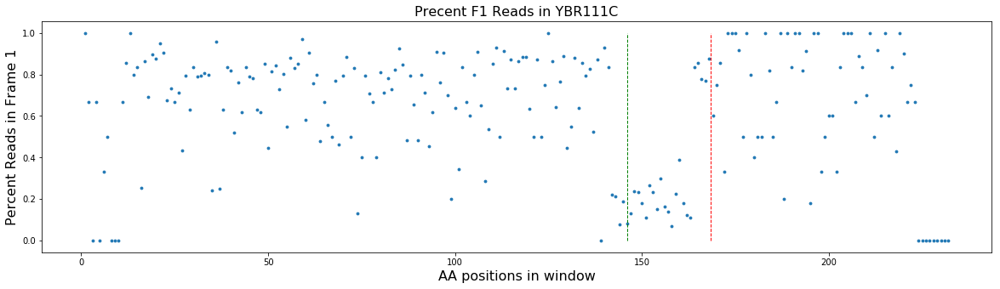

Simulated Percent: 0.7
1074 1174


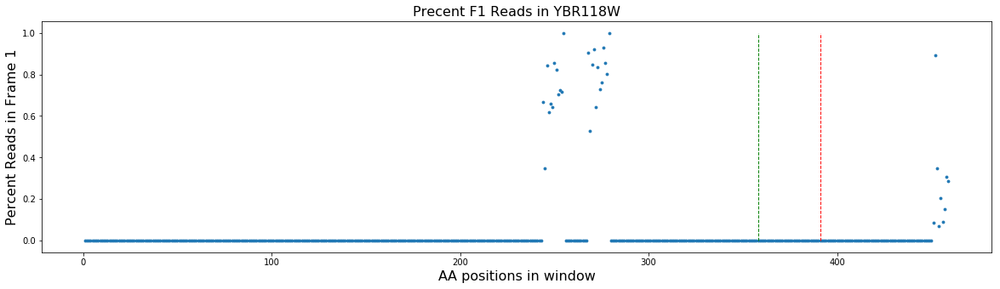

Simulated Percent: 0.05
900 1034


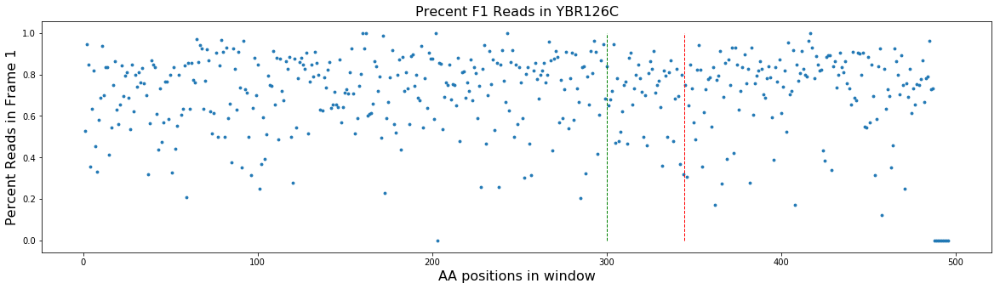

Simulated Percent: 0.05
417 473


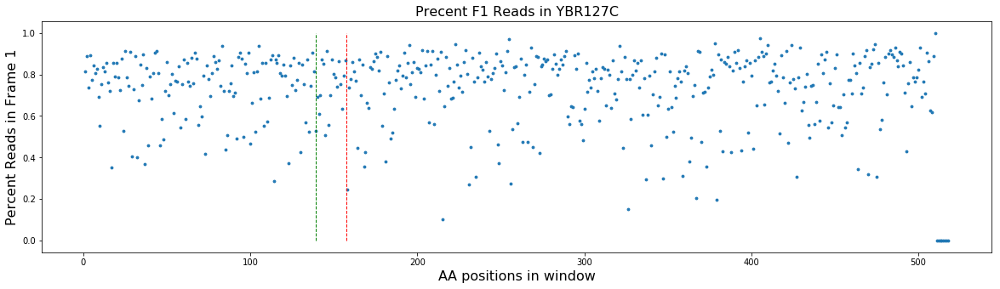

Simulated Percent: 0.4
288 361


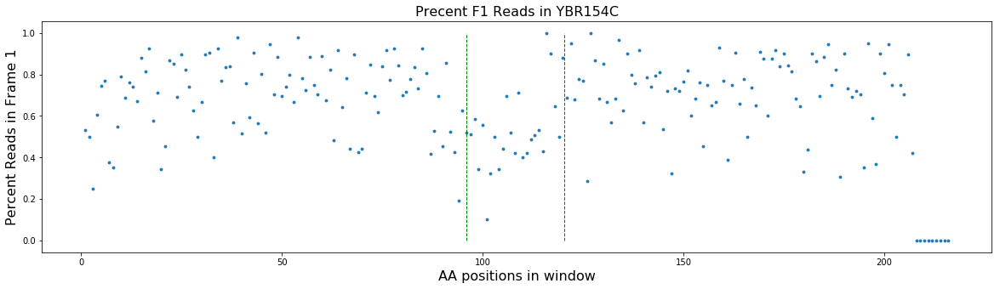

Simulated Percent: 0.3
381 535


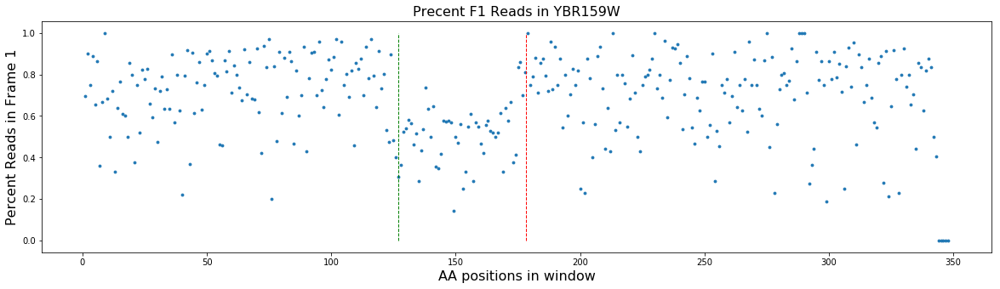

Simulated Percent: 0.5
486 718


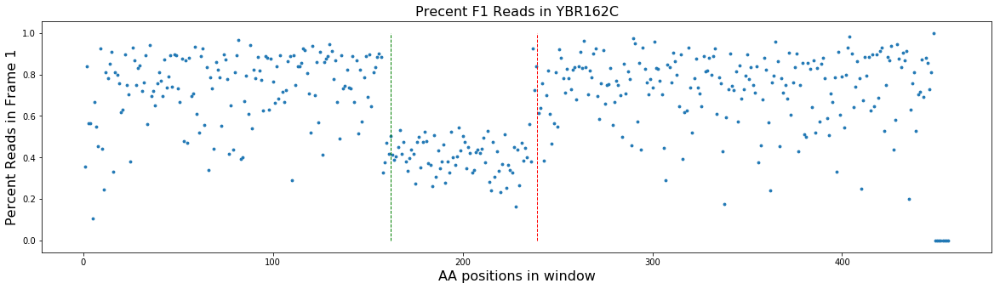

Simulated Percent: 0.4
45 115


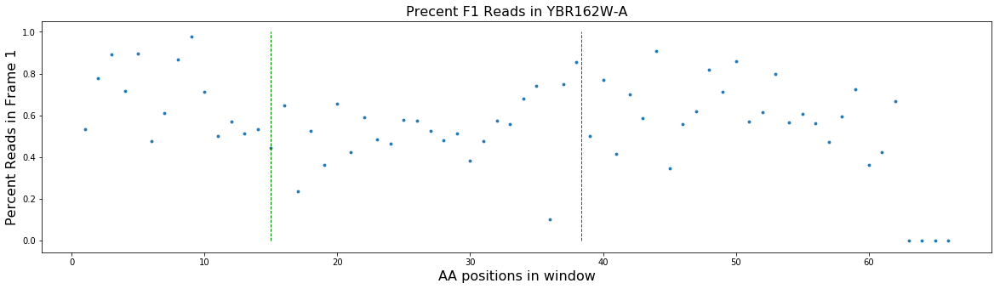

Simulated Percent: 0.8
84 139


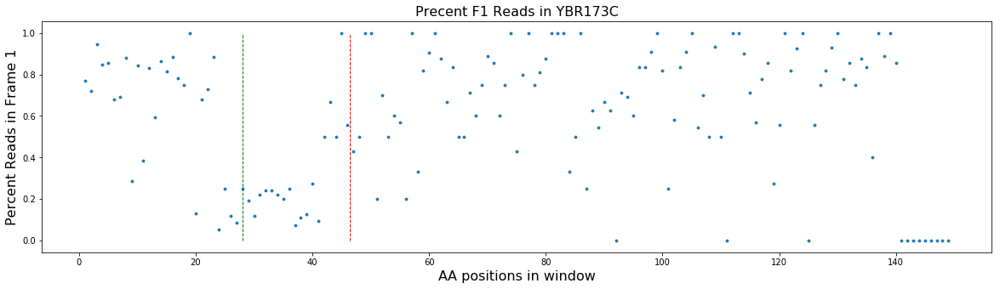

Simulated Percent: 0.05
1026 1228


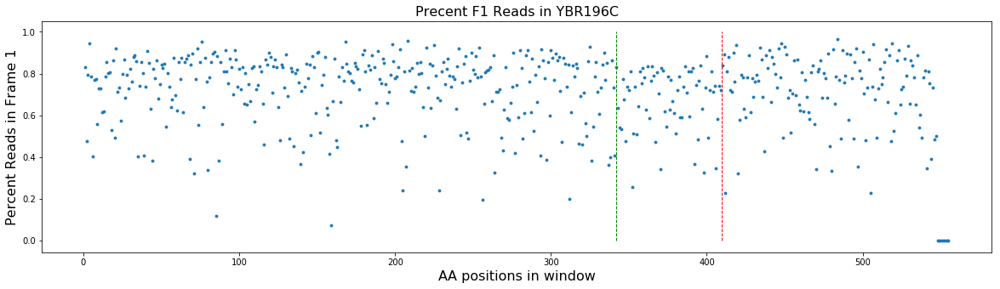

Simulated Percent: 0.05
81 137


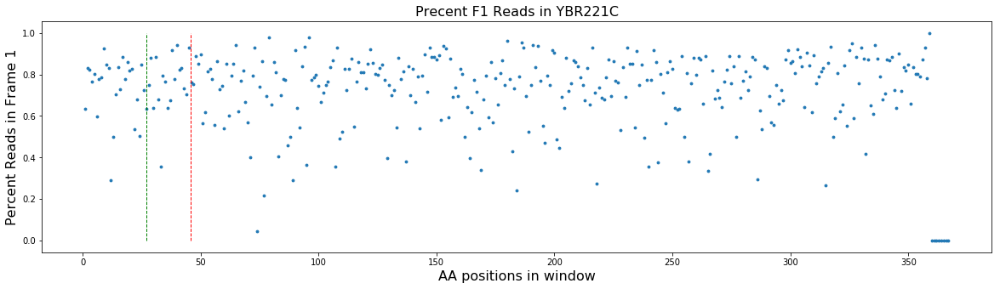

Simulated Percent: 0.5
309 502


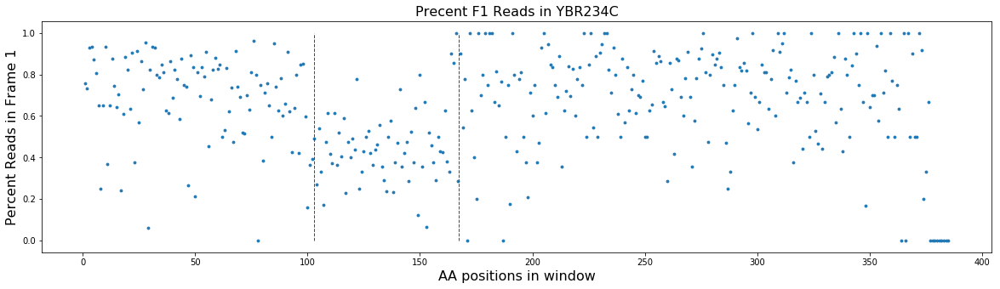

Simulated Percent: 0.3
663 742


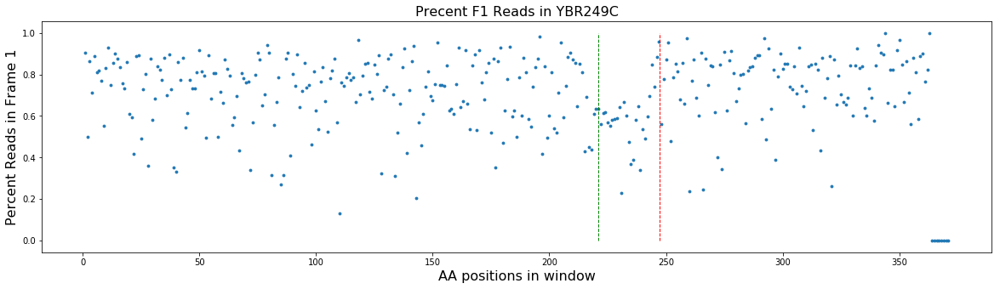

Simulated Percent: 0.5
507 562


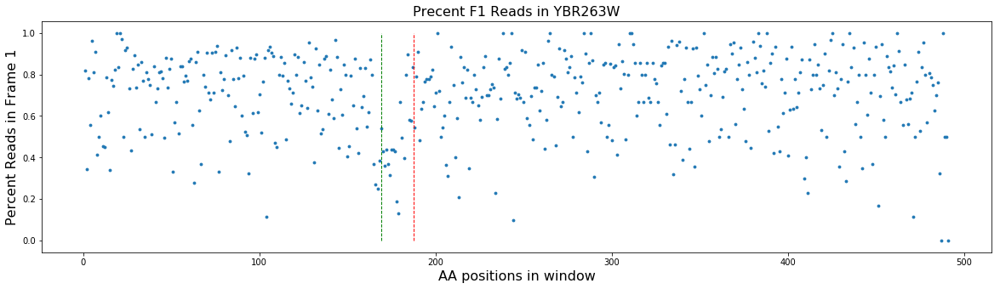

Simulated Percent: 0.6
1116 1186


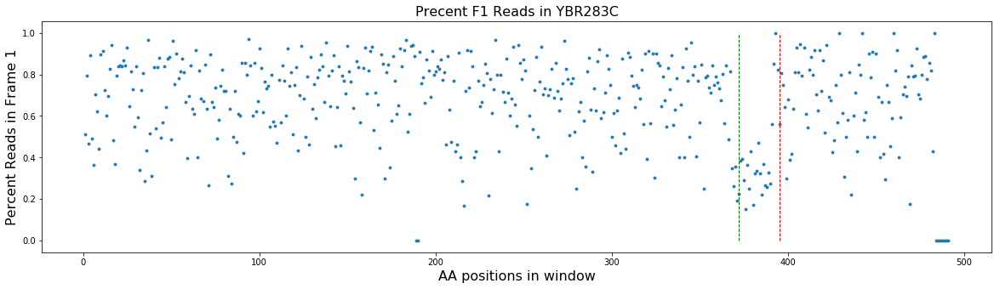

Simulated Percent: 0.3
102 257


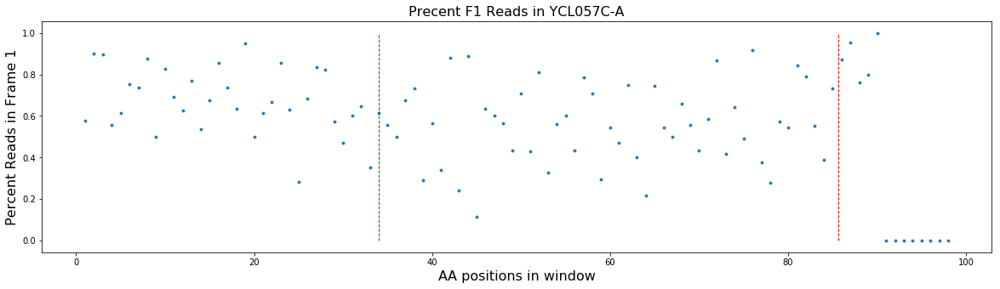

Simulated Percent: 0.6
1044 1180


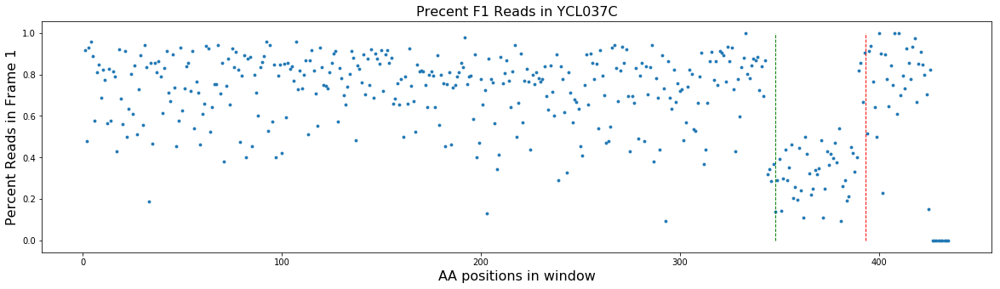

Simulated Percent: 0.05
219 280


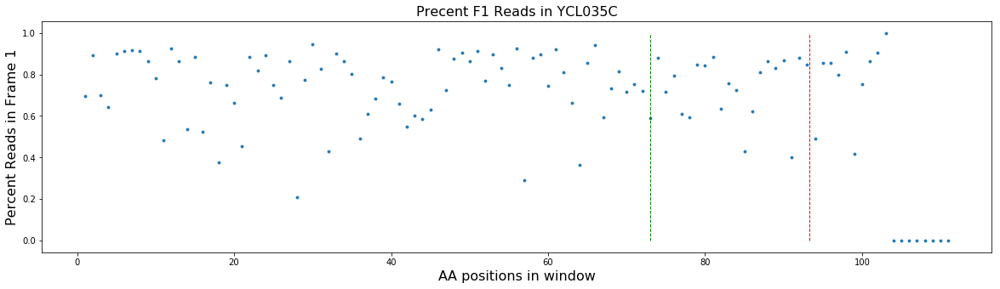

Simulated Percent: 0.4
291 365


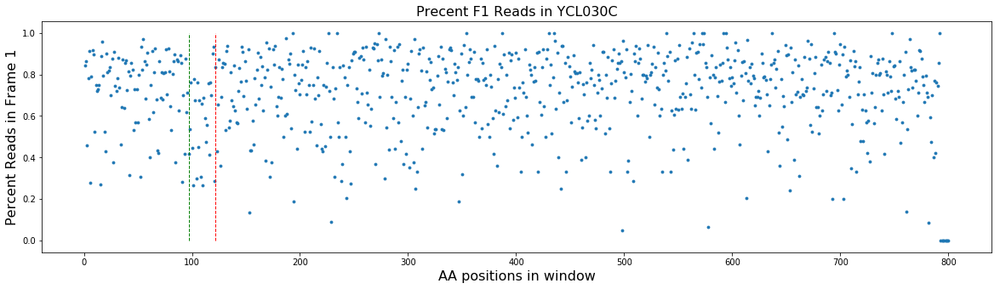

Simulated Percent: 0.1
618 832


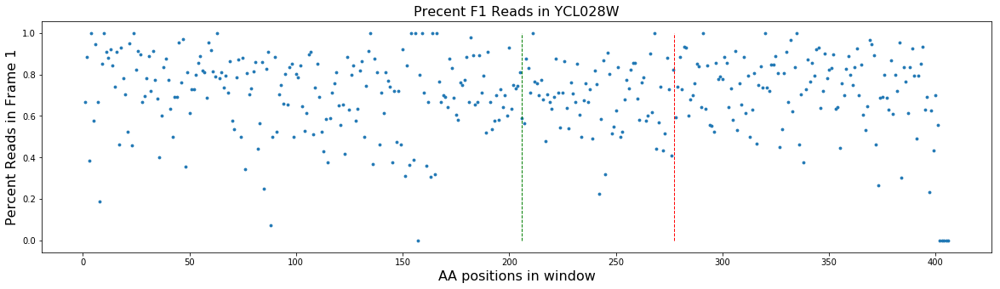

Simulated Percent: 0.6
48 308


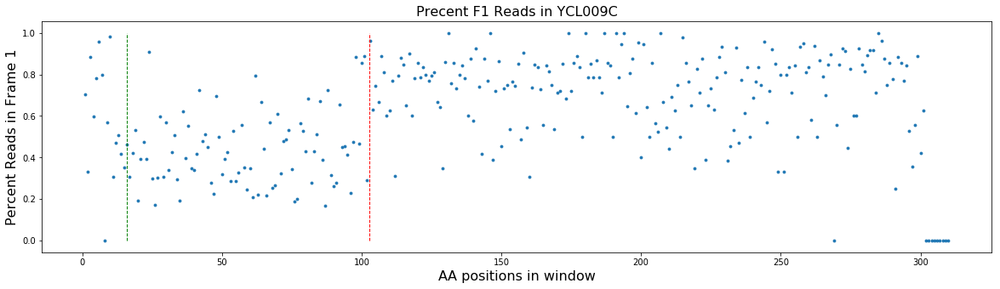

Simulated Percent: 0.5
171 278


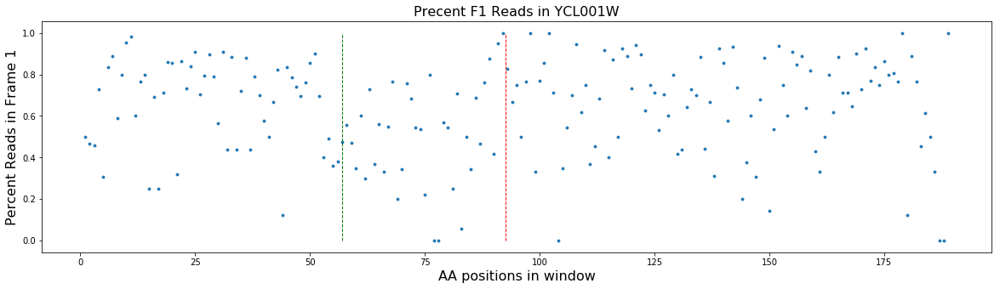

Simulated Percent: 0.05
777 853


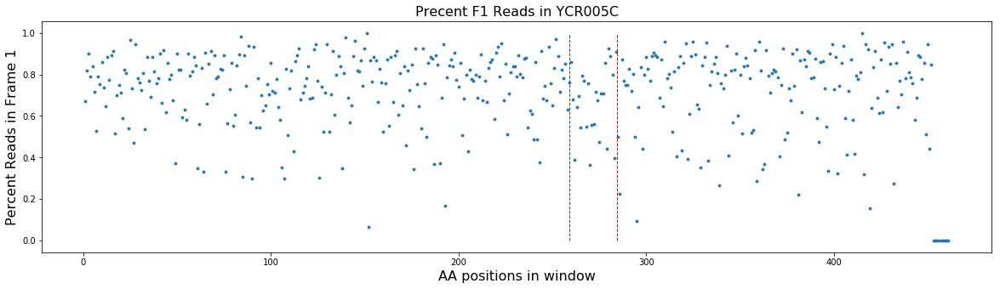

Simulated Percent: 0.7
204 322


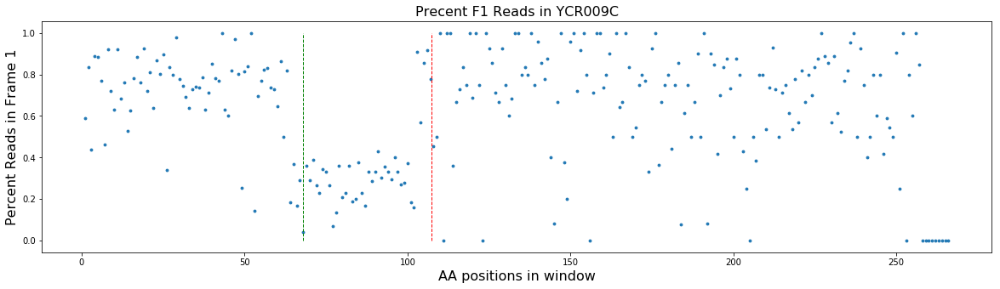

Simulated Percent: 0.05
45 95


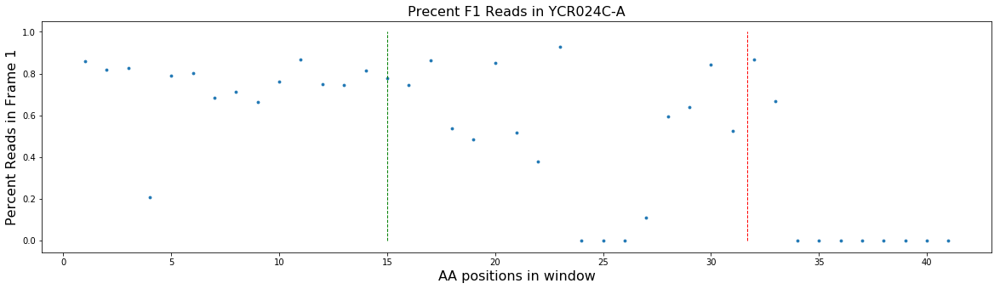

Simulated Percent: 0.3
816 887


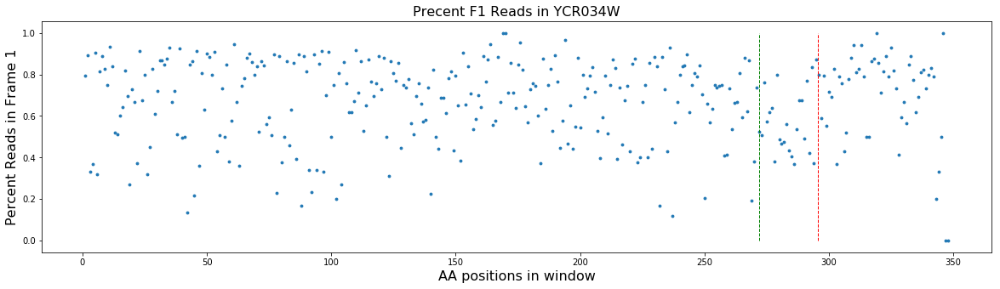

Simulated Percent: 0.05
444 514


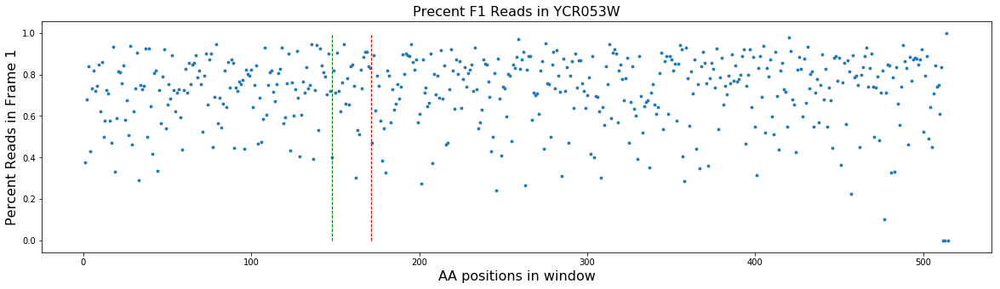

Simulated Percent: 0.05
414 521


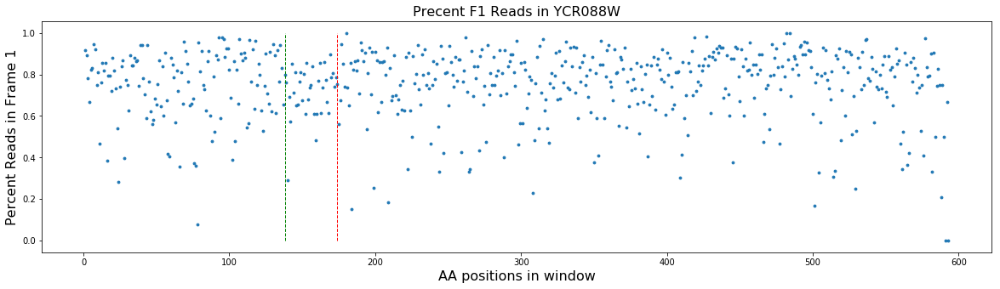

Simulated Percent: 0.7
33 83


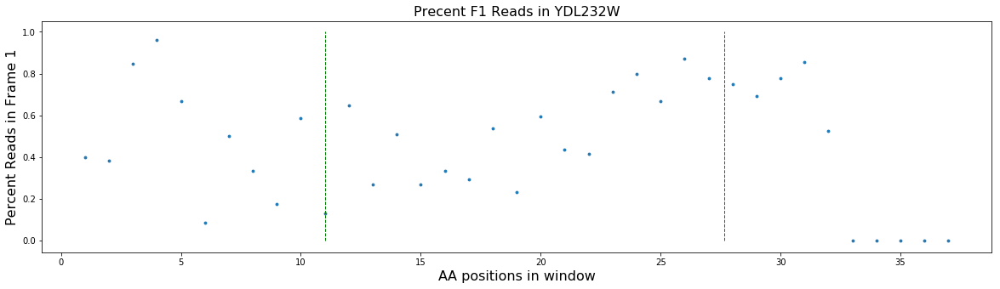

Simulated Percent: 0.5
183 242


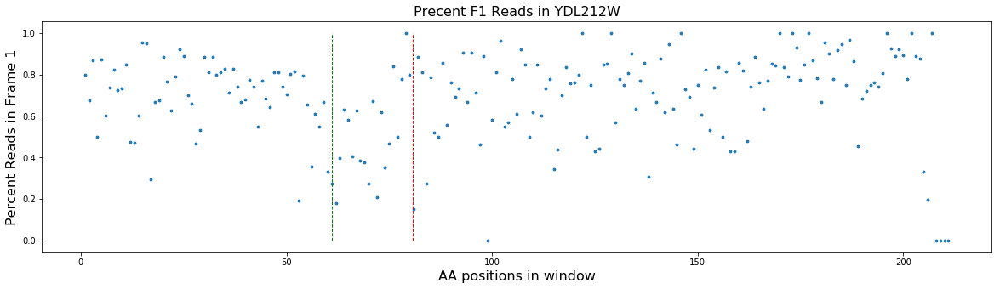

Simulated Percent: 0.5
2232 2386


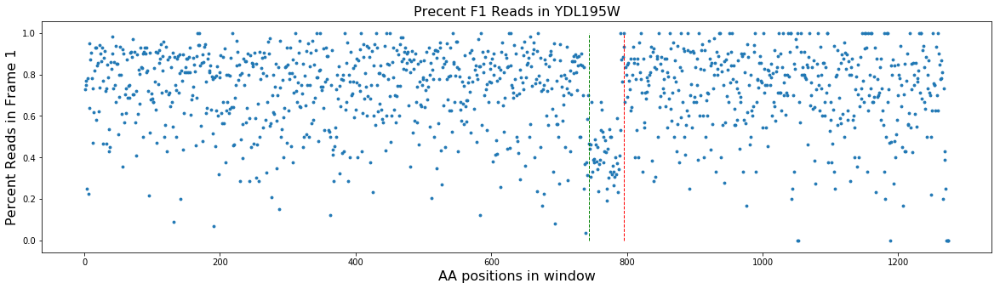

Simulated Percent: 0.3
261 331


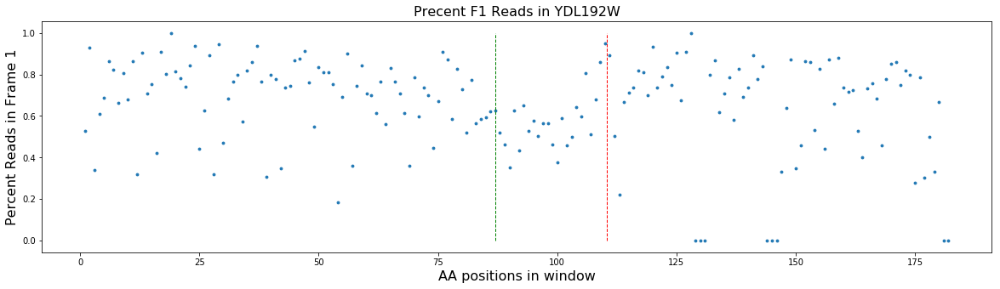

Simulated Percent: 0.1
768 820


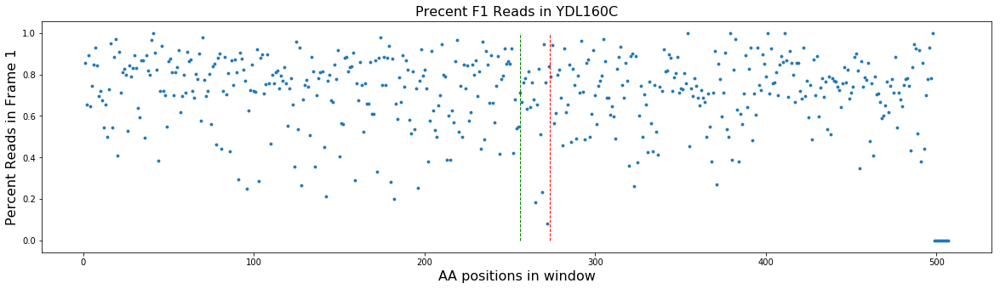

Simulated Percent: 0.4
339 394


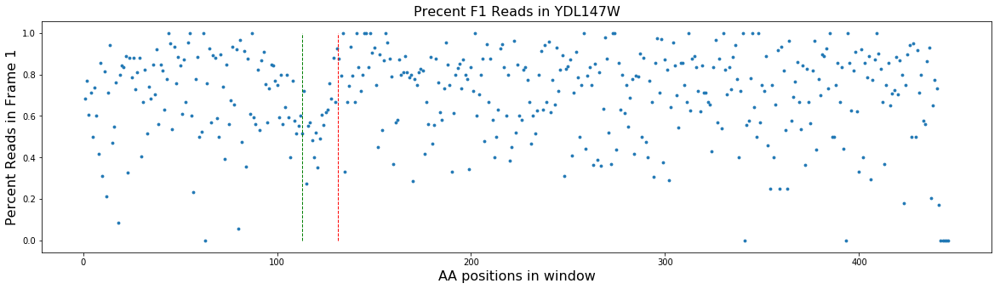

Simulated Percent: 0.8
297 355


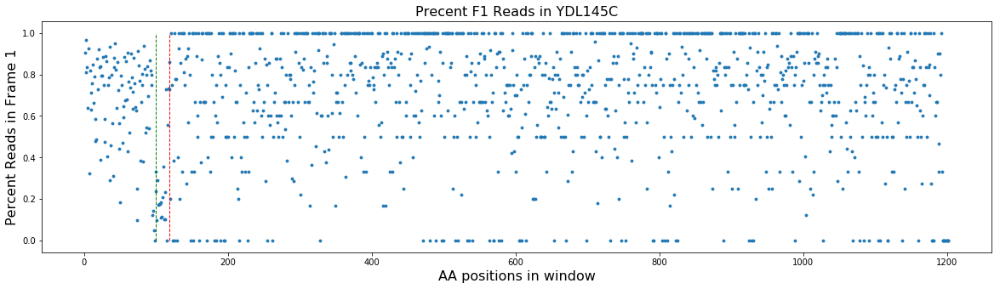

Simulated Percent: 0.2
183 269


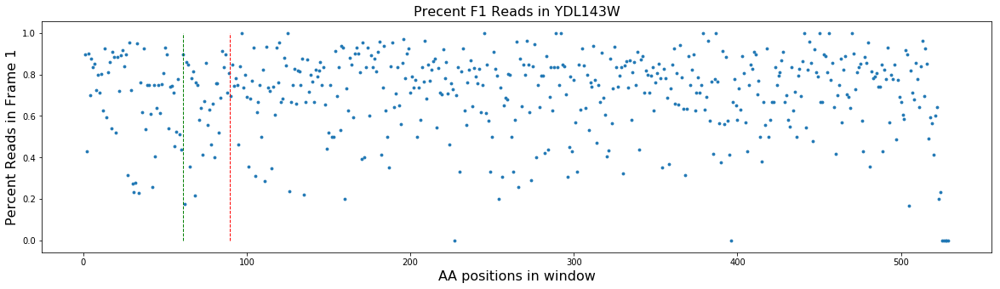

Simulated Percent: 0.4
186 331


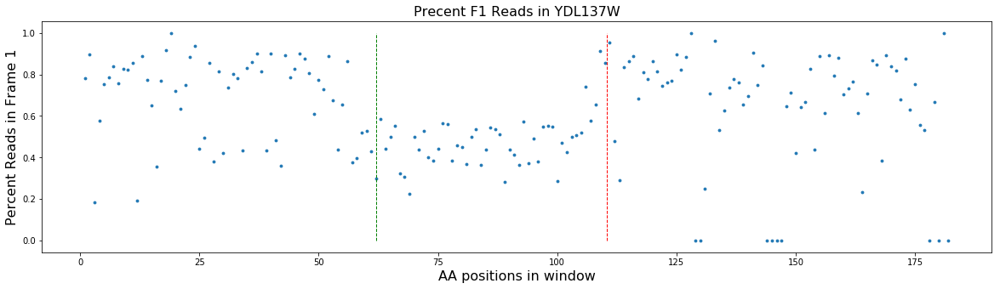

Simulated Percent: 0.4
42 115


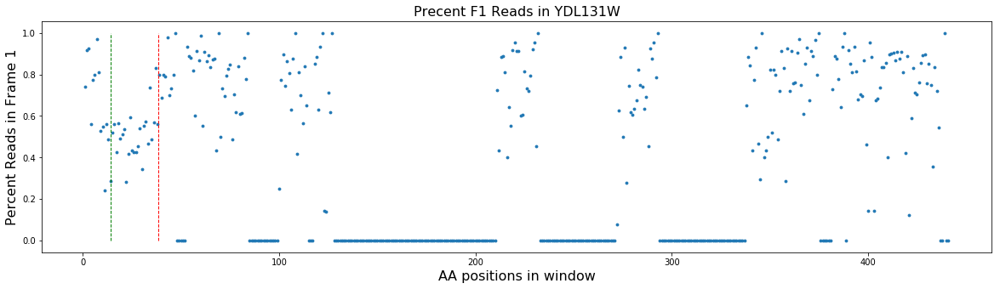

Simulated Percent: 0.4
1554 1609


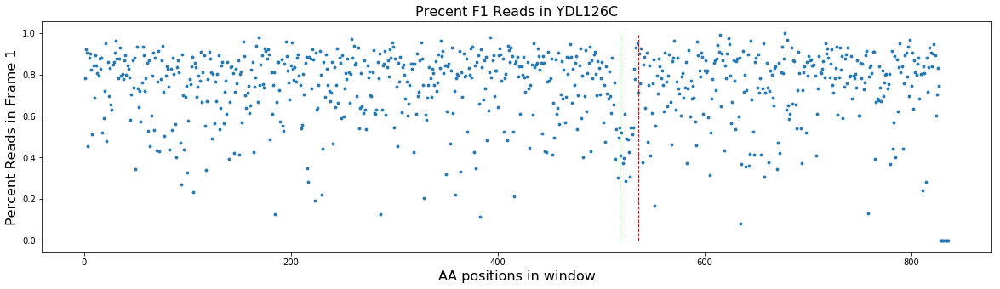

Simulated Percent: 0.6
690 742


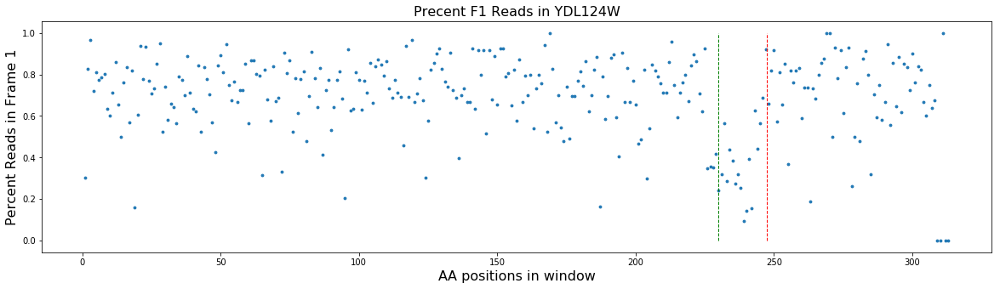

Simulated Percent: 0.1
108 167


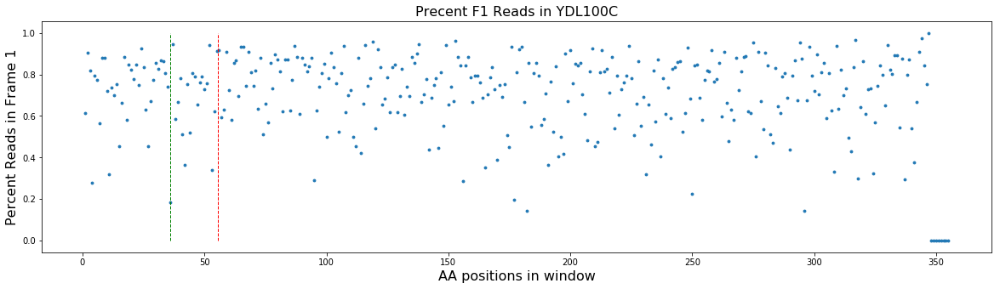

Simulated Percent: 0.05
345 473


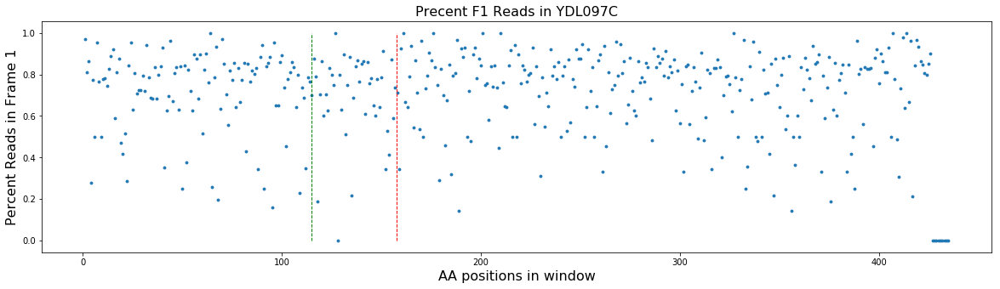

Simulated Percent: 0.4
363 451


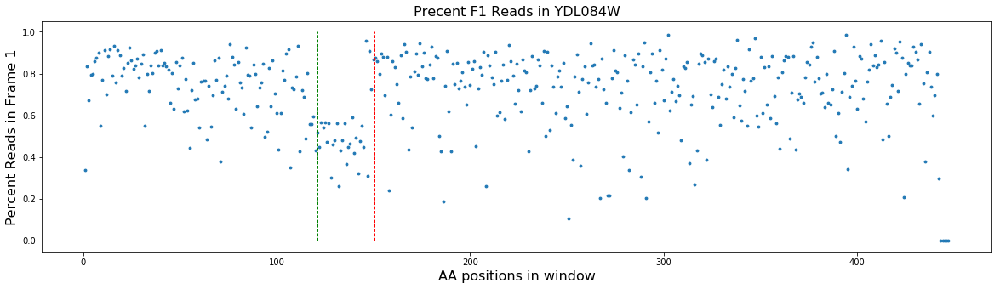

Simulated Percent: 0.6
90 160


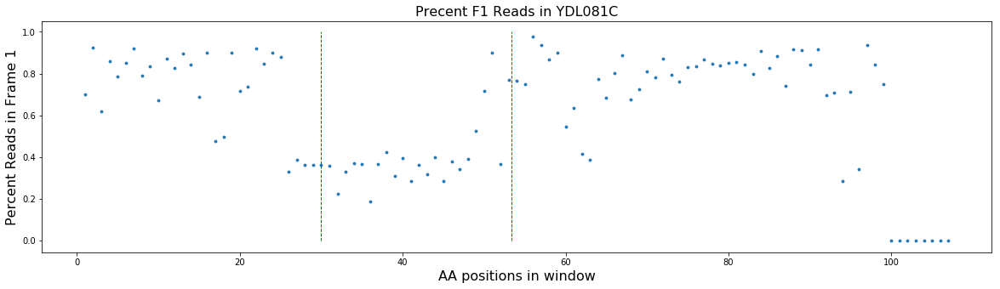

Simulated Percent: 0.9
120 232


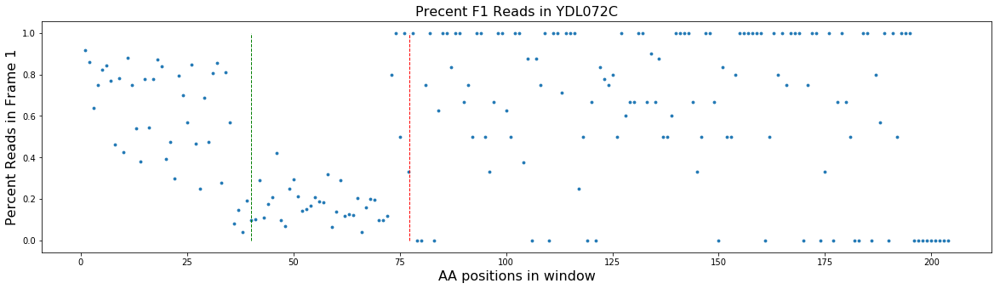

Simulated Percent: 0.5
99 151


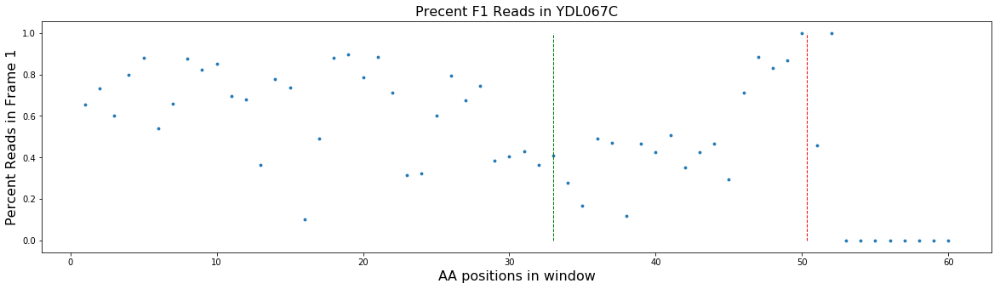

Simulated Percent: 0.8
216 295


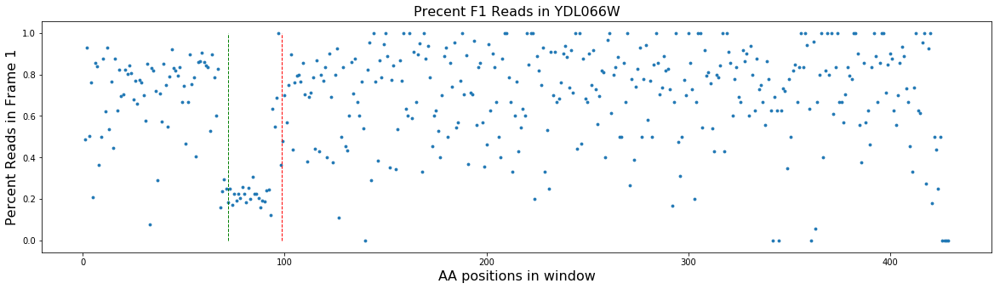

Simulated Percent: 0.8
66 140


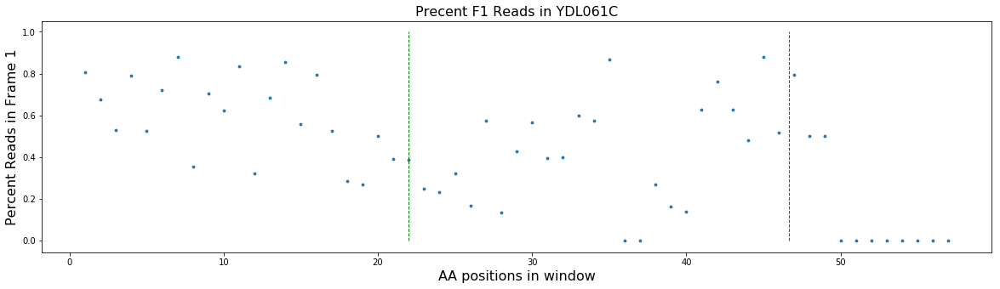

Simulated Percent: 0.5
69 148


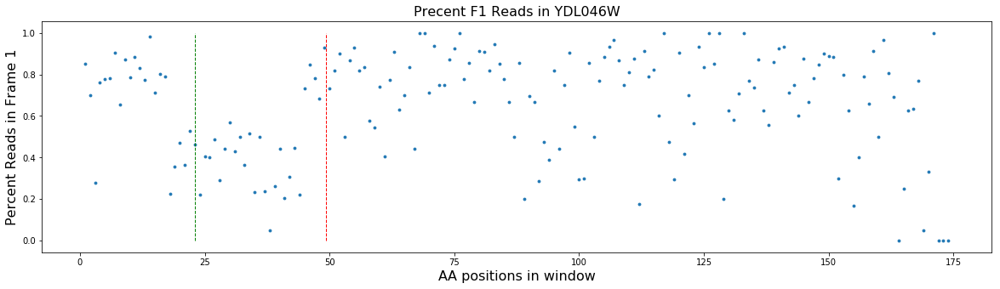

Simulated Percent: 0.1
312 376


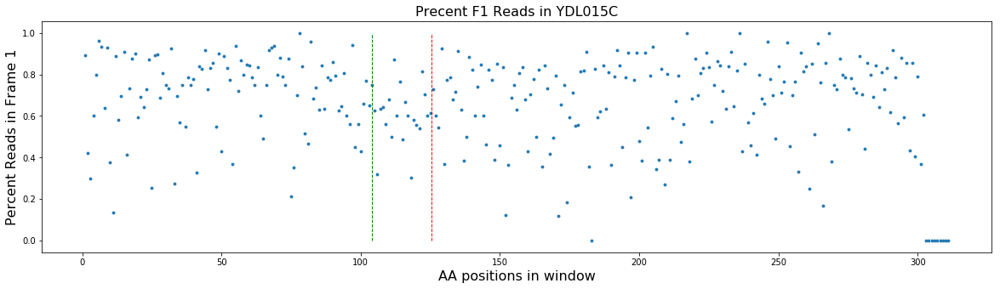

Simulated Percent: 0.7
258 310


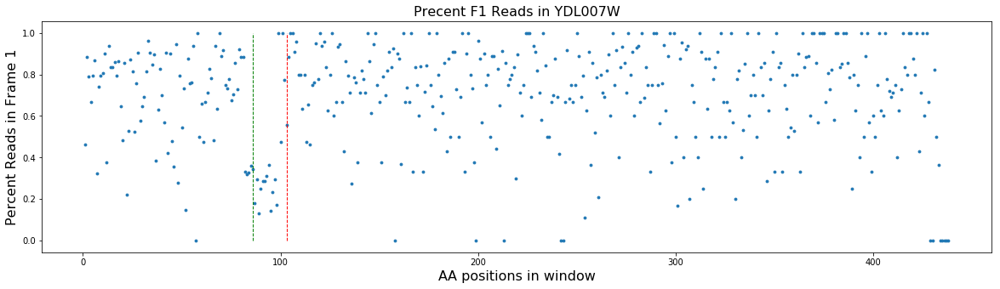

Simulated Percent: 0.5
171 319


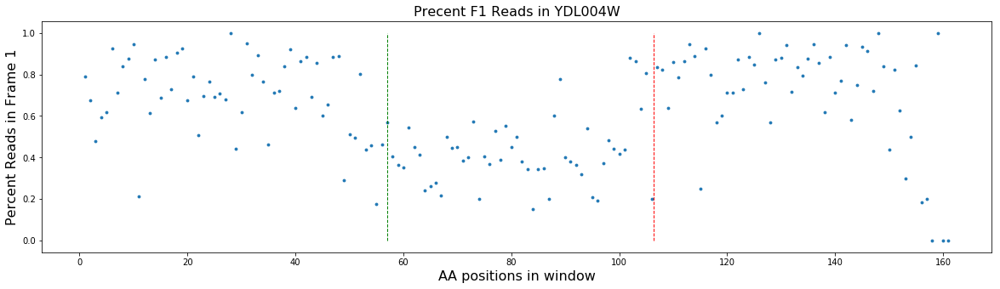

Simulated Percent: 0.7
279 340


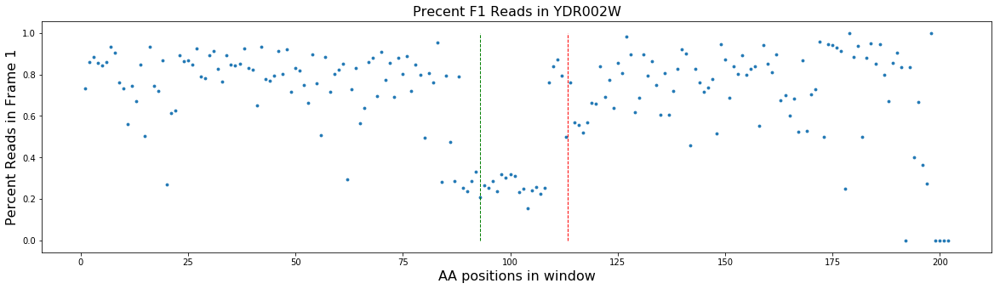

Simulated Percent: 0.3
765 937


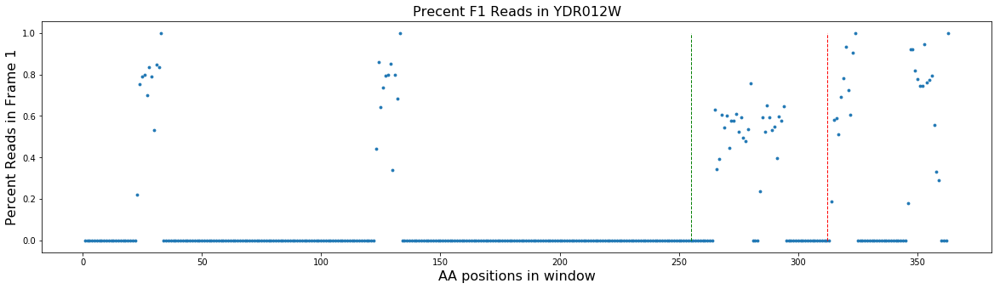

Simulated Percent: 0.7
1209 1291


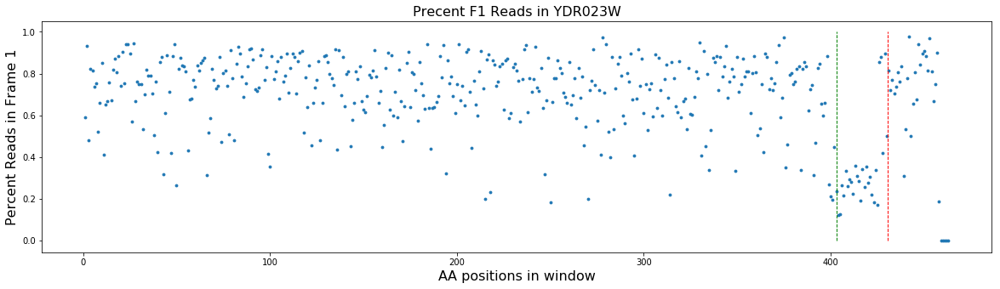

Simulated Percent: 0.4
381 443


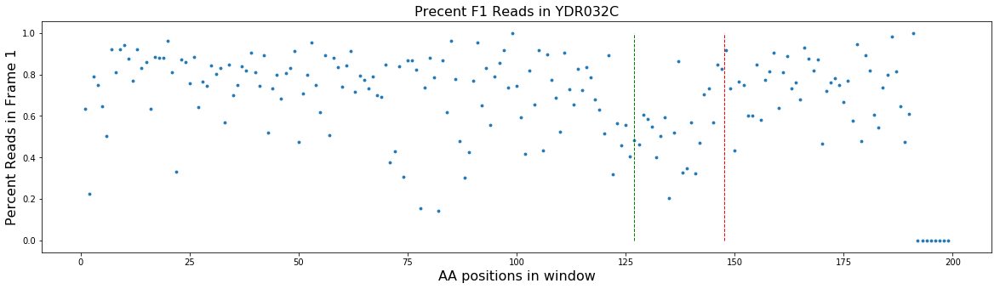

Simulated Percent: 0.5
81 142


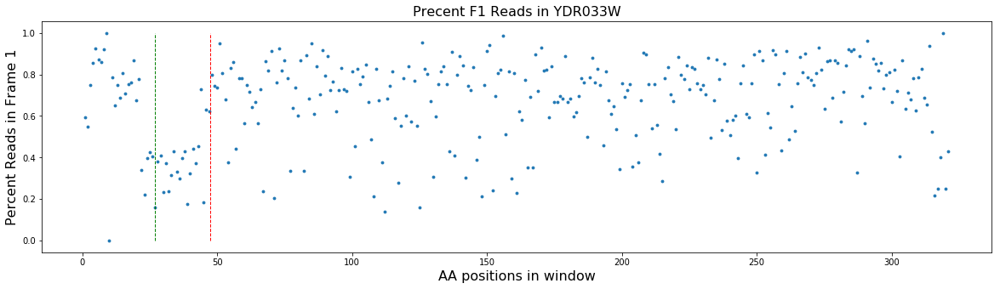

Simulated Percent: 0.1
1026 1102


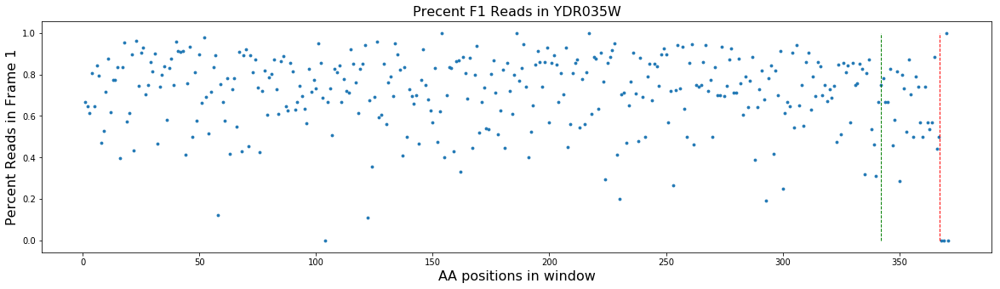

Simulated Percent: 0.6
147 197


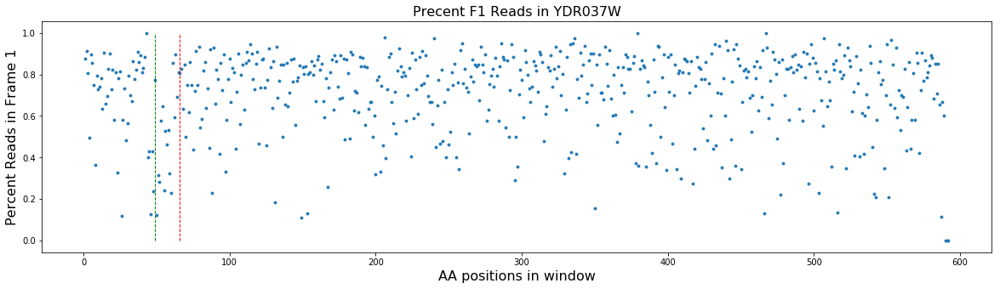

Simulated Percent: 0.2
462 610


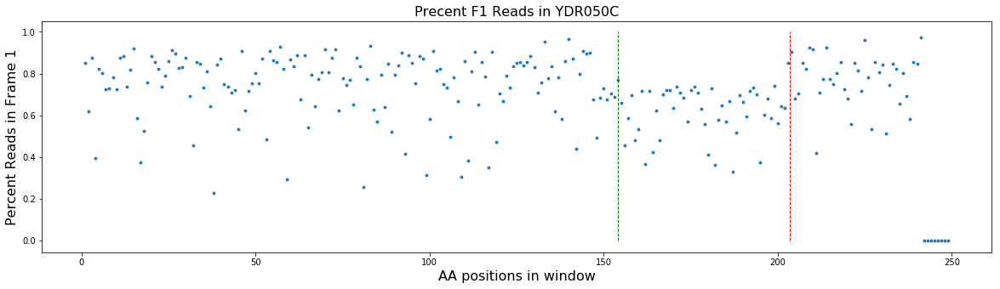

Simulated Percent: 0.1
219 322


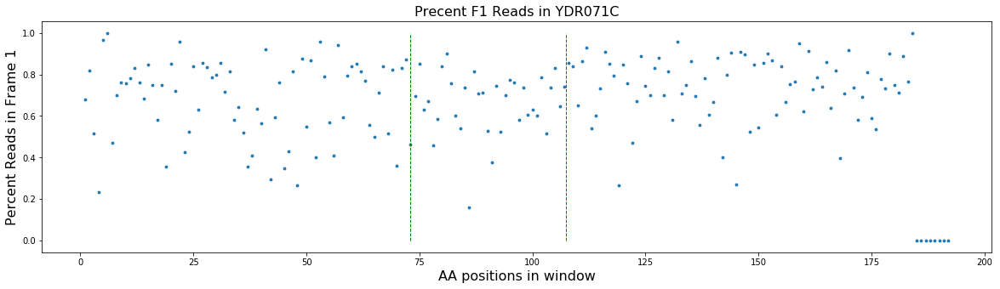

Simulated Percent: 0.6
414 488


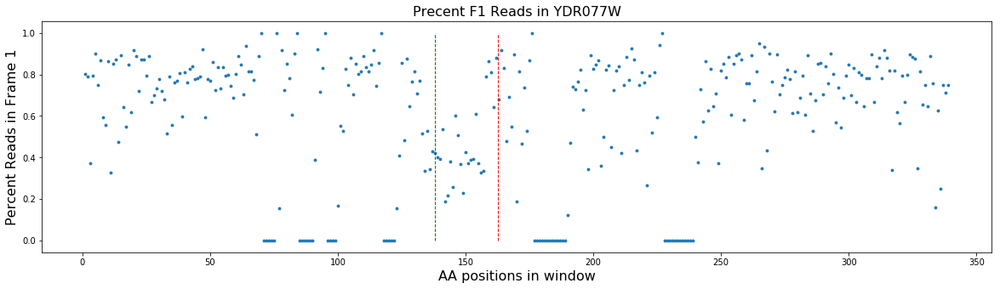

Simulated Percent: 0.8
141 208


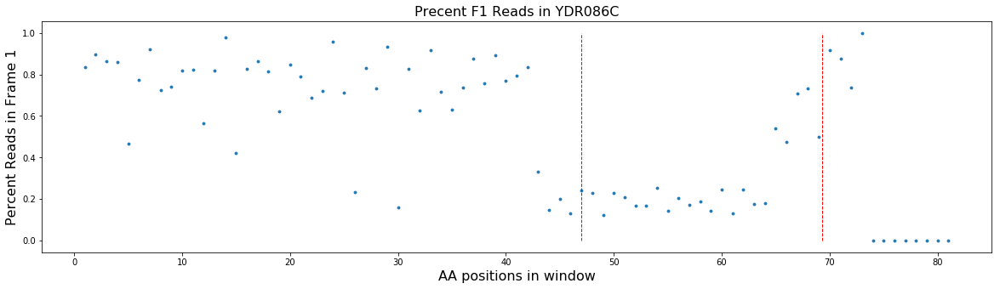

Simulated Percent: 0.2
855 979


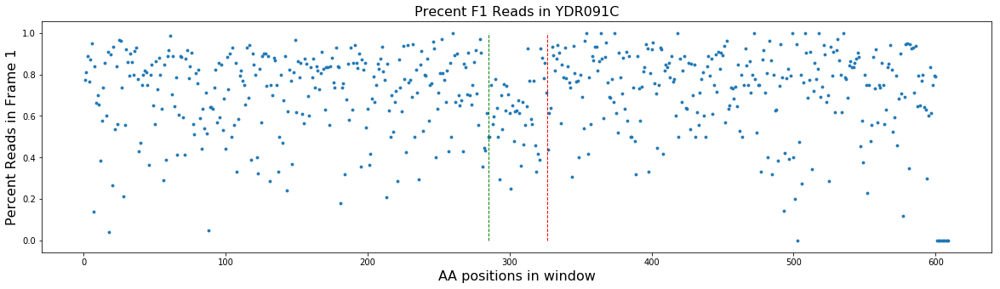

Simulated Percent: 0.8
123 187


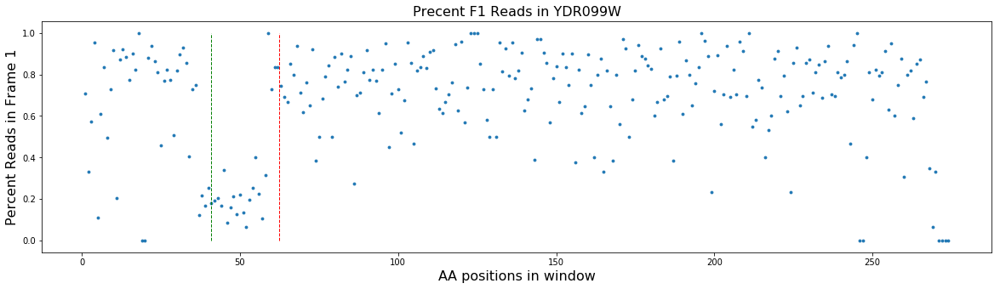

Simulated Percent: 0.8
1947 2002


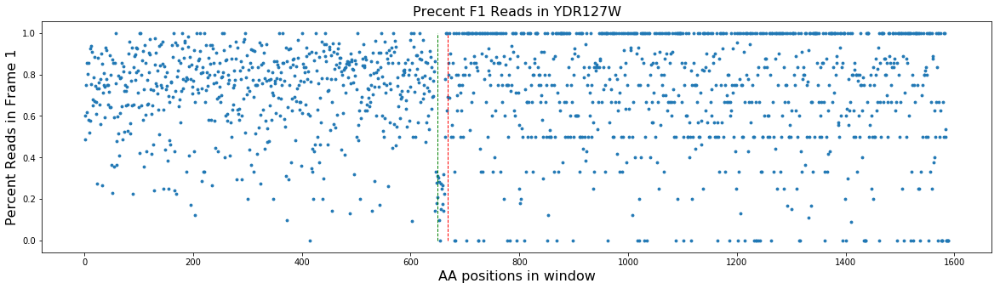

Simulated Percent: 0.1
60 116


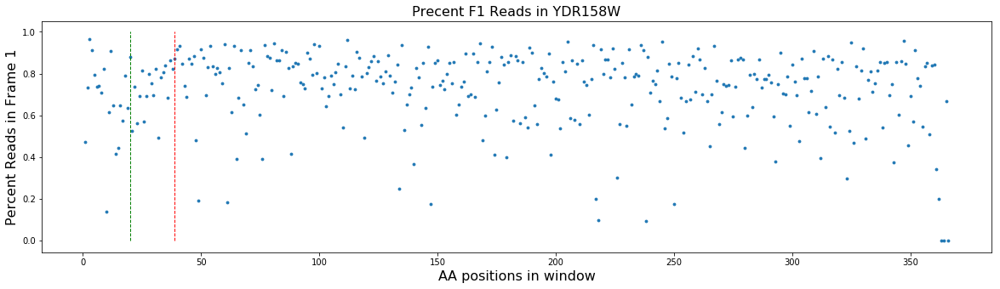

Simulated Percent: 0.4
1116 1213


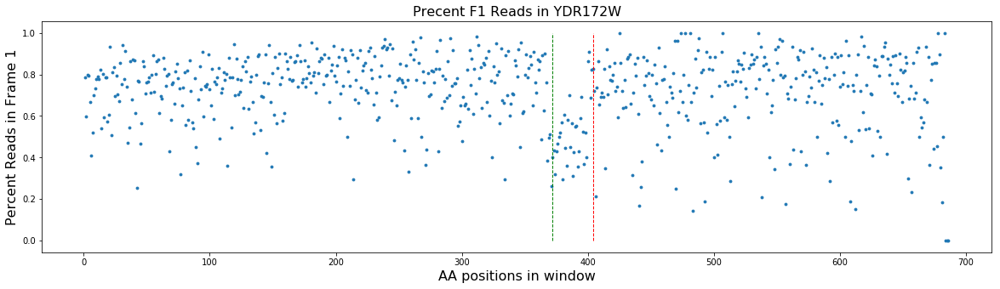

Simulated Percent: 0.5
75 145


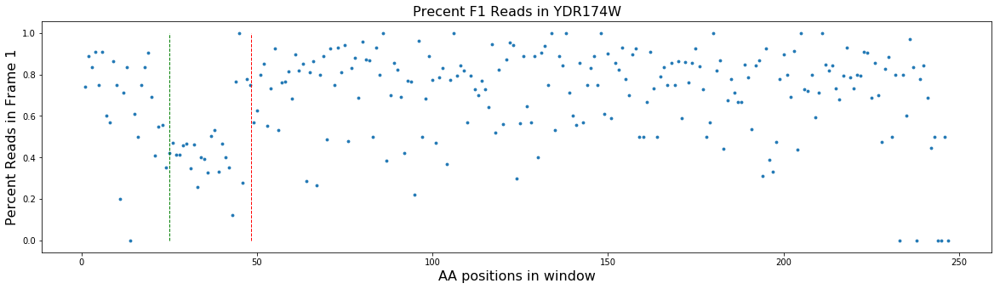

Simulated Percent: 0.8
162 247


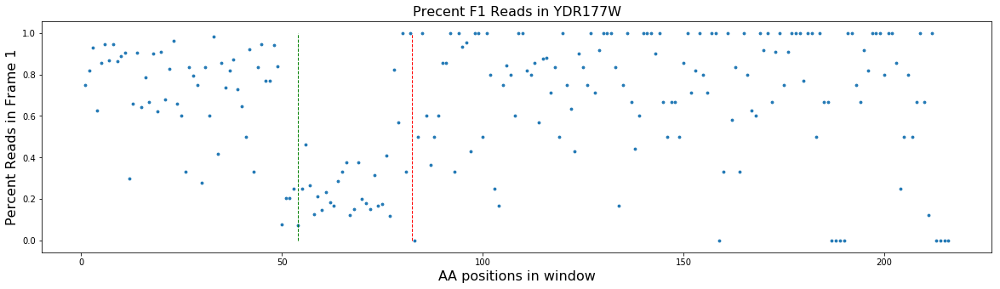

Simulated Percent: 0.7
747 802


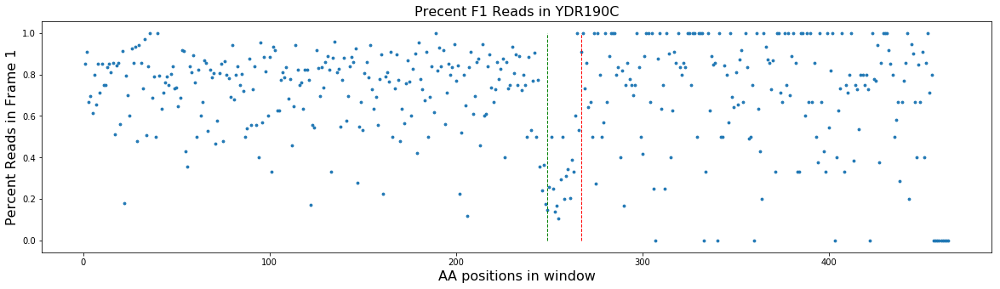

Simulated Percent: 0.2
1197 1285


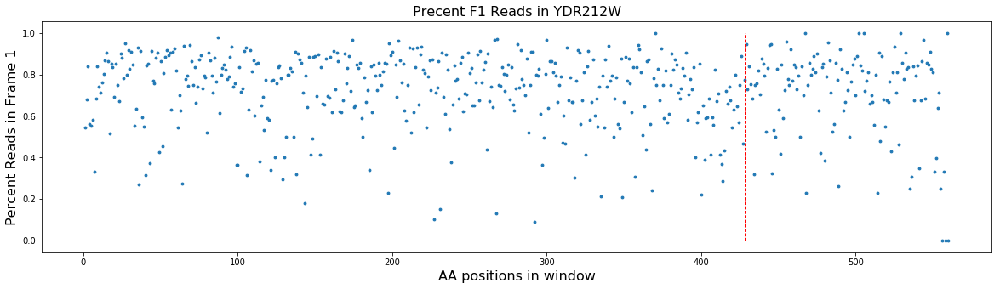

Simulated Percent: 0.3
93 145


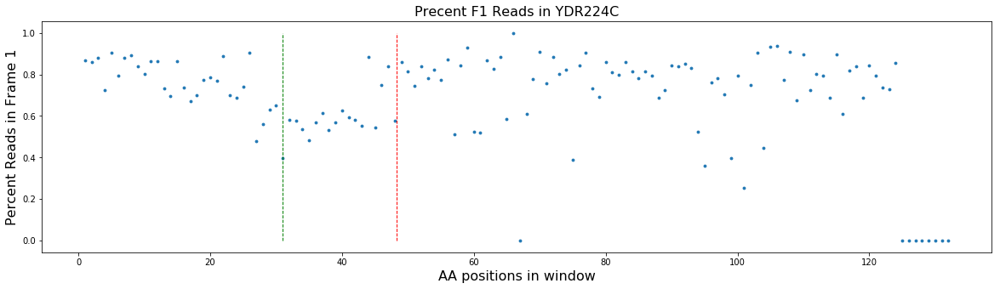

Simulated Percent: 0.8
135 185


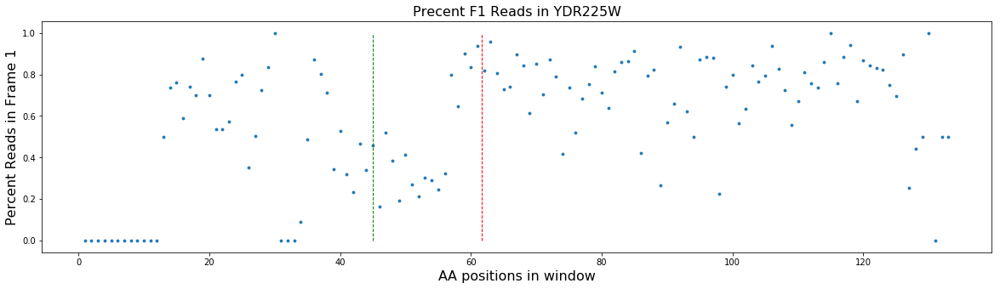

Simulated Percent: 0.1
510 569


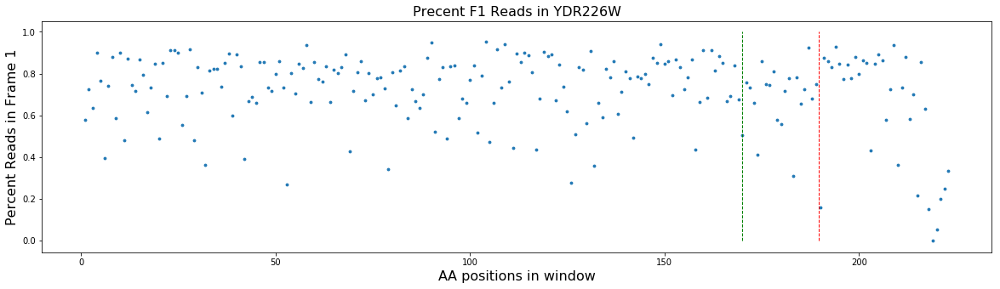

Simulated Percent: 0.5
969 1025


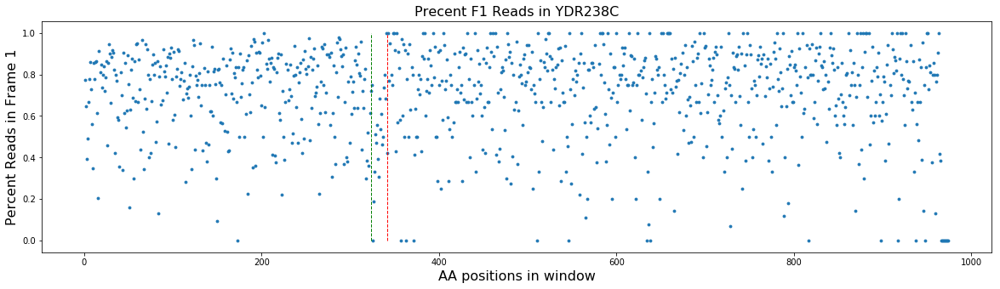

Simulated Percent: 0.3
33 83


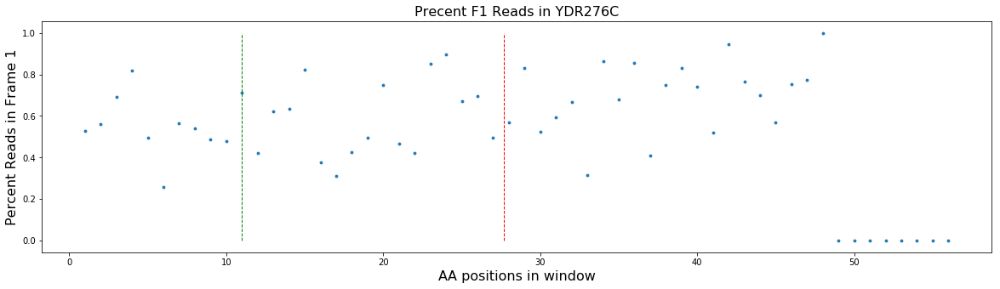

Simulated Percent: 0.5
186 263


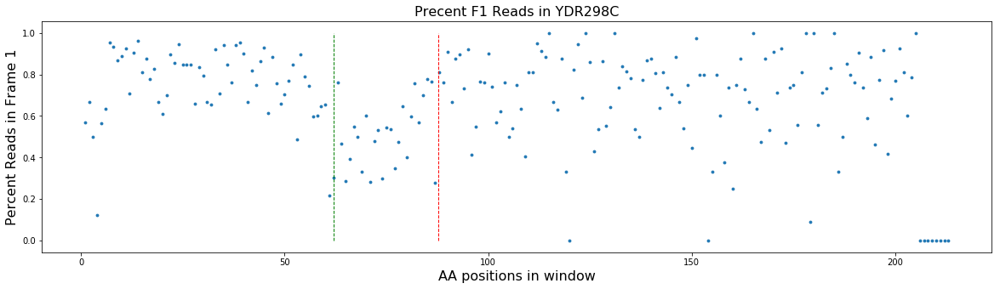

Simulated Percent: 0.7
87 205


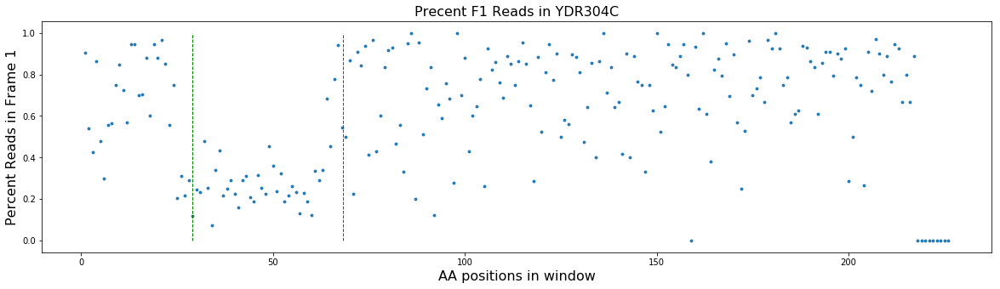

Simulated Percent: 0.3
456 538


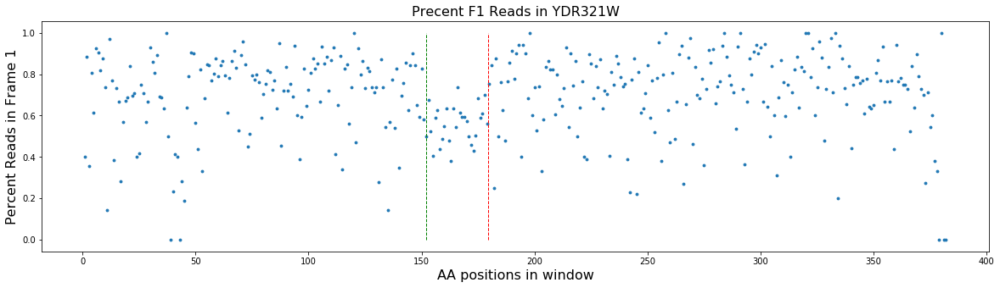

Simulated Percent: 0.3
1185 1252


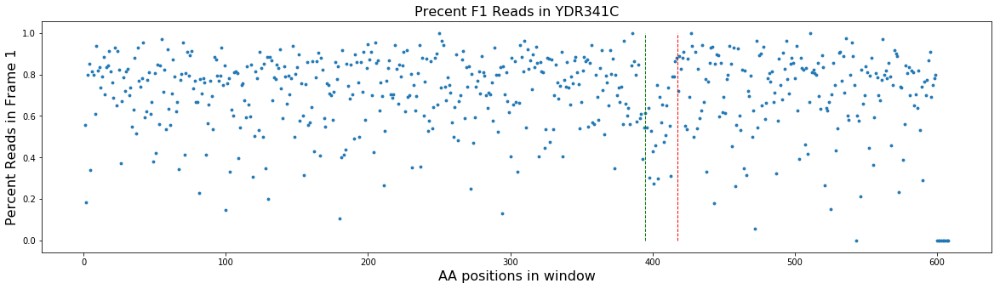

Simulated Percent: 0.2
765 967


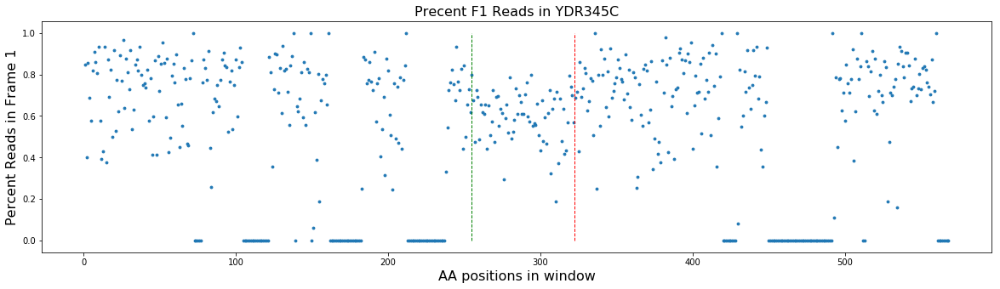

Simulated Percent: 0.2
129 191


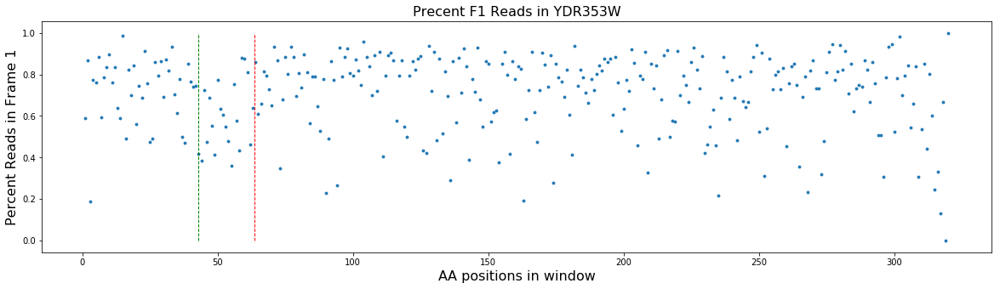

Simulated Percent: 0.9
168 229


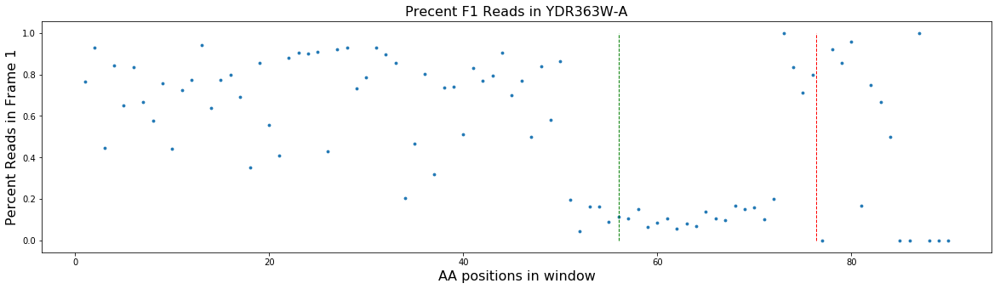

Simulated Percent: 0.1
462 538


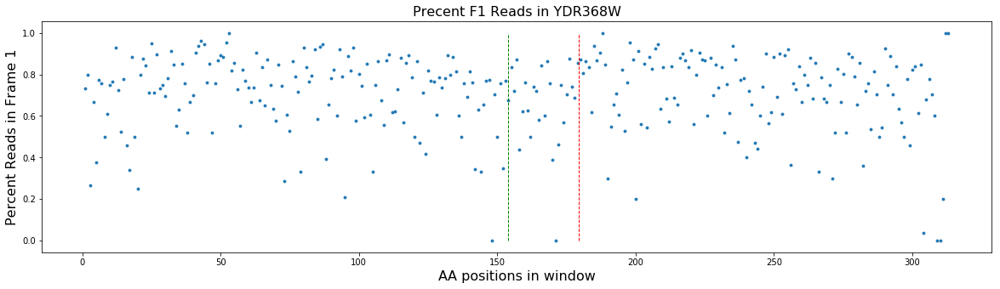

Simulated Percent: 0.4
162 229


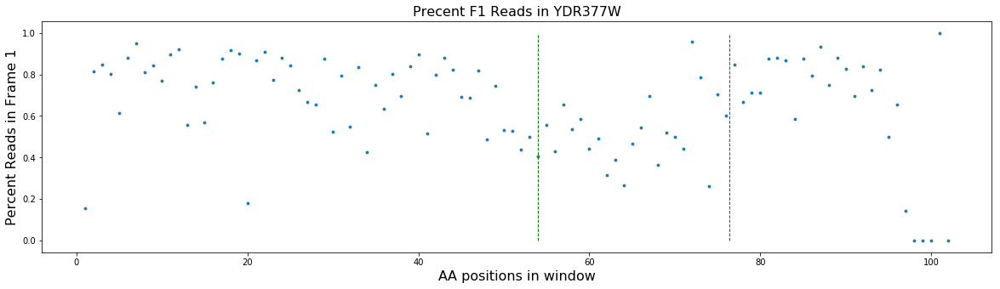

Simulated Percent: 0.7
66 122


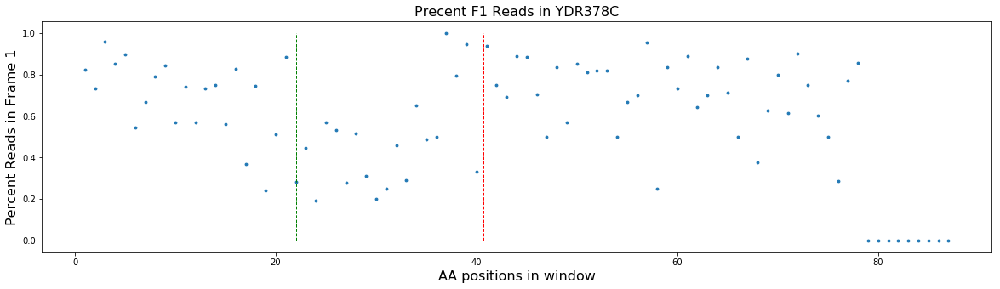

Simulated Percent: 0.9
186 254


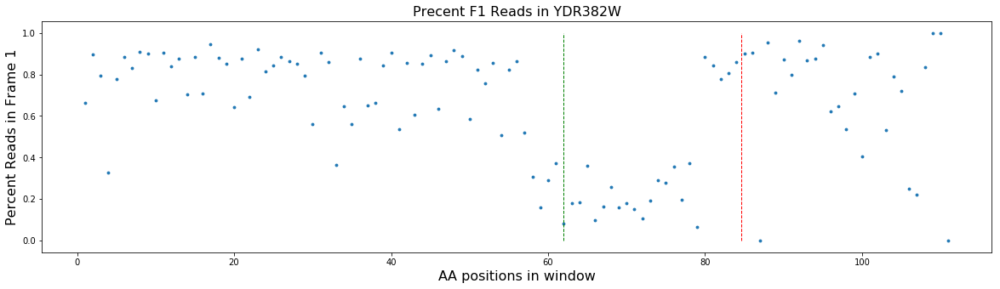

Simulated Percent: 0.4
1038 1205


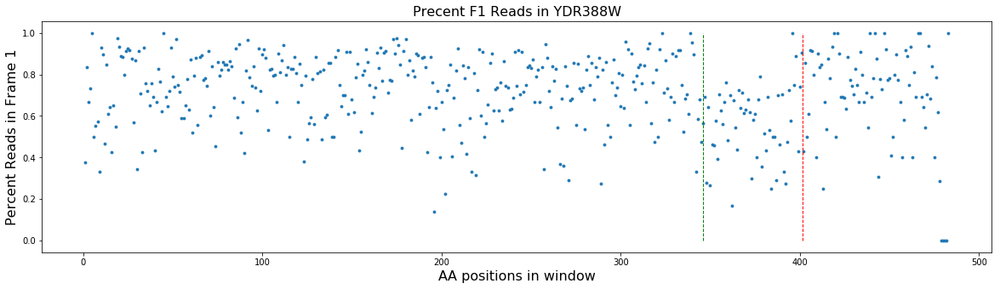

Simulated Percent: 0.4
942 1004


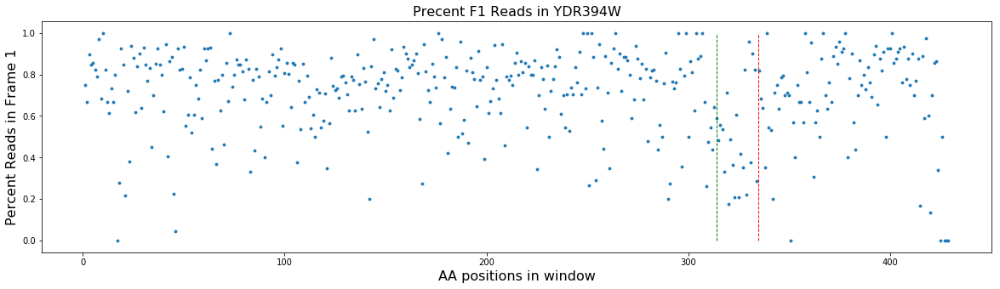

Simulated Percent: 0.05
60 136


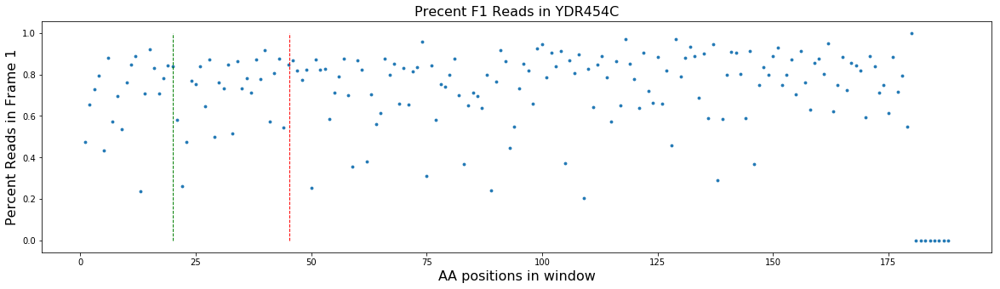

Simulated Percent: 0.1
570 709


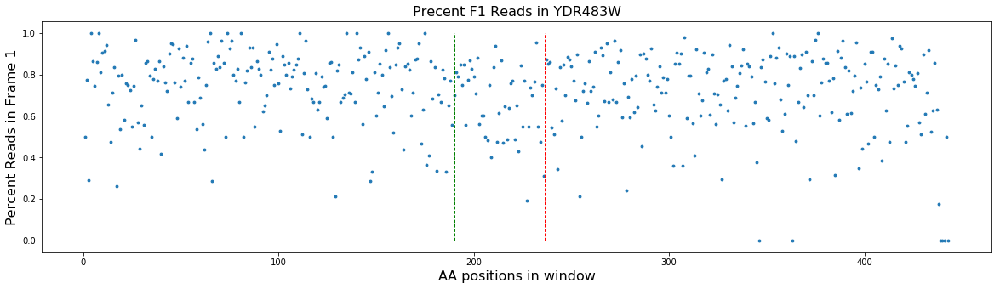

Simulated Percent: 0.05
54 175


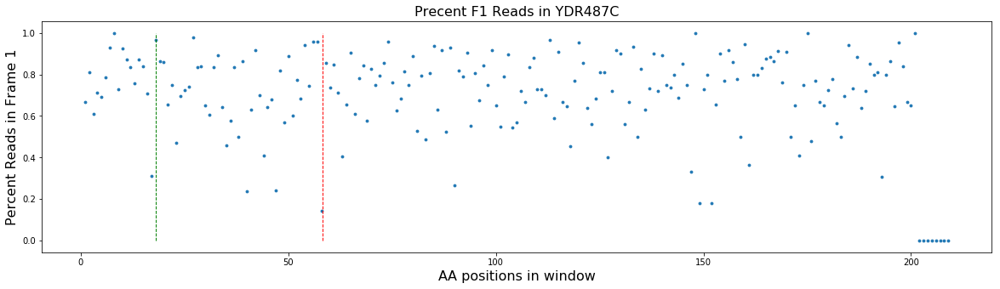

Simulated Percent: 0.1
861 922


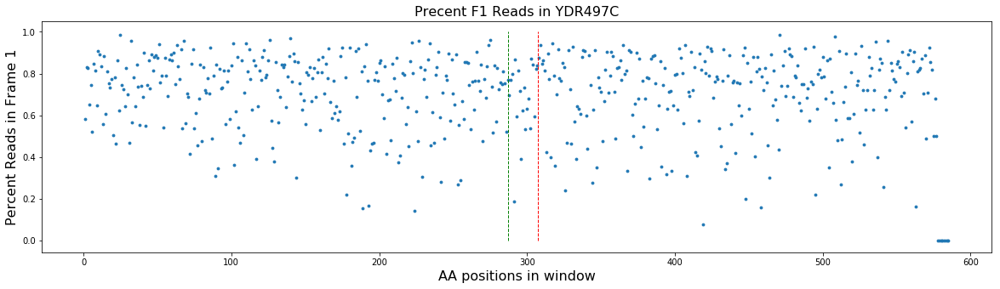

Simulated Percent: 0.5
417 467


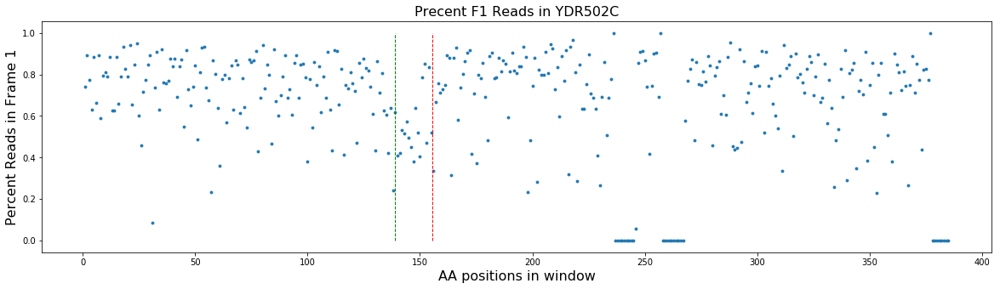

Simulated Percent: 0.7
318 385


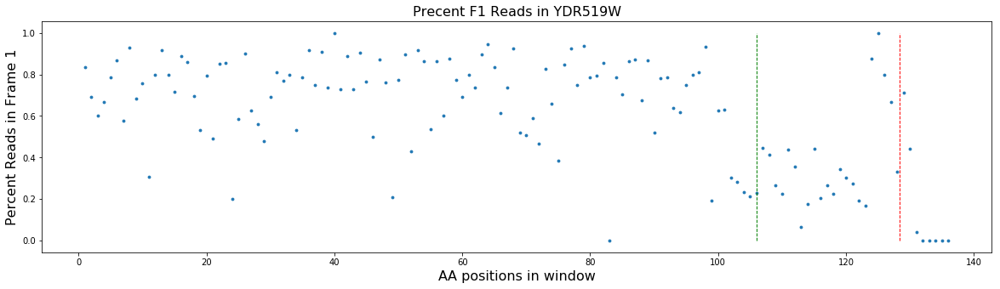

Simulated Percent: 0.1
1197 1261


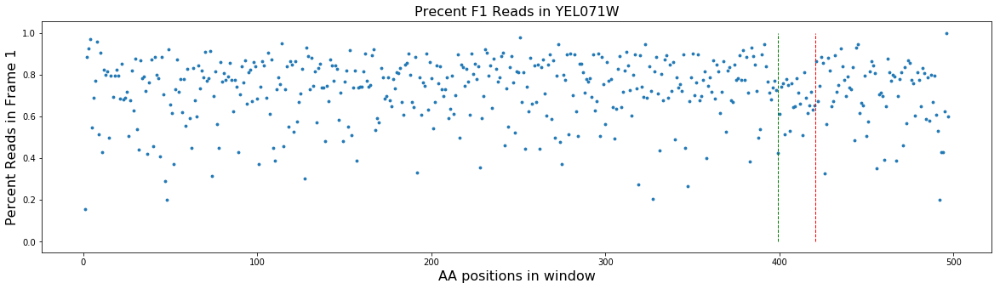

Simulated Percent: 0.3
1212 1432


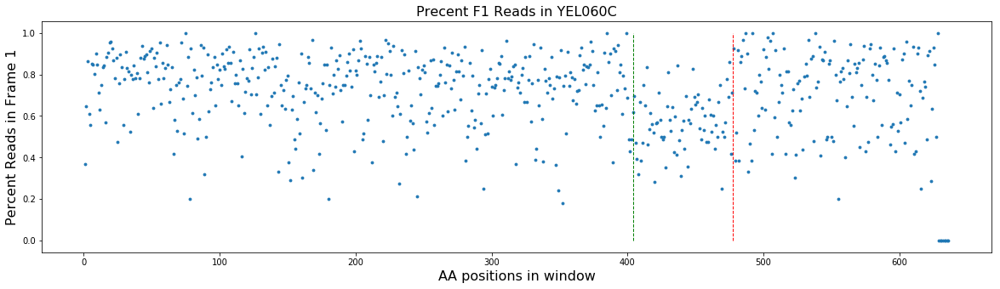

Simulated Percent: 0.8
222 280


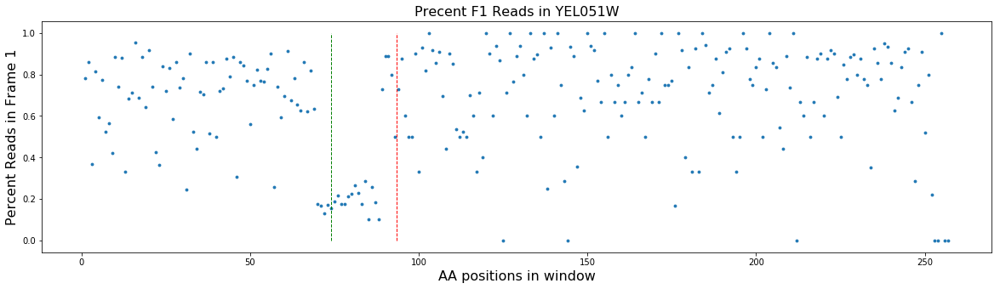

Simulated Percent: 0.5
1074 1195


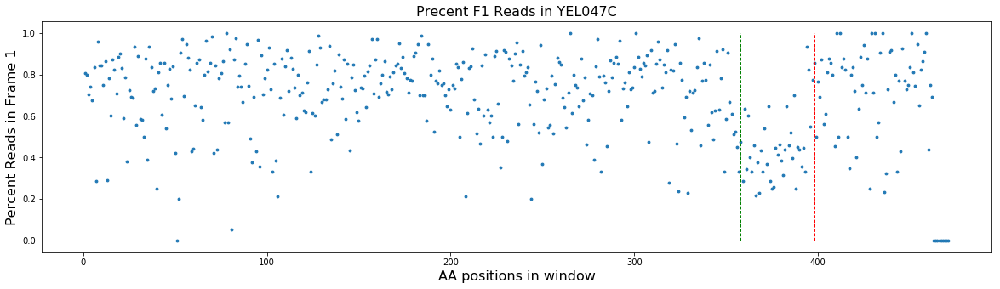

Simulated Percent: 0.4
498 589


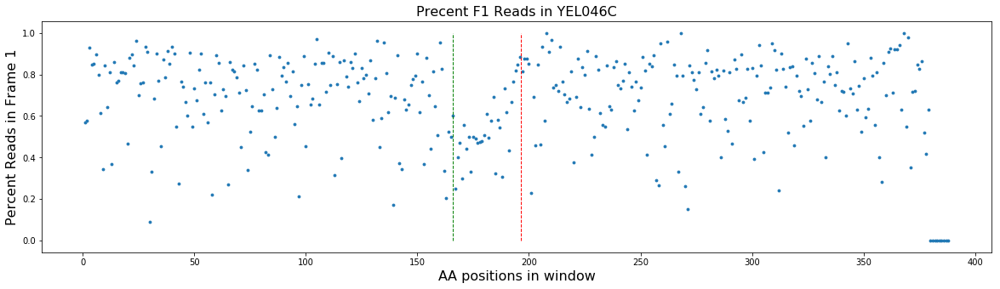

Simulated Percent: 0.4
669 1006


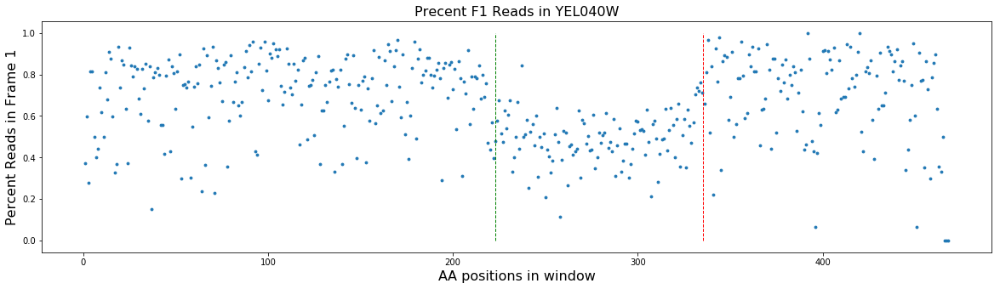

Simulated Percent: 0.6
609 775


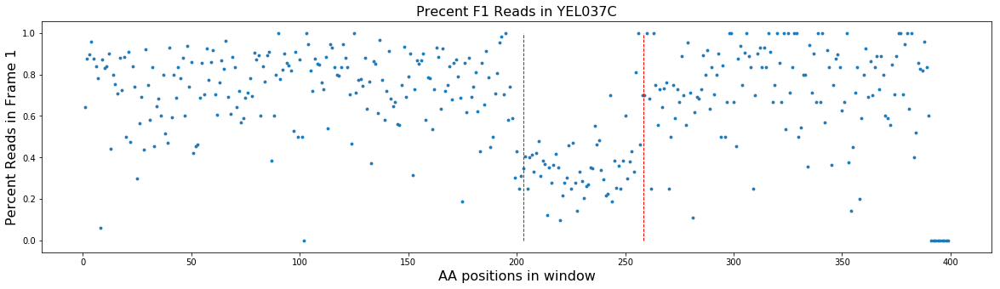

Simulated Percent: 0.9
732 793


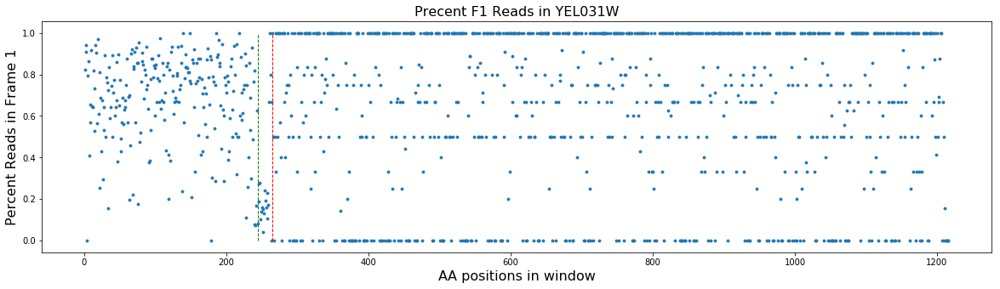

Simulated Percent: 0.3
306 362


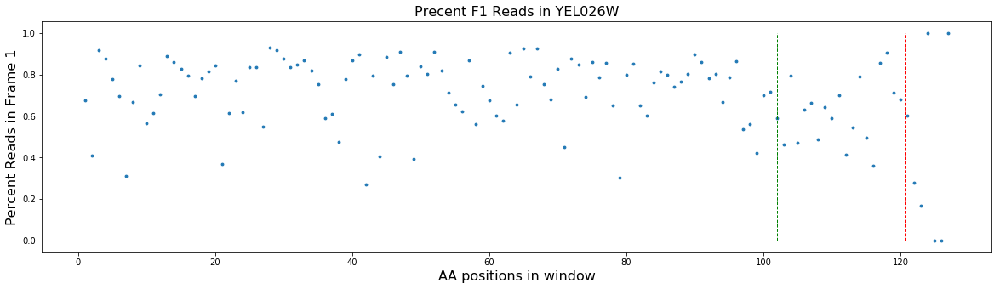

Simulated Percent: 0.4
33 104


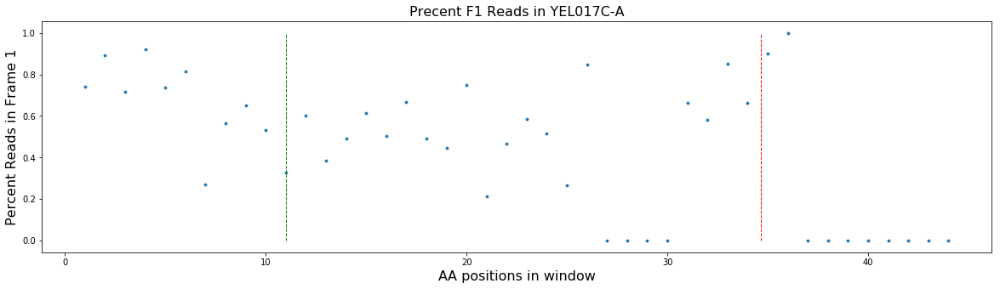

Simulated Percent: 0.5
501 553


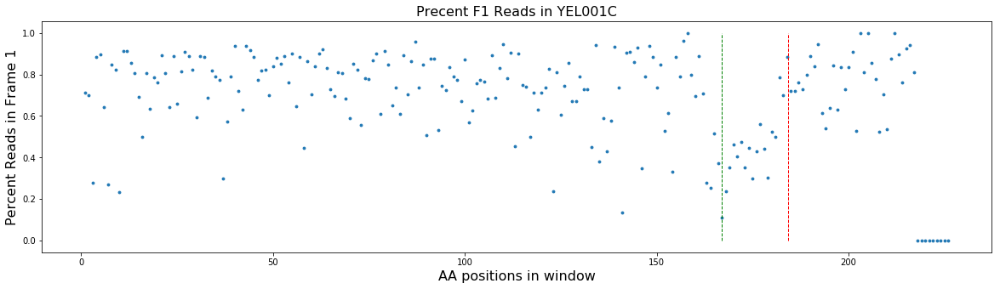

Simulated Percent: 0.2
189 257


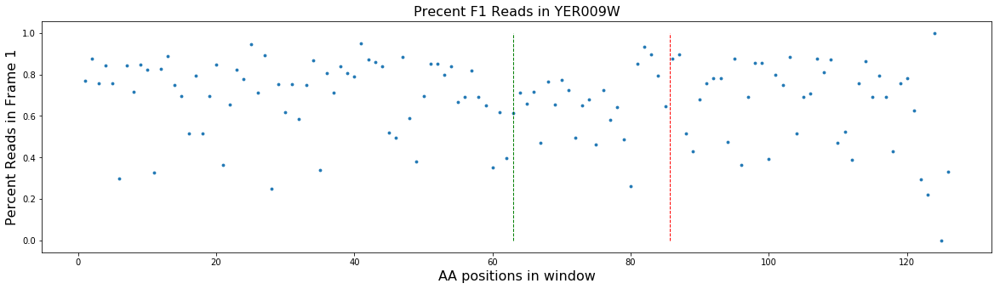

Simulated Percent: 0.4
192 262


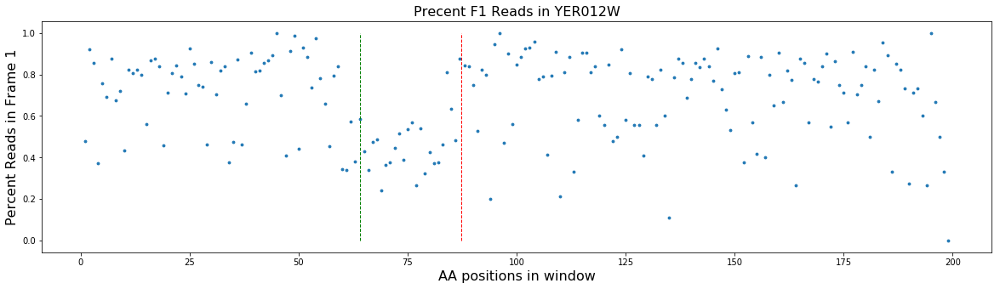

Simulated Percent: 0.5
144 223


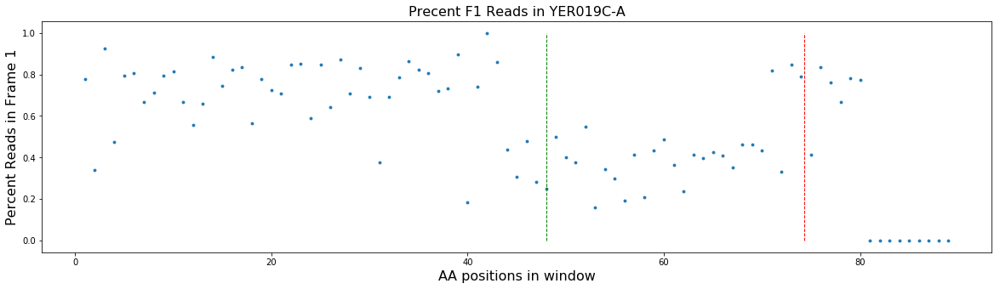

Simulated Percent: 0.2
852 905


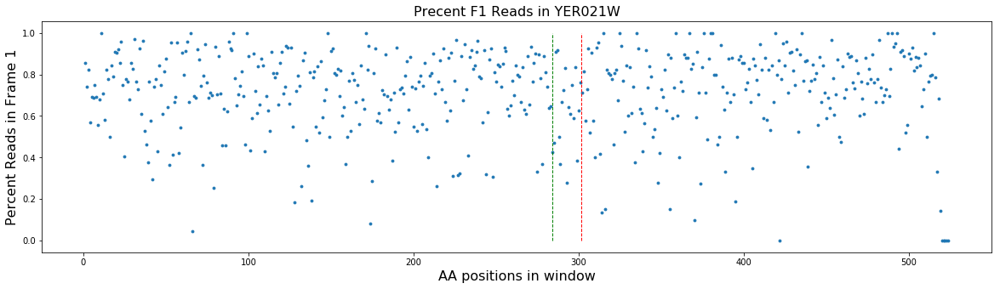

Simulated Percent: 0.05
1308 1376


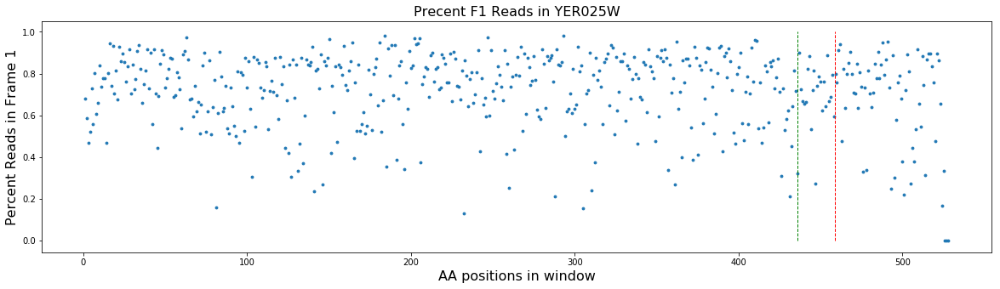

Simulated Percent: 0.05
261 323


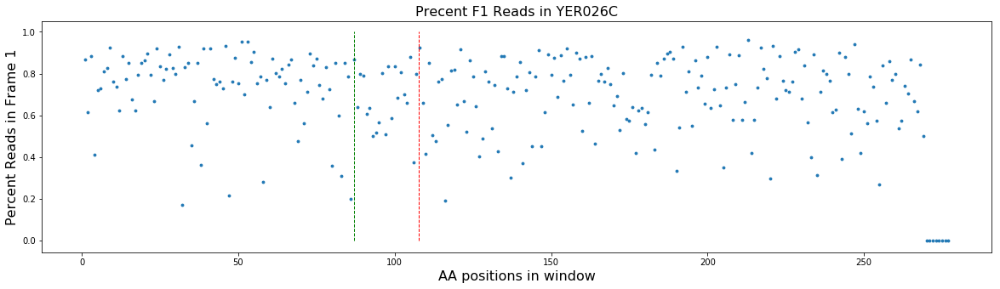

Simulated Percent: 0.2
54 133


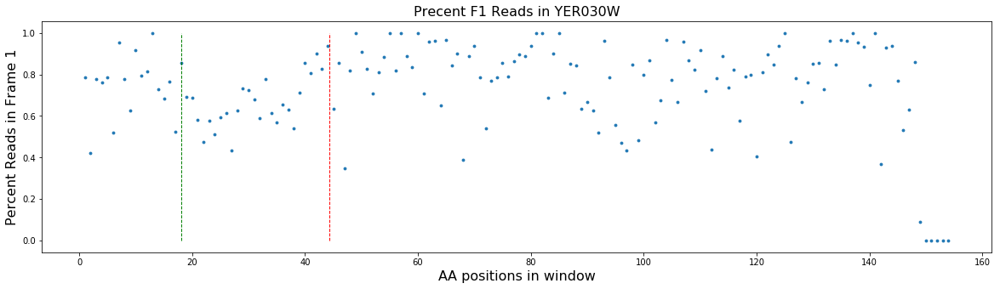

Simulated Percent: 0.6
78 143


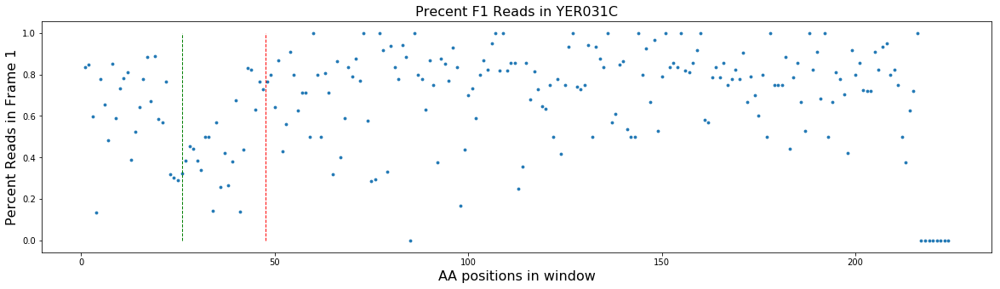

Simulated Percent: 0.3
1527 1585


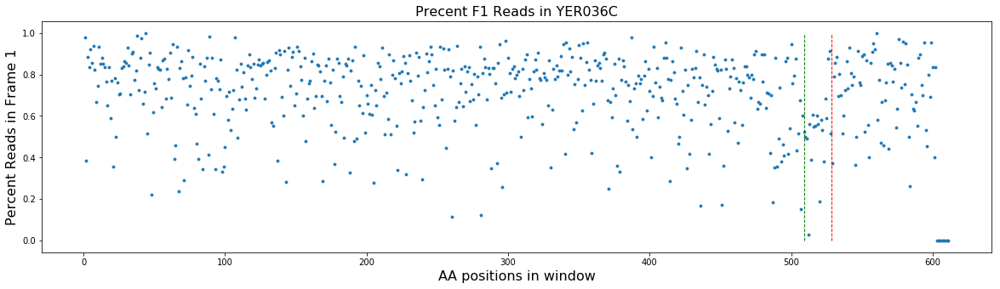

Simulated Percent: 0.4
237 382


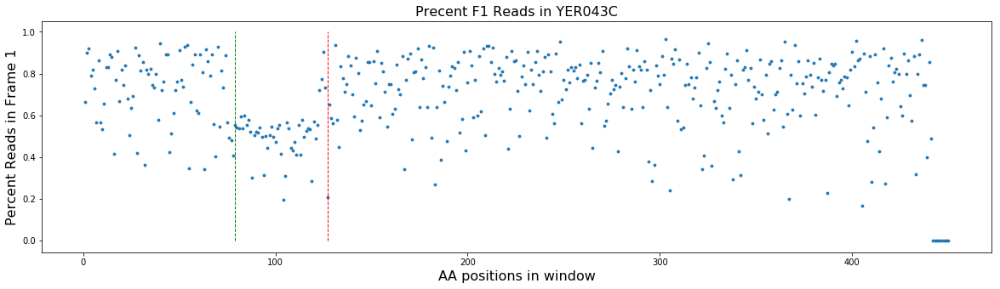

Simulated Percent: 0.3
120 200


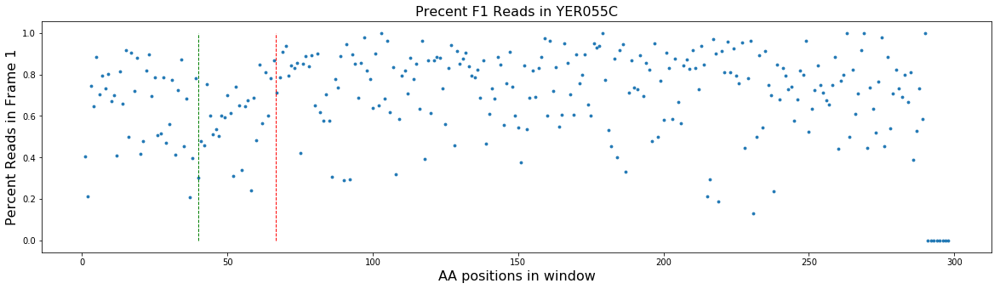

Simulated Percent: 0.5
33 134


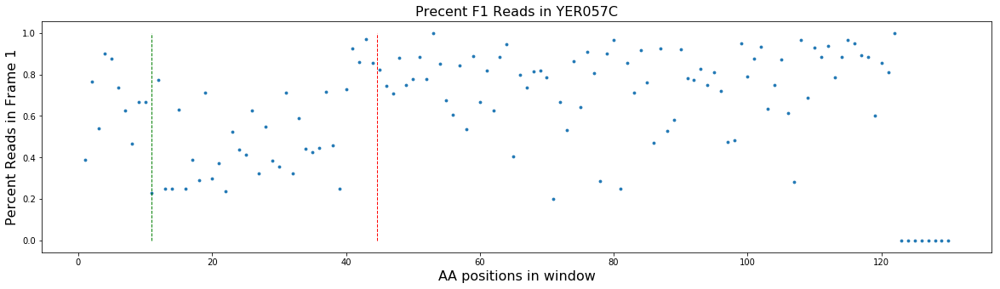

Simulated Percent: 0.5
681 742


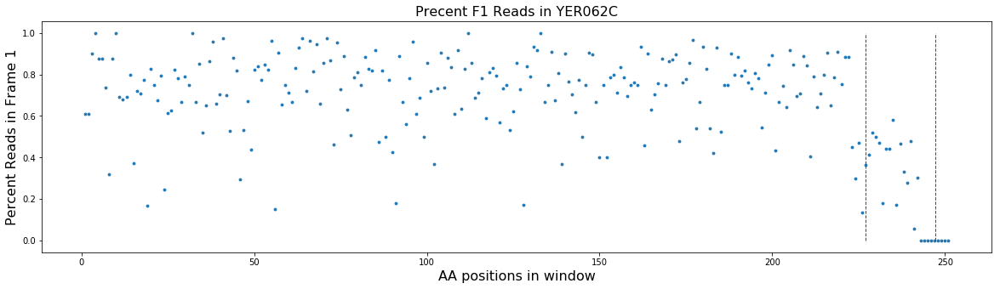

Simulated Percent: 0.3
693 758


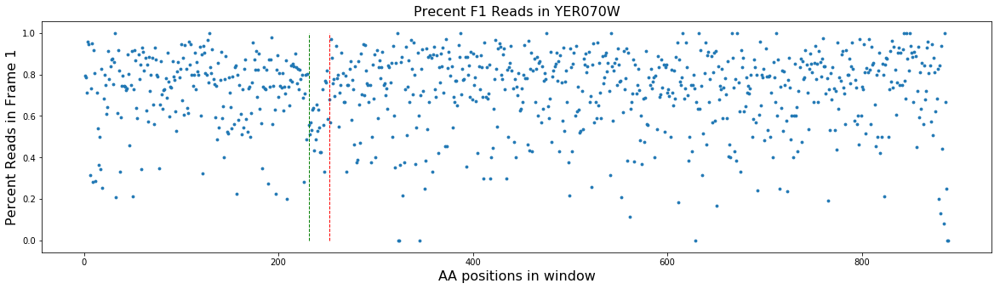

Simulated Percent: 0.8
762 886


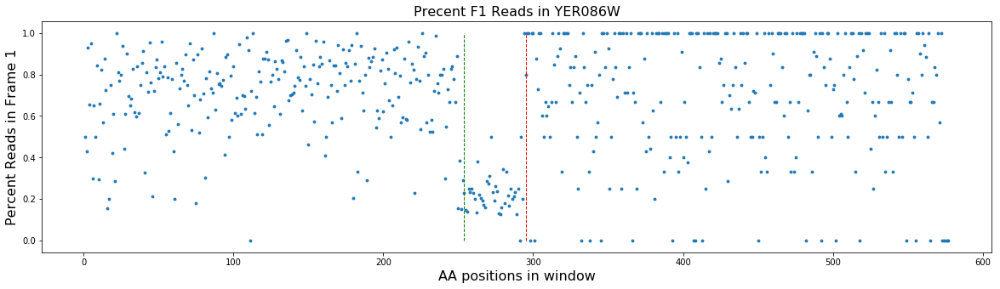

Simulated Percent: 0.2
48 100


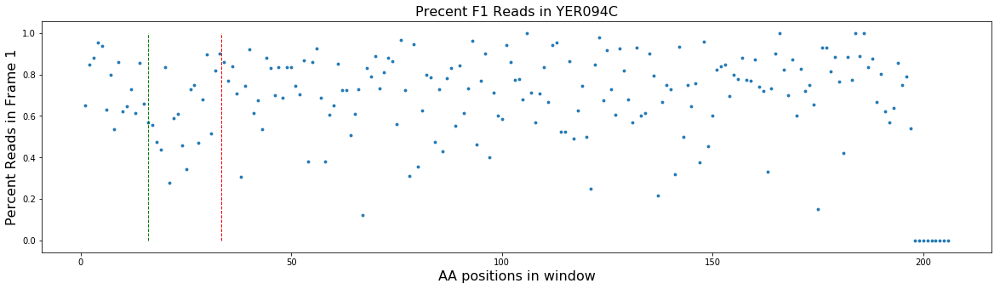

Simulated Percent: 0.5
465 565


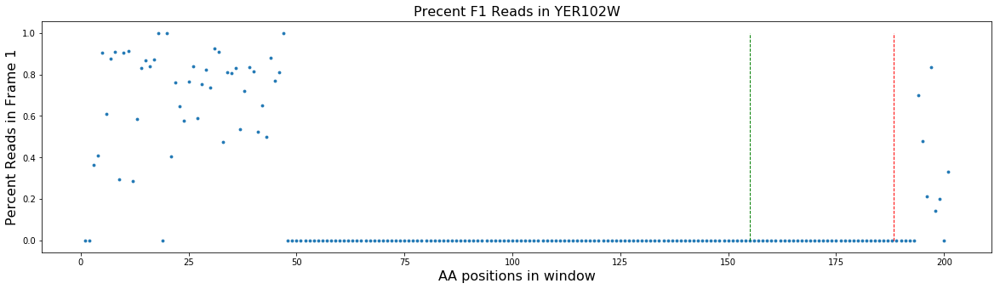

Simulated Percent: 0.3
201 251


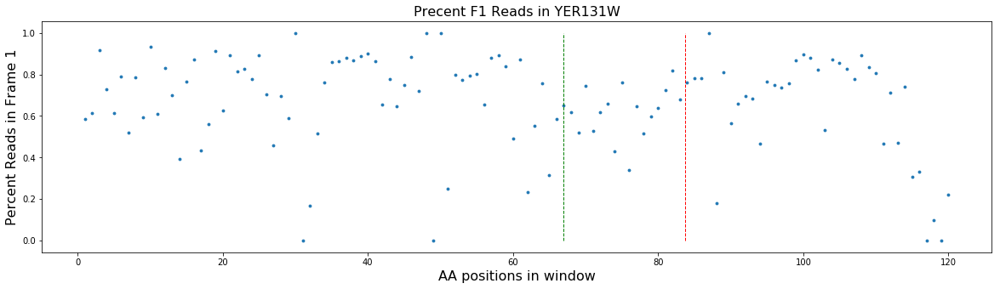

Simulated Percent: 0.1
585 715


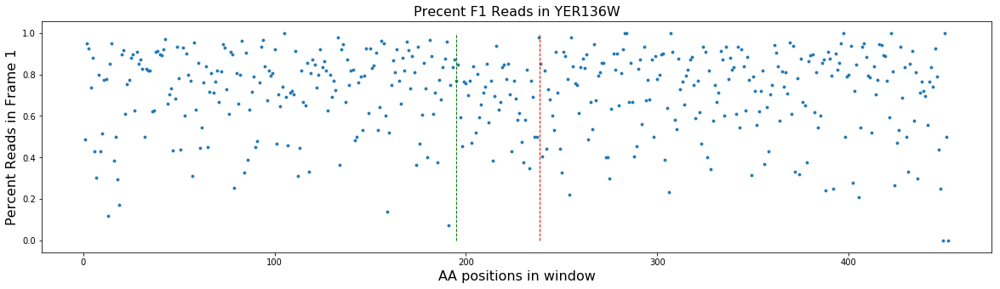

Simulated Percent: 0.1
1386 1597


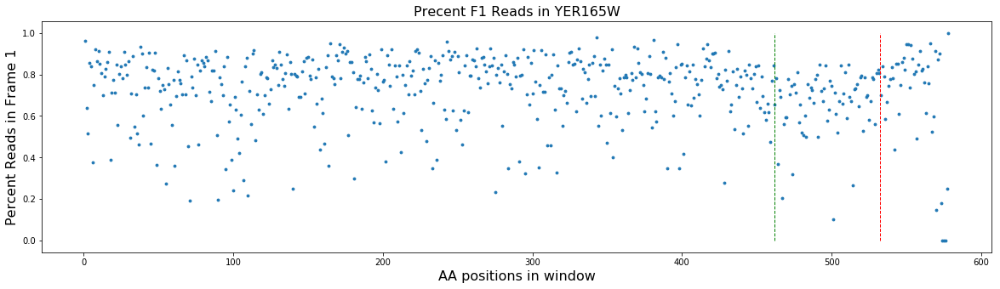

Simulated Percent: 0.1
270 331


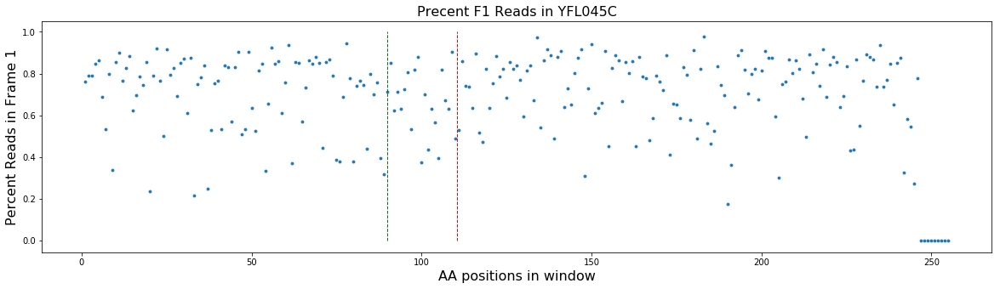

Simulated Percent: 0.05
192 263


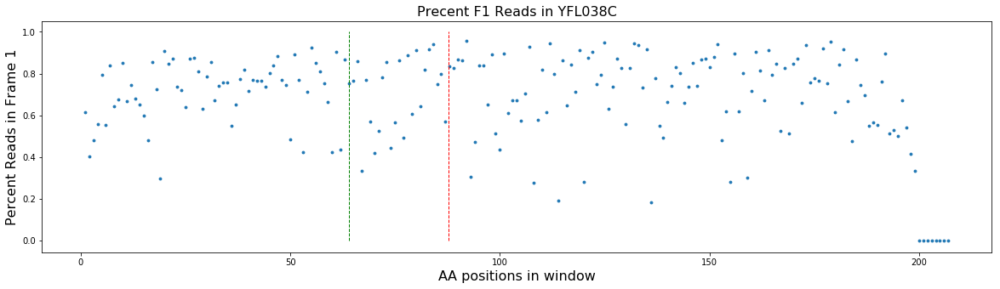

Simulated Percent: 0.5
657 743


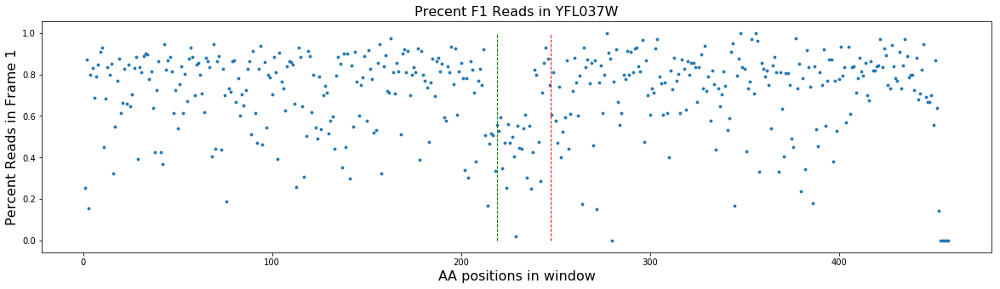

Simulated Percent: 0.3
615 671


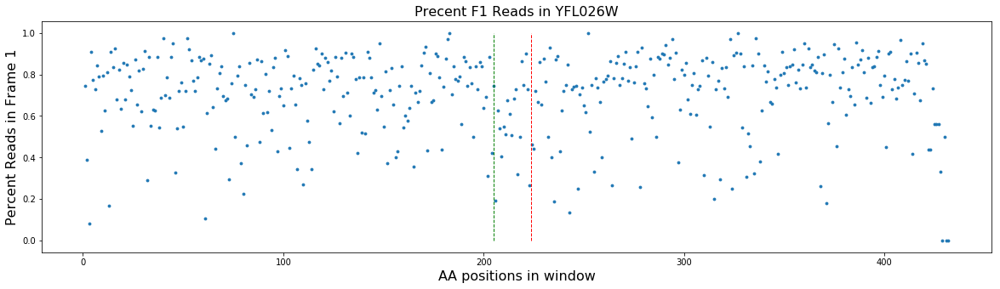

Simulated Percent: 0.4
1260 1360


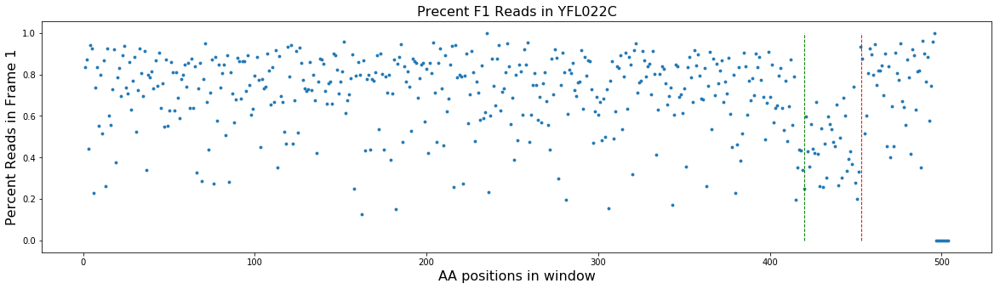

Simulated Percent: 0.4
1299 1360


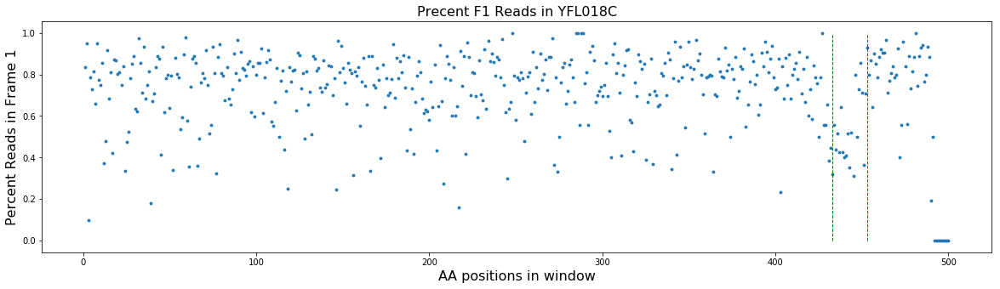

Simulated Percent: 0.4
84 265


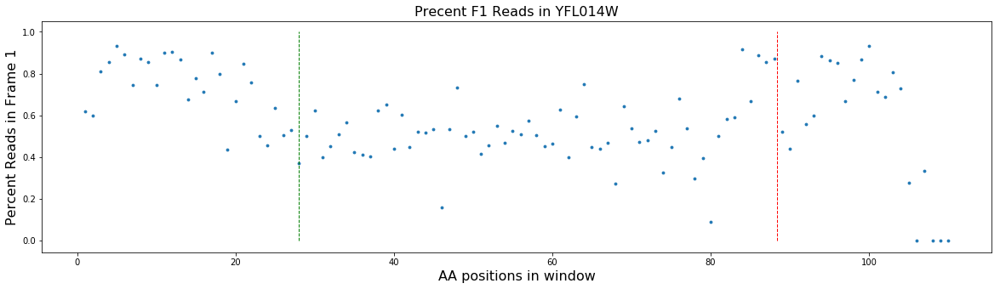

Simulated Percent: 0.2
474 535


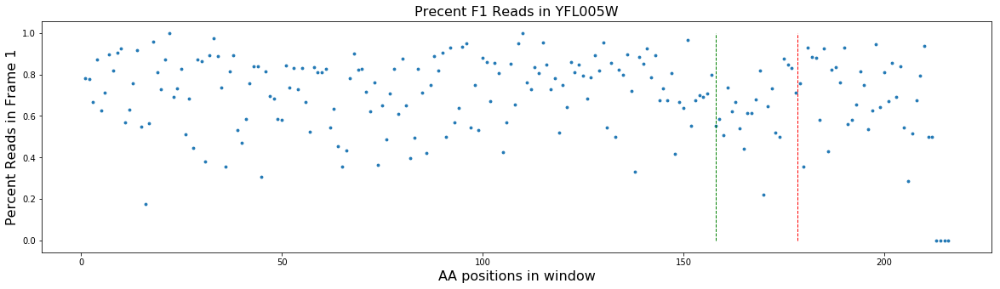

Simulated Percent: 0.6
33 94


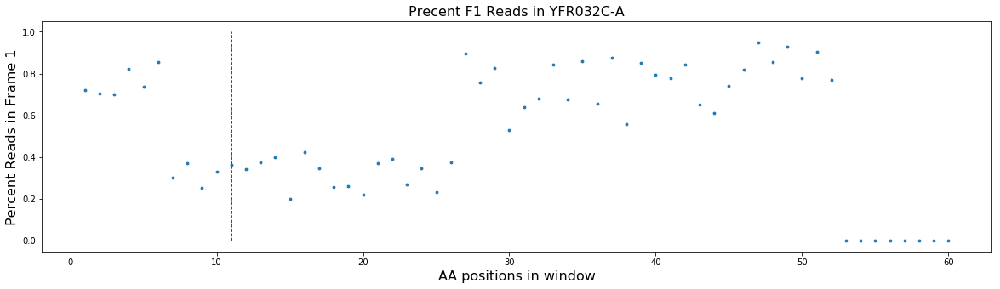

Simulated Percent: 0.05
408 569


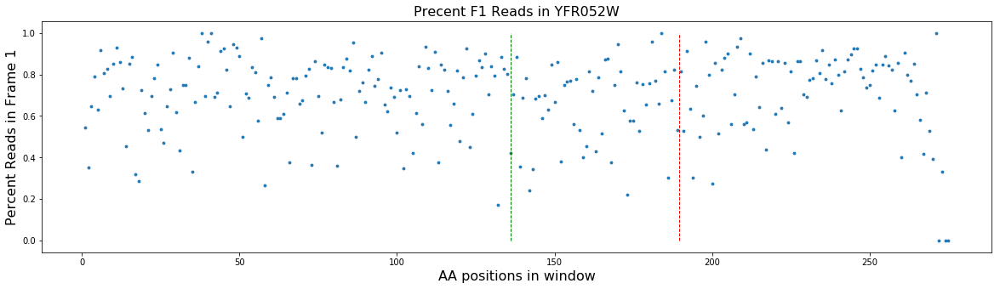

Simulated Percent: 0.1
702 928


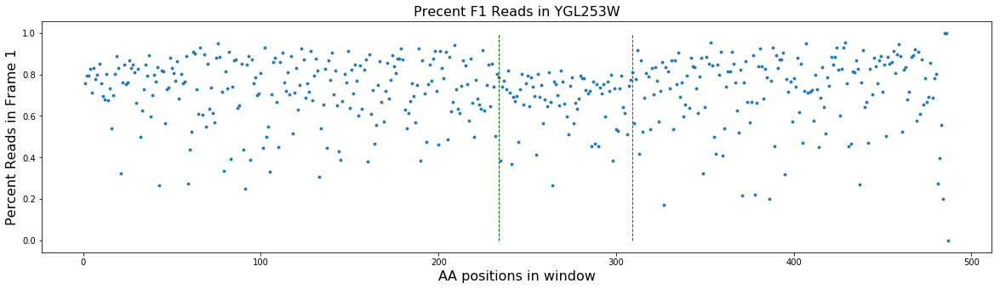

Simulated Percent: 0.3
723 787


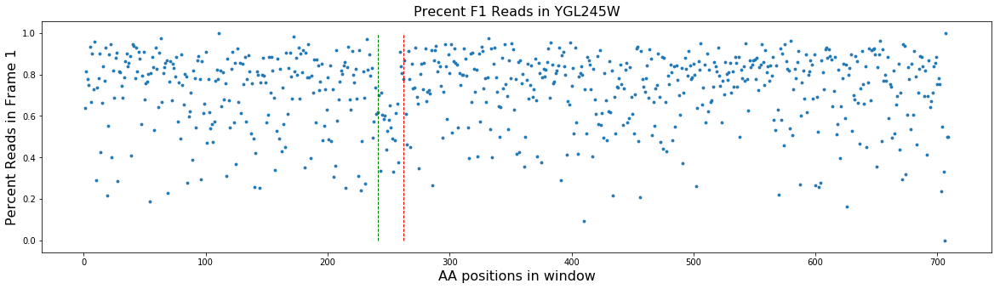

Simulated Percent: 0.1
621 694


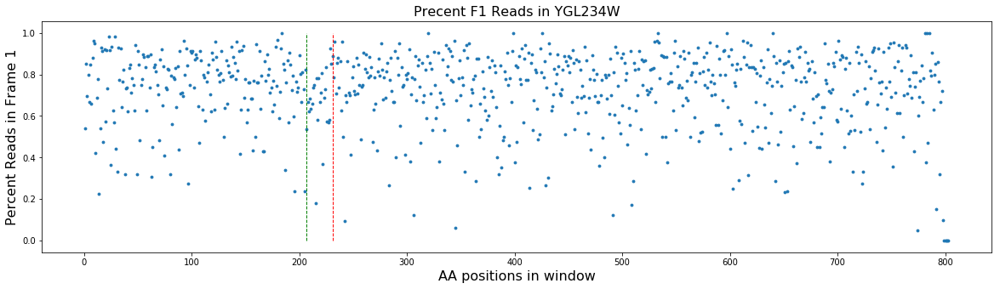

Simulated Percent: 0.6
189 295


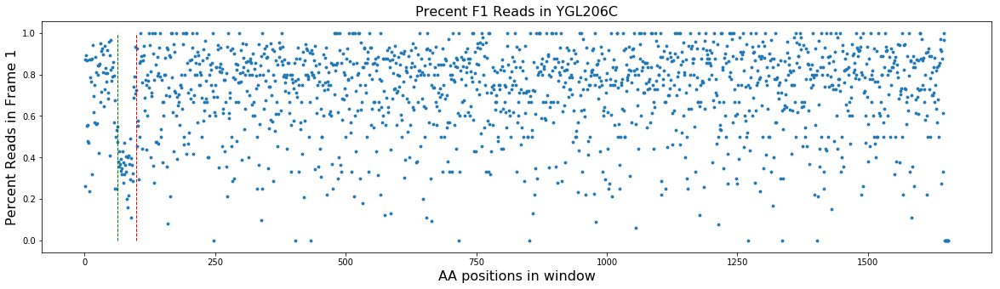

Simulated Percent: 0.4
189 335


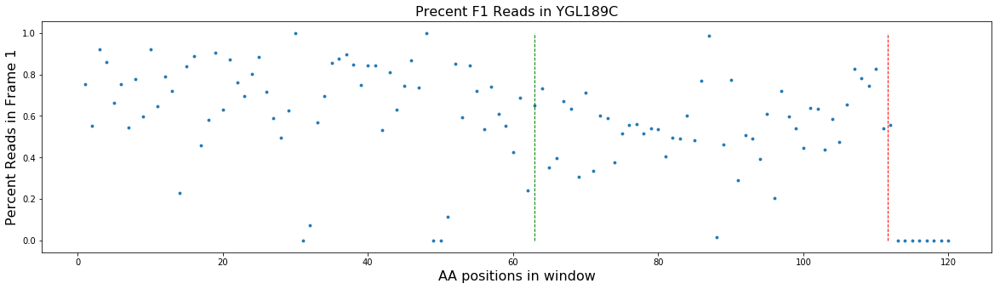

Simulated Percent: 0.2
243 299


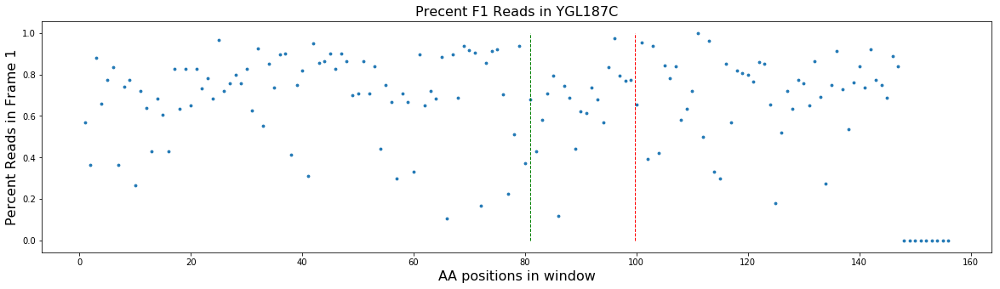

Simulated Percent: 0.5
783 850


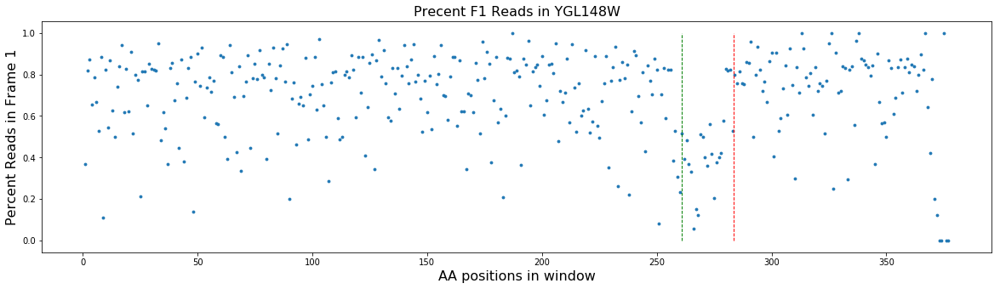

Simulated Percent: 0.5
135 224


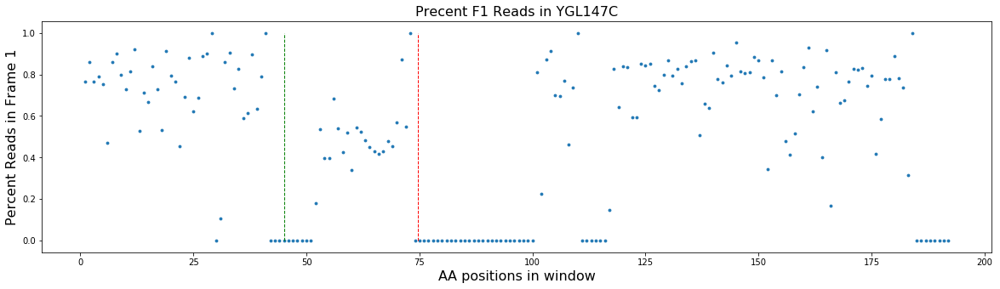

Simulated Percent: 0.3
42 122


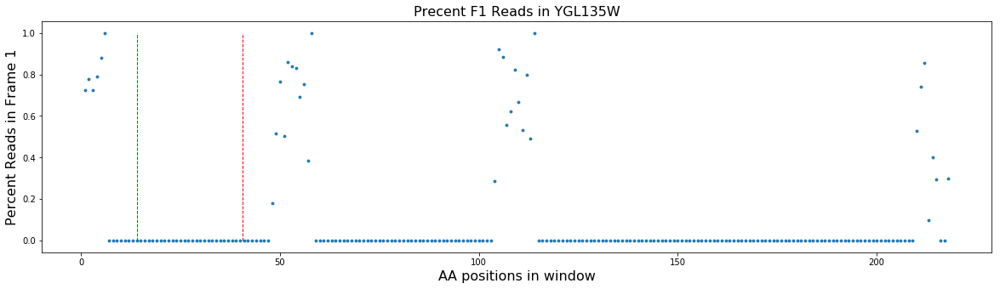

Simulated Percent: 0.6
153 229


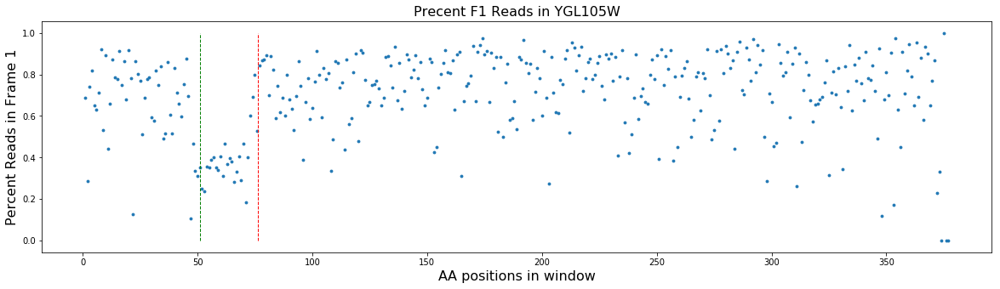

Simulated Percent: 0.3
1119 1189


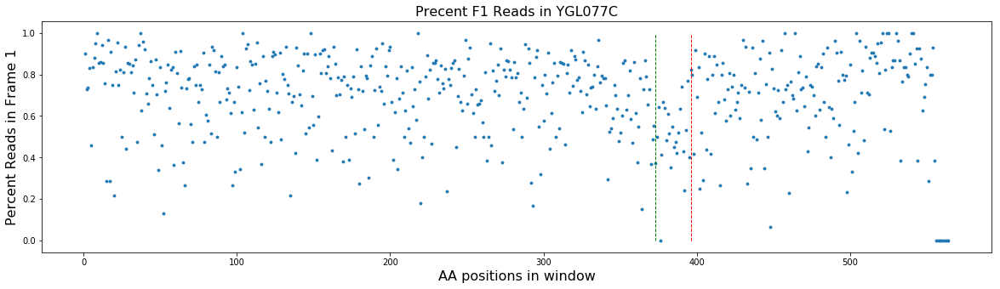

Simulated Percent: 0.4
822 902


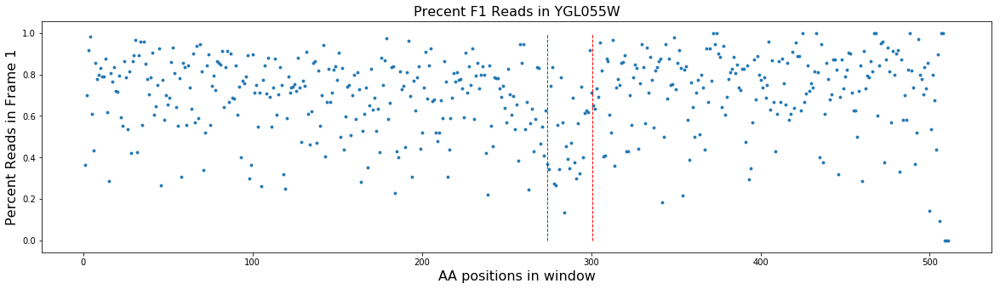

Simulated Percent: 0.4
36 88


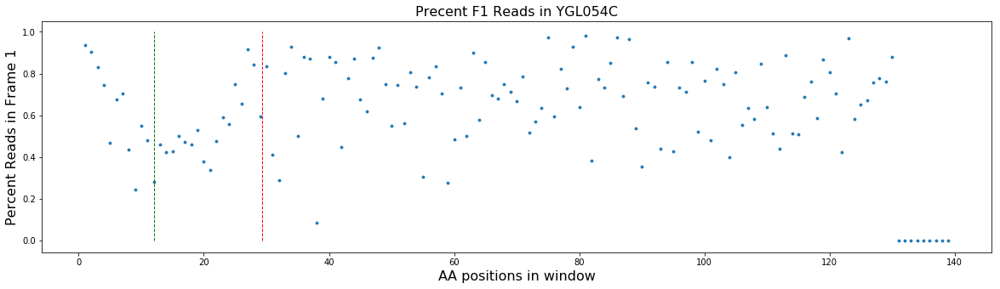

Simulated Percent: 0.05
633 692


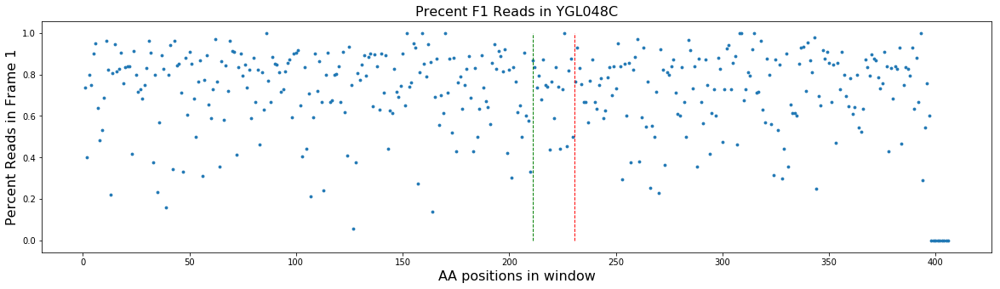

Simulated Percent: 0.4
555 616


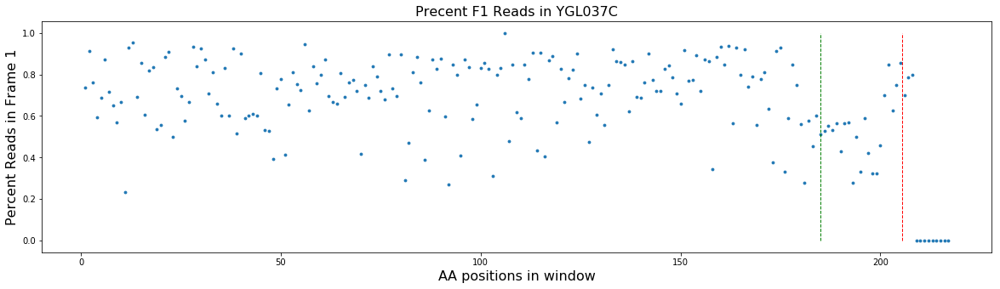

Simulated Percent: 0.1
87 203


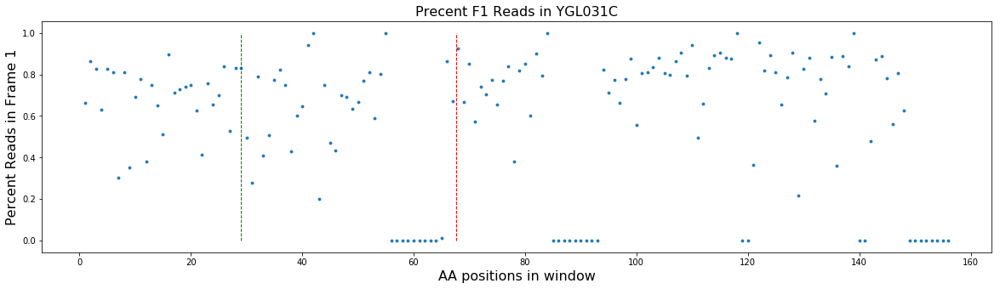

Simulated Percent: 0.4
324 400


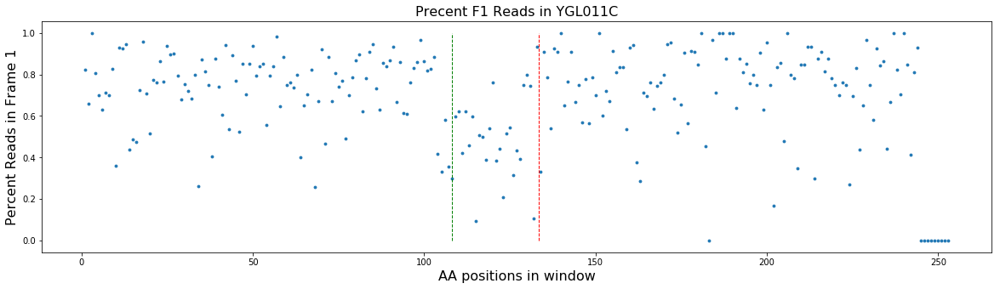

Simulated Percent: 0.7
909 979


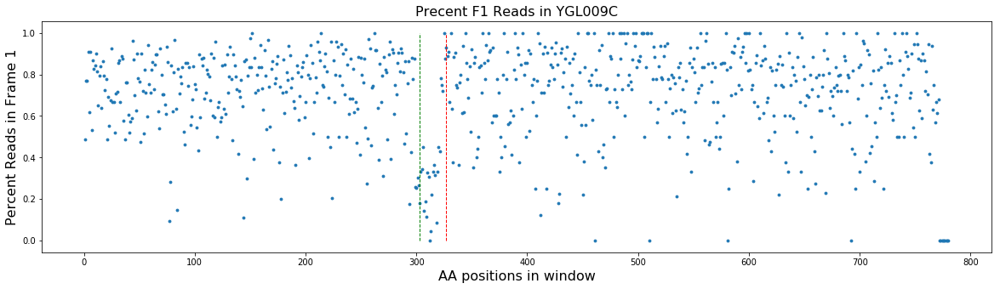

Simulated Percent: 0.7
1152 1210


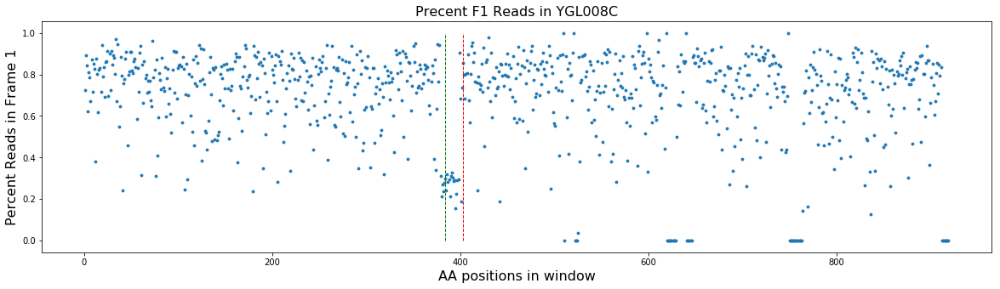

Simulated Percent: 0.6
75 202


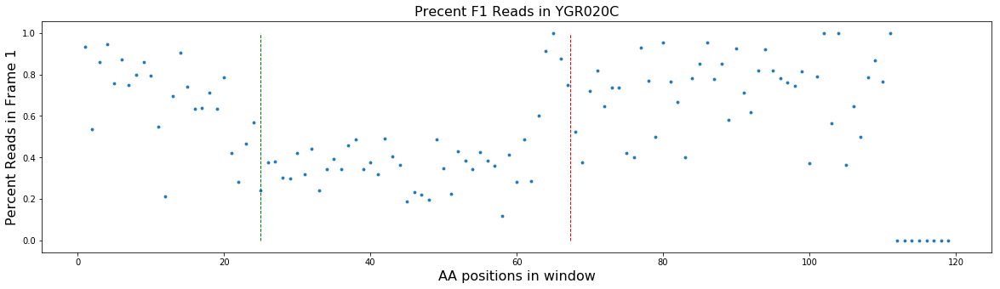

Simulated Percent: 0.7
168 227


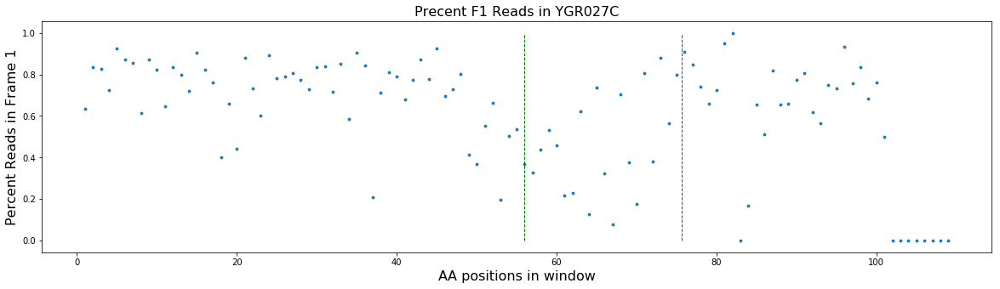

Simulated Percent: 0.6
135 191


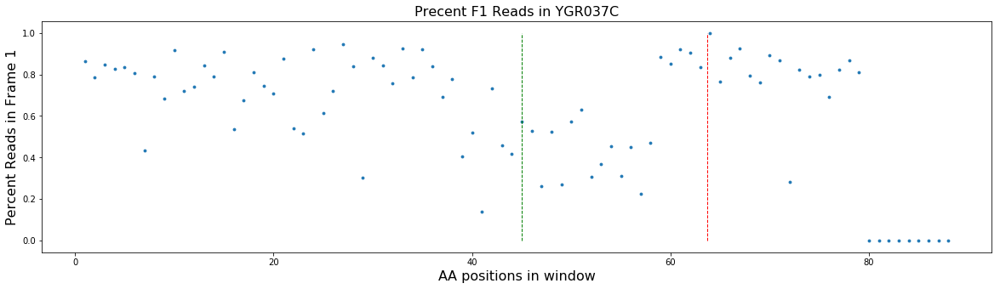

Simulated Percent: 0.1
645 698


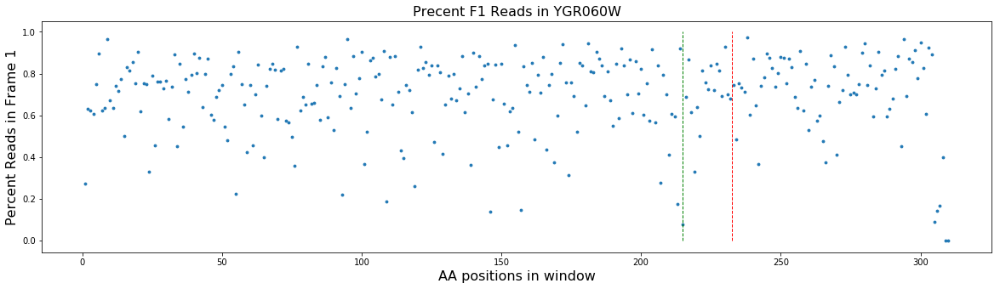

Simulated Percent: 0.05
1365 1453


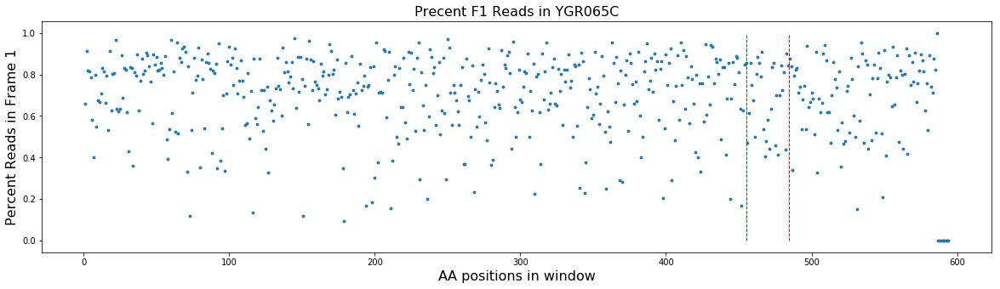

Simulated Percent: 0.3
309 391


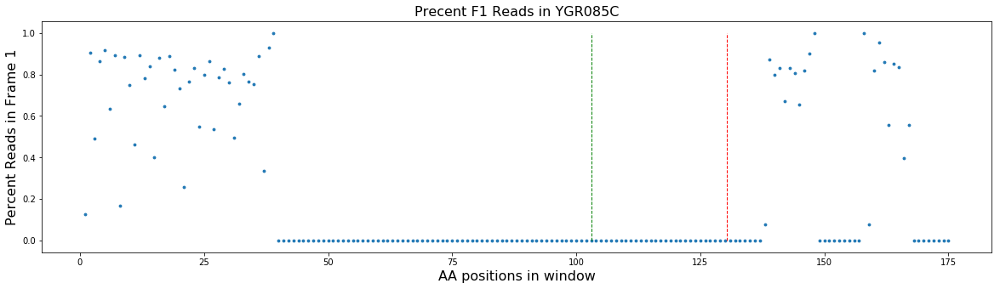

Simulated Percent: 0.5
135 185


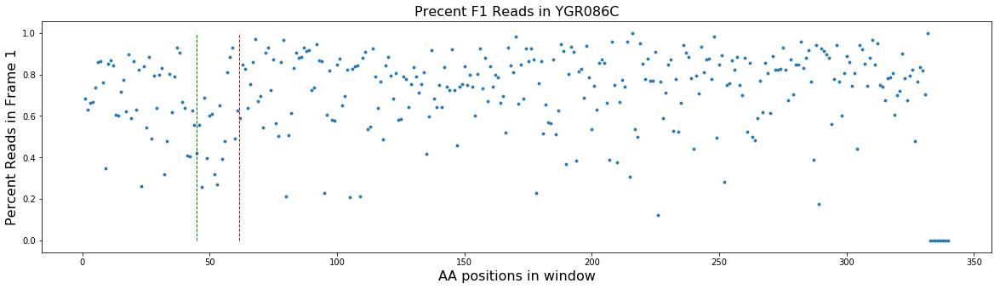

Simulated Percent: 0.2
3039 3295


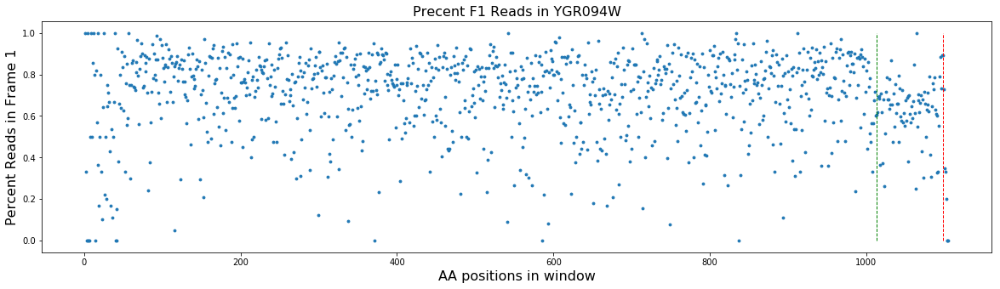

Simulated Percent: 0.7
126 194


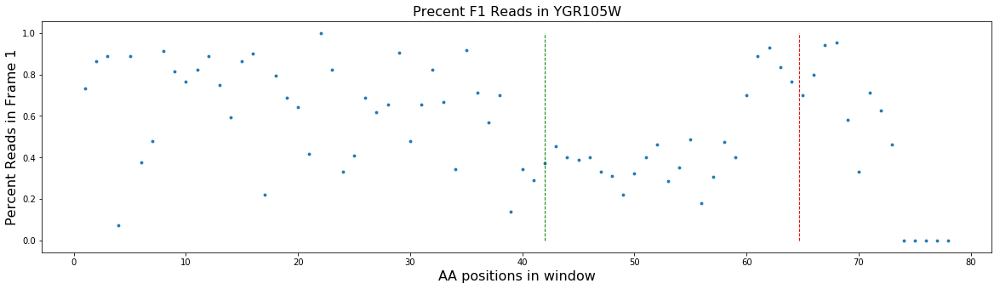

Simulated Percent: 0.05
414 464


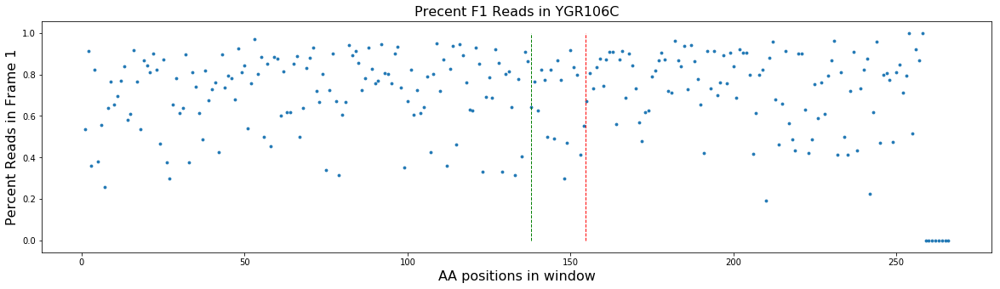

Simulated Percent: 0.2
519 646


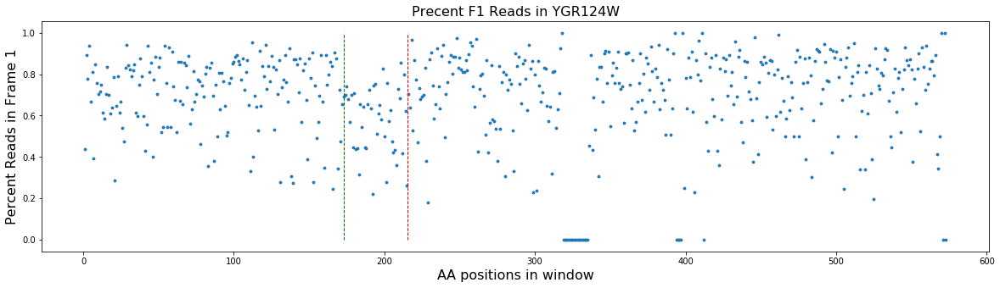

Simulated Percent: 0.9
474 550


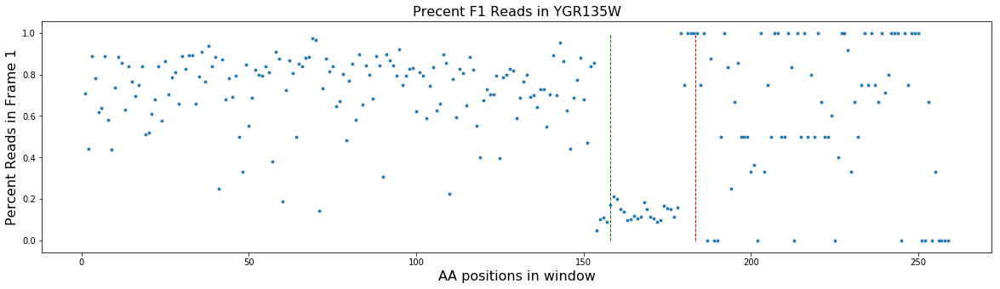

Simulated Percent: 0.3
123 203


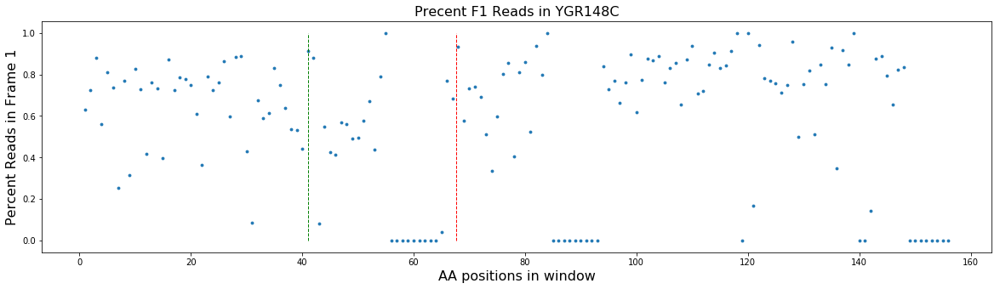

Simulated Percent: 0.3
93 229


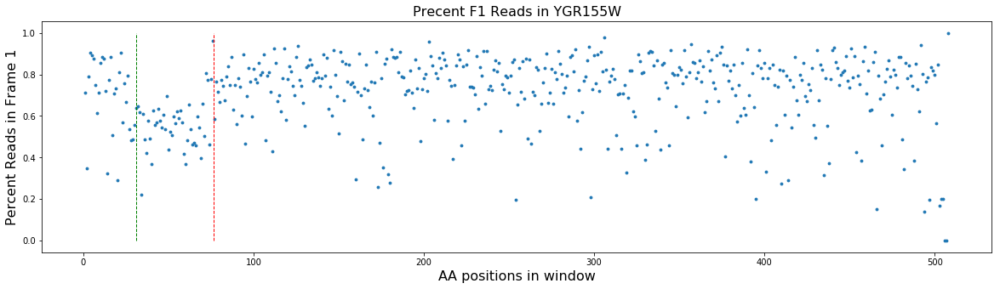

Simulated Percent: 0.3
426 538


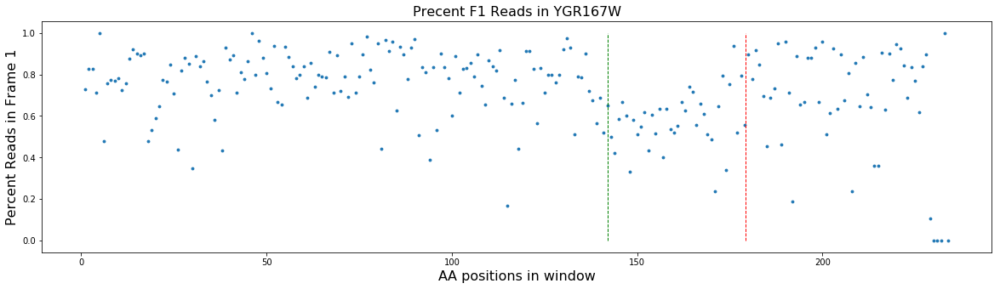

Simulated Percent: 0.05
909 1009


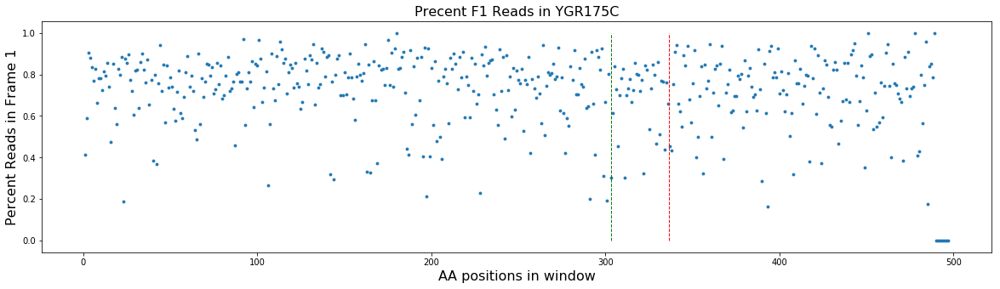

Simulated Percent: 0.4
876 932


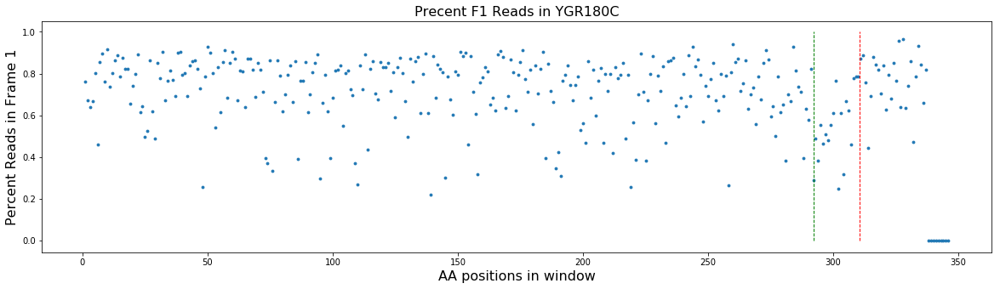

Simulated Percent: 0.7
678 835


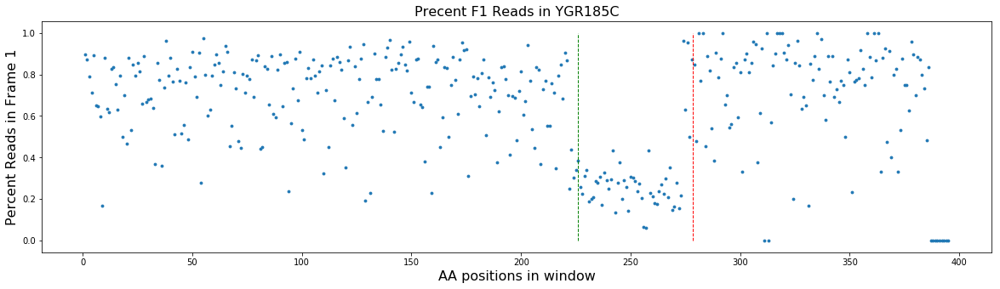

Simulated Percent: 0.8
1194 1348


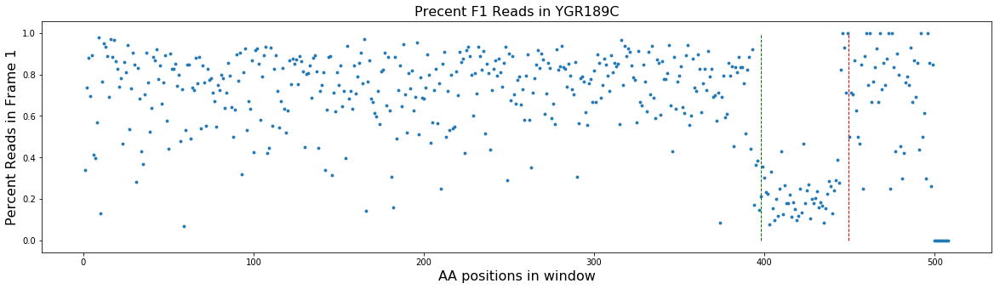

Simulated Percent: 0.3
891 977


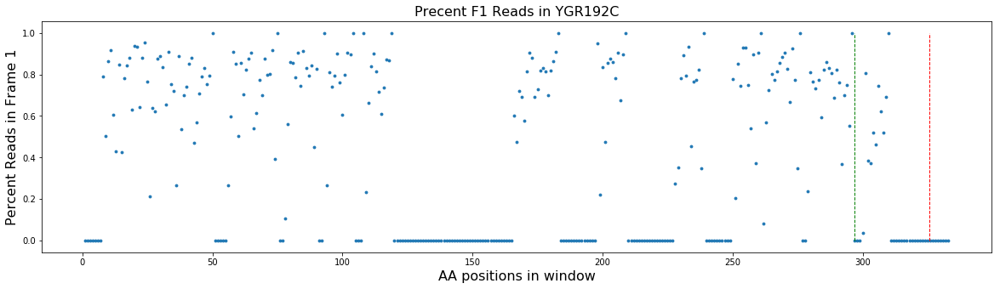

Simulated Percent: 0.7
1146 1201


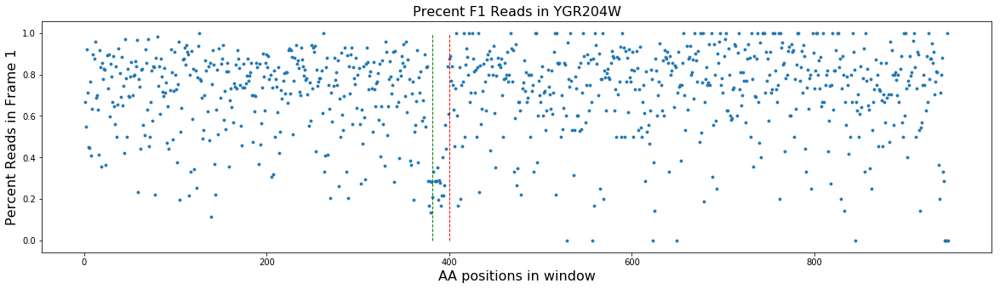

Simulated Percent: 0.3
159 226


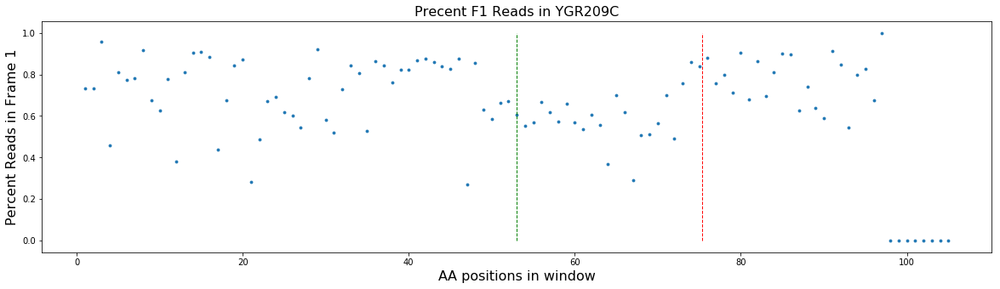

Simulated Percent: 0.05
36 101


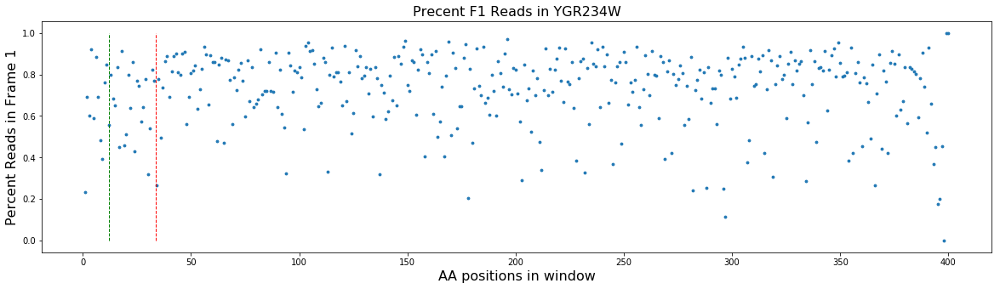

Simulated Percent: 0.1
2580 2707


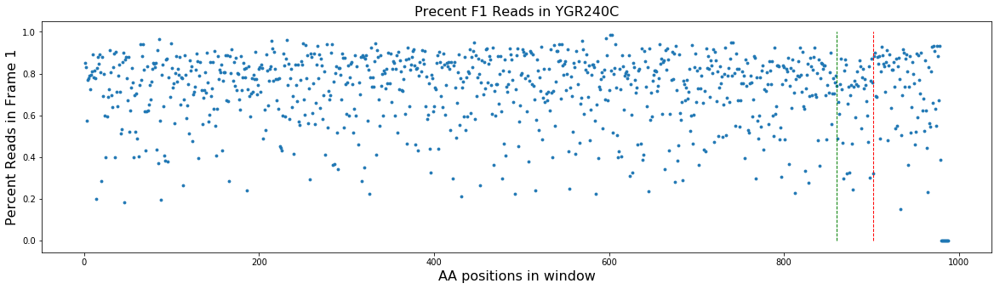

Simulated Percent: 0.7
75 182


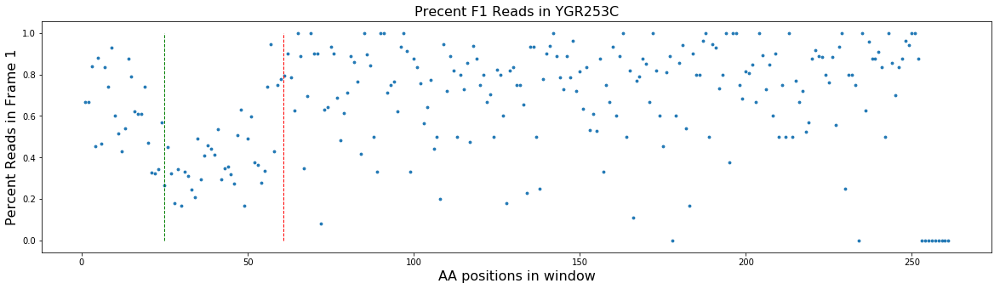

Simulated Percent: 0.3
276 469


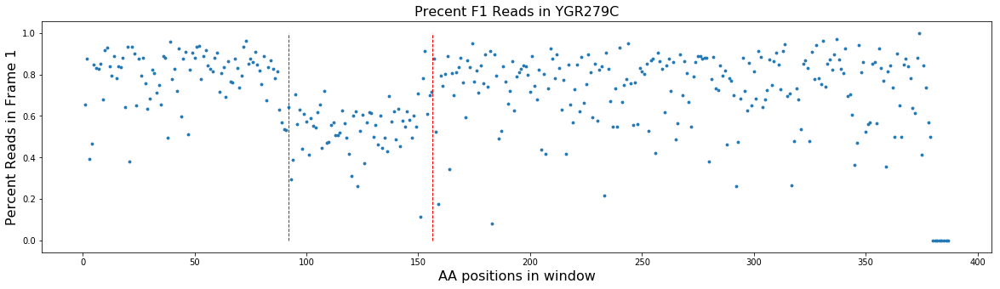

Simulated Percent: 0.6
513 619


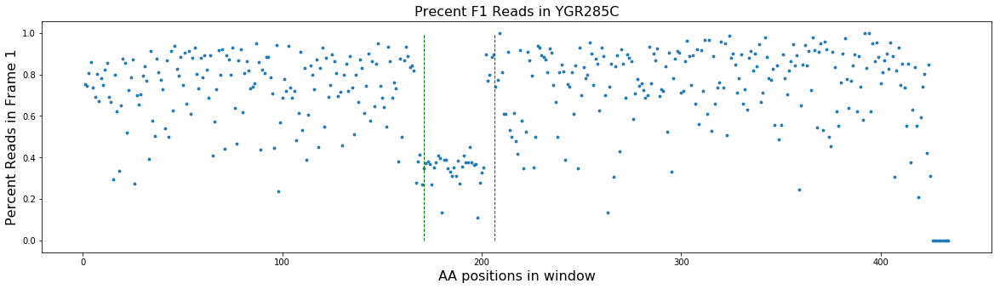

Simulated Percent: 0.2
249 299


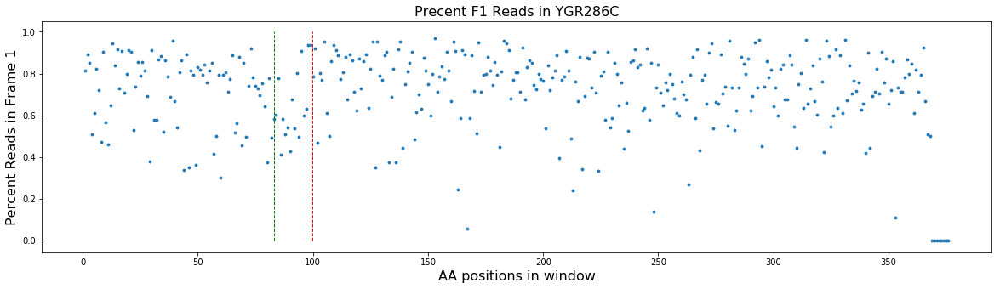

Simulated Percent: 0.3
96 308


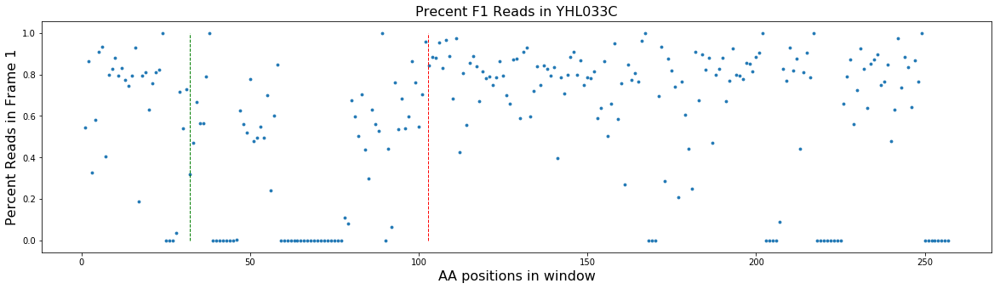

Simulated Percent: 0.3
231 299


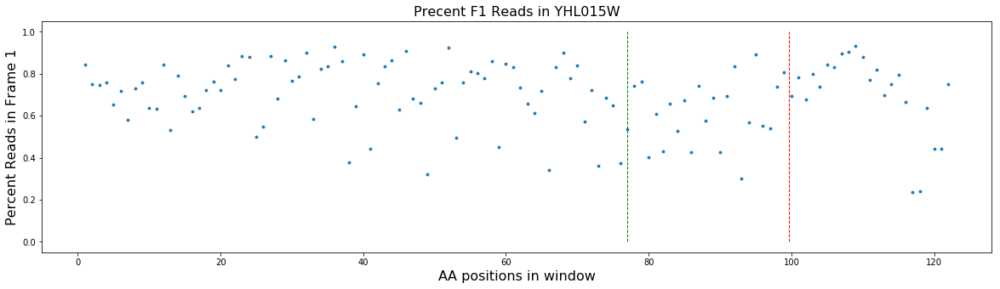

Simulated Percent: 0.2
276 340


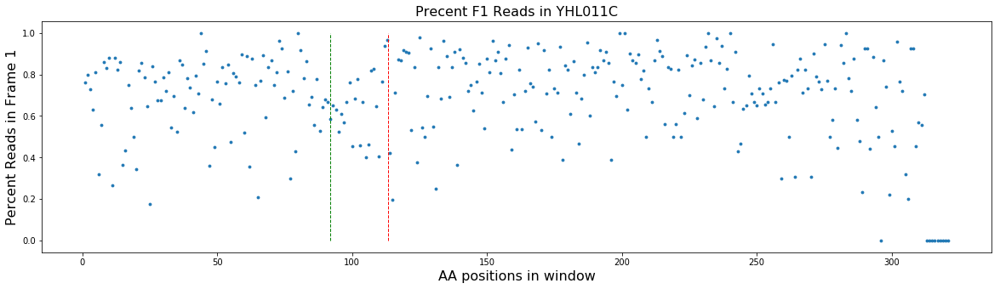

Simulated Percent: 0.4
78 160


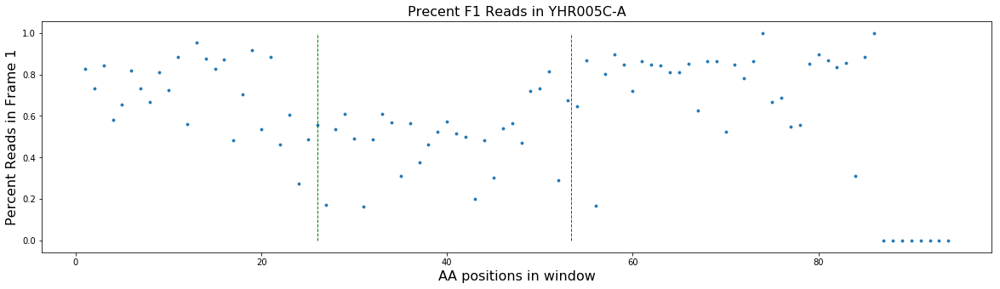

Simulated Percent: 0.1
507 559


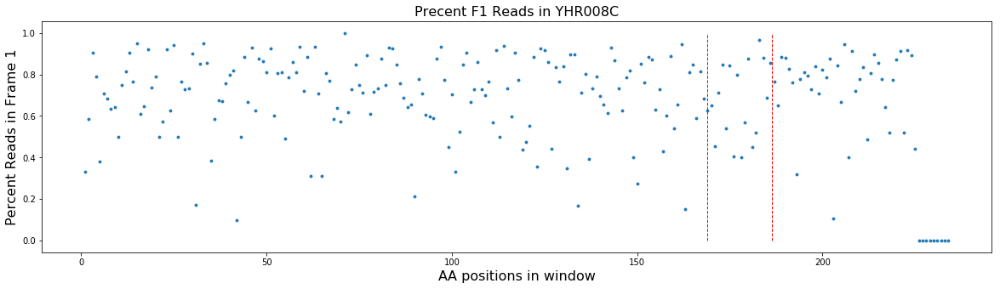

Simulated Percent: 0.4
438 526


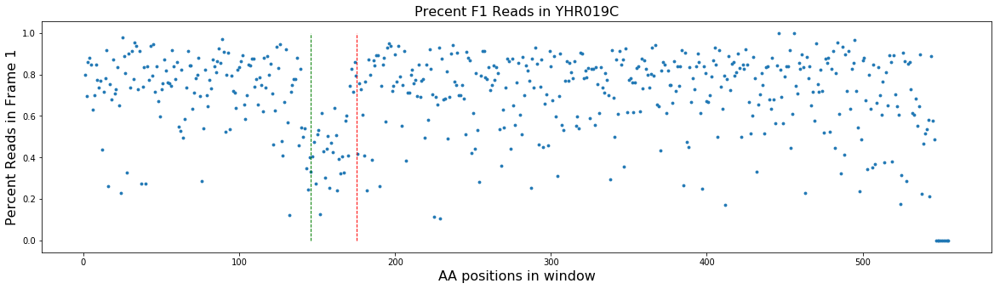

Simulated Percent: 0.7
402 565


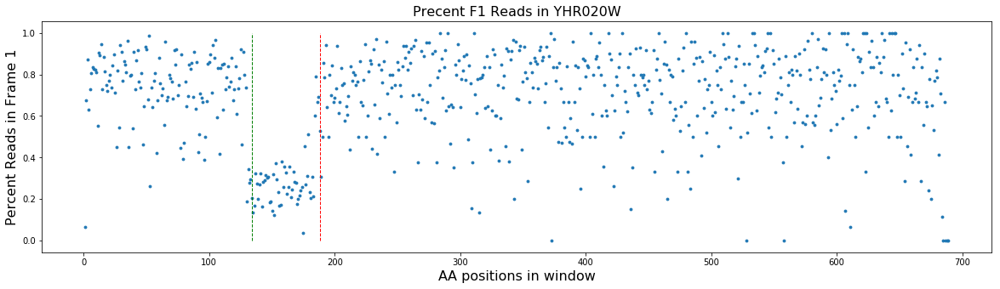

Simulated Percent: 0.1
558 757


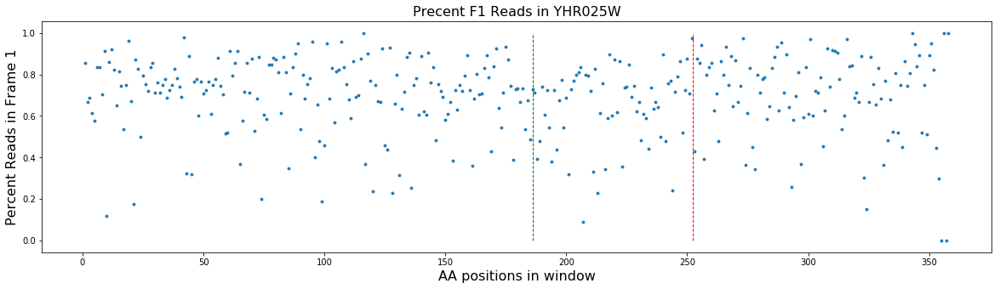

Simulated Percent: 0.8
2121 2194


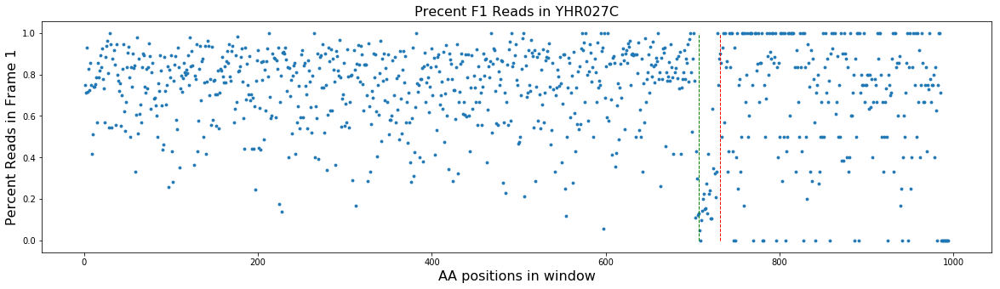

Simulated Percent: 0.05
624 700


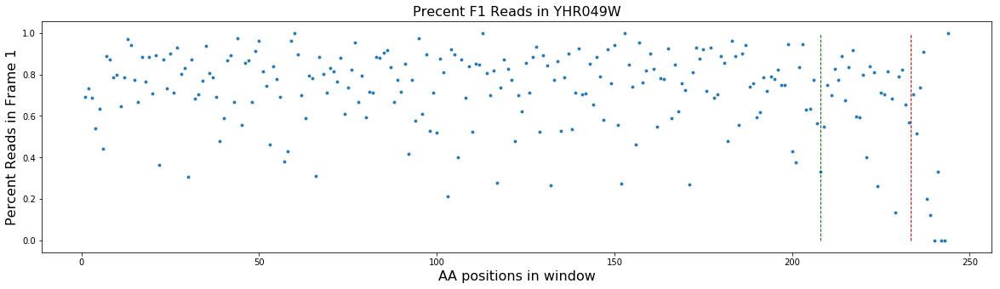

Simulated Percent: 0.4
99 241


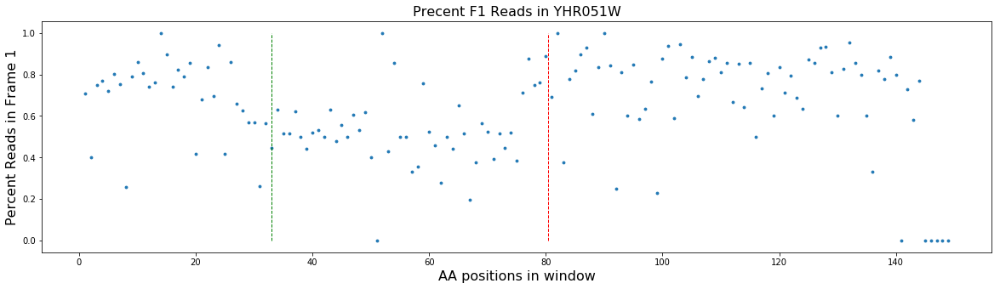

Simulated Percent: 0.3
870 962


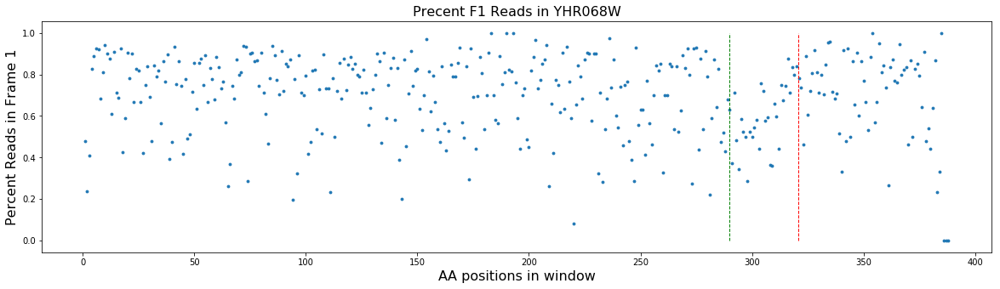

Simulated Percent: 0.3
81 136


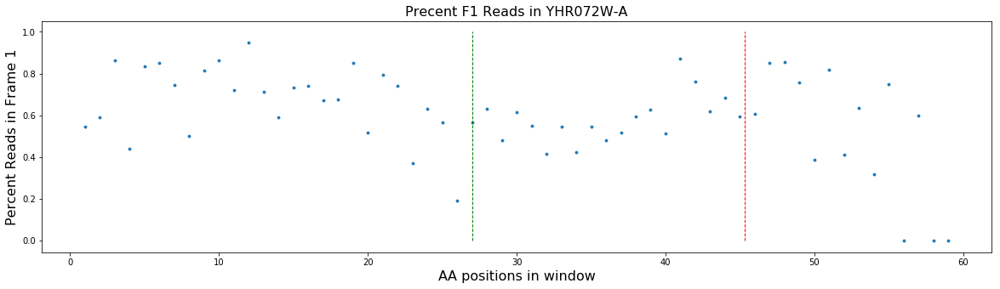

Simulated Percent: 0.3
393 467


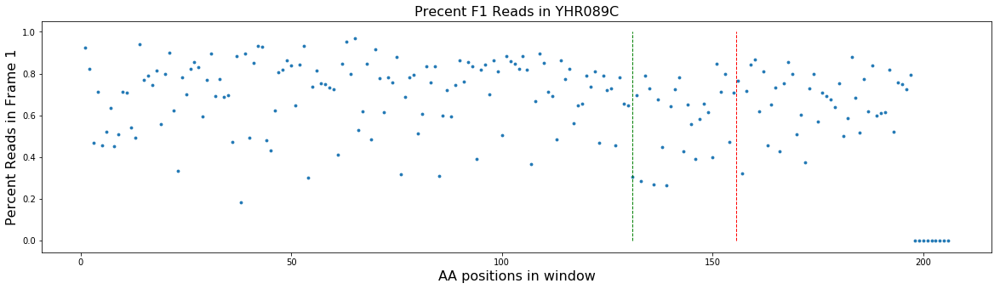

Simulated Percent: 0.6
174 280


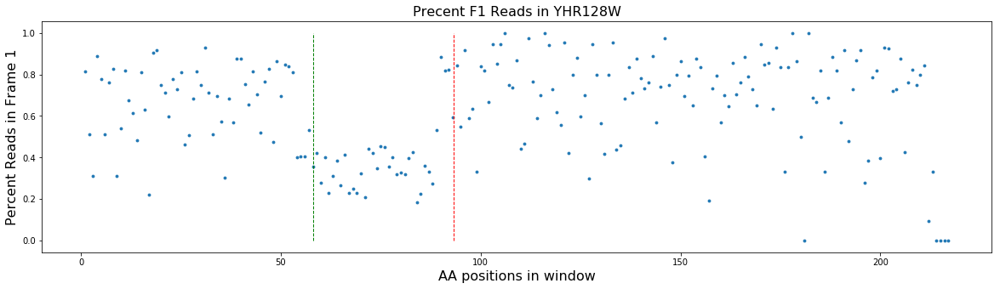

Simulated Percent: 0.5
273 460


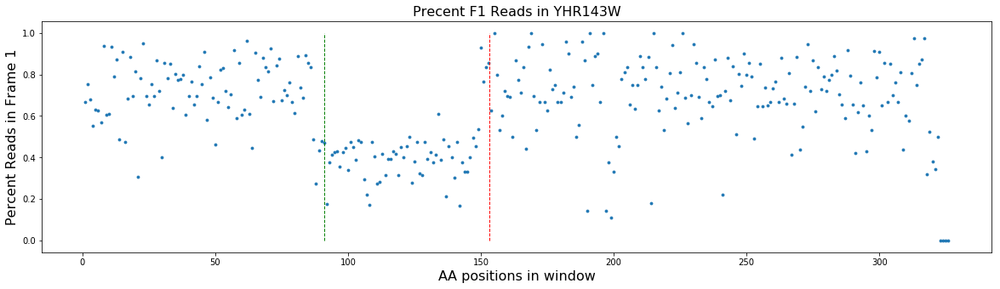

Simulated Percent: 0.1
105 169


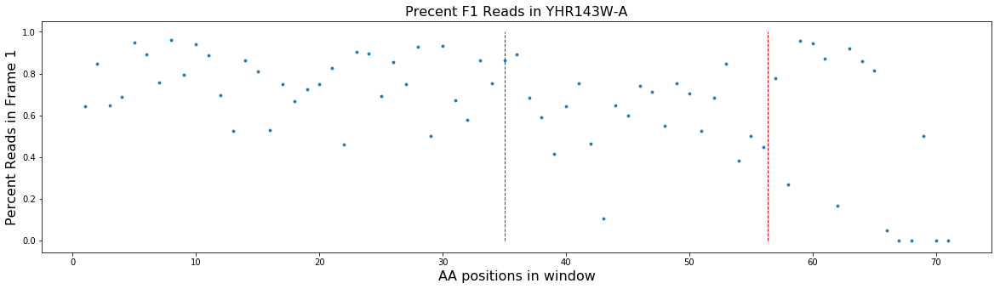

Simulated Percent: 0.9
183 251


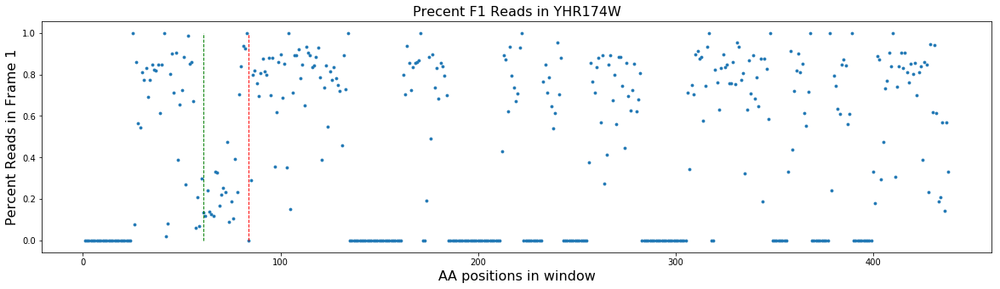

Simulated Percent: 0.1
723 773


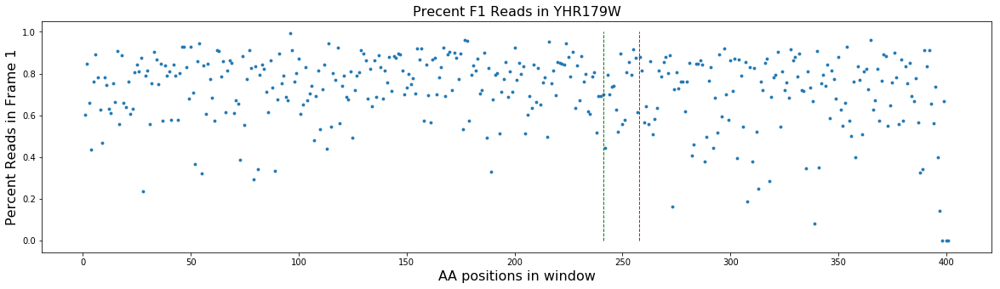

Simulated Percent: 0.4
174 232


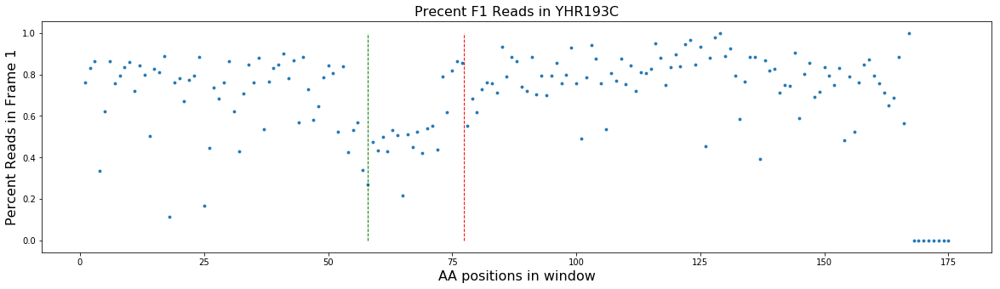

Simulated Percent: 0.4
654 767


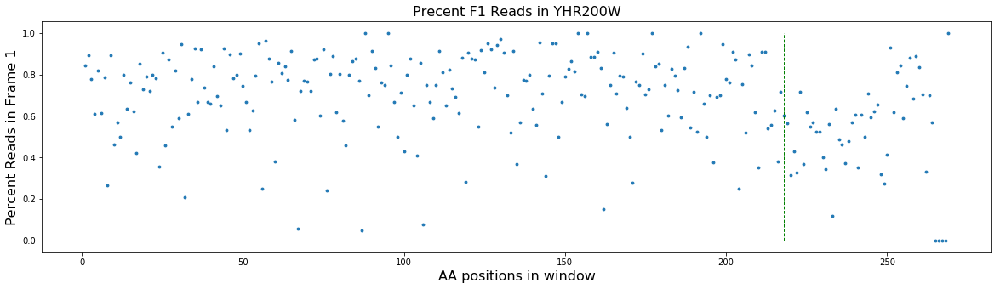

Simulated Percent: 0.9
915 979


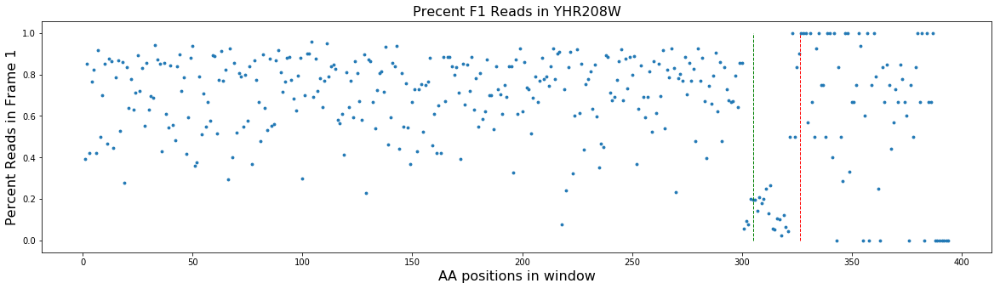

Simulated Percent: 0.1
117 178


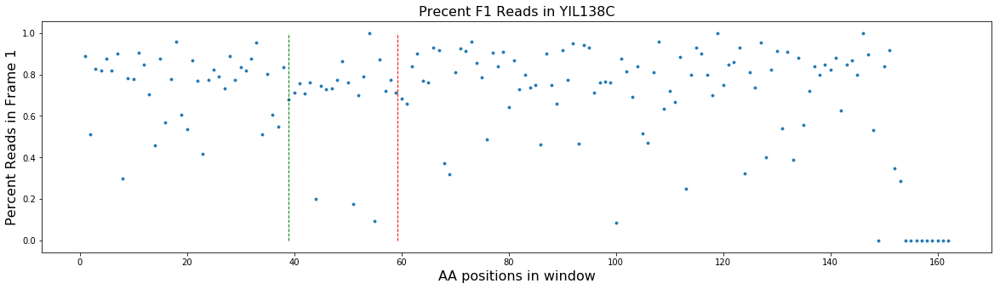

Simulated Percent: 0.4
1119 1207


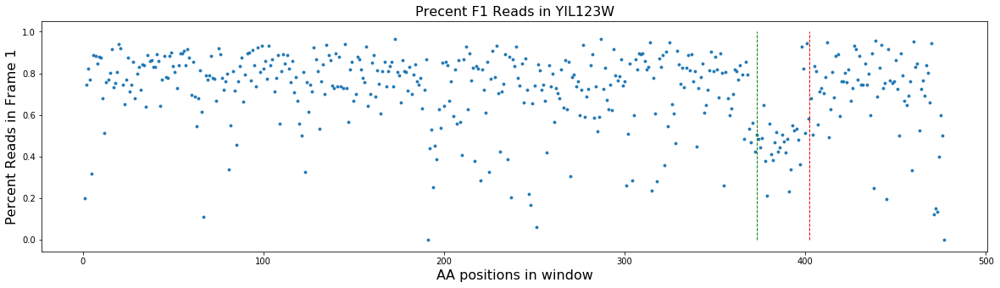

Simulated Percent: 0.05
687 772


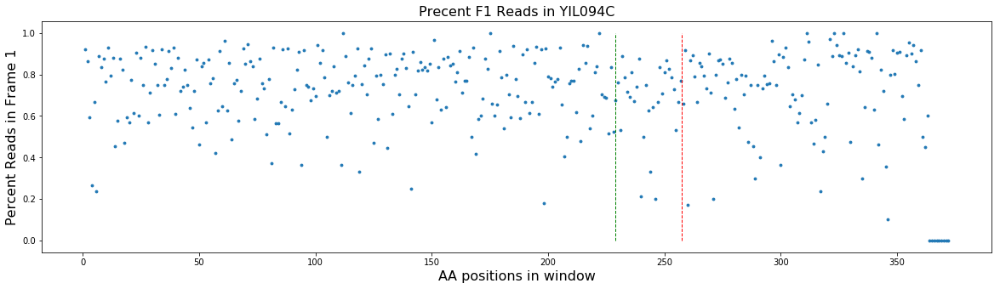

Simulated Percent: 0.4
165 215


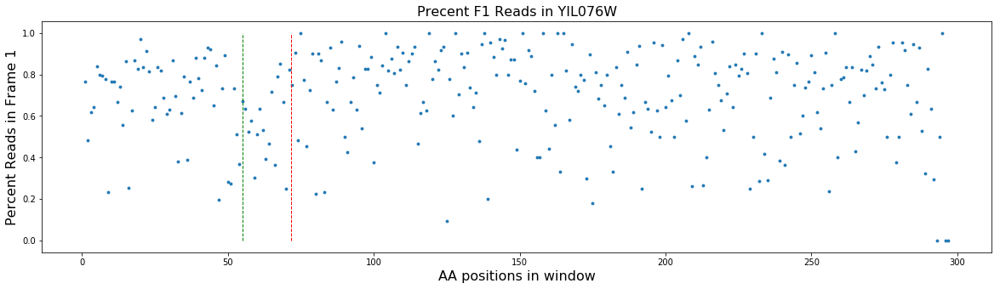

Simulated Percent: 0.1
303 397


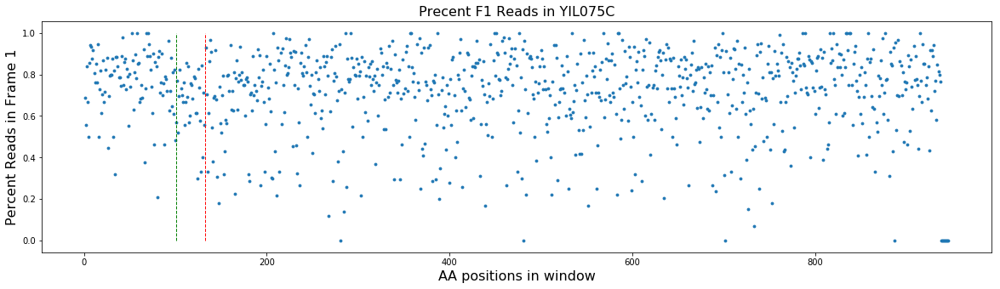

Simulated Percent: 0.6
183 253


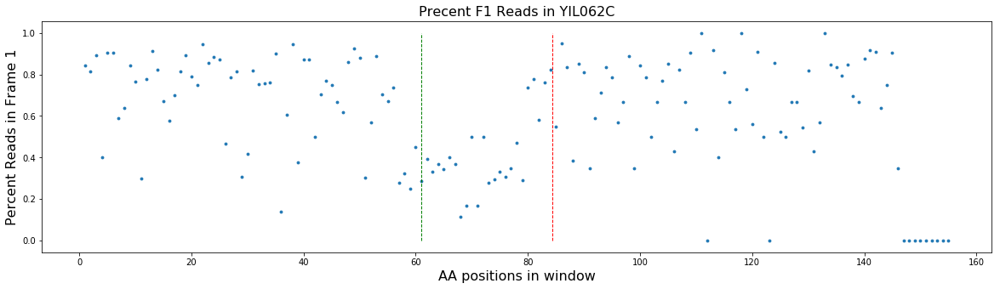

Simulated Percent: 0.7
126 238


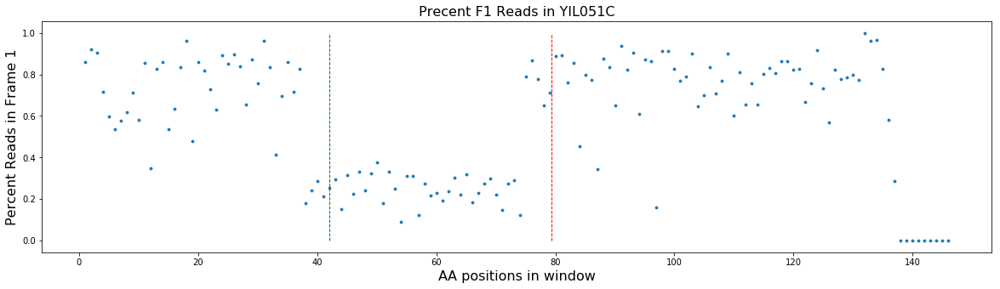

Simulated Percent: 0.9
861 917


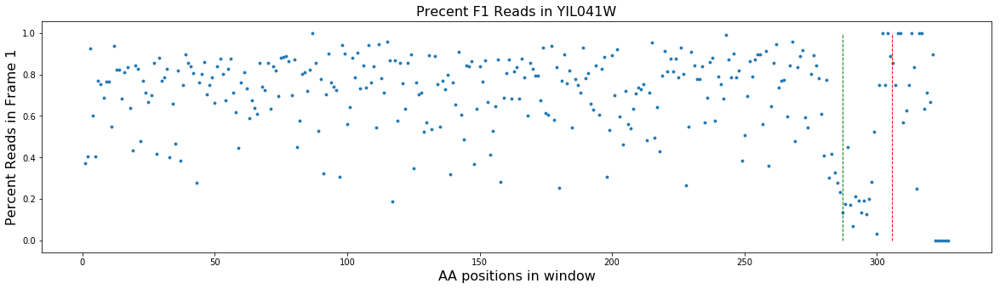

Simulated Percent: 0.4
114 185


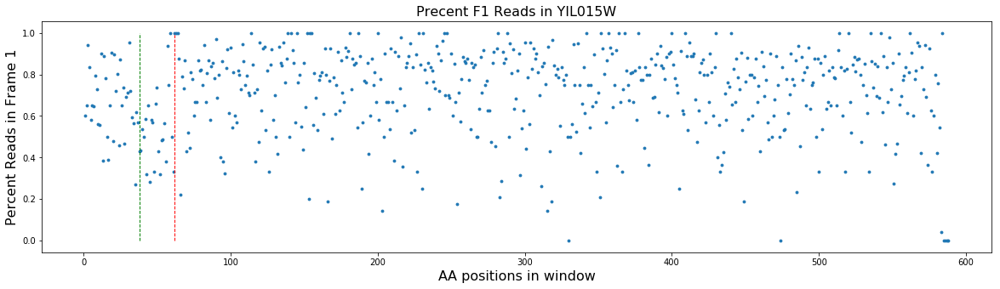

Simulated Percent: 0.8
159 221


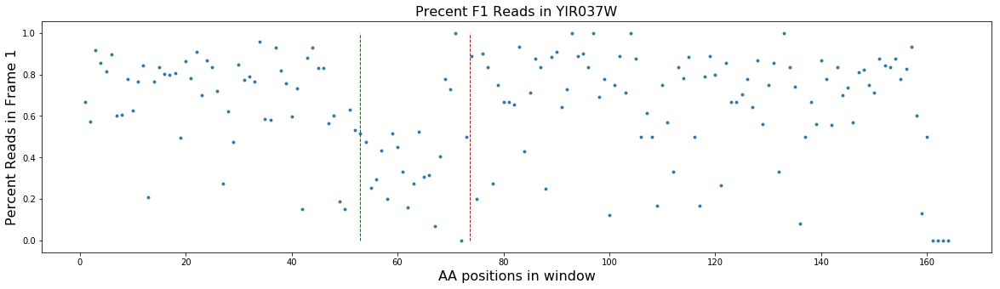

Simulated Percent: 0.5
249 310


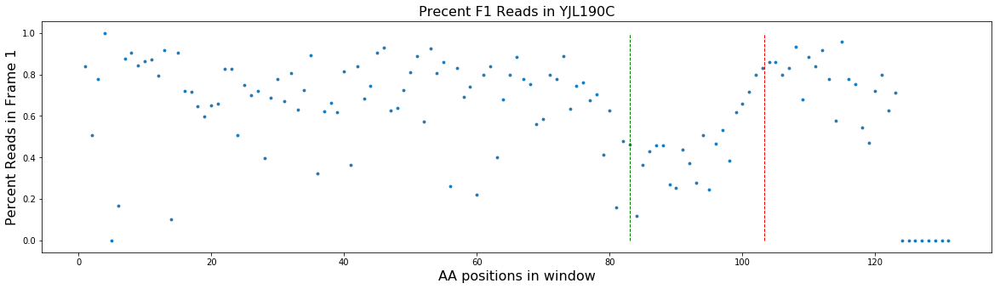

Simulated Percent: 0.6
429 598


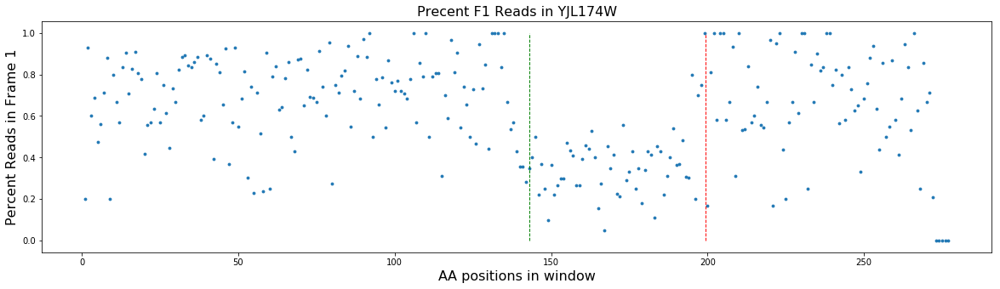

Simulated Percent: 0.4
855 913


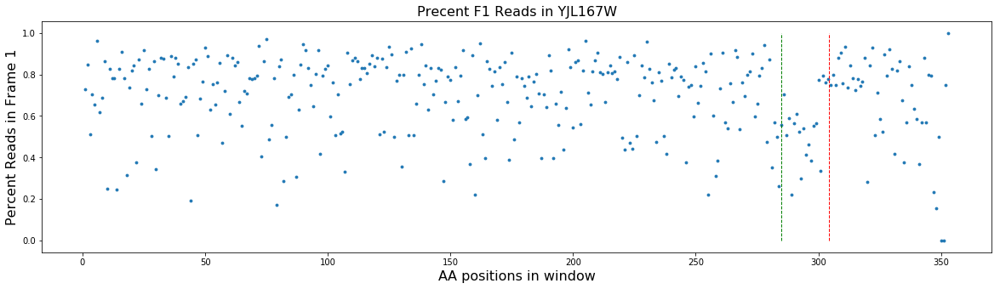

Simulated Percent: 0.3
120 178


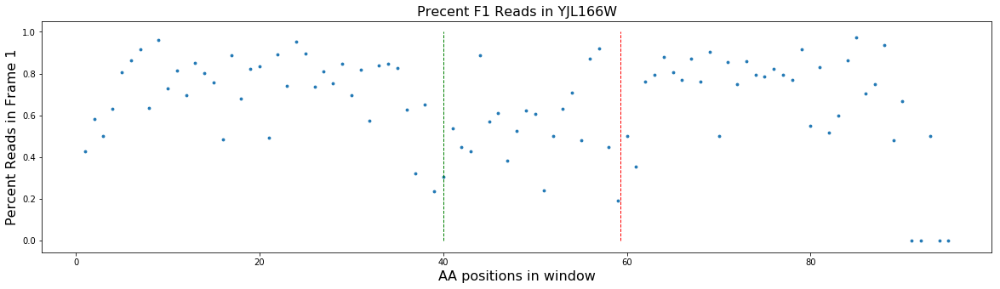

Simulated Percent: 0.05
117 203


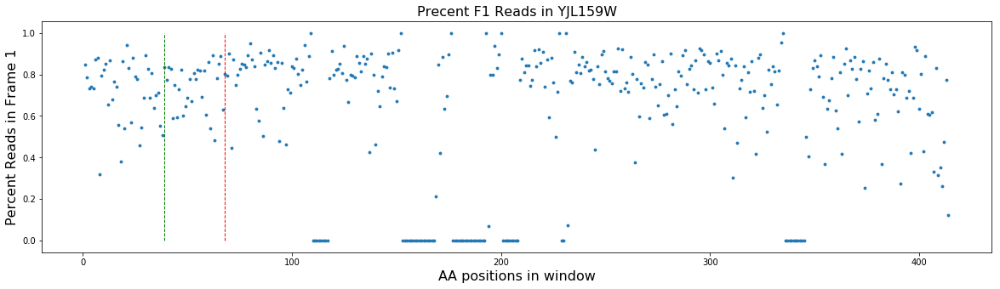

Simulated Percent: 0.05
87 185


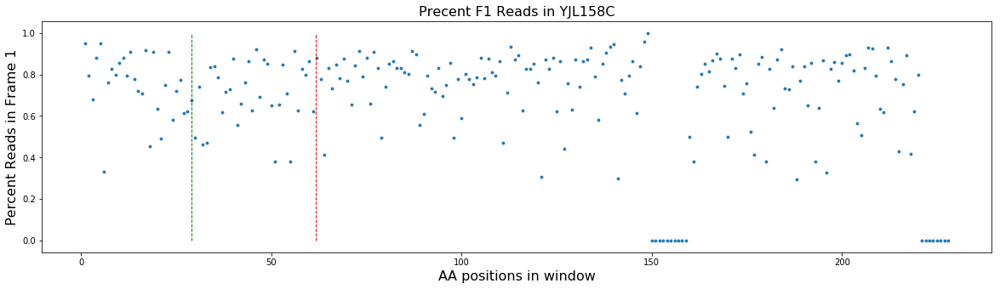

Simulated Percent: 0.3
924 982


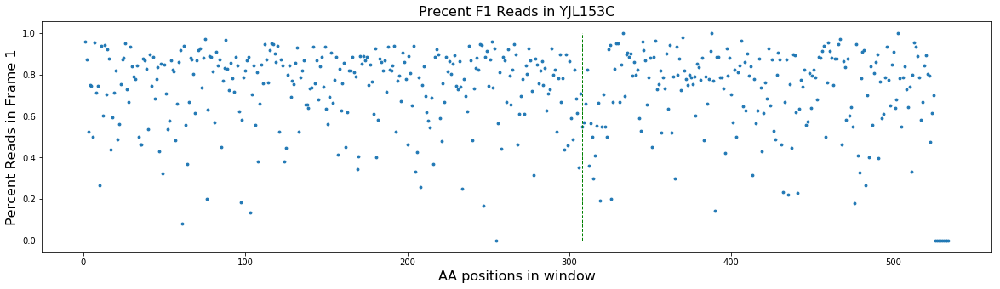

Simulated Percent: 0.3
93 172


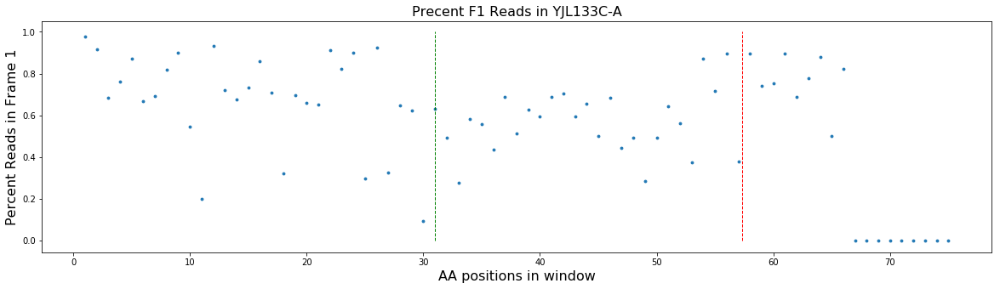

Simulated Percent: 0.7
2433 2515


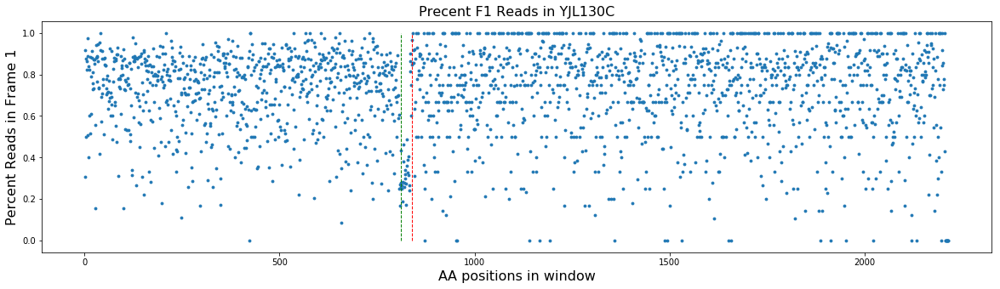

Simulated Percent: 0.1
294 355


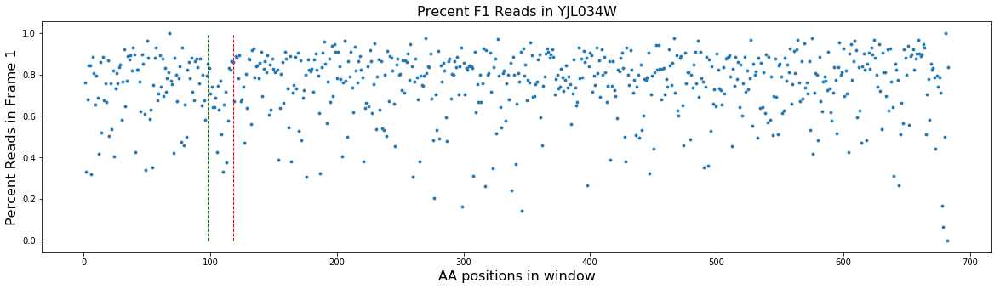

Simulated Percent: 0.2
657 755


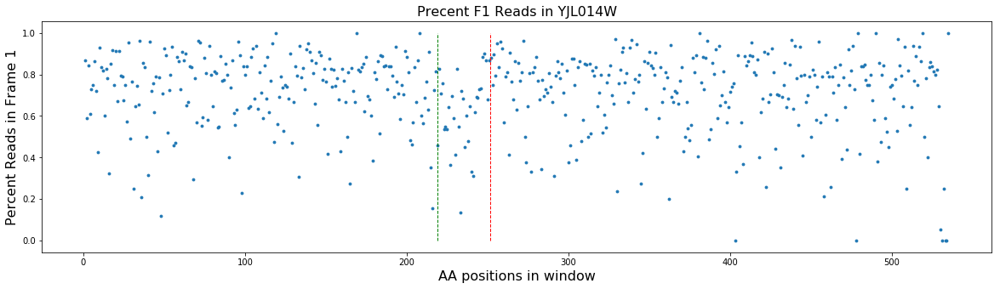

Simulated Percent: 0.1
828 887


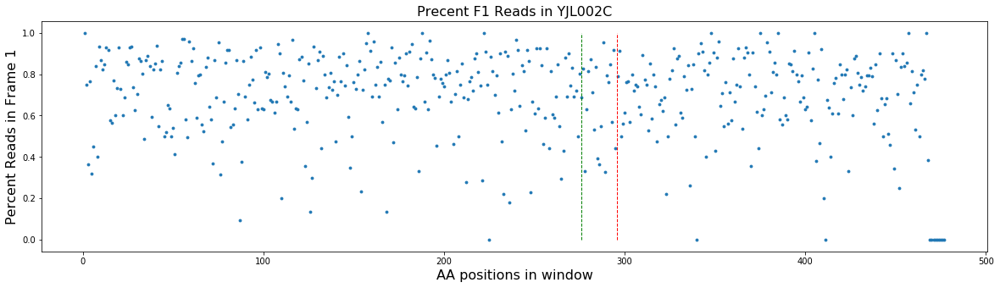

Simulated Percent: 0.05
213 334


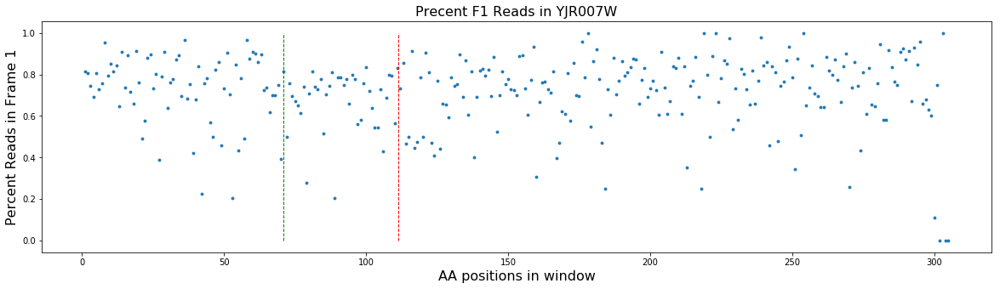

Simulated Percent: 0.3
108 163


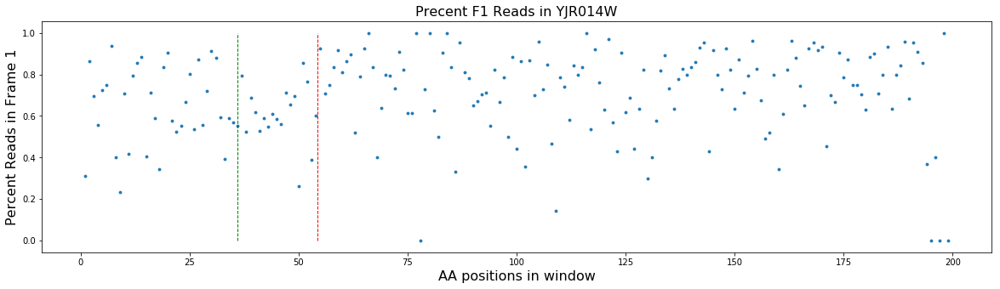

Simulated Percent: 0.5
141 199


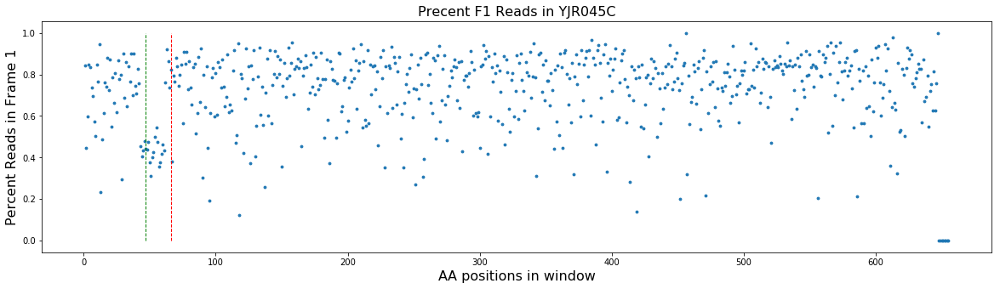

Simulated Percent: 0.6
90 220


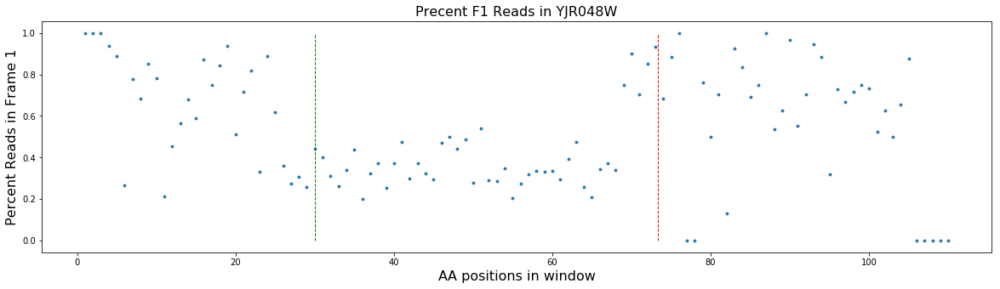

Simulated Percent: 0.3
1308 1364


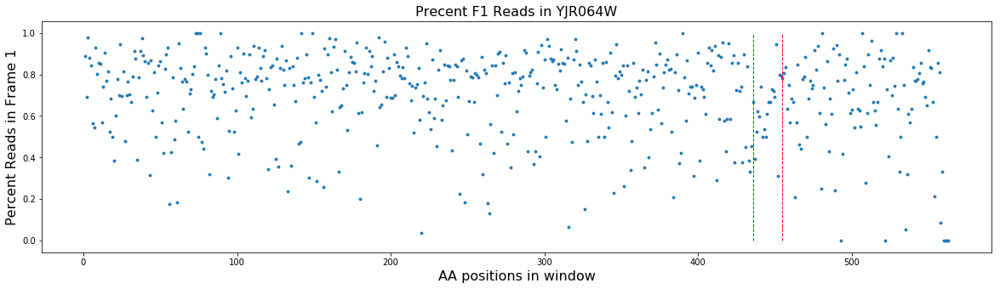

Simulated Percent: 0.05
579 646


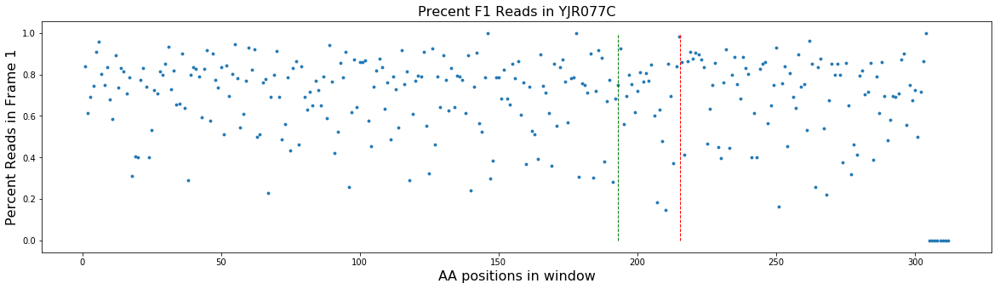

Simulated Percent: 0.4
147 208


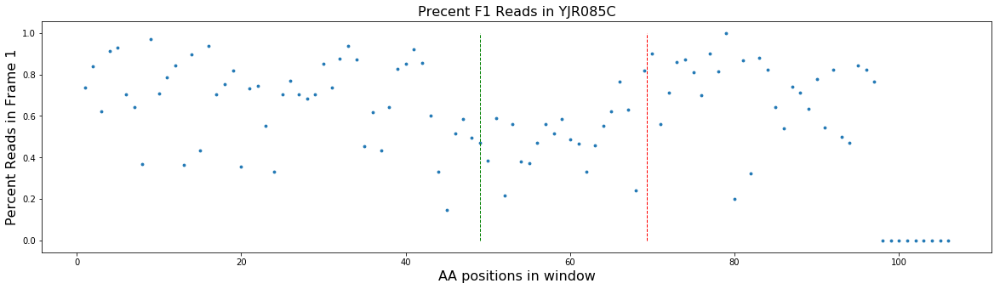

Simulated Percent: 0.05
183 262


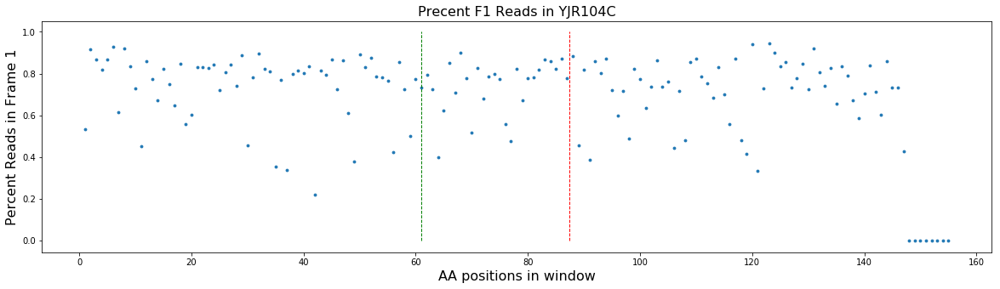

Simulated Percent: 0.1
147 370


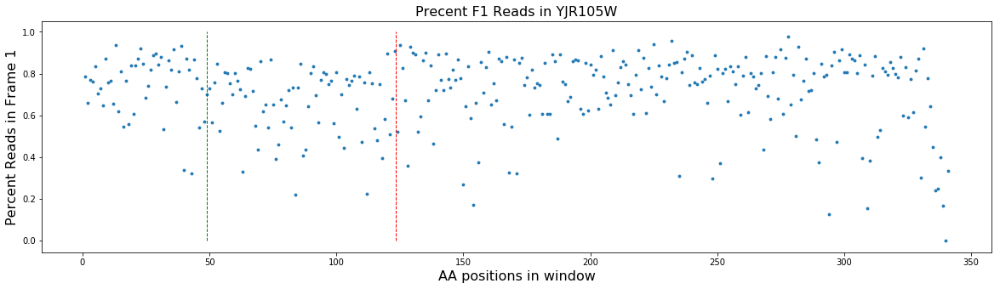

Simulated Percent: 0.7
873 931


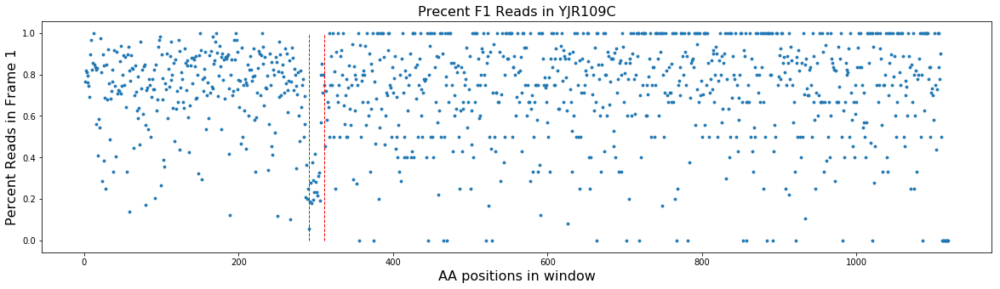

Simulated Percent: 0.1
906 959


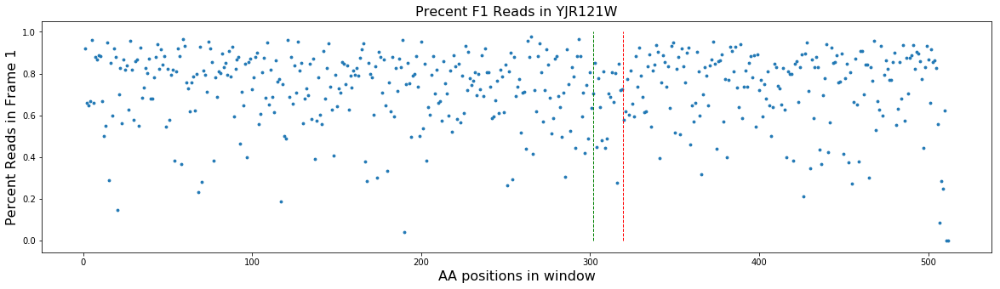

Simulated Percent: 0.6
78 277


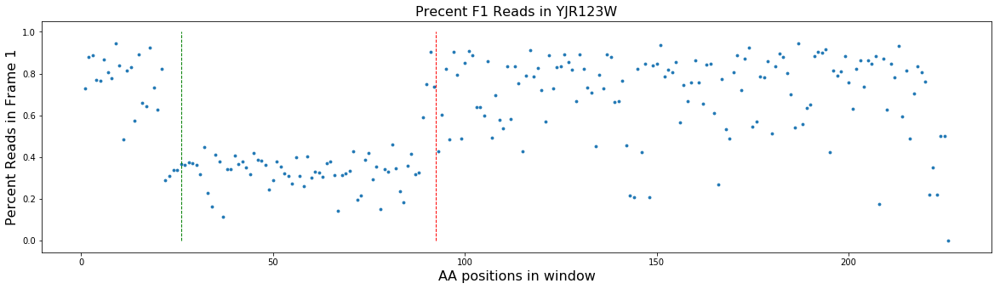

Simulated Percent: 0.6
87 169


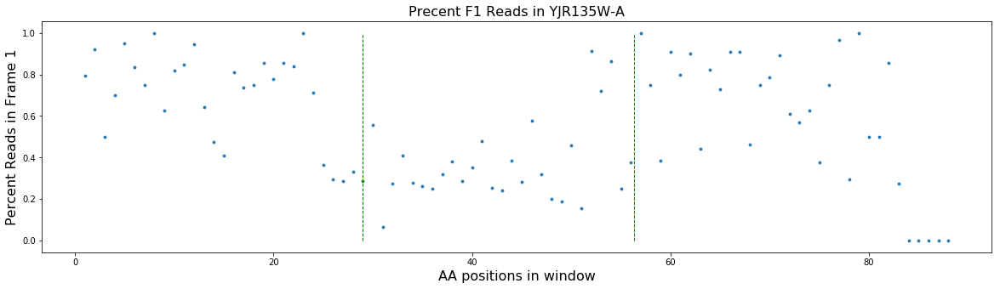

Simulated Percent: 0.6
474 643


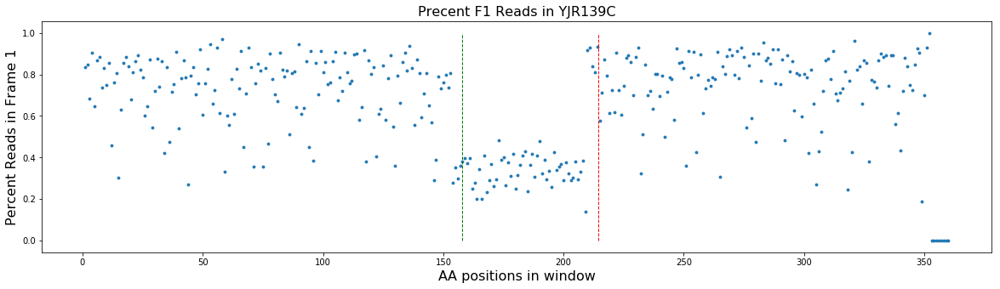

Simulated Percent: 0.5
405 476


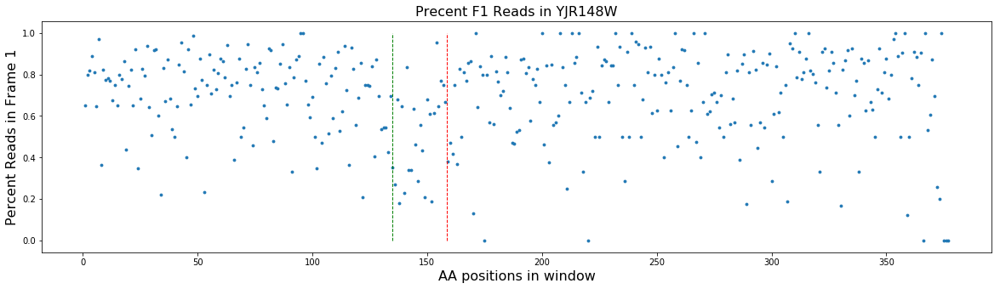

Simulated Percent: 0.05
465 550


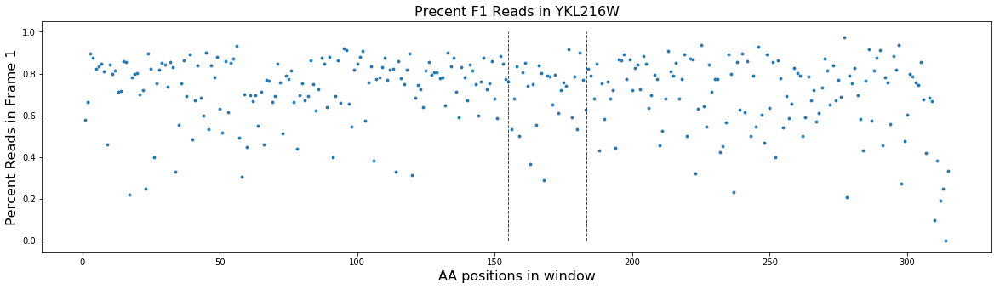

Simulated Percent: 0.4
648 805


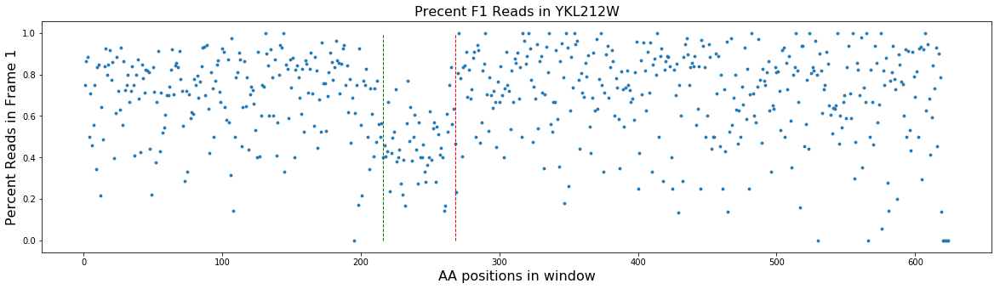

Simulated Percent: 0.2
1263 1348


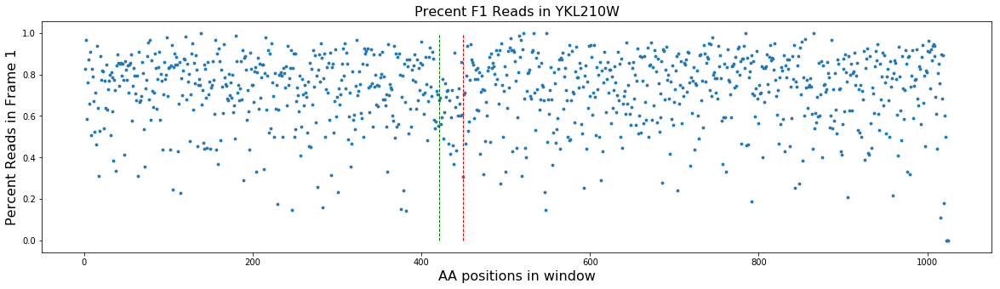

Simulated Percent: 0.4
123 175


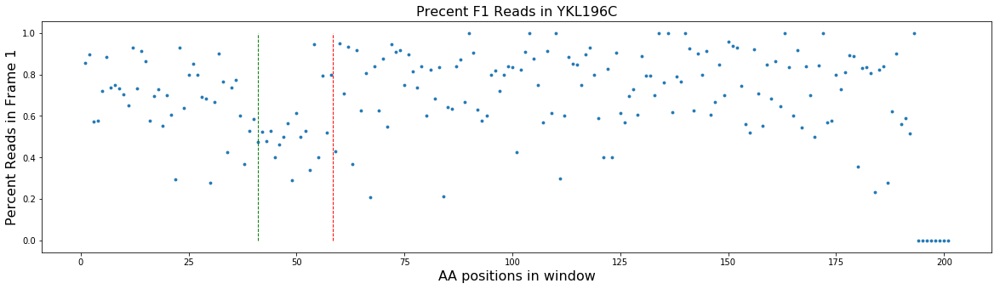

Simulated Percent: 0.1
120 268


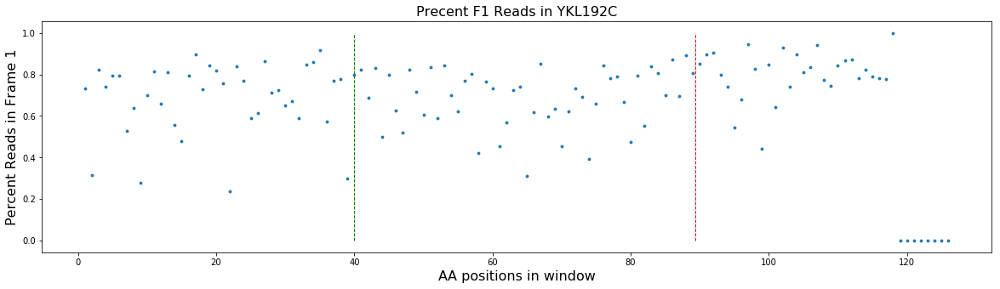

Simulated Percent: 0.4
3435 3613


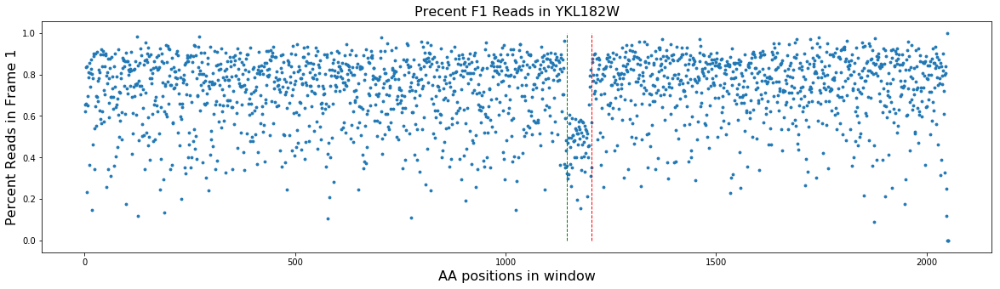

Simulated Percent: 0.9
306 362


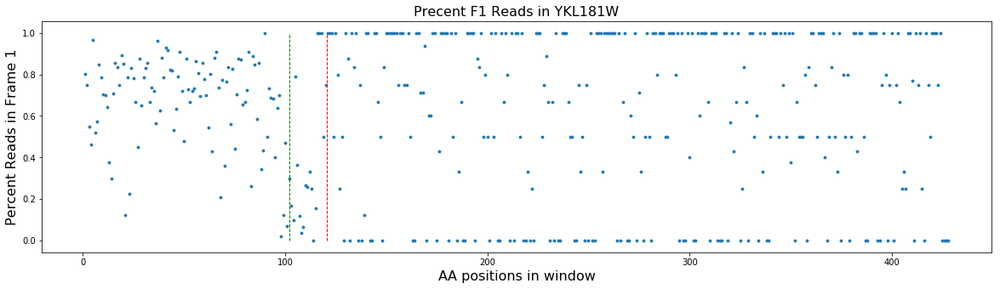

Simulated Percent: 0.6
615 665


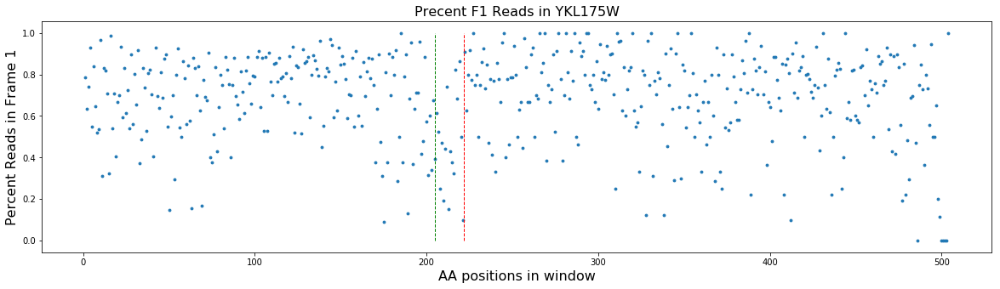

Simulated Percent: 0.4
522 589


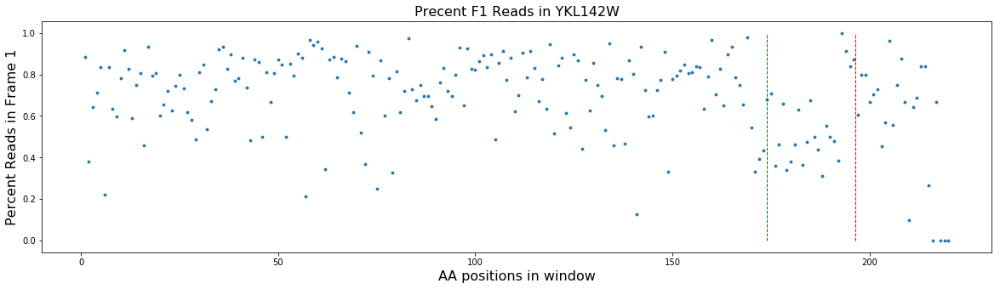

Simulated Percent: 0.8
528 586


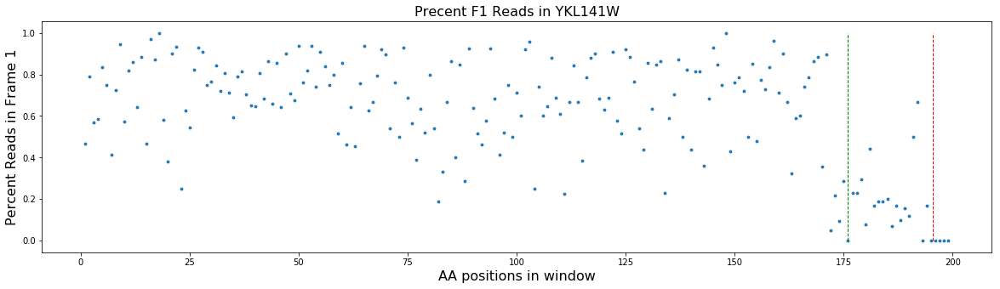

Simulated Percent: 0.05
1173 1280


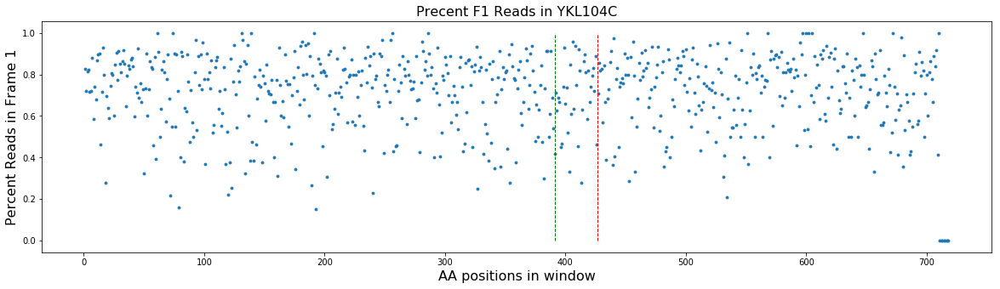

Simulated Percent: 0.2
93 161


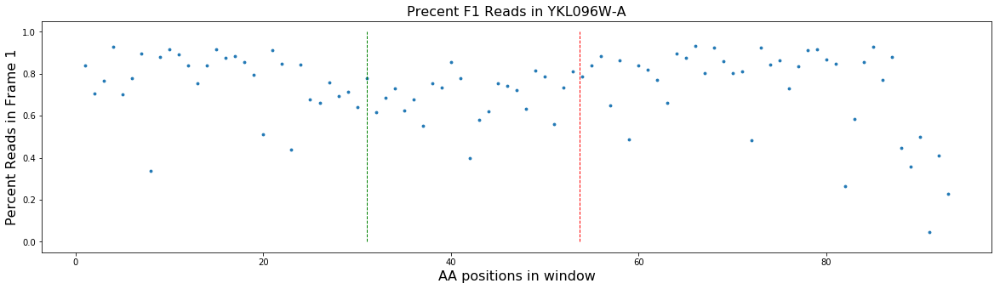

Simulated Percent: 0.2
66 128


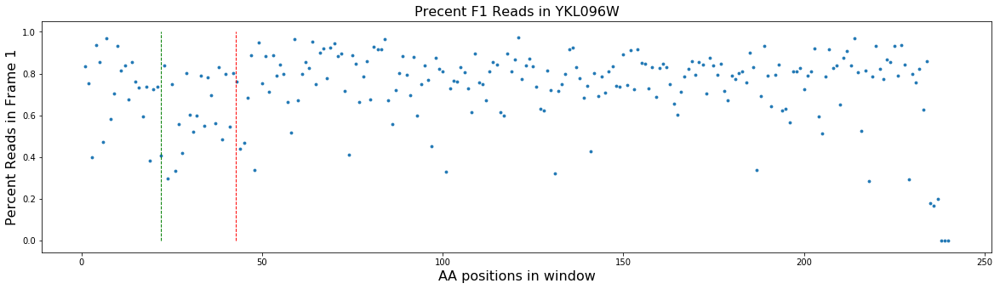

Simulated Percent: 0.6
60 116


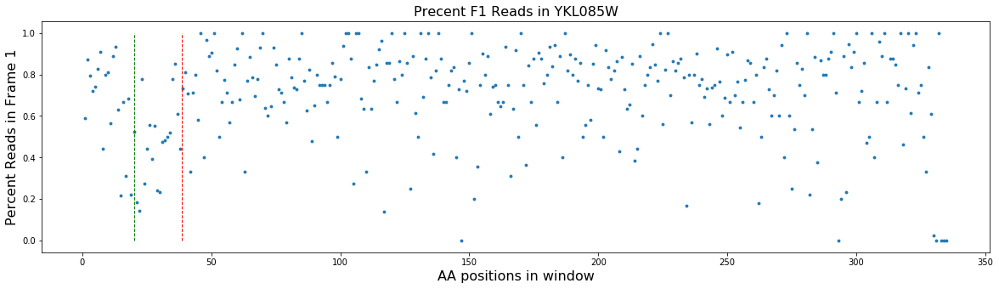

Simulated Percent: 0.4
357 418


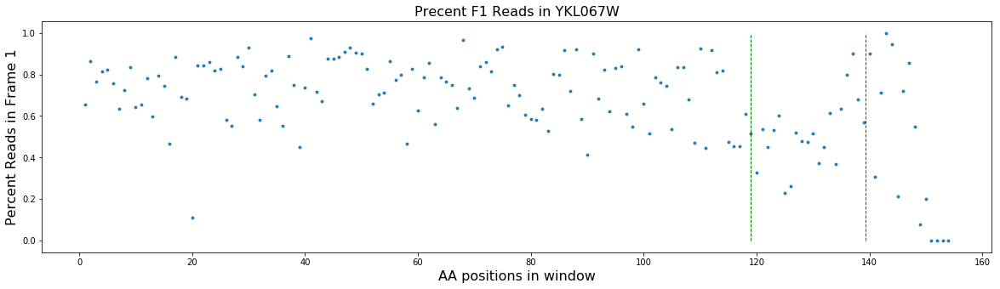

Simulated Percent: 0.4
732 836


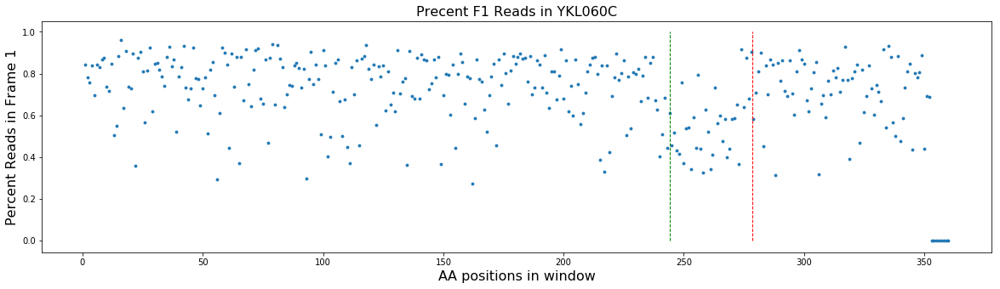

Simulated Percent: 0.3
291 430


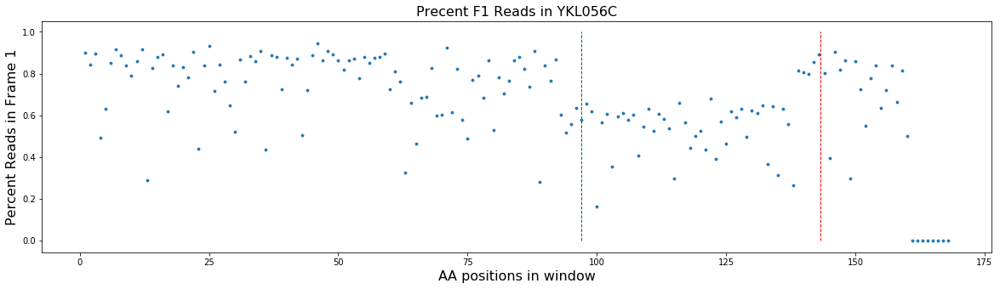

Simulated Percent: 0.4
219 502


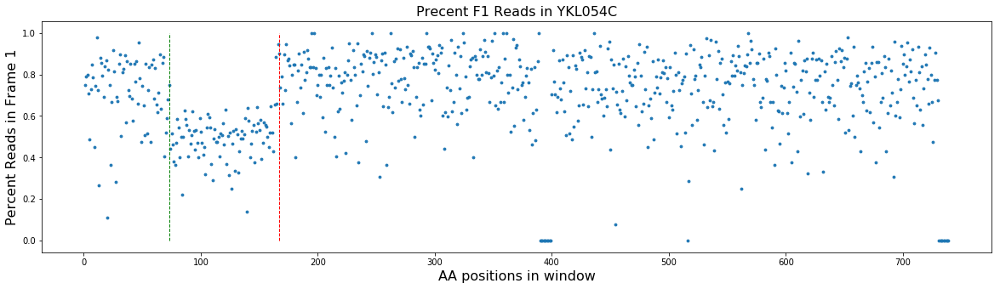

Simulated Percent: 0.7
126 176


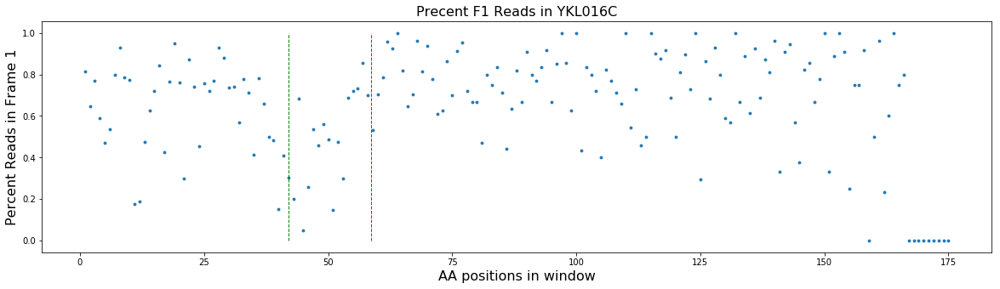

Simulated Percent: 0.5
75 187


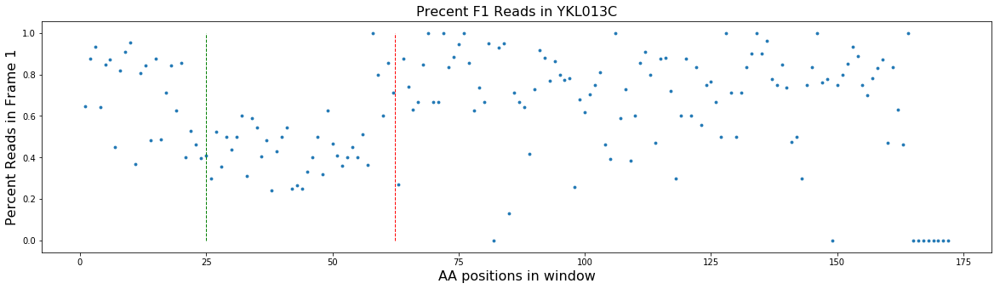

Simulated Percent: 0.6
573 632


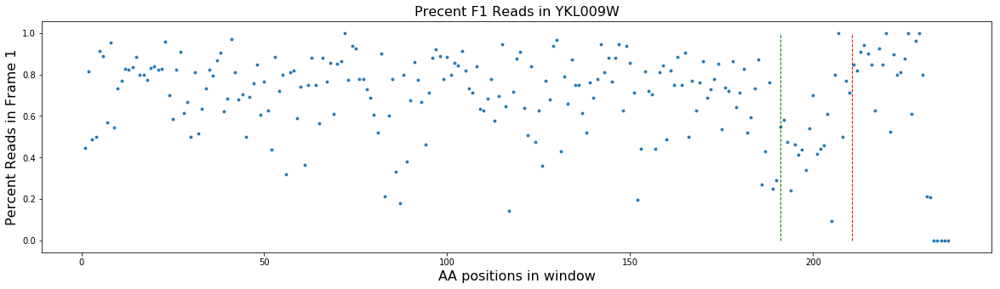

Simulated Percent: 0.1
306 367


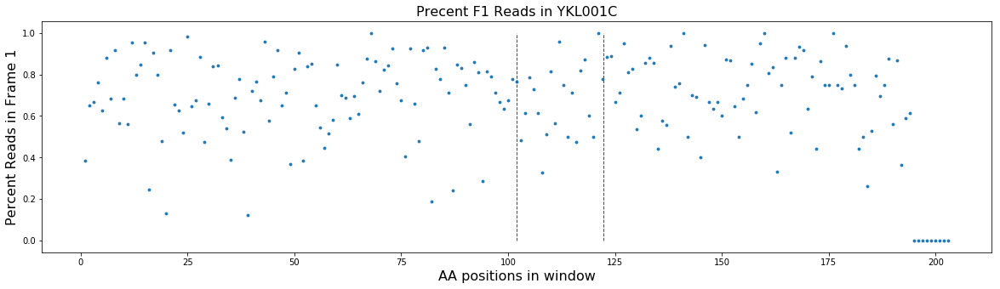

Simulated Percent: 0.2
516 587


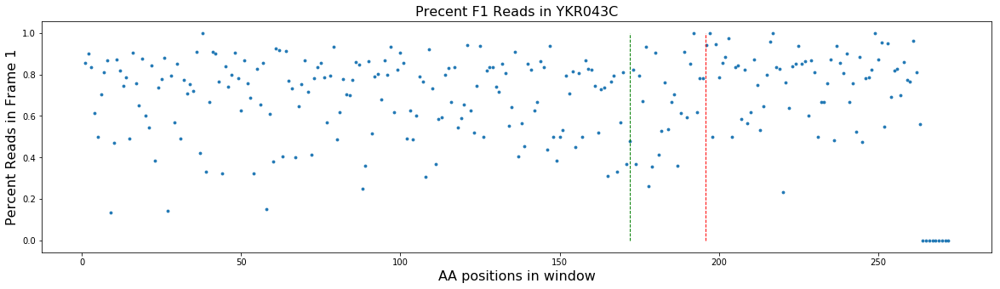

Simulated Percent: 0.7
1725 1801


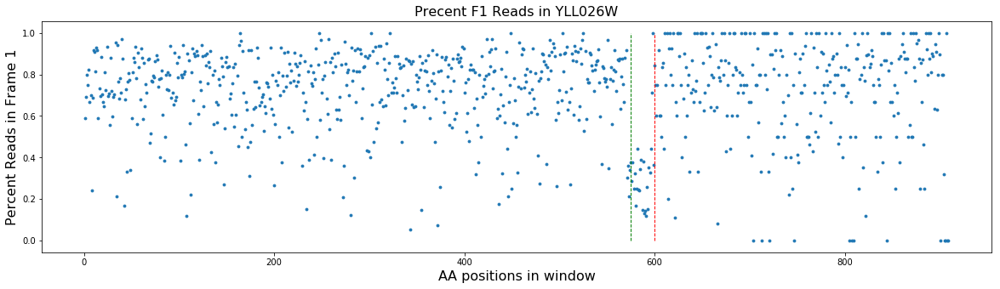

Simulated Percent: 0.9
978 1129


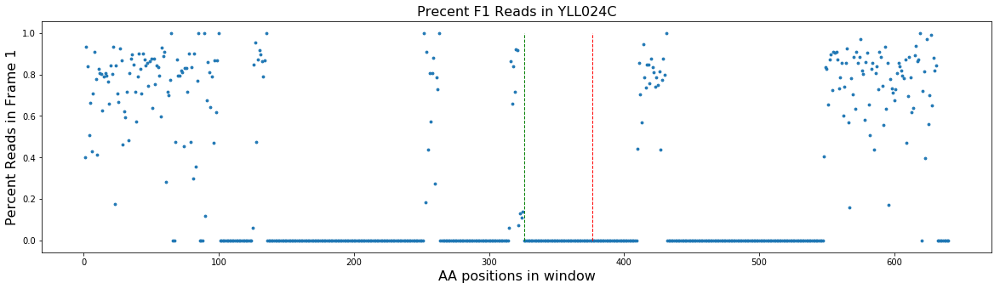

Simulated Percent: 0.4
1083 1198


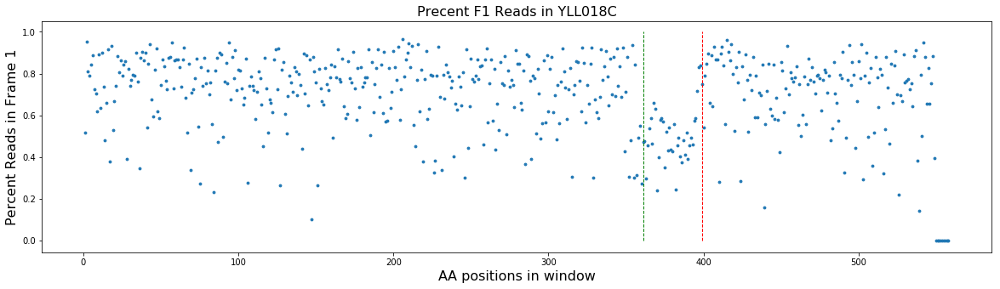

Simulated Percent: 0.5
849 946


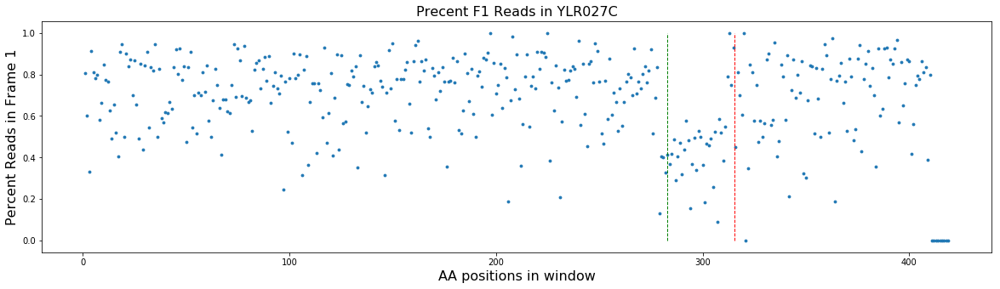

Simulated Percent: 0.5
378 490


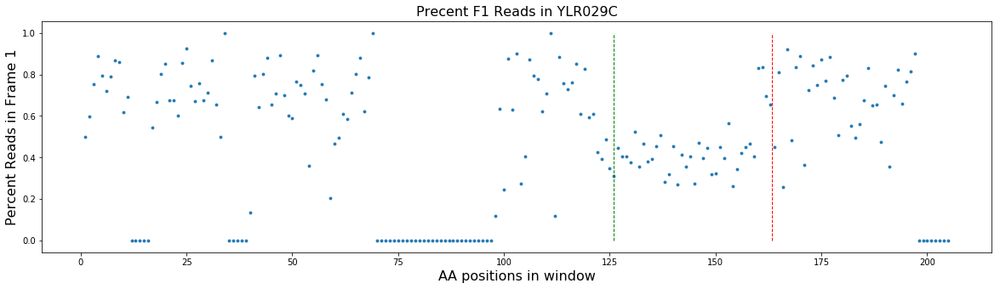

Simulated Percent: 0.5
120 181


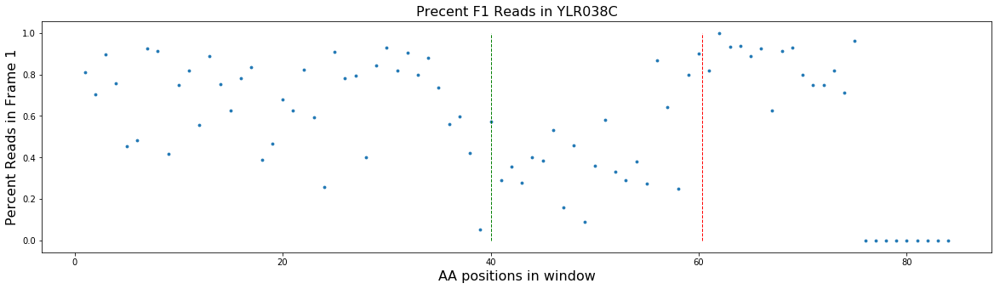

Simulated Percent: 0.9
48 98


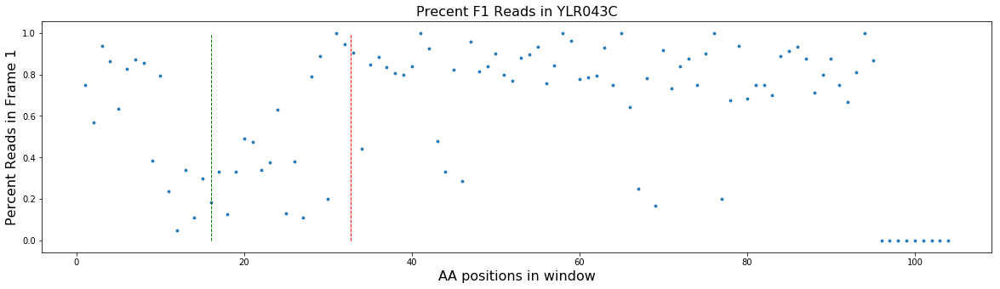

Simulated Percent: 0.1
540 592


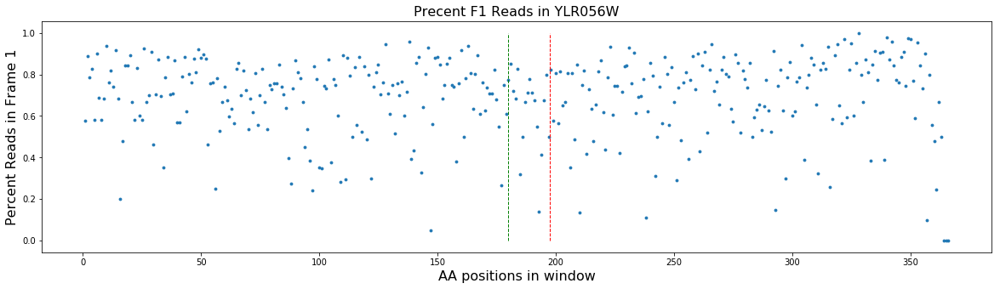

Simulated Percent: 0.4
171 236


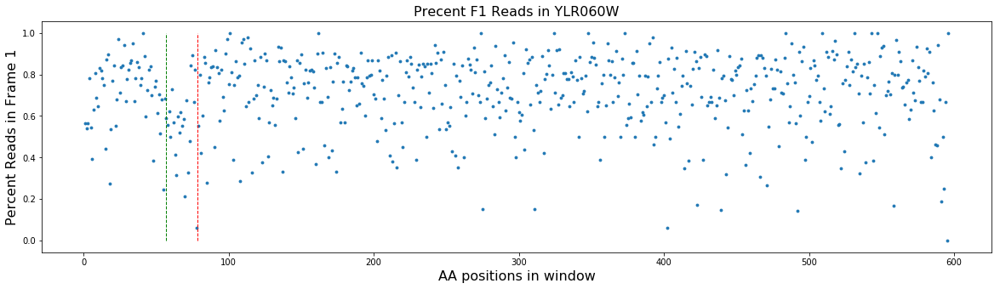

Simulated Percent: 0.05
174 229


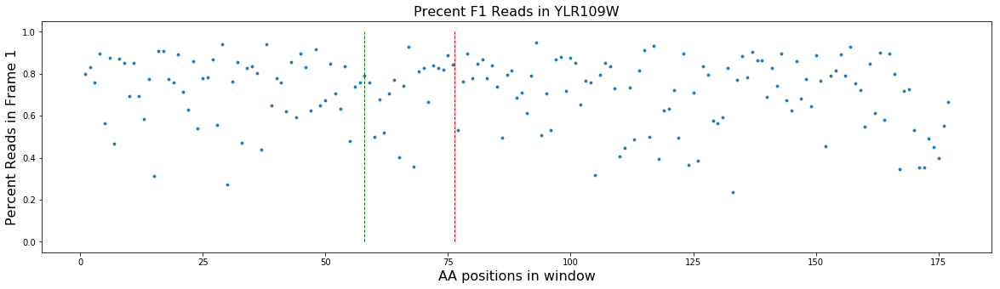

Simulated Percent: 0.05
81 220


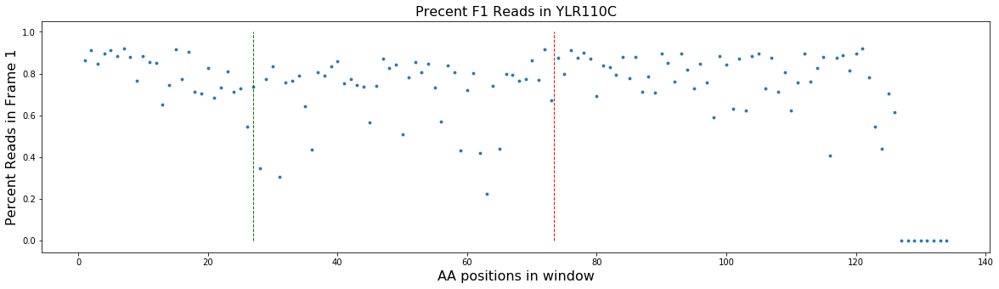

Simulated Percent: 0.3
183 349


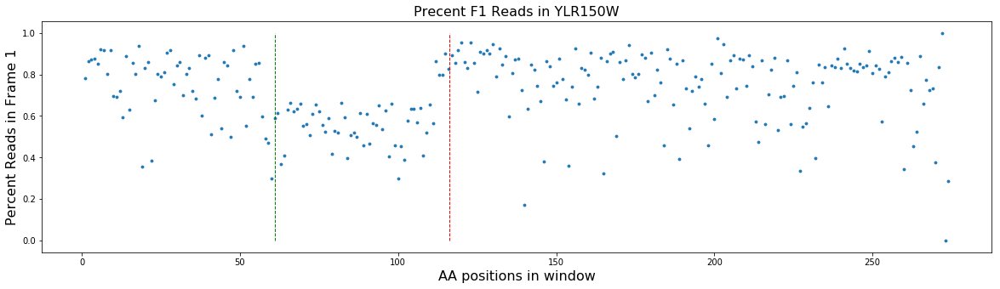

Simulated Percent: 0.7
1356 1411


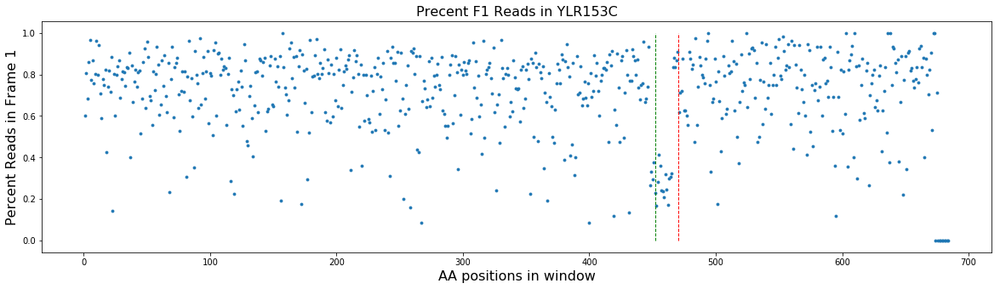

Simulated Percent: 0.4
291 349


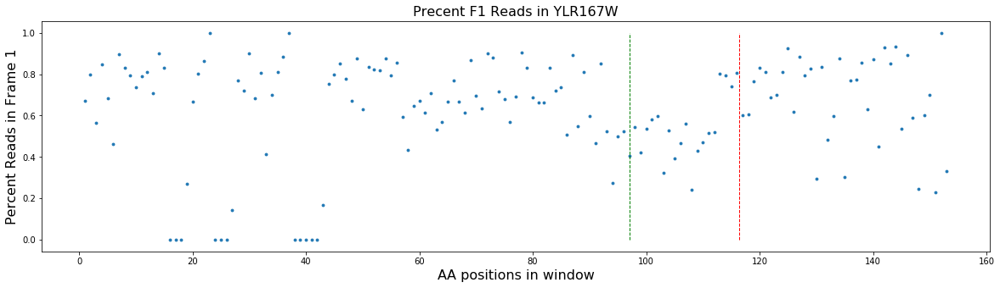

Simulated Percent: 0.4
240 296


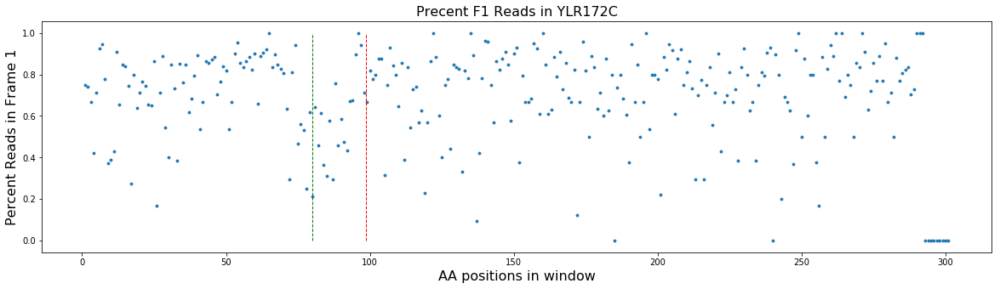

Simulated Percent: 0.2
108 226


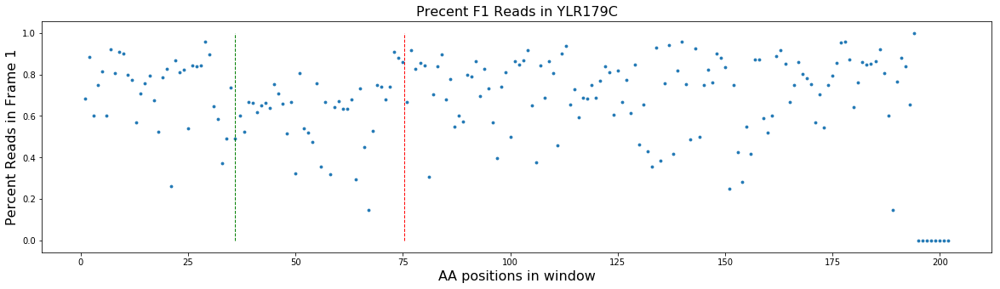

Simulated Percent: 0.3
1065 1138


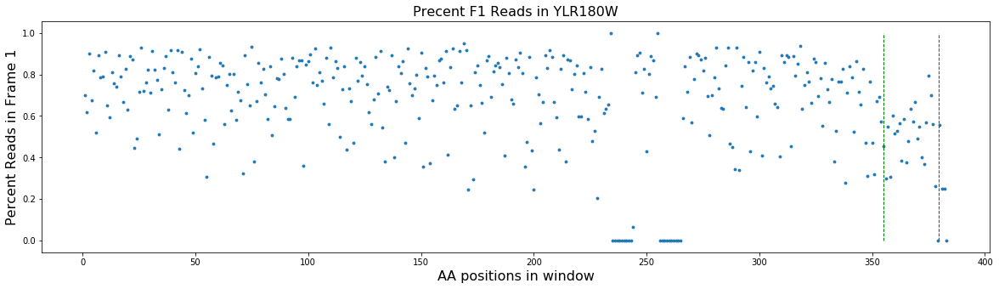

Simulated Percent: 0.3
132 250


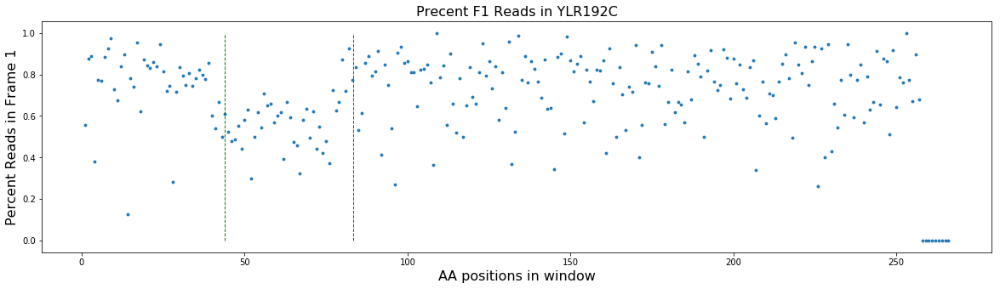

Simulated Percent: 0.3
636 742


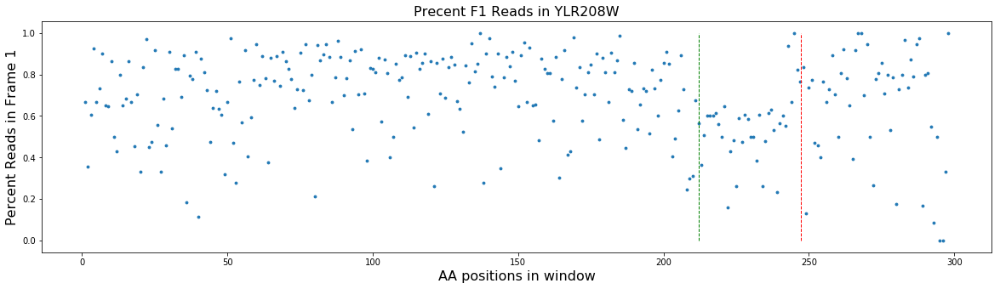

Simulated Percent: 0.05
510 628


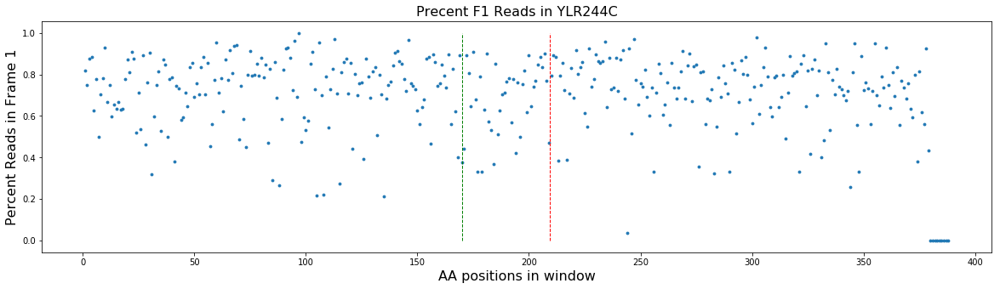

Simulated Percent: 0.05
1347 1403


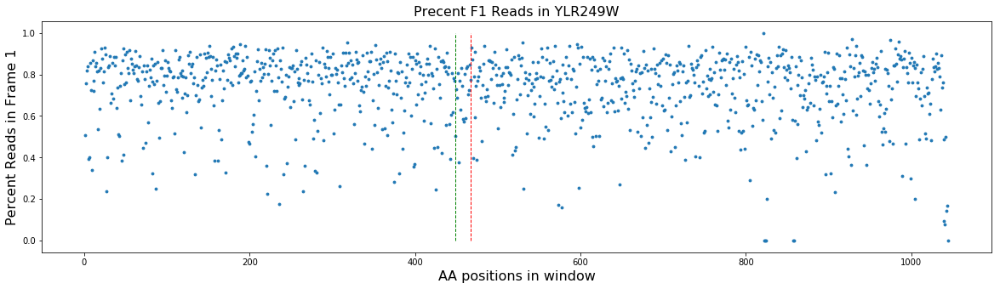

Simulated Percent: 0.6
708 761


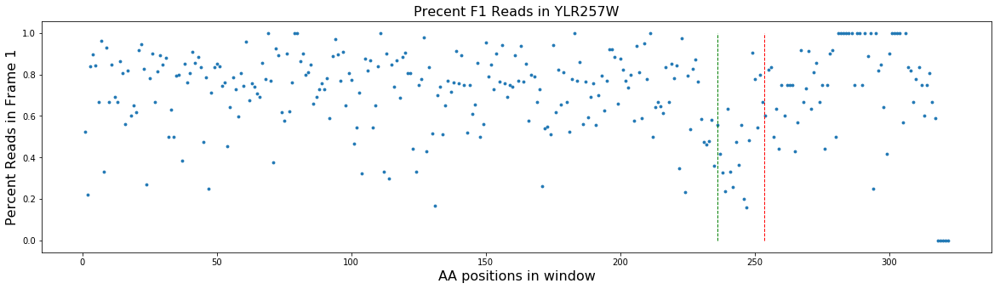

Simulated Percent: 0.05
1353 1430


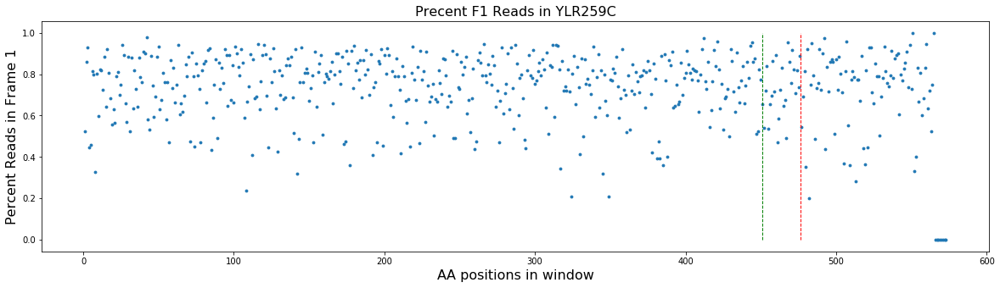

Simulated Percent: 0.3
75 127


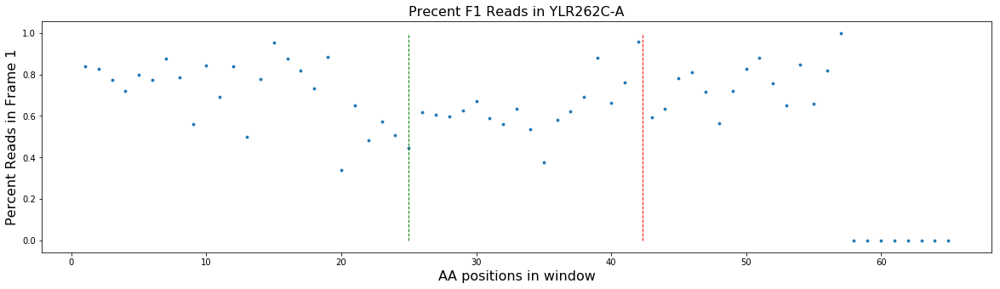

Simulated Percent: 0.3
66 166


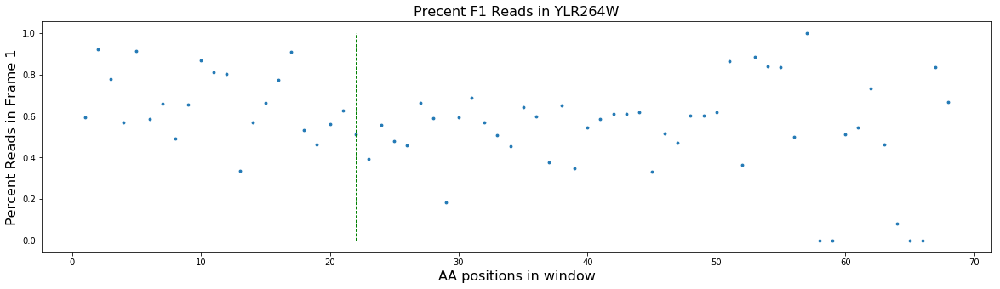

Simulated Percent: 0.2
114 289


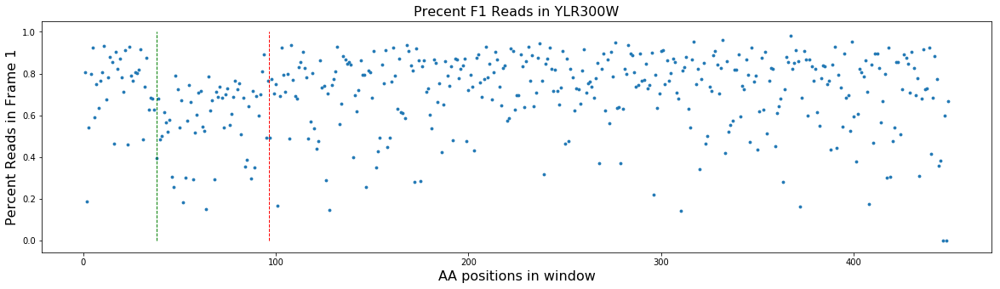

Simulated Percent: 0.4
645 719


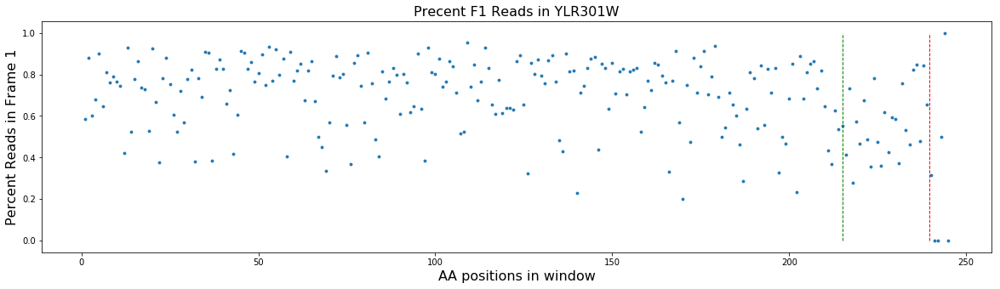

Simulated Percent: 0.1
1218 1288


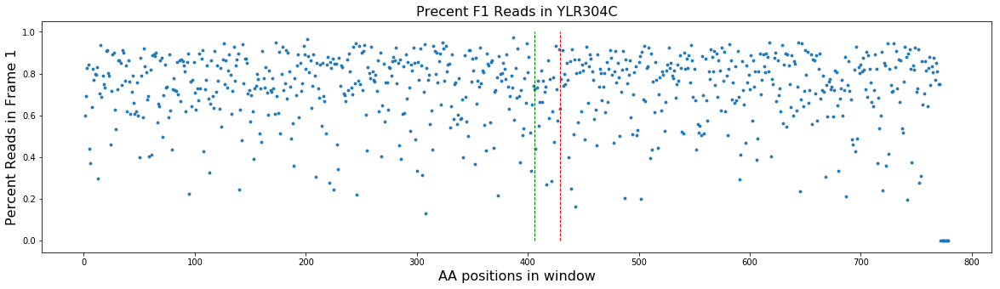

Simulated Percent: 0.2
102 193


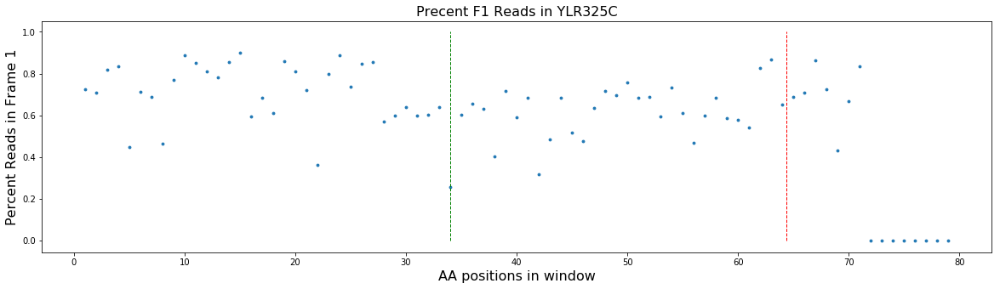

Simulated Percent: 0.1
66 197


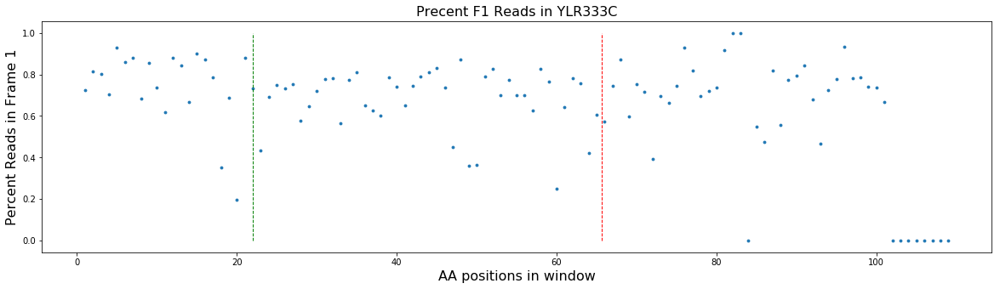

Simulated Percent: 0.7
408 502


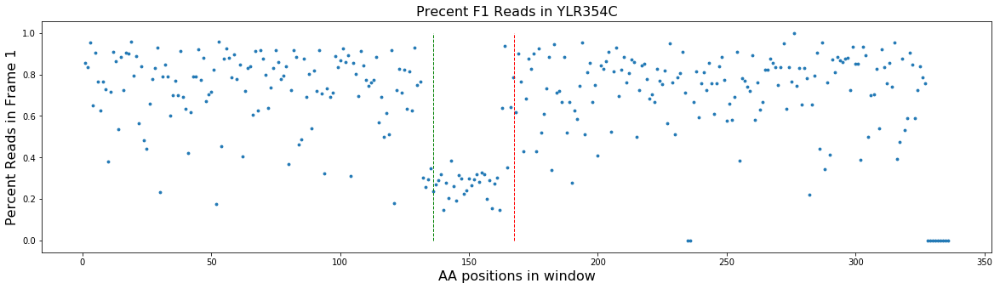

Simulated Percent: 0.3
48 124


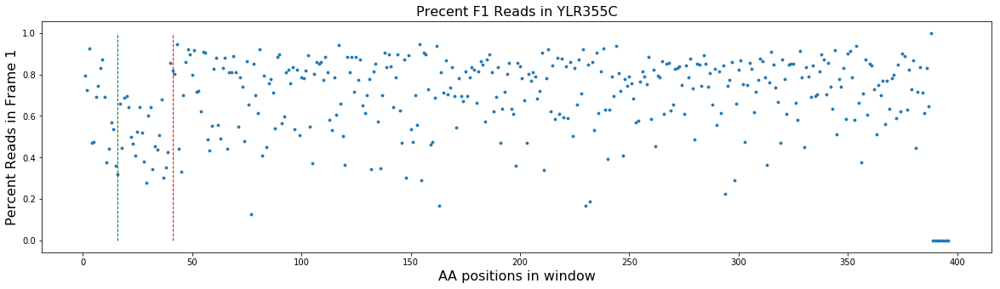

Simulated Percent: 0.2
432 497


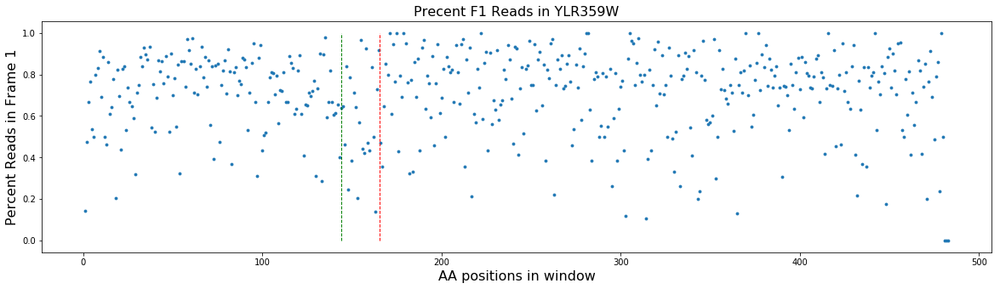

Simulated Percent: 0.2
447 520


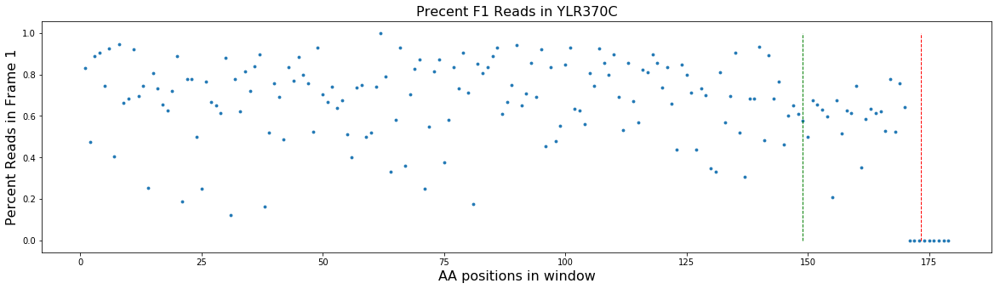

Simulated Percent: 0.4
54 140


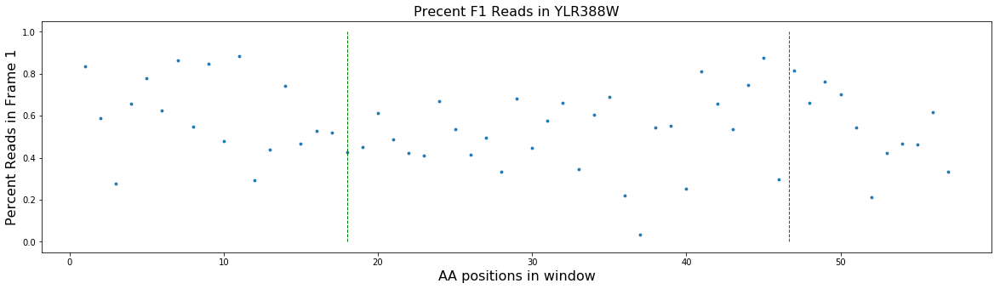

Simulated Percent: 0.8
102 214


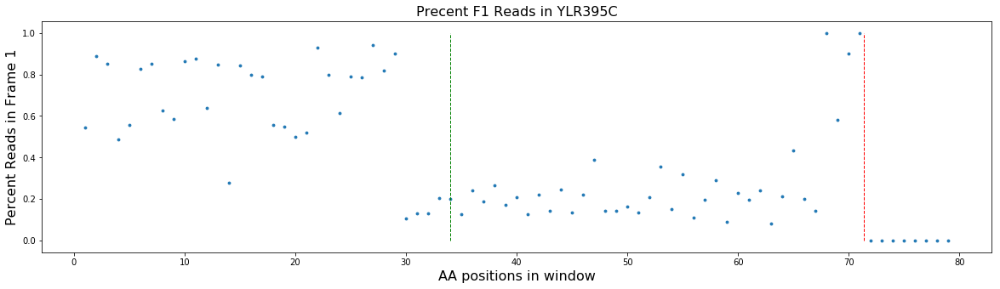

Simulated Percent: 0.7
84 151


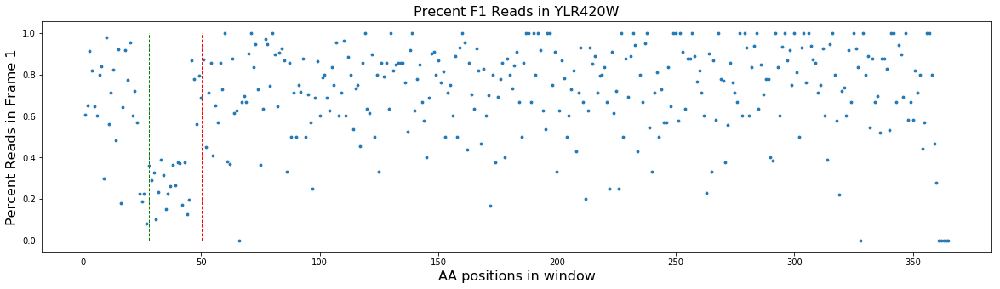

Simulated Percent: 0.4
267 320


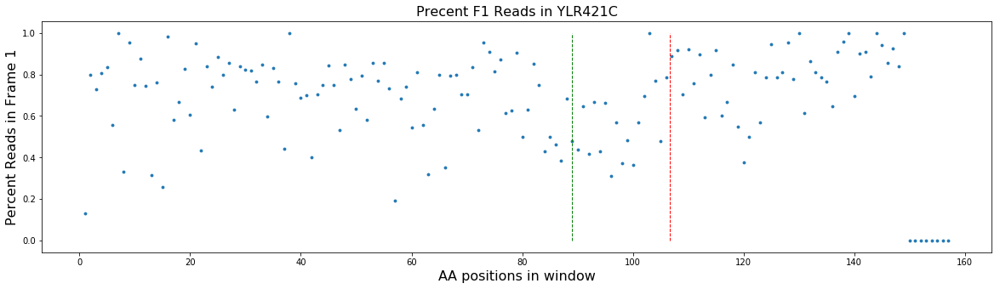

Simulated Percent: 0.8
1380 1450


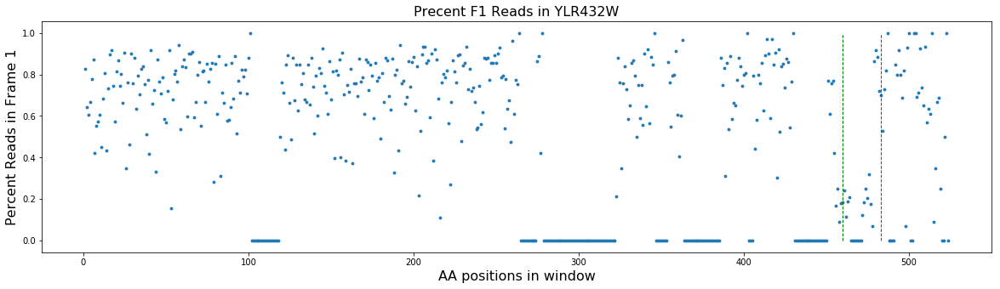

Simulated Percent: 0.3
60 139


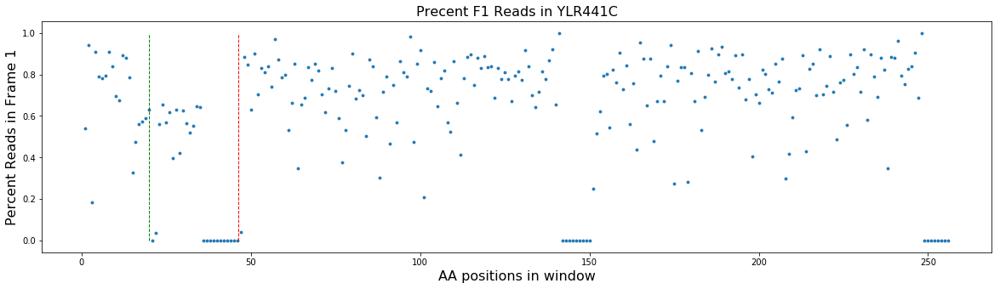

Simulated Percent: 0.6
48 122


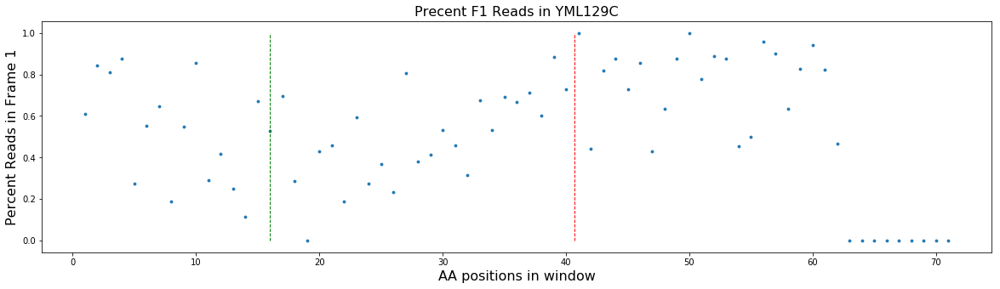

Simulated Percent: 0.05
507 571


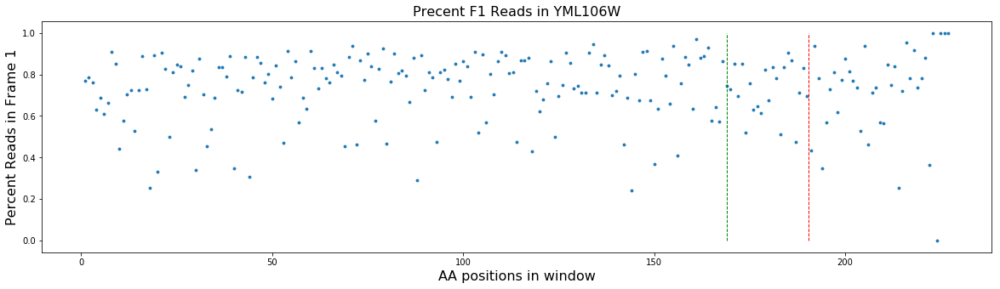

Simulated Percent: 0.1
264 448


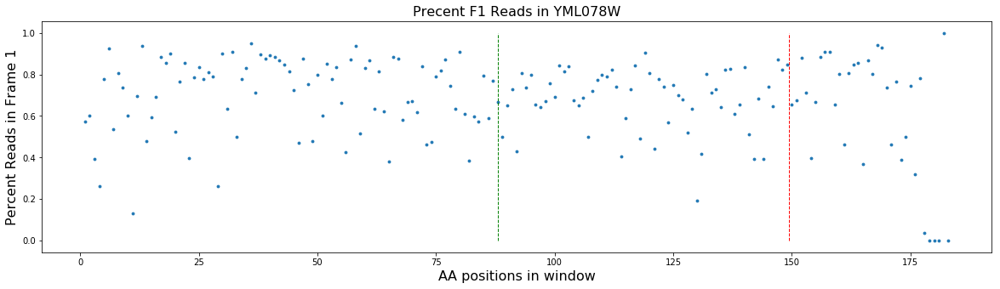

Simulated Percent: 0.5
612 814


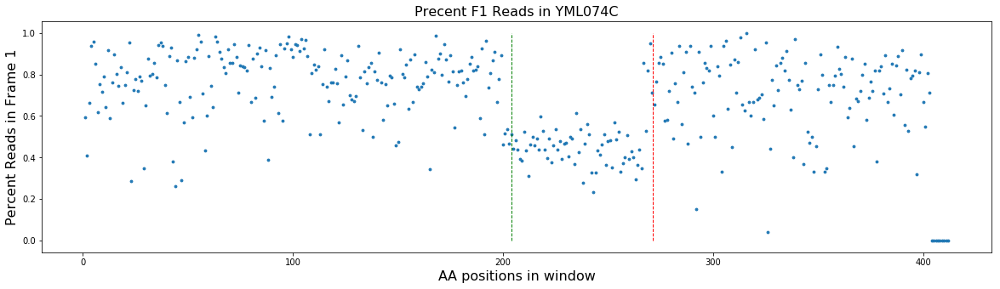

Simulated Percent: 0.5
819 871


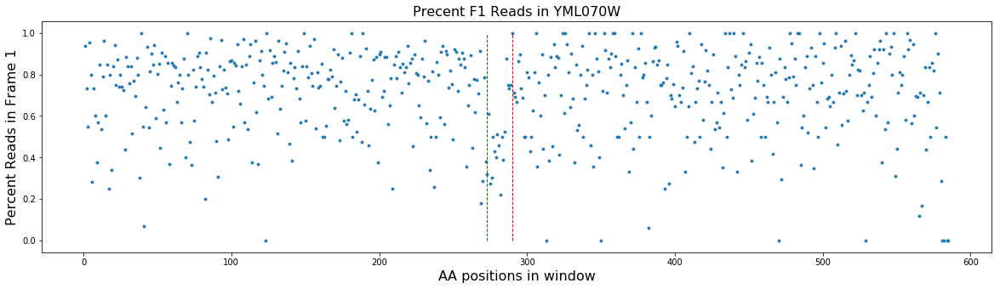

Simulated Percent: 0.5
102 184


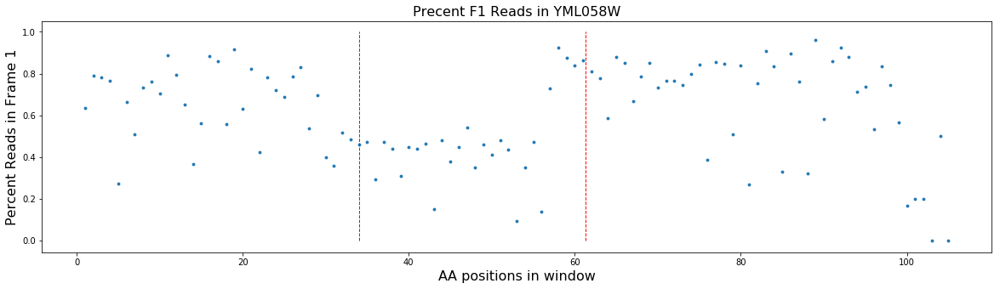

Simulated Percent: 0.1
642 742


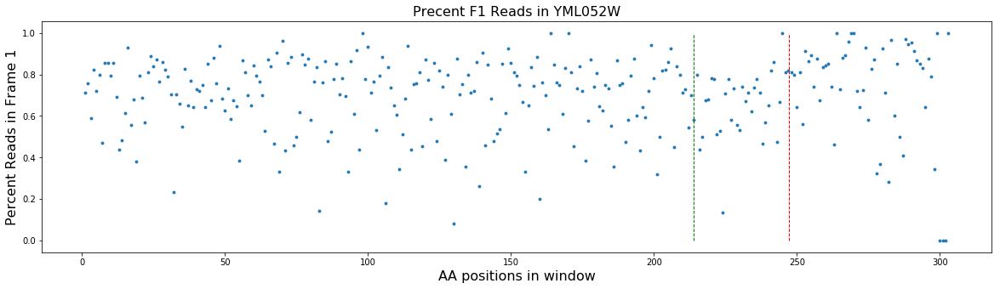

Simulated Percent: 0.4
468 532


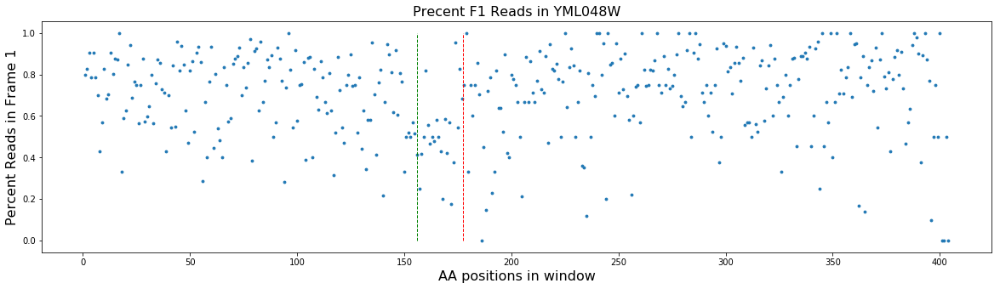

Simulated Percent: 0.8
75 127


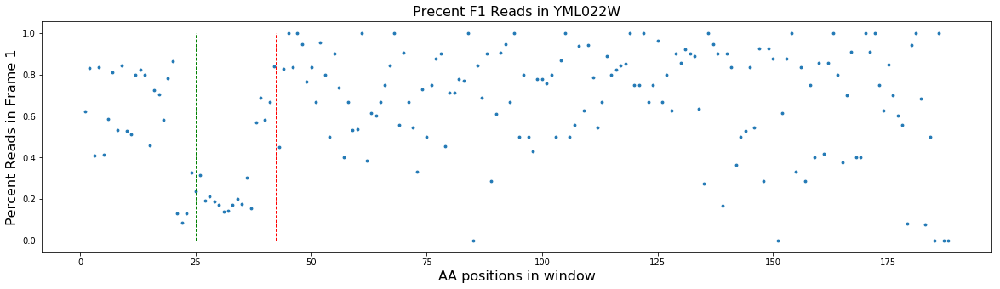

Simulated Percent: 0.6
114 184


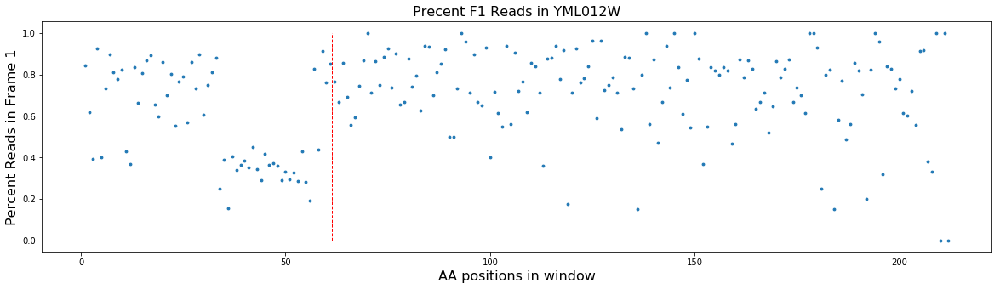

Simulated Percent: 0.1
288 394


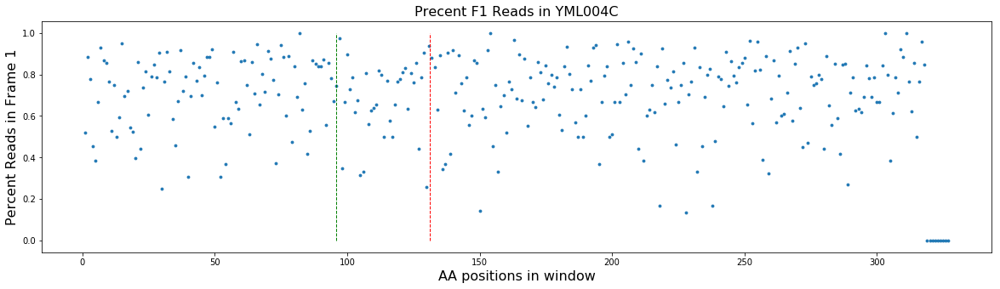

Simulated Percent: 0.6
201 271


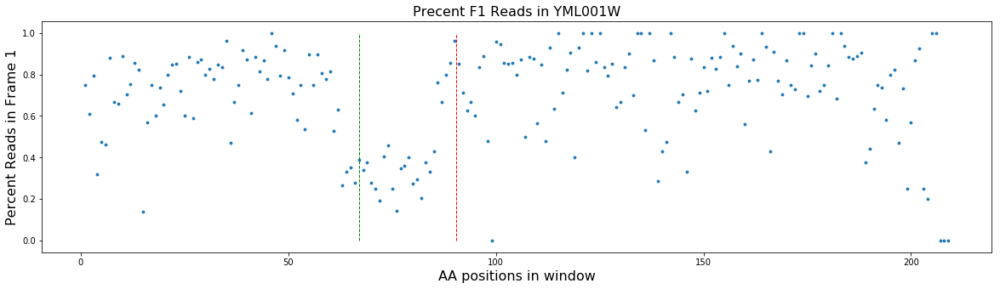

Simulated Percent: 0.6
114 226


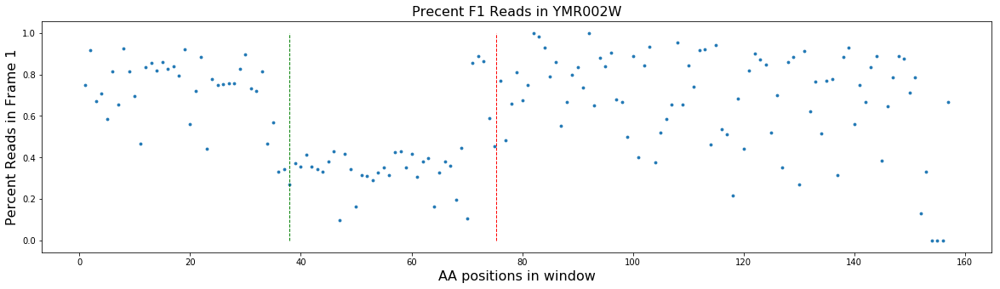

Simulated Percent: 0.5
708 788


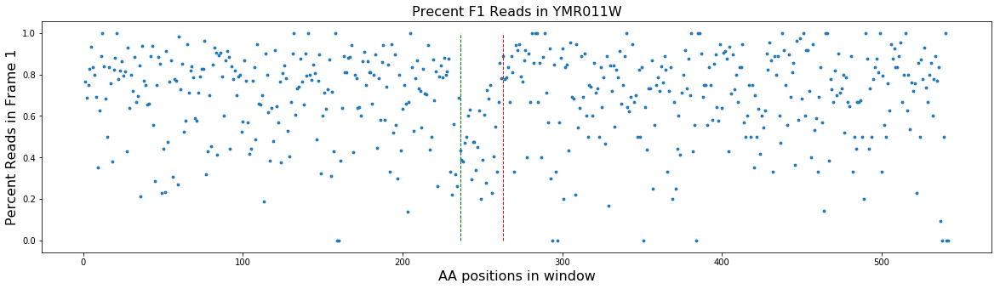

Simulated Percent: 0.5
1152 1234


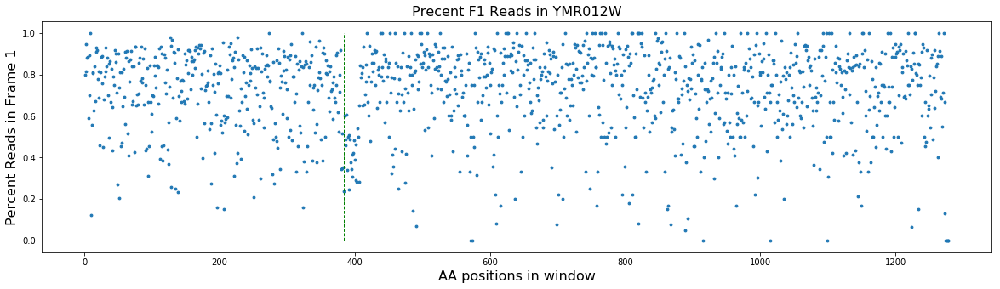

Simulated Percent: 0.3
279 335


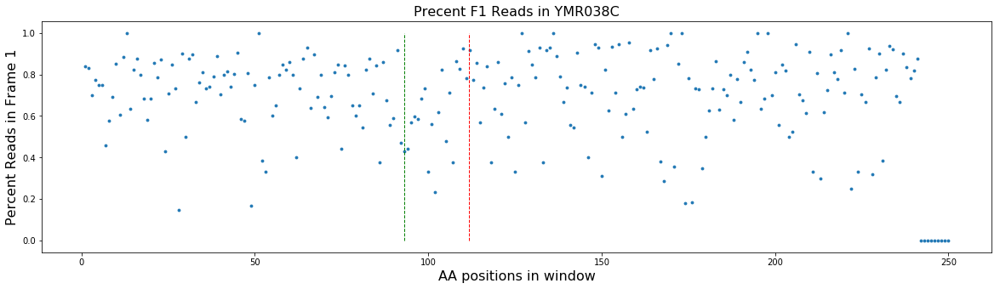

Simulated Percent: 0.1
276 436


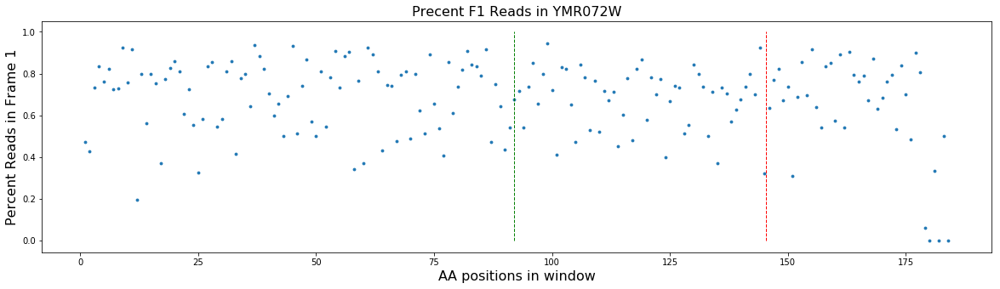

Simulated Percent: 0.9
72 184


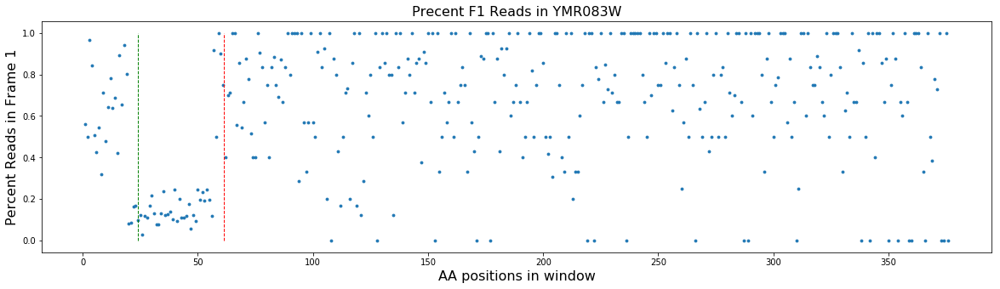

Simulated Percent: 0.2
780 871


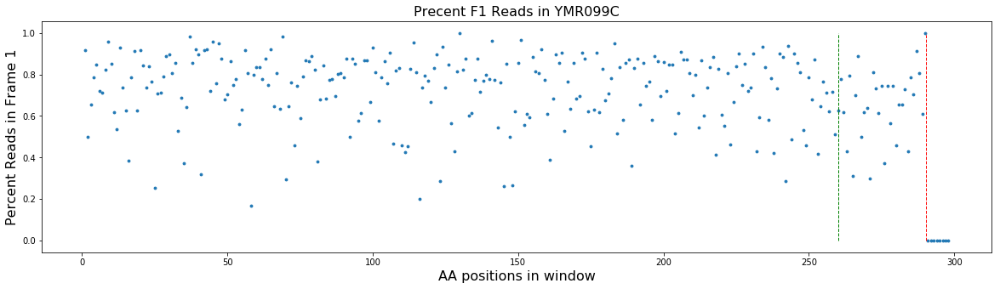

Simulated Percent: 0.3
288 346


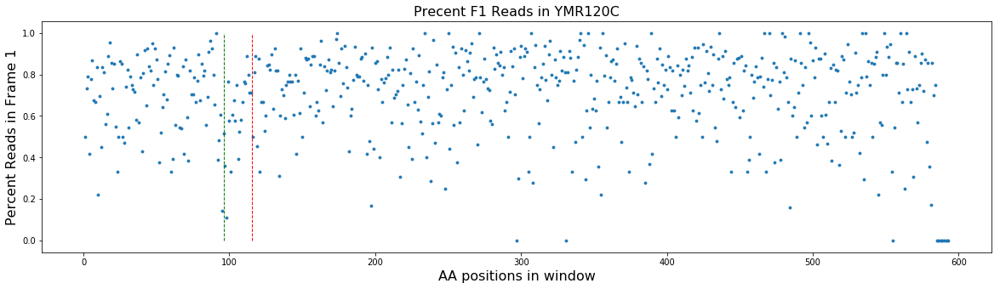

Simulated Percent: 0.3
177 238


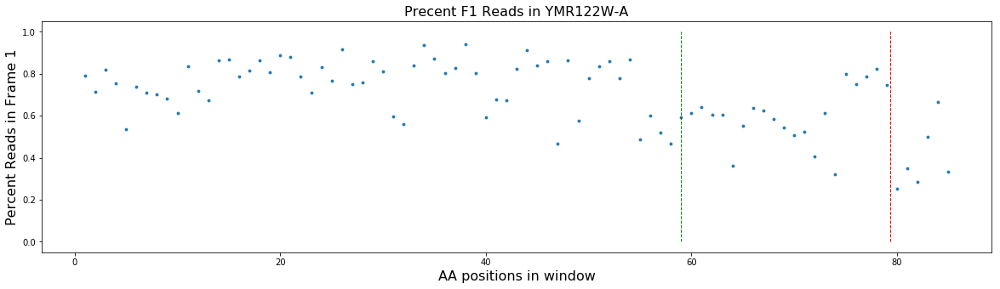

Simulated Percent: 0.5
423 544


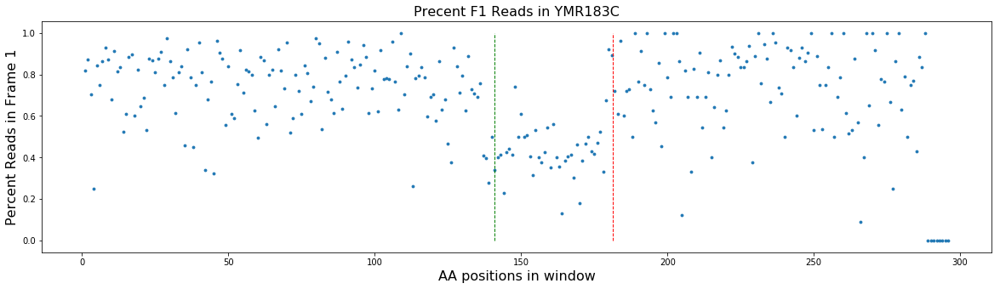

Simulated Percent: 0.6
198 250


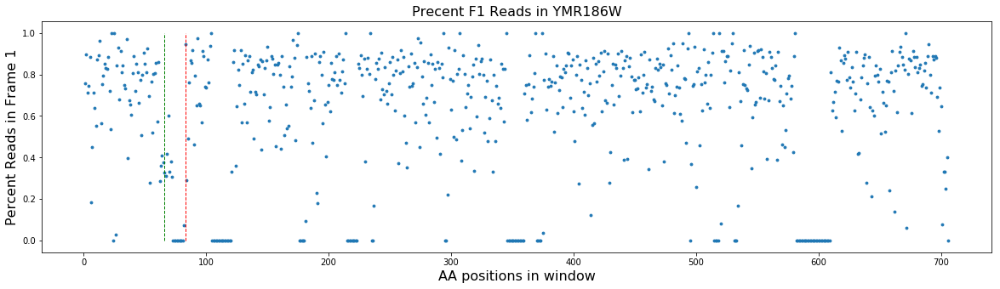

Simulated Percent: 0.2
522 587


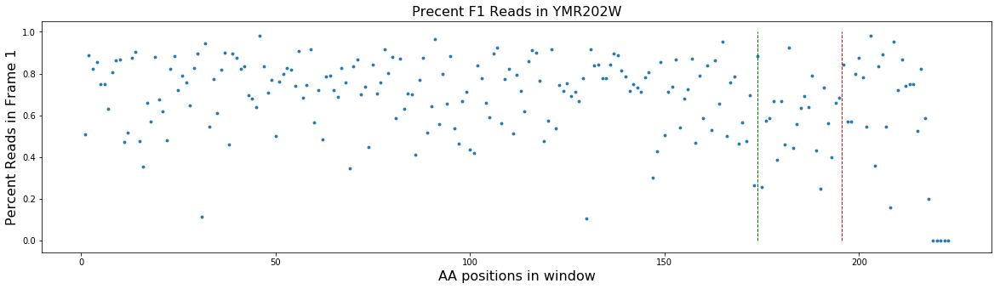

Simulated Percent: 0.9
75 131


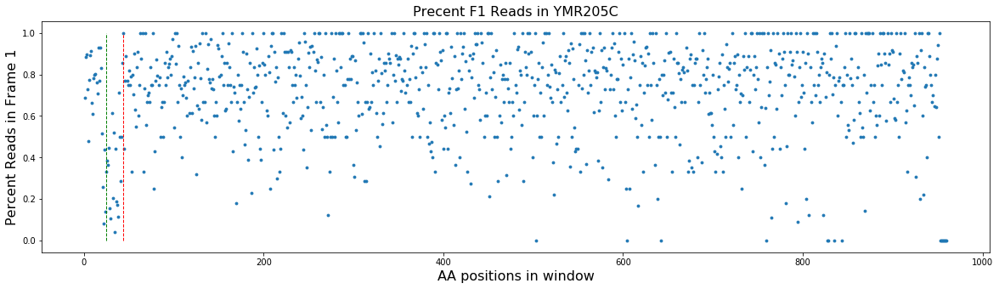

Simulated Percent: 0.2
456 565


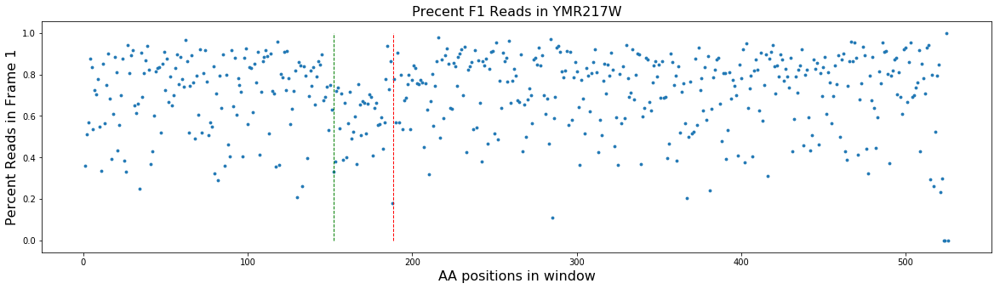

Simulated Percent: 0.3
546 623


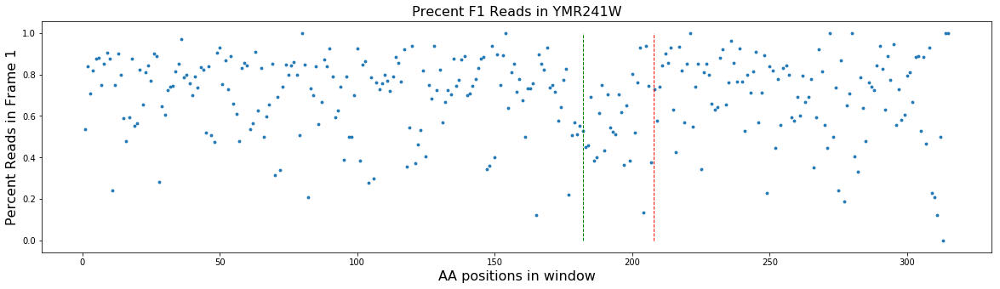

Simulated Percent: 0.1
1080 1133


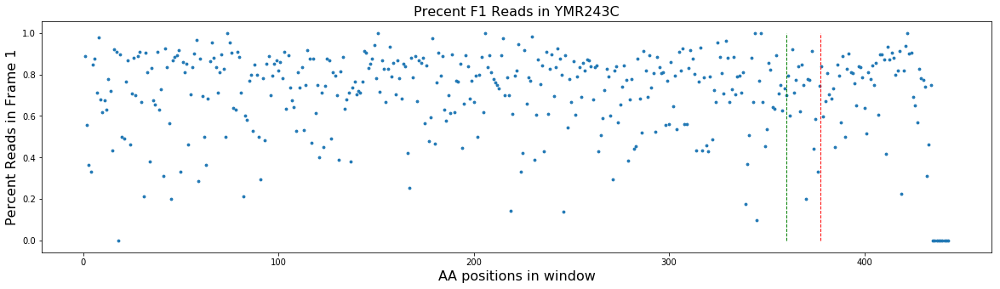

Simulated Percent: 0.4
390 482


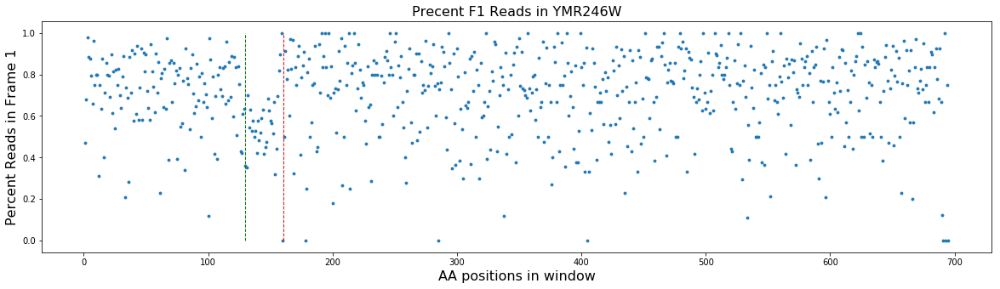

Simulated Percent: 0.4
60 112


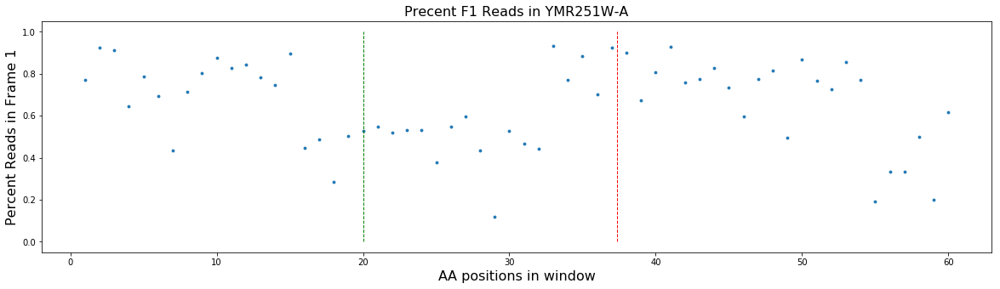

Simulated Percent: 0.05
66 193


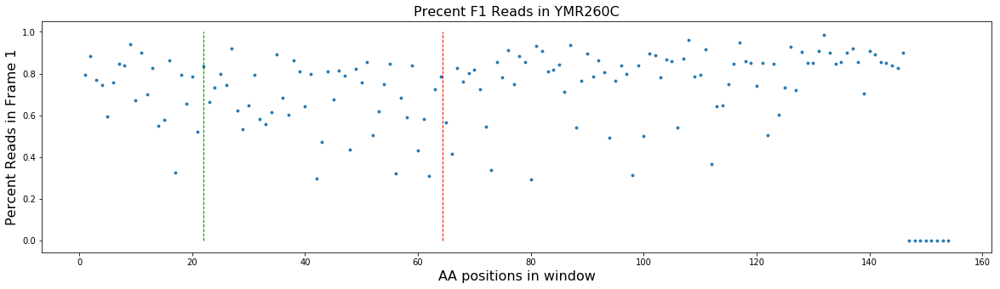

Simulated Percent: 0.7
1356 1501


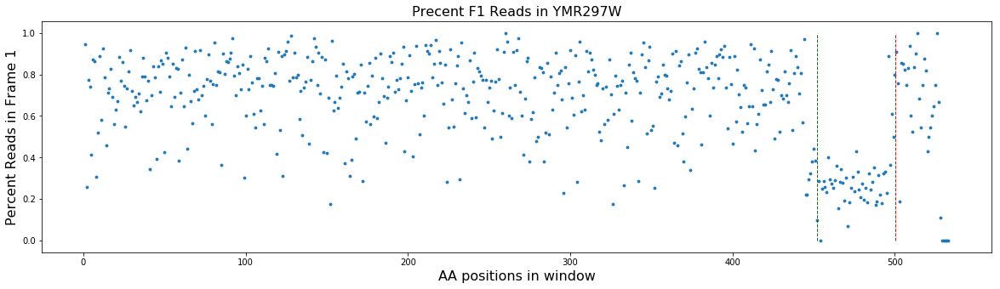

Simulated Percent: 0.3
150 224


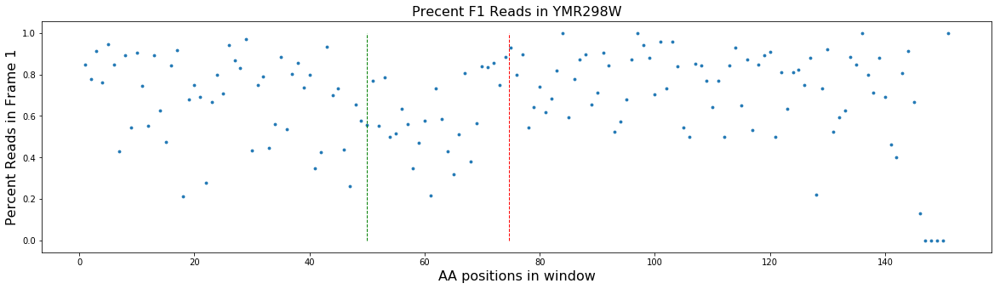

Simulated Percent: 0.6
1590 1664


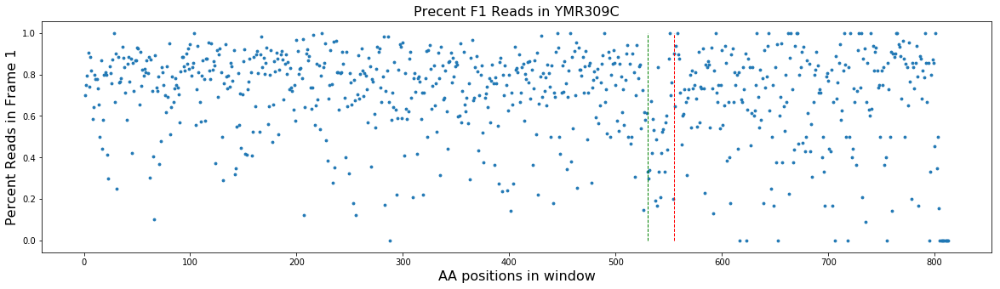

Simulated Percent: 0.2
90 197


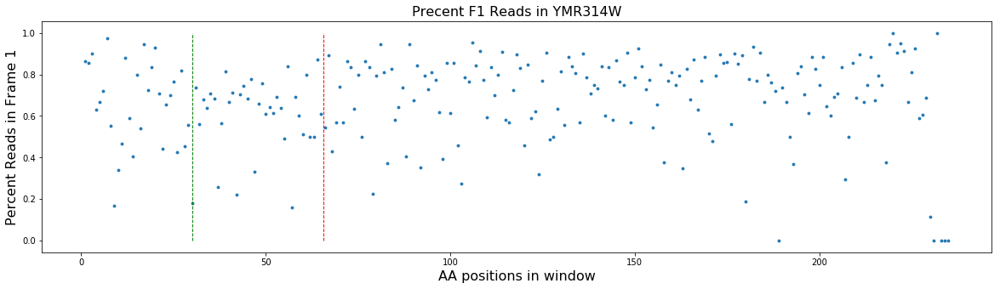

Simulated Percent: 0.2
594 701


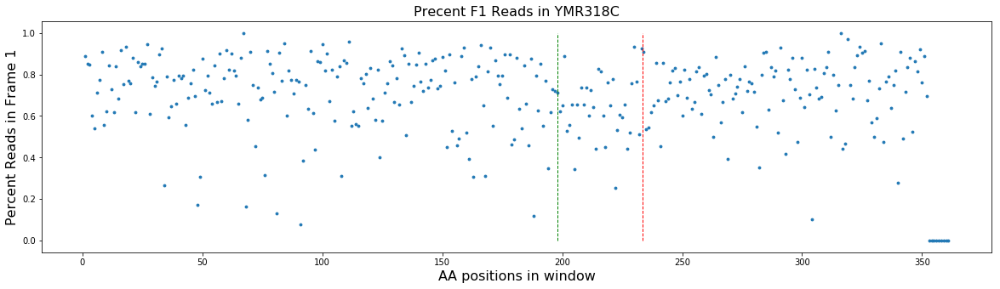

Simulated Percent: 0.6
2172 2233


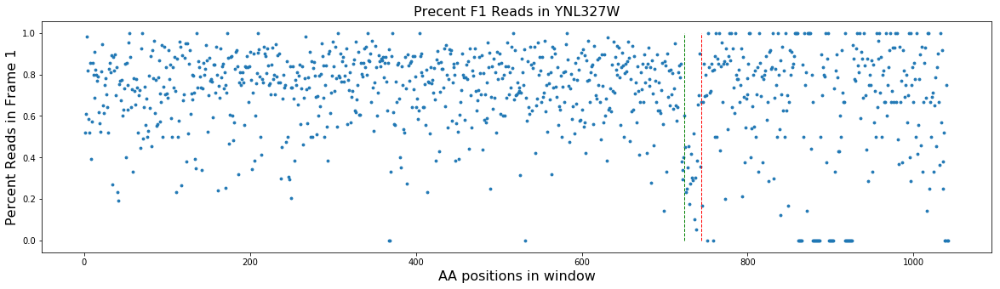

Simulated Percent: 0.2
264 412


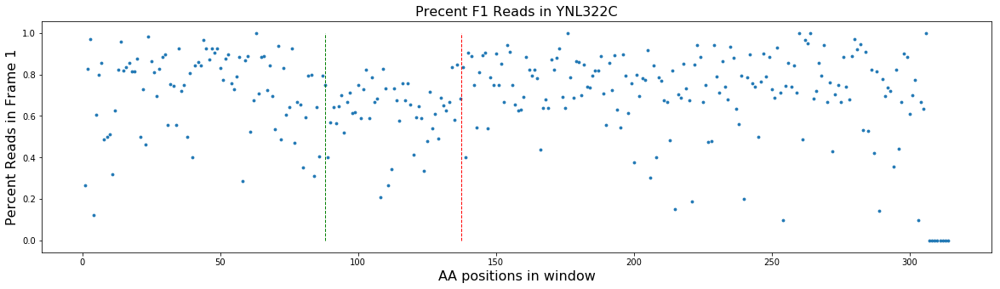

Simulated Percent: 0.4
2334 2384


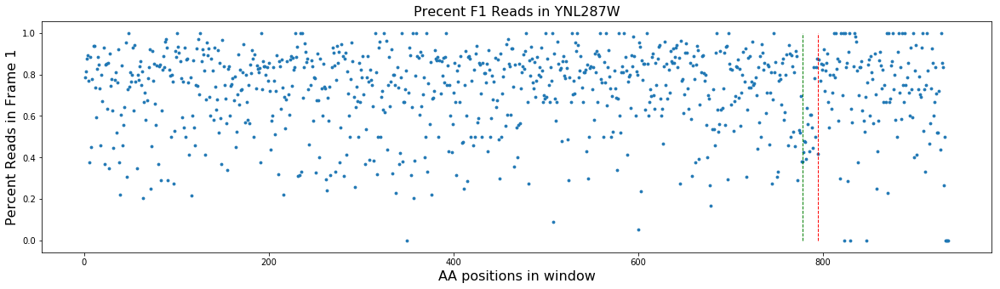

Simulated Percent: 0.3
321 394


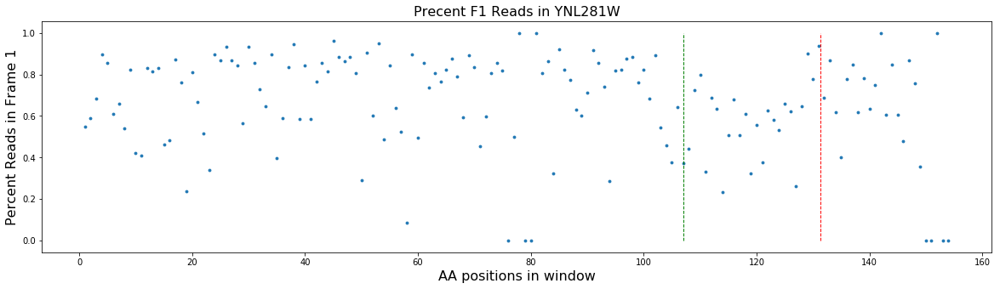

Simulated Percent: 0.05
135 322


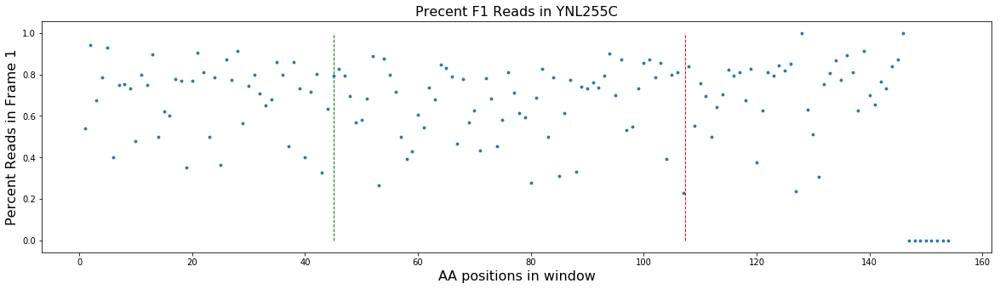

Simulated Percent: 0.4
222 274


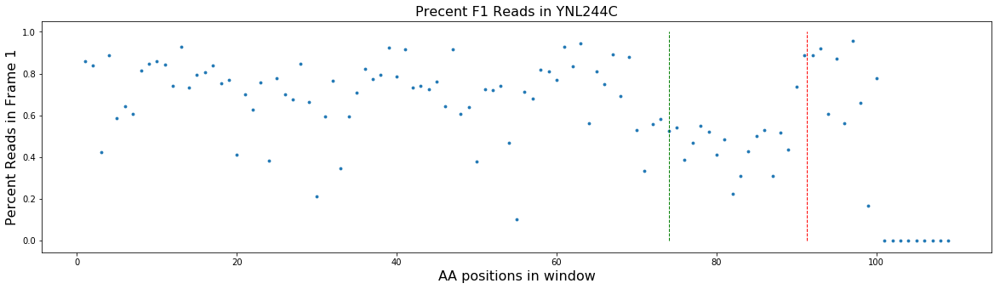

Simulated Percent: 0.4
1335 1490


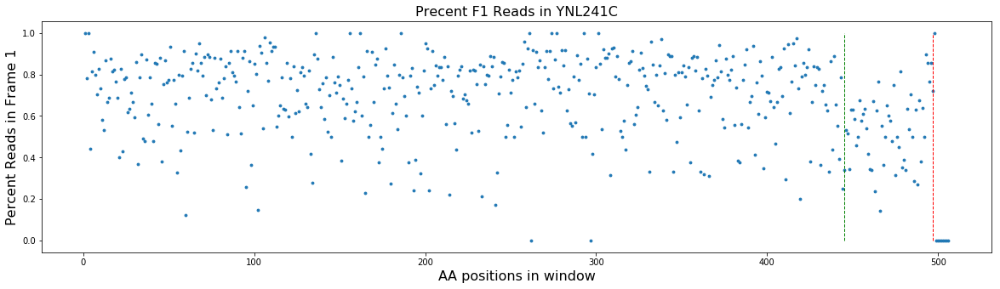

Simulated Percent: 0.5
981 1096


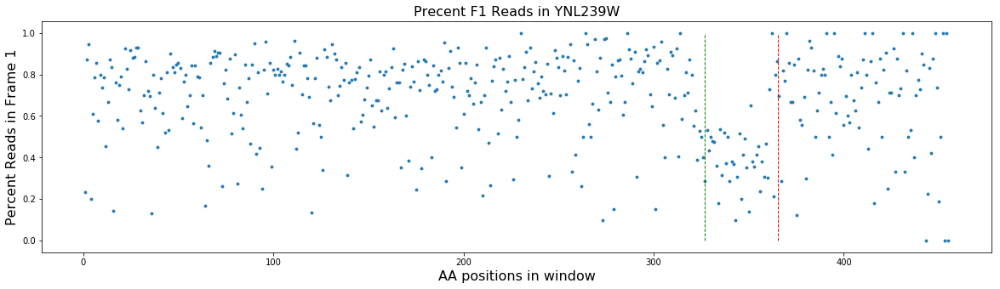

Simulated Percent: 0.1
930 1070


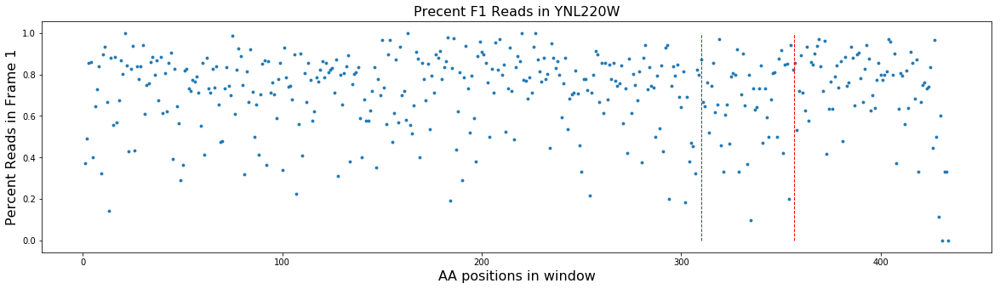

Simulated Percent: 0.3
1272 1393


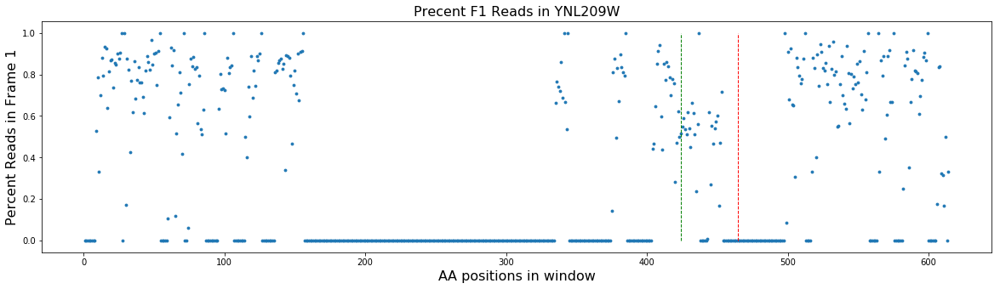

Simulated Percent: 0.4
129 179


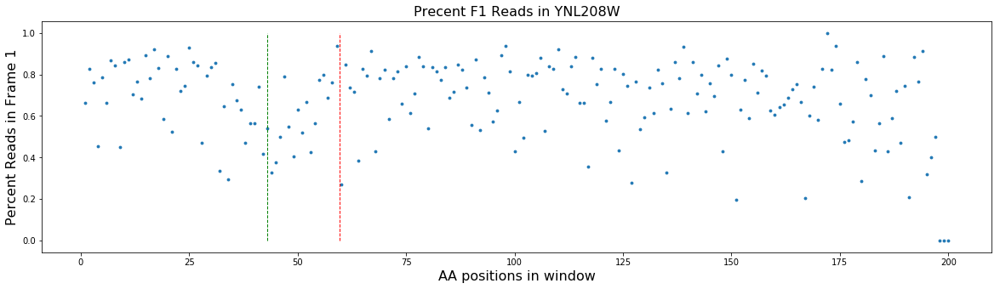

Simulated Percent: 0.6
201 553


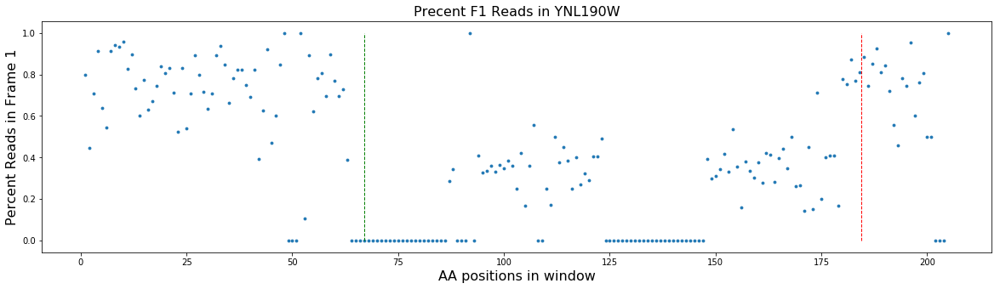

Simulated Percent: 0.1
1422 1475


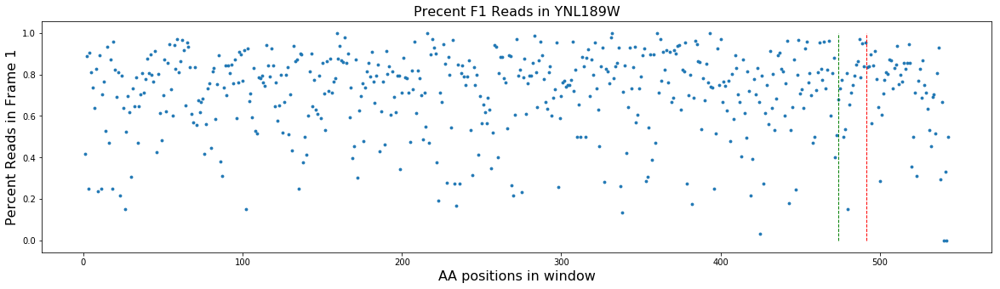

Simulated Percent: 0.5
333 424


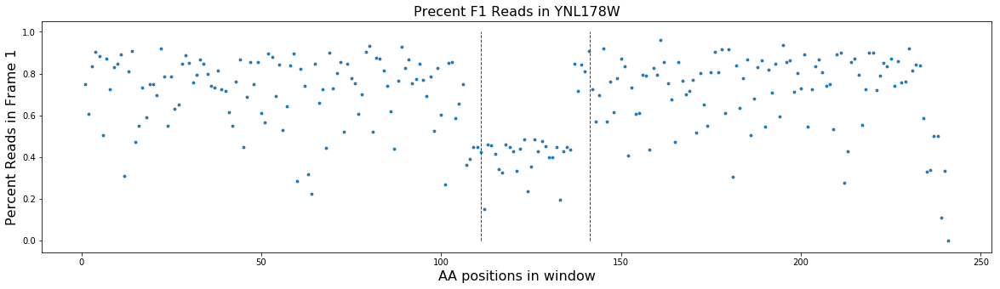

Simulated Percent: 0.1
1287 1423


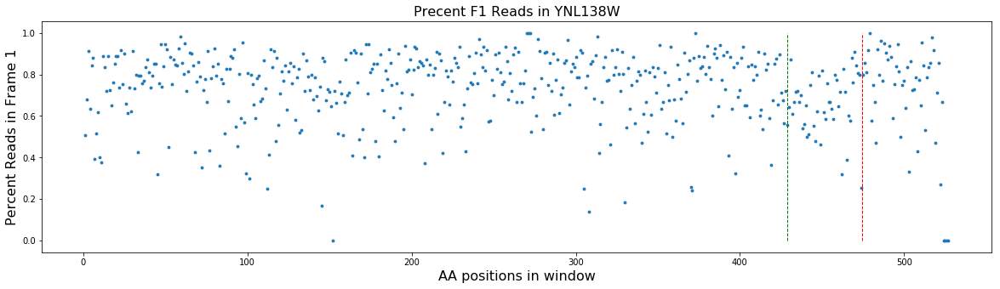

Simulated Percent: 0.1
45 241


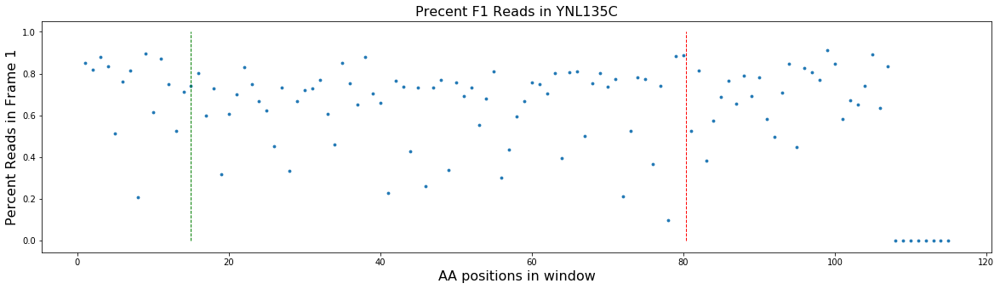

Simulated Percent: 0.3
1770 1822


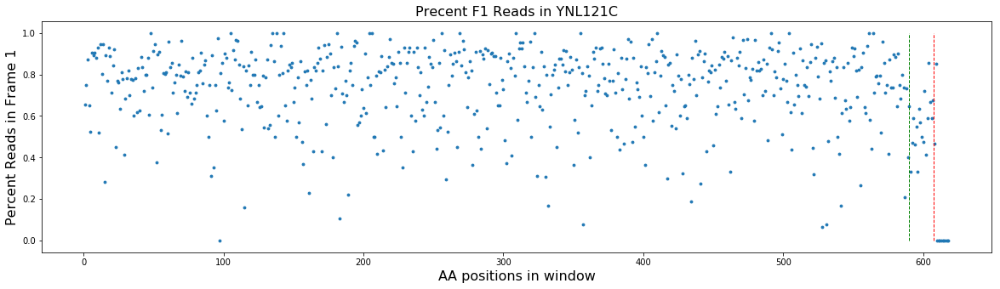

Simulated Percent: 0.3
132 196


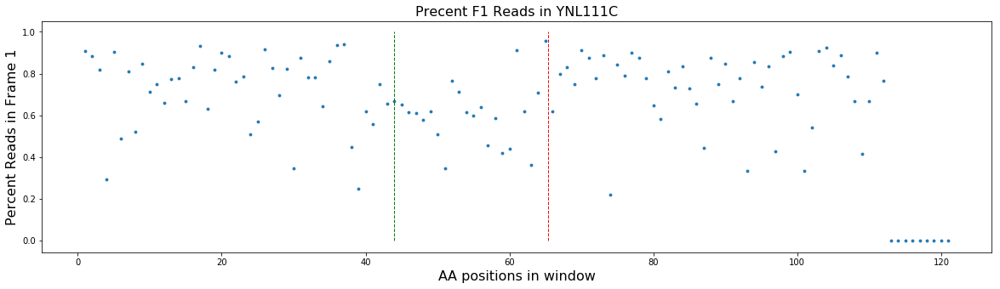

Simulated Percent: 0.4
234 290


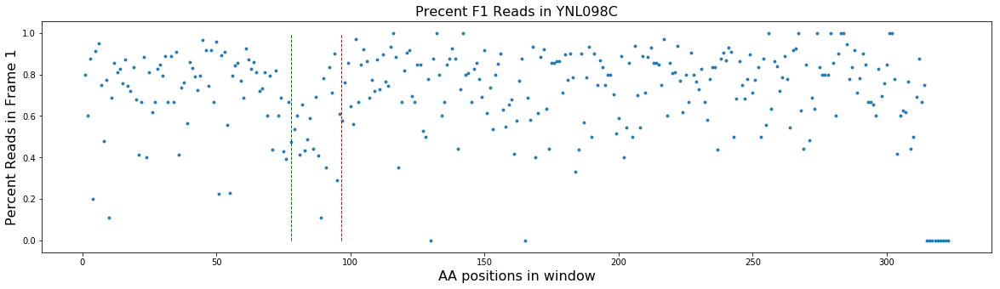

Simulated Percent: 0.7
192 250


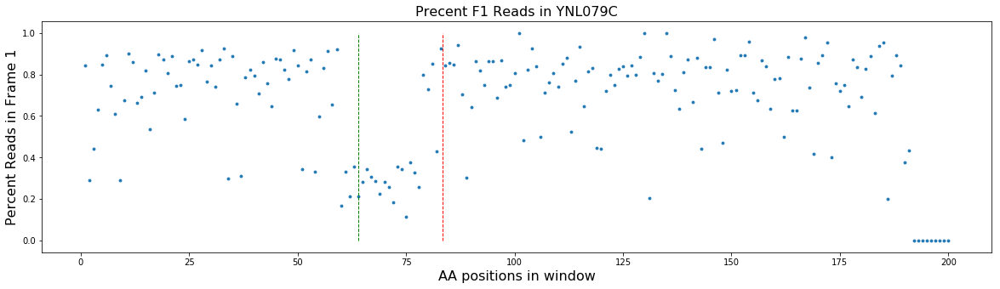

Simulated Percent: 0.1
768 920


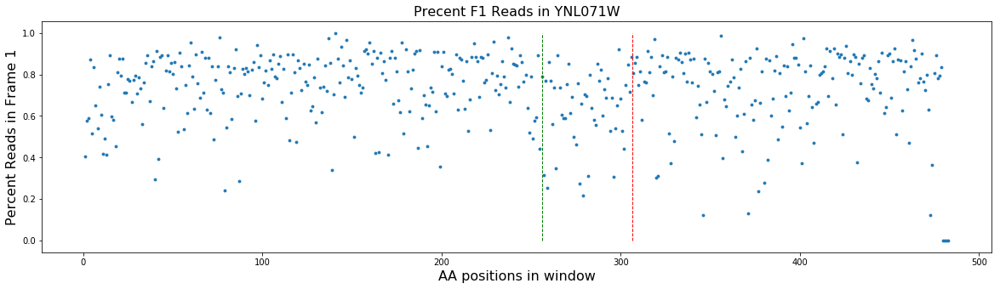

Simulated Percent: 0.2
96 151


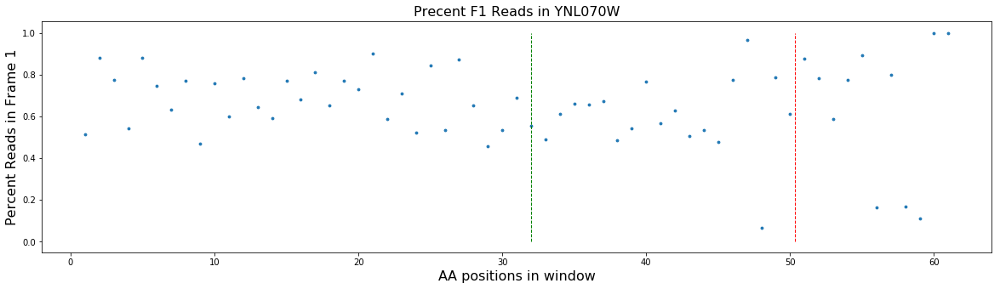

Simulated Percent: 0.05
36 100


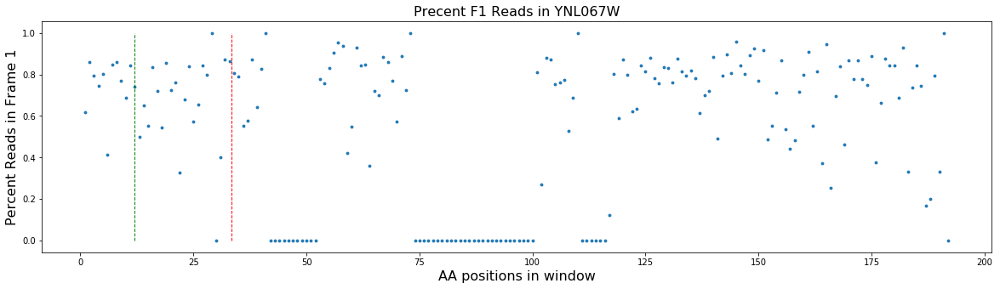

Simulated Percent: 0.1
189 244


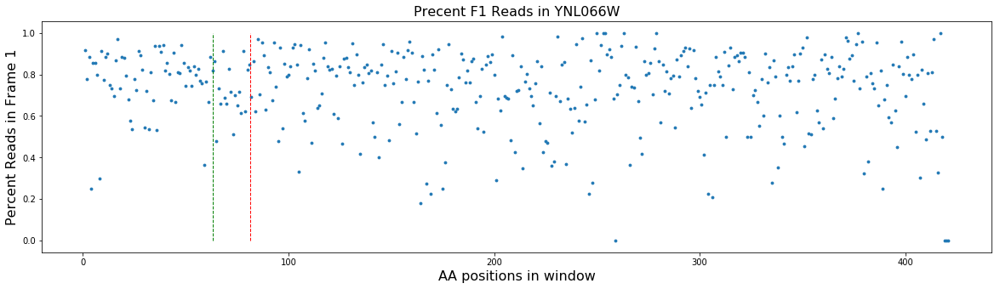

Simulated Percent: 0.5
120 220


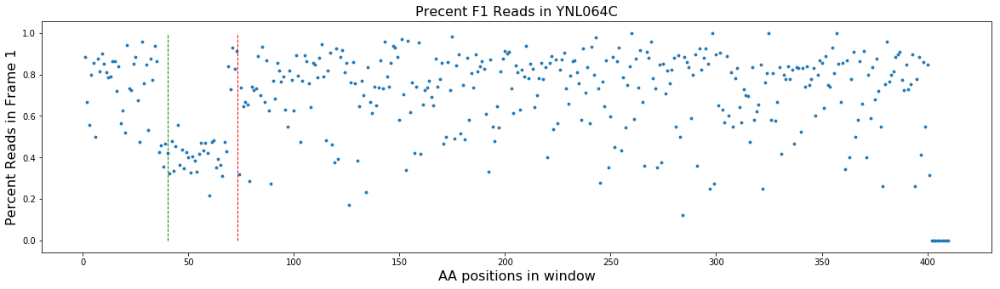

Simulated Percent: 0.3
63 127


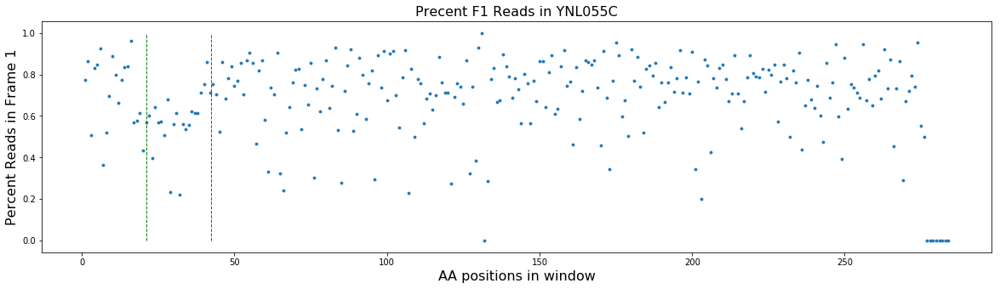

Simulated Percent: 0.9
204 263


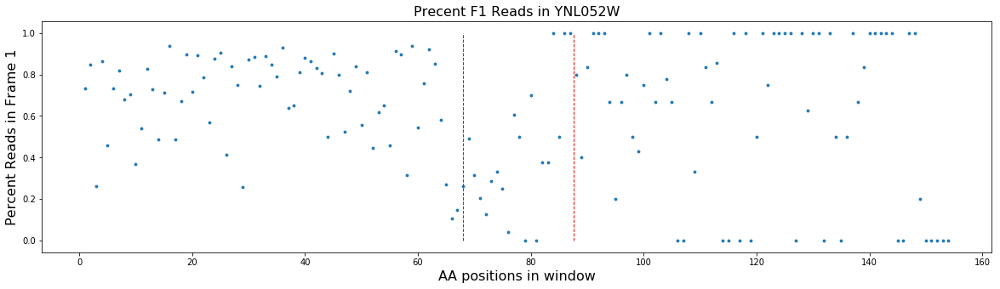

Simulated Percent: 0.05
633 730


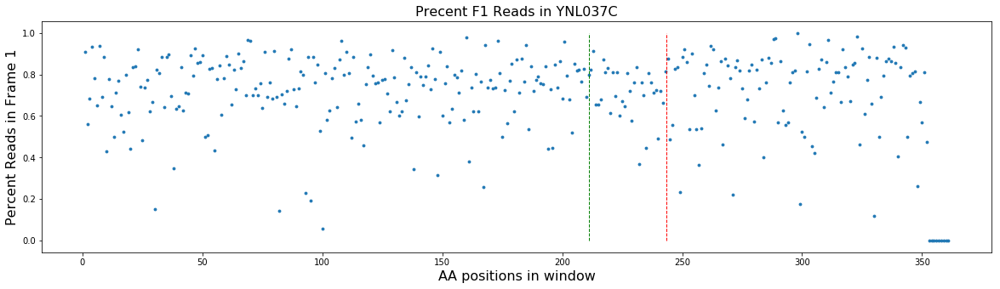

Simulated Percent: 0.1
567 635


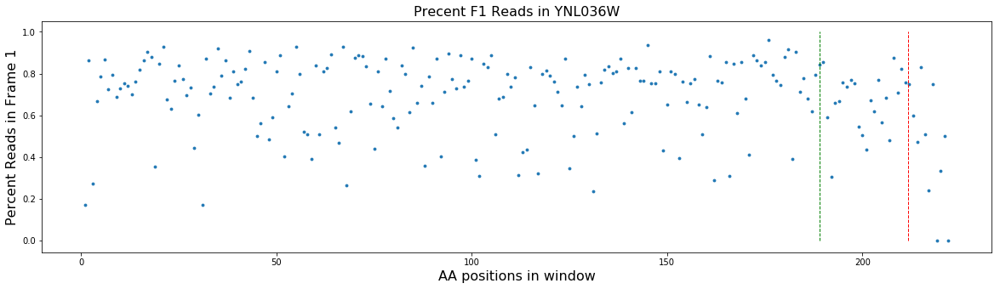

Simulated Percent: 0.4
207 314


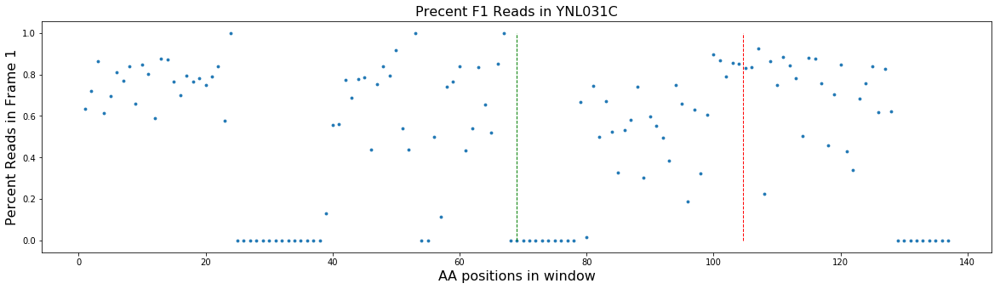

Simulated Percent: 0.9
132 221


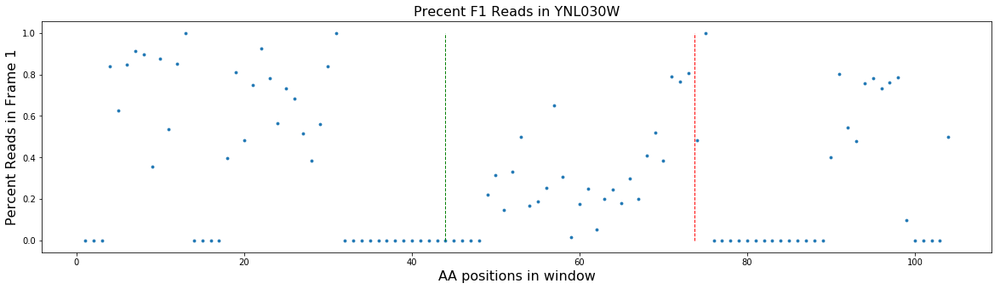

Simulated Percent: 0.4
918 970


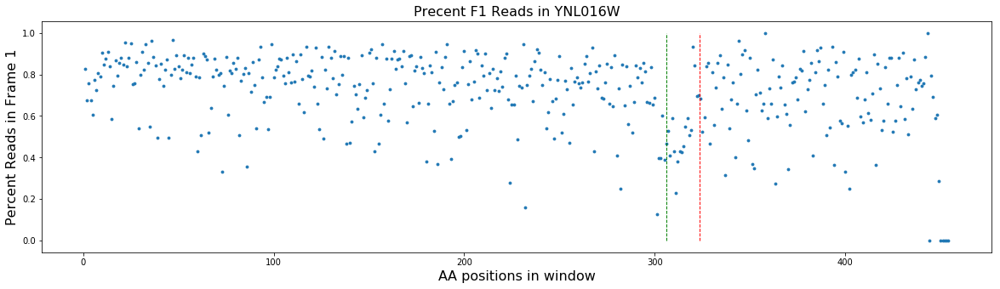

Simulated Percent: 0.7
45 154


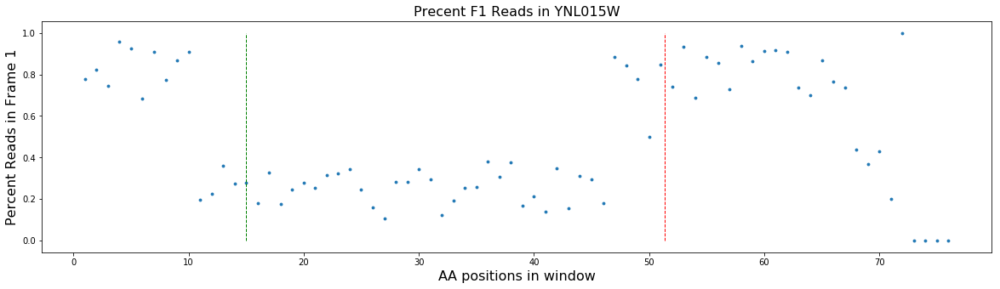

Simulated Percent: 0.5
285 362


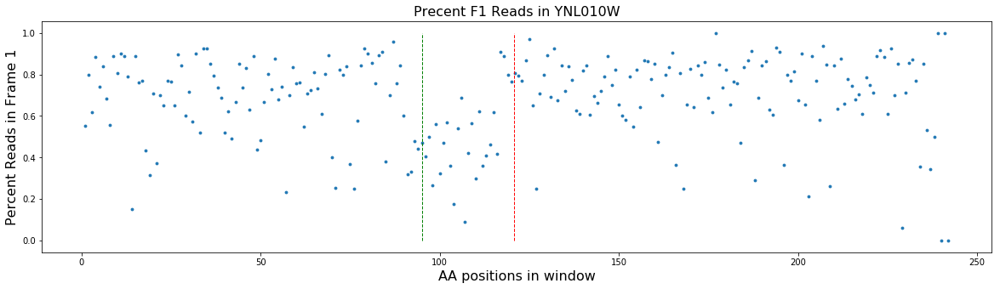

Simulated Percent: 0.05
720 802


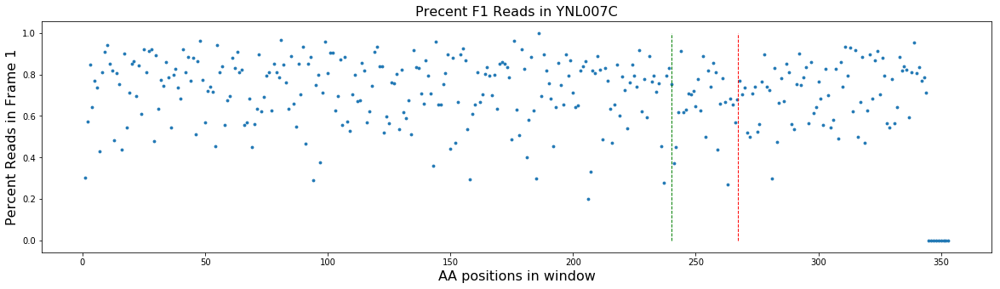

Simulated Percent: 0.6
333 406


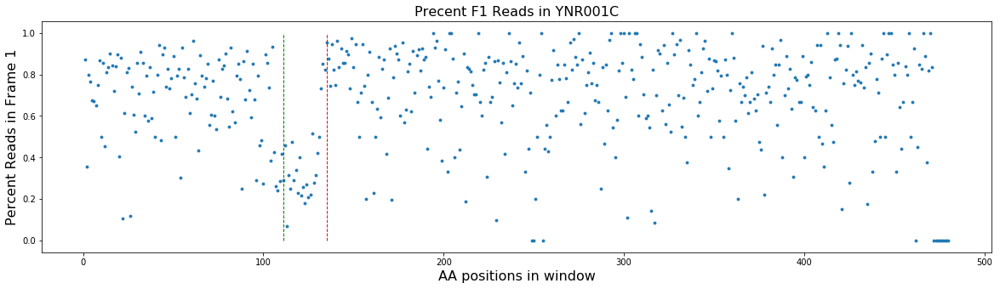

Simulated Percent: 0.3
288 391


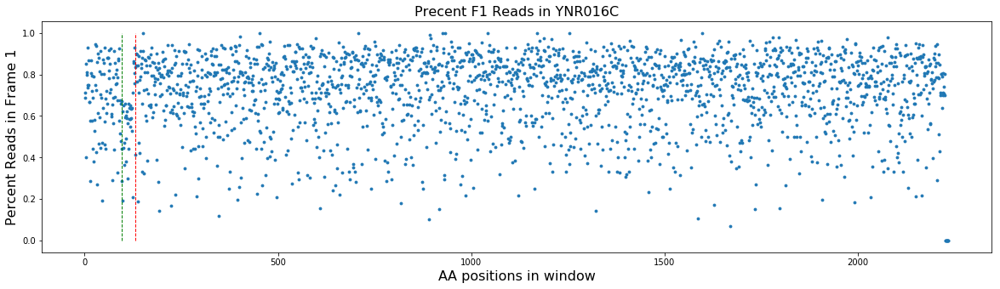

Simulated Percent: 0.4
687 772


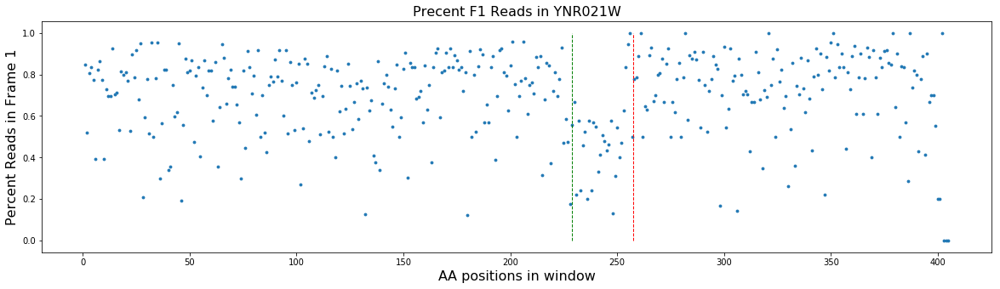

Simulated Percent: 0.3
756 826


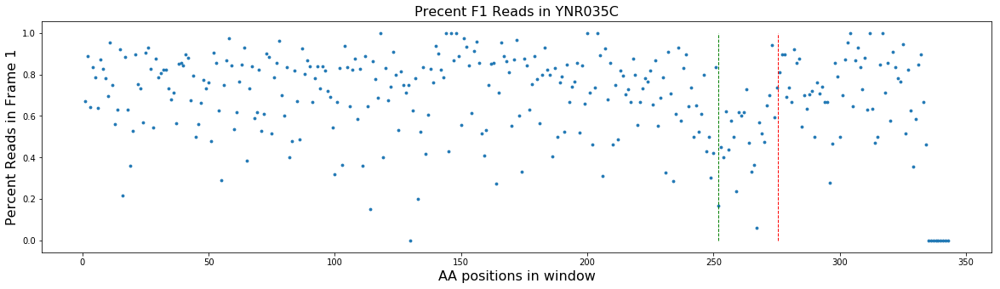

Simulated Percent: 0.1
354 442


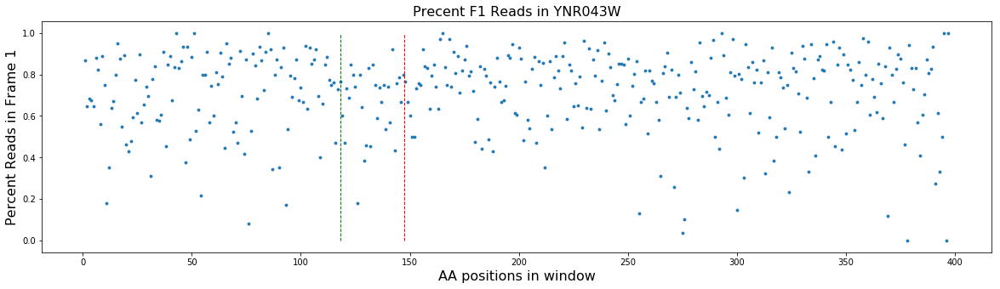

Simulated Percent: 0.6
345 410


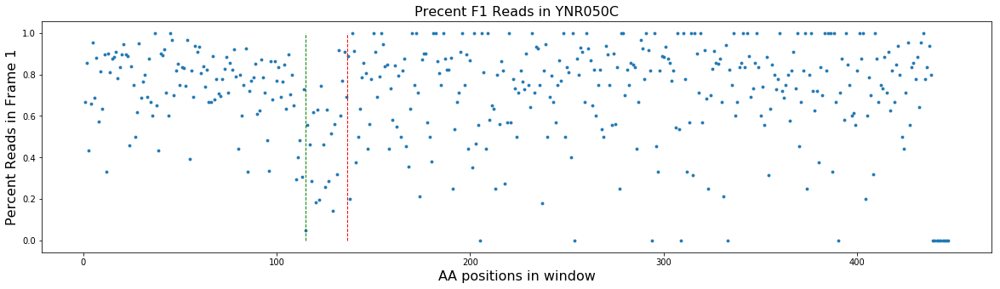

Simulated Percent: 0.6
618 697


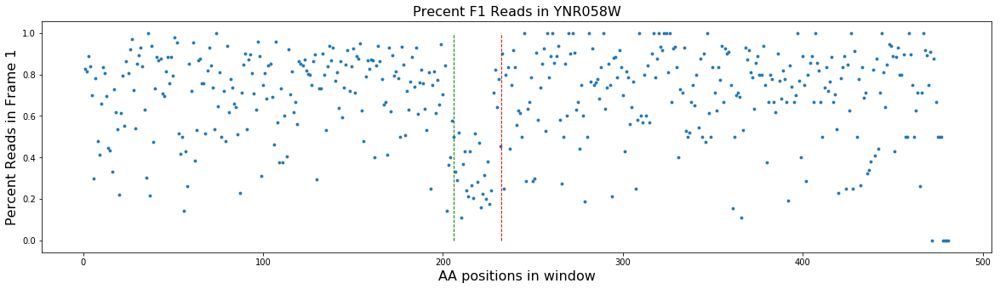

Simulated Percent: 0.5
255 331


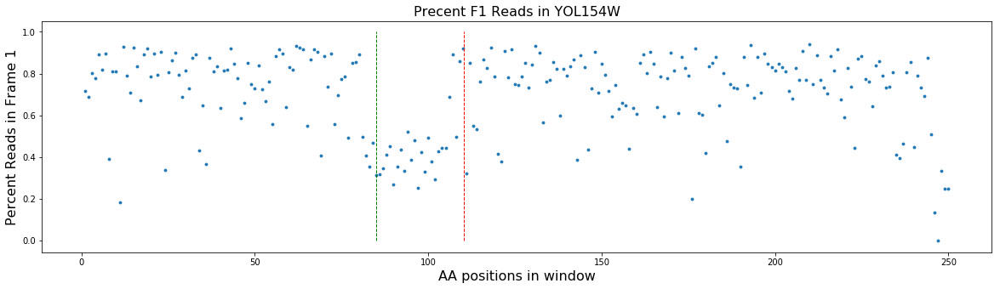

Simulated Percent: 0.4
219 281


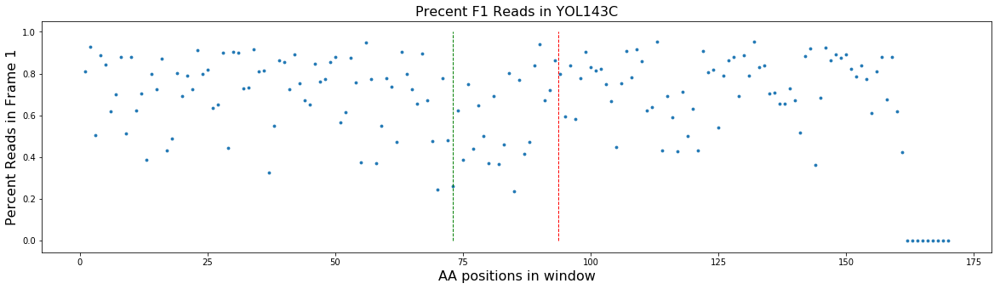

Simulated Percent: 0.6
318 391


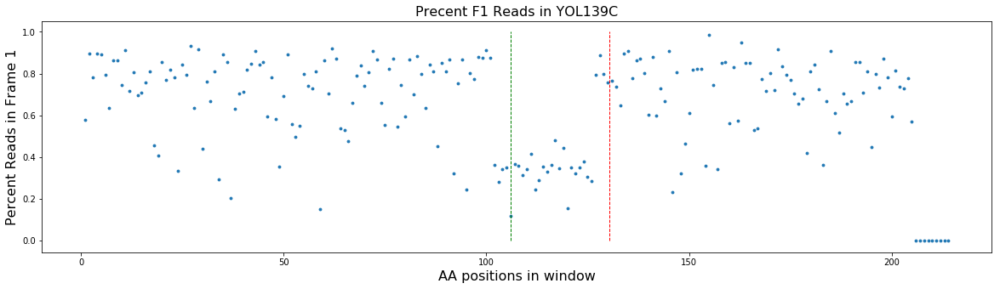

Simulated Percent: 0.4
297 424


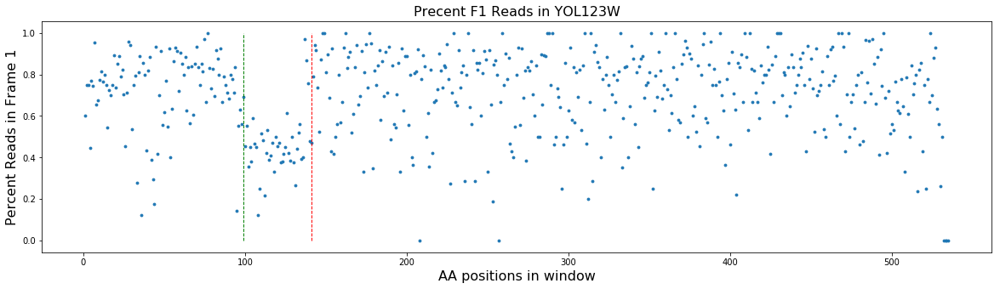

Simulated Percent: 0.5
288 361


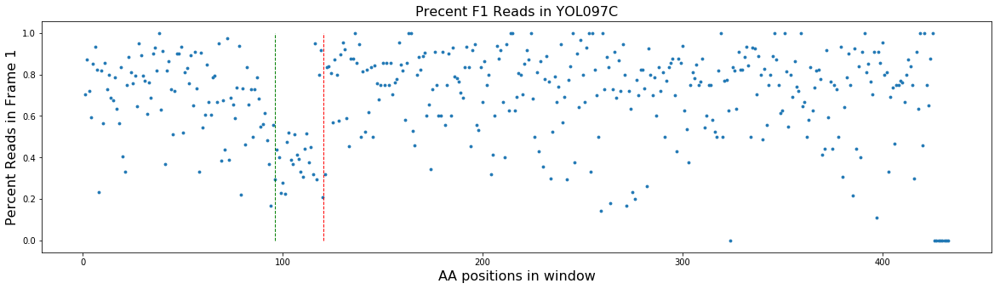

Simulated Percent: 0.9
954 1019


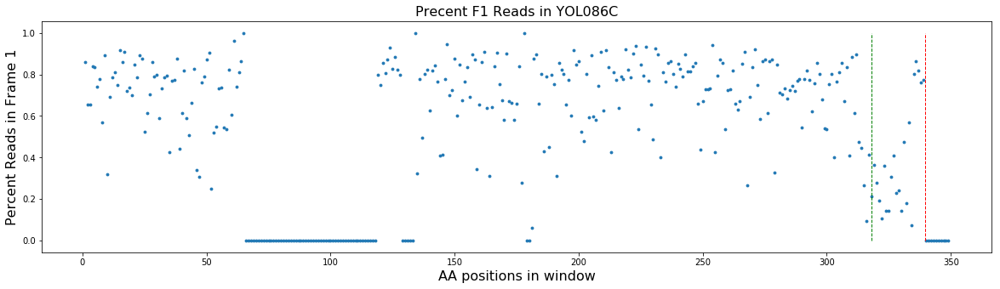

Simulated Percent: 0.5
42 101


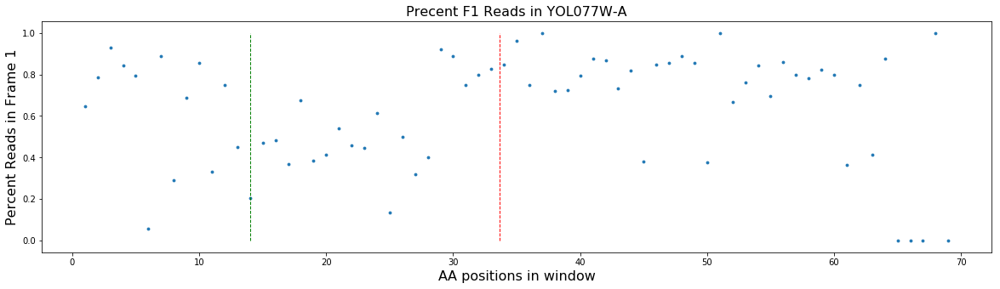

Simulated Percent: 0.5
54 145


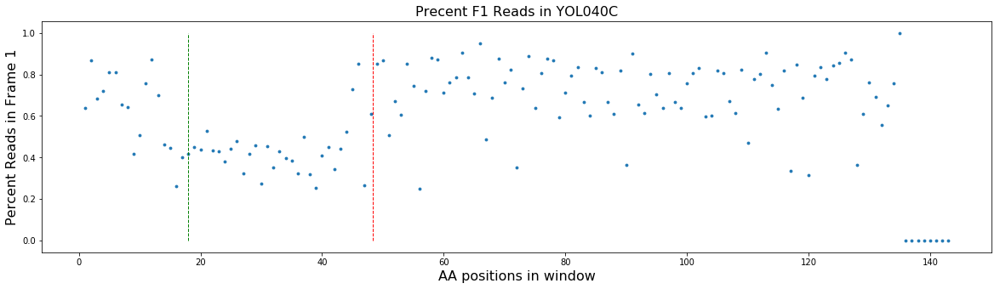

Simulated Percent: 0.8
117 181


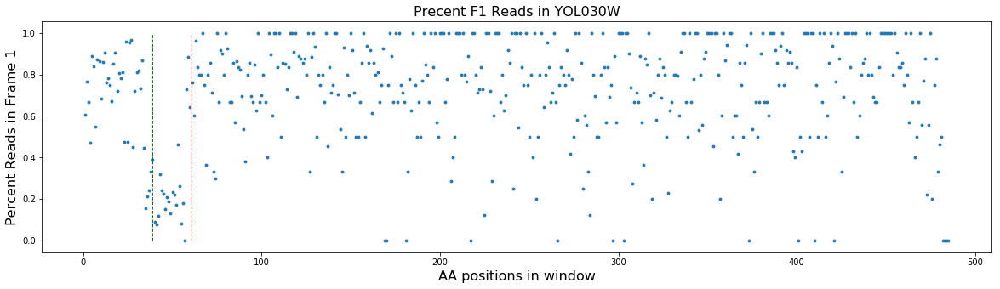

Simulated Percent: 0.7
153 217


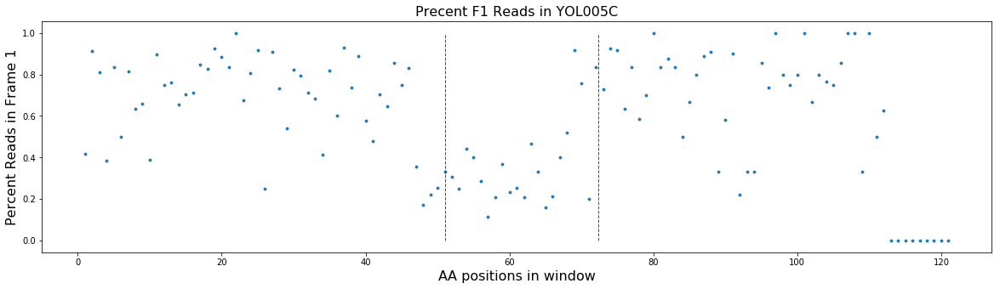

Simulated Percent: 0.5
39 122


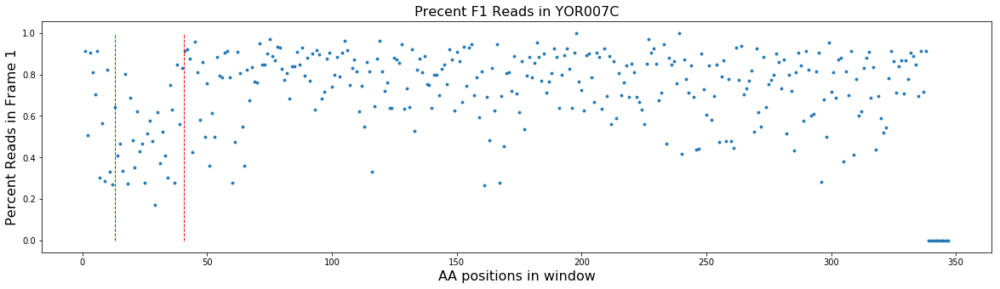

Simulated Percent: 0.4
39 107


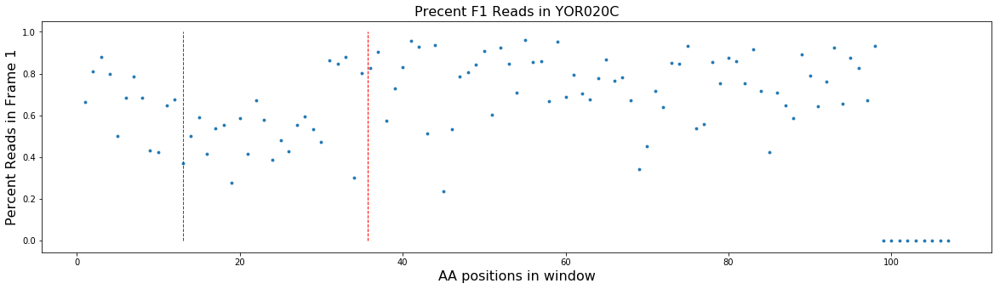

Simulated Percent: 0.1
105 157


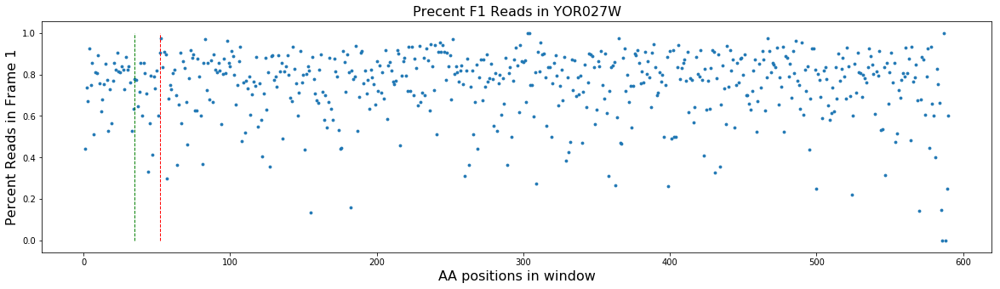

Simulated Percent: 0.3
39 109


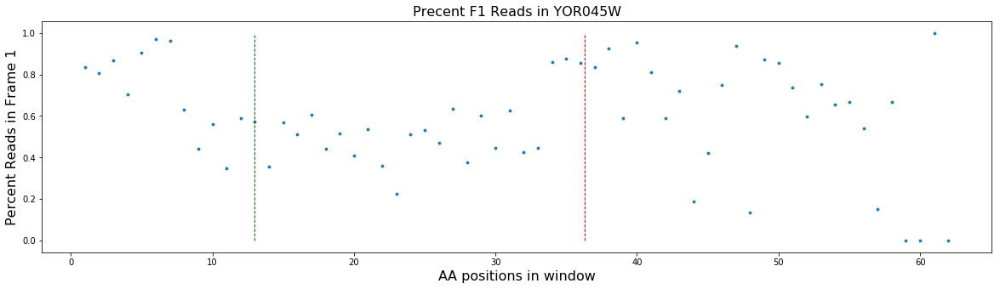

Simulated Percent: 0.3
993 1055


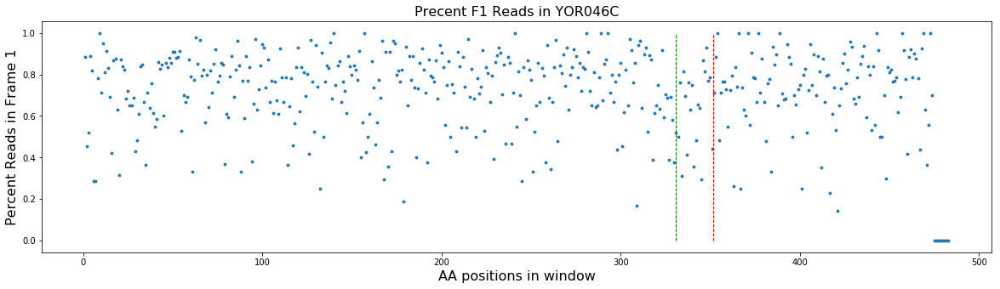

Simulated Percent: 0.05
330 547


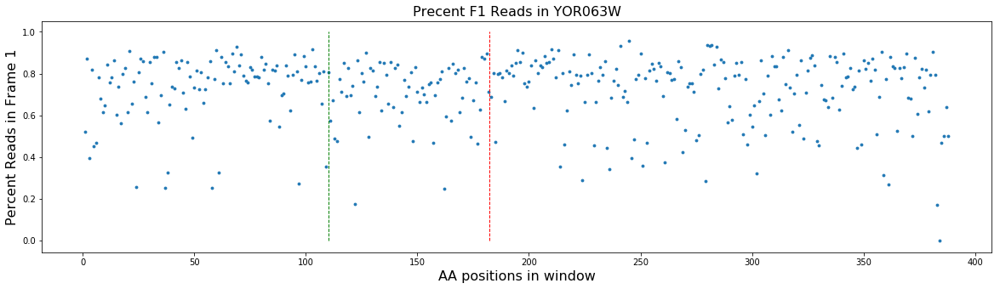

Simulated Percent: 0.3
258 325


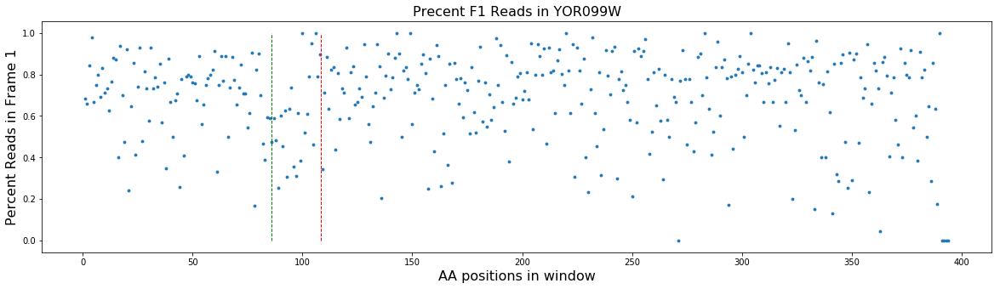

Simulated Percent: 0.6
873 925


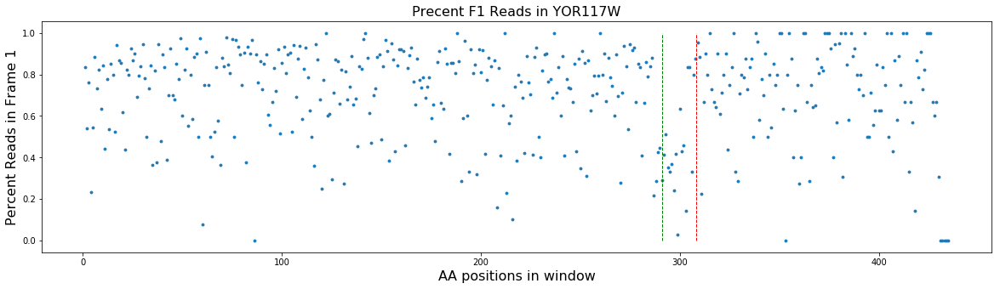

Simulated Percent: 0.3
777 829


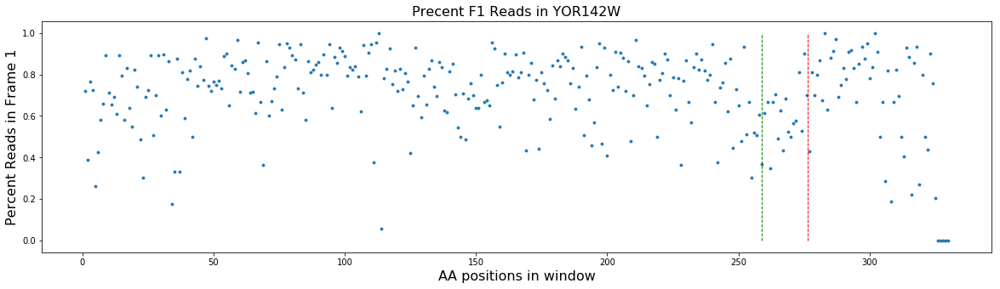

Simulated Percent: 0.5
363 443


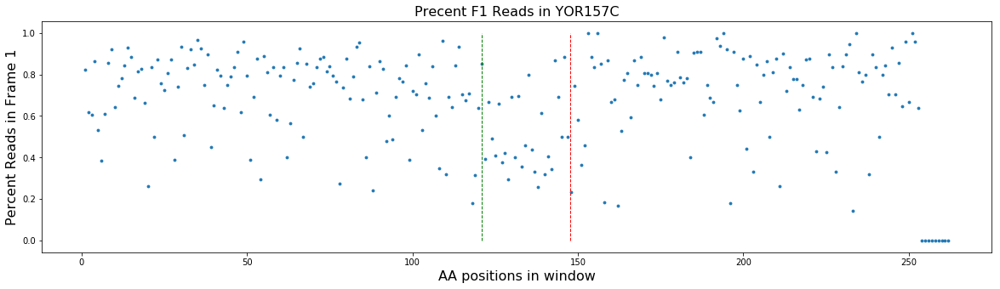

Simulated Percent: 0.05
42 143


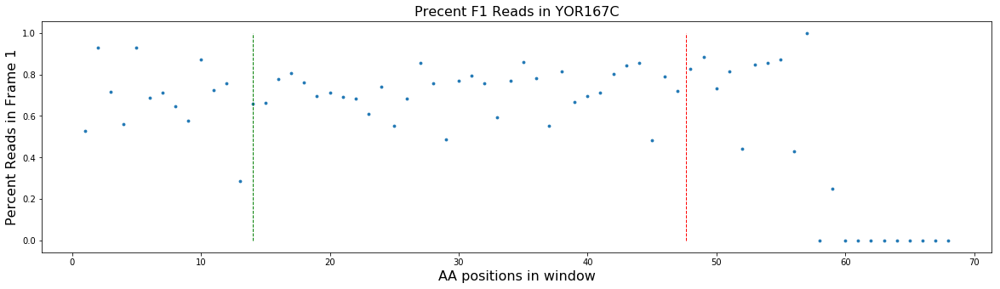

Simulated Percent: 0.1
807 880


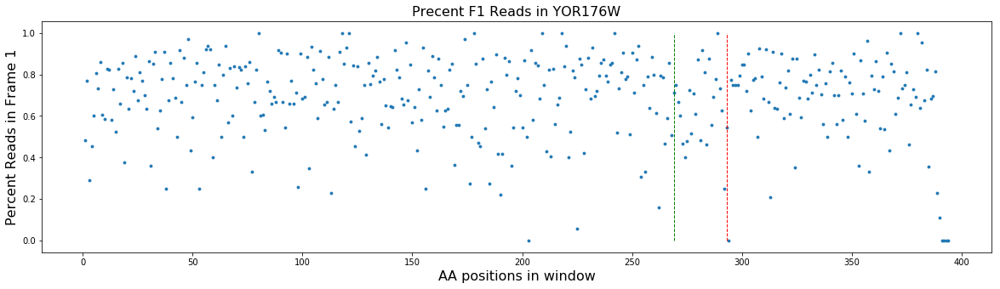

Simulated Percent: 0.8
711 790


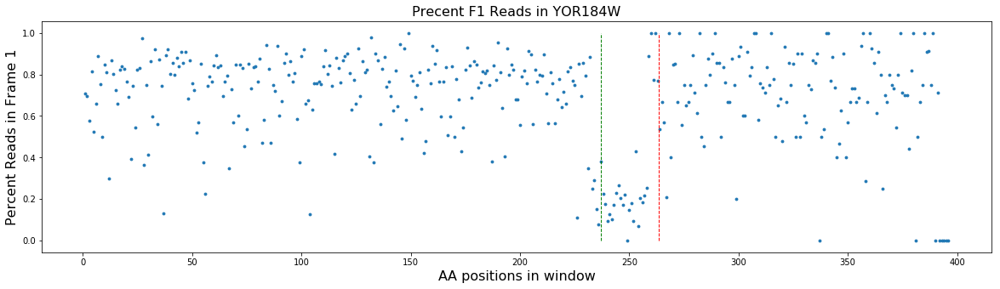

Simulated Percent: 0.5
279 382


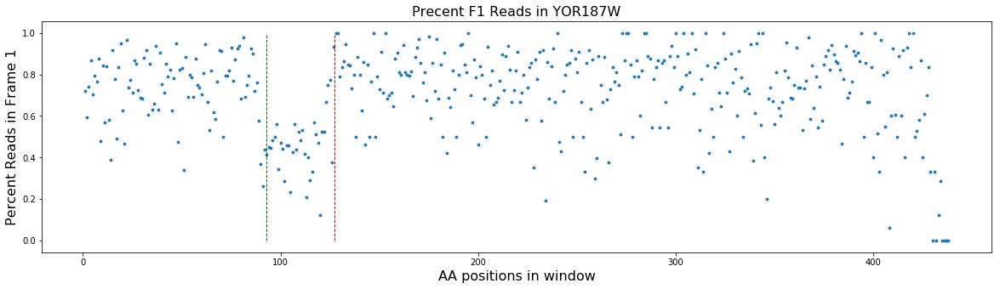

Simulated Percent: 0.8
1230 1312


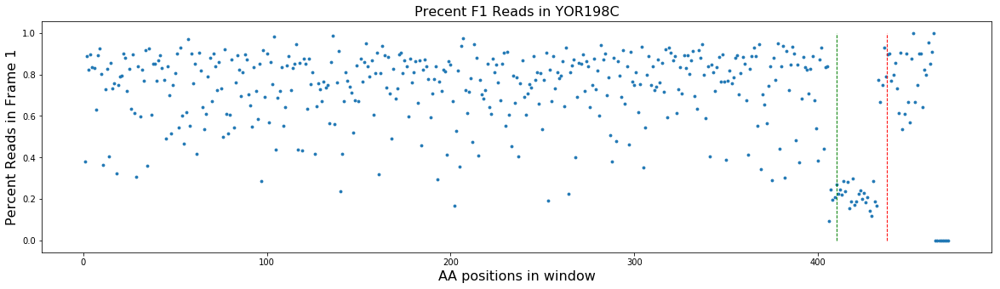

Simulated Percent: 0.4
150 209


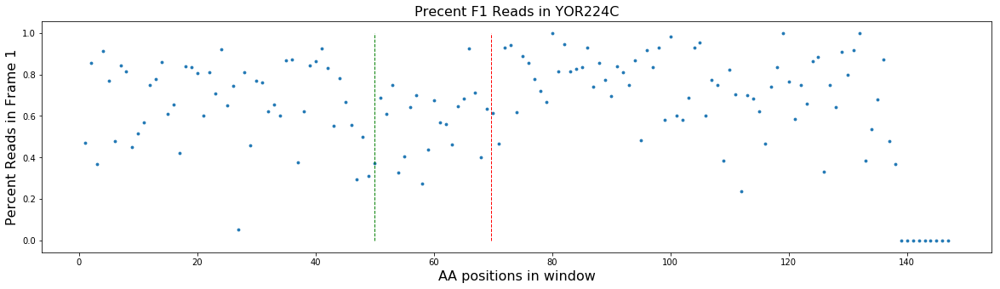

Simulated Percent: 0.3
207 257


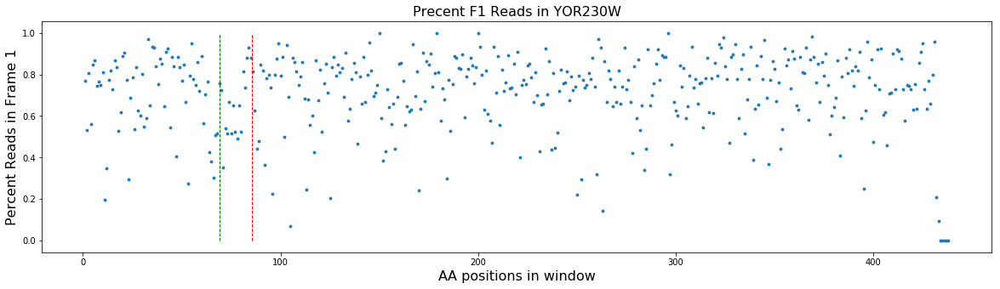

Simulated Percent: 0.3
528 616


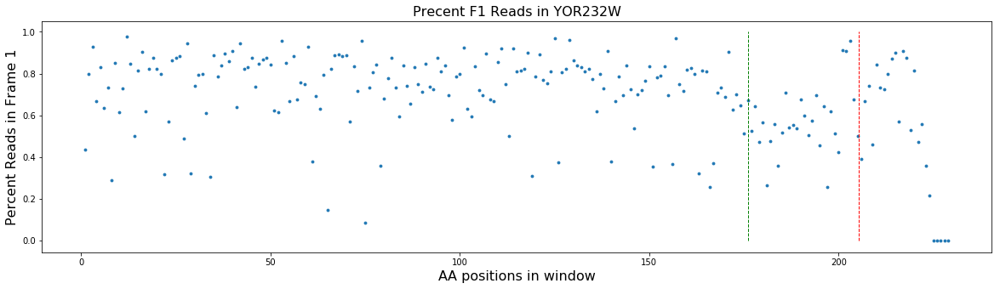

Simulated Percent: 0.6
453 511


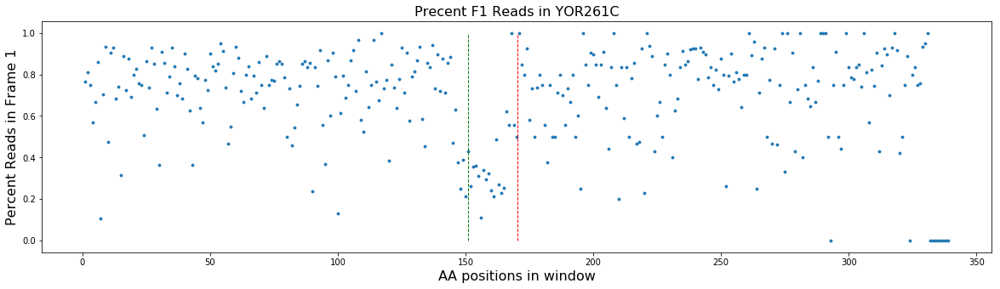

Simulated Percent: 0.9
165 220


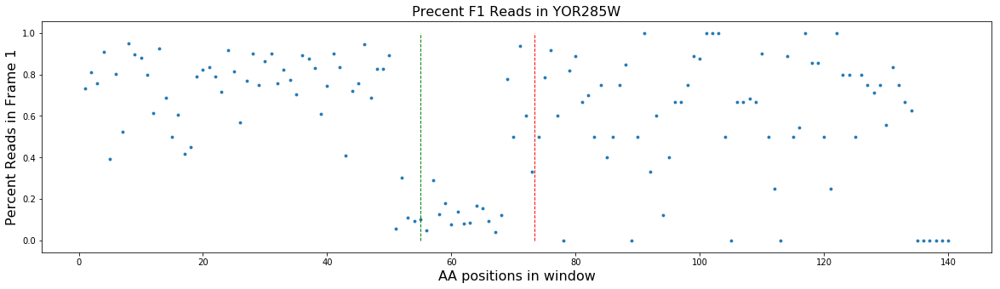

Simulated Percent: 0.7
273 328


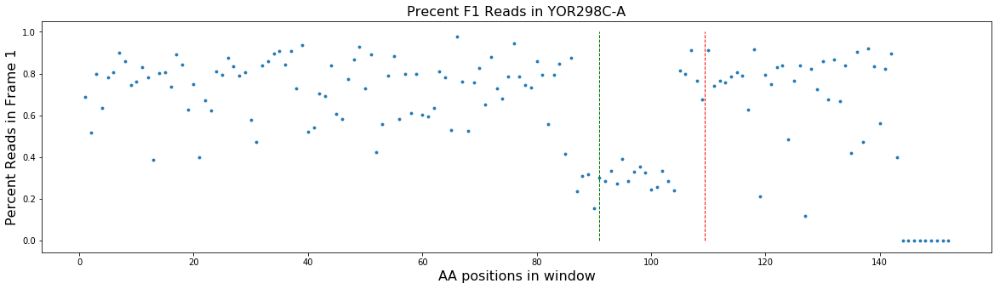

Simulated Percent: 0.7
1737 1816


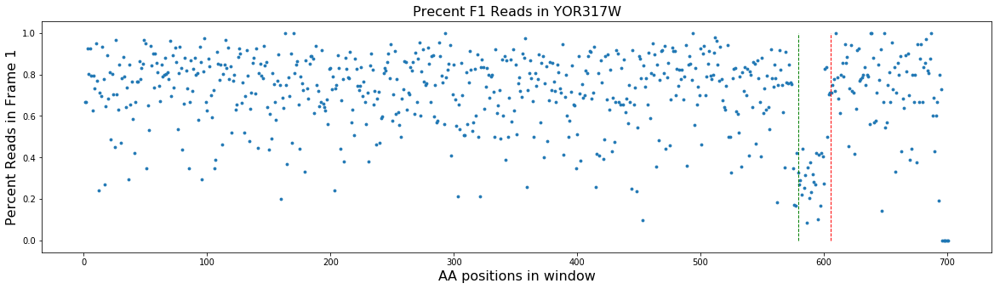

Simulated Percent: 0.3
1107 1157


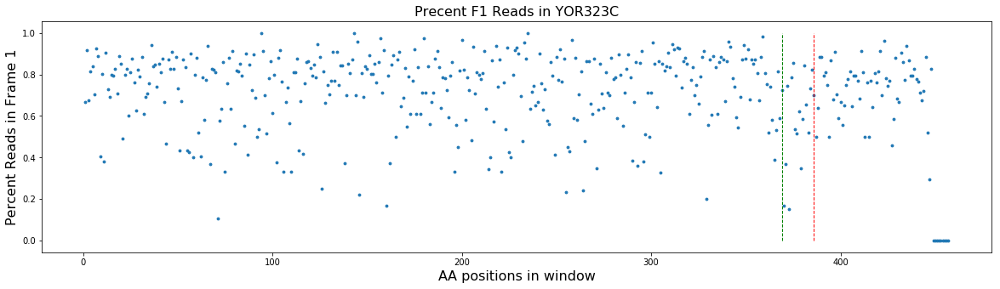

Simulated Percent: 0.1
192 265


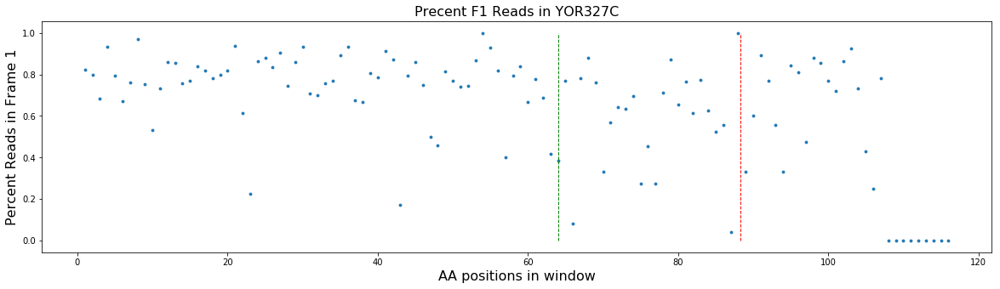

Simulated Percent: 0.05
264 320


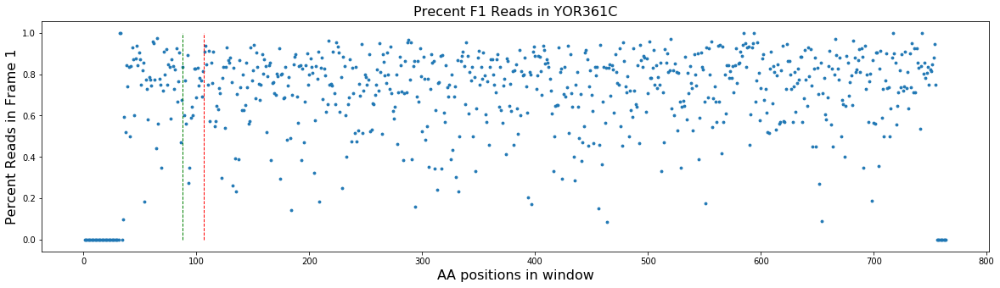

Simulated Percent: 0.6
459 535


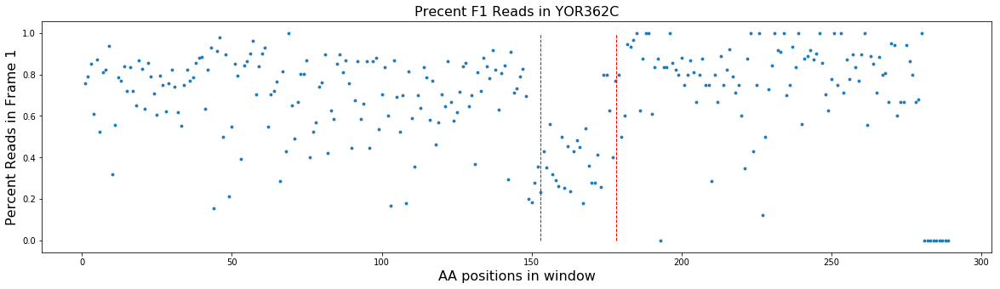

Simulated Percent: 0.6
54 125


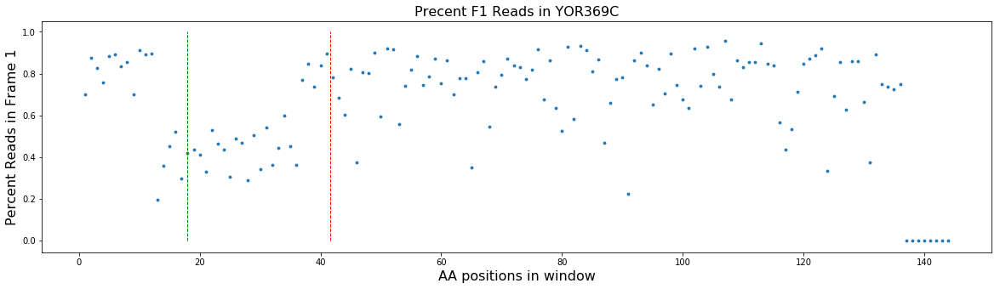

Simulated Percent: 0.3
999 1114


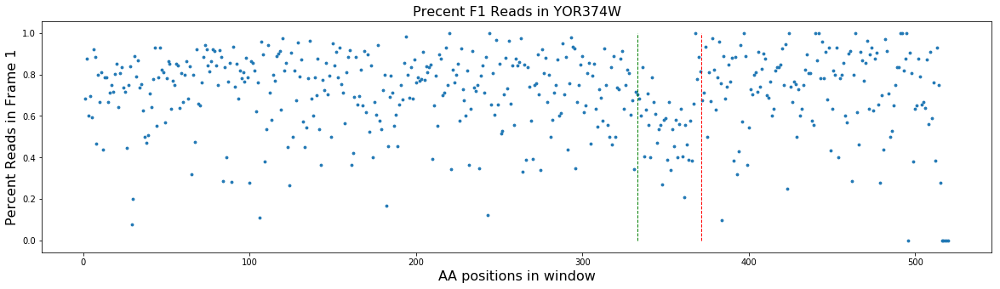

Simulated Percent: 0.2
375 431


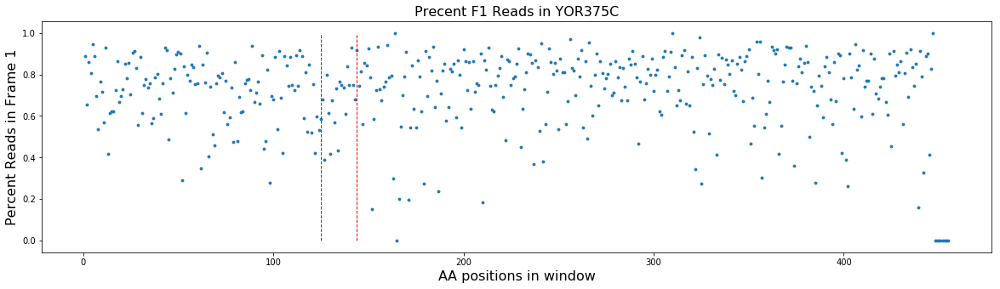

Simulated Percent: 0.3
1587 1675


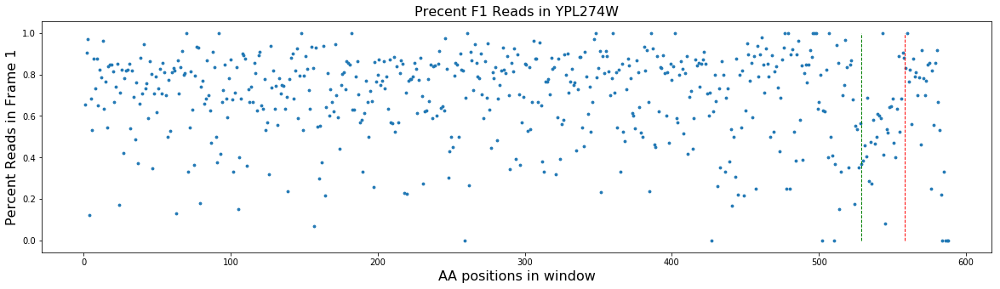

Simulated Percent: 0.6
81 178


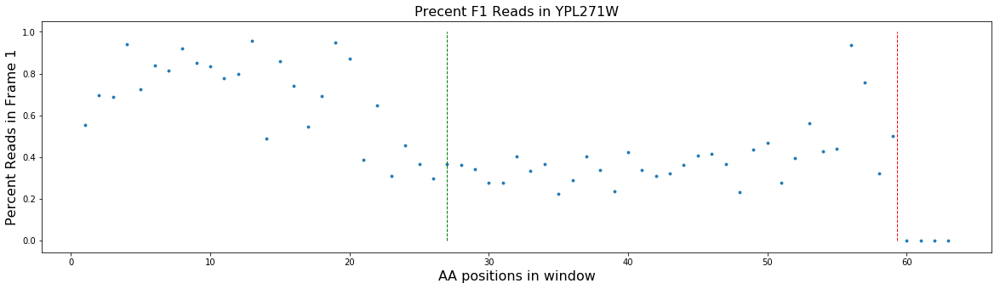

Simulated Percent: 0.7
264 331


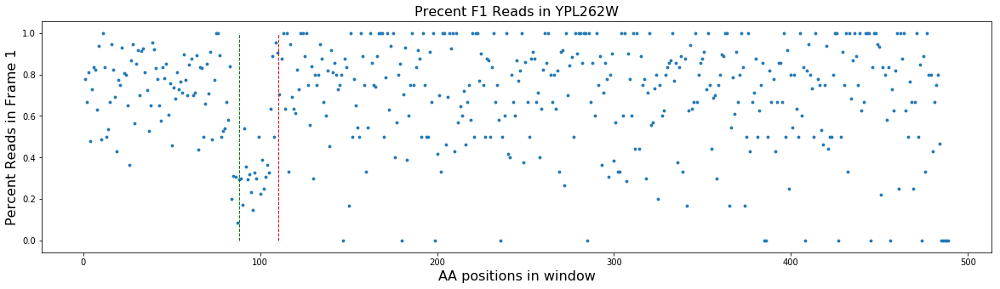

Simulated Percent: 0.1
348 488


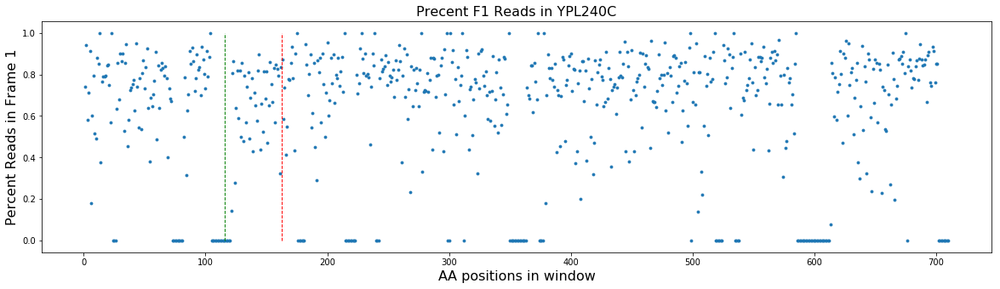

Simulated Percent: 0.6
63 142


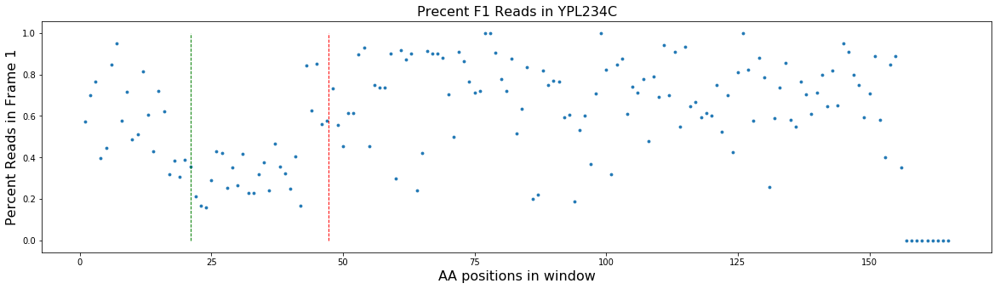

Simulated Percent: 0.5
144 325


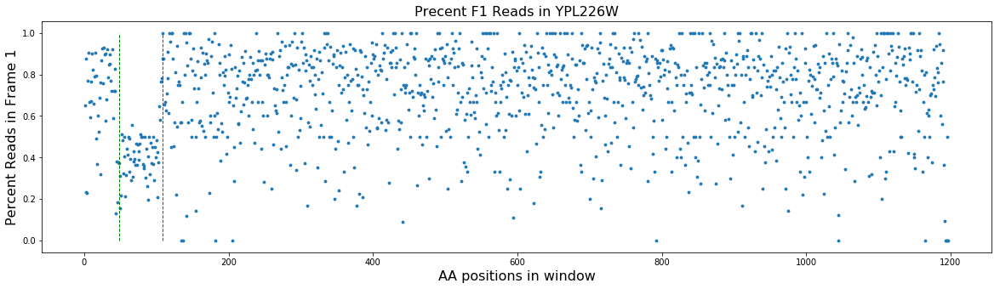

Simulated Percent: 0.3
207 275


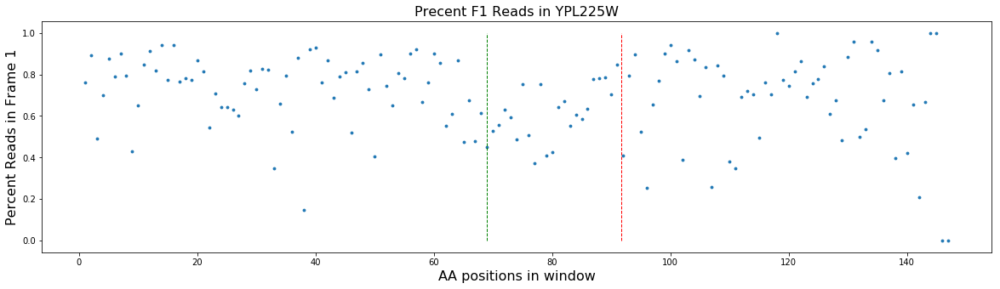

Simulated Percent: 0.1
210 268


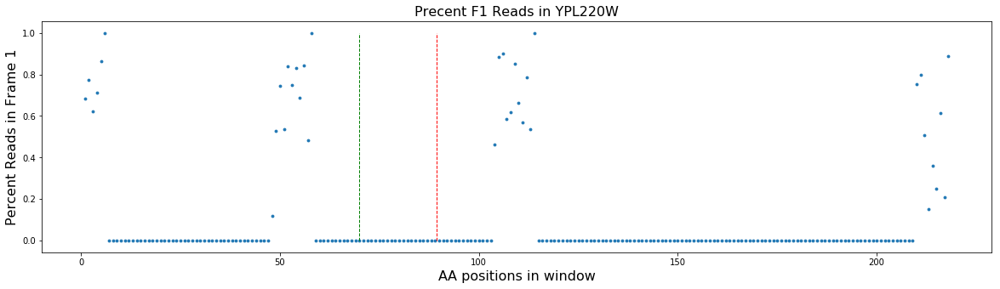

Simulated Percent: 0.4
399 497


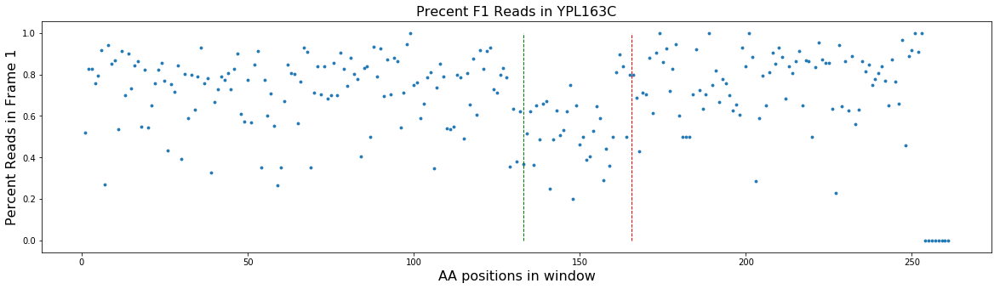

Simulated Percent: 0.6
1575 1717


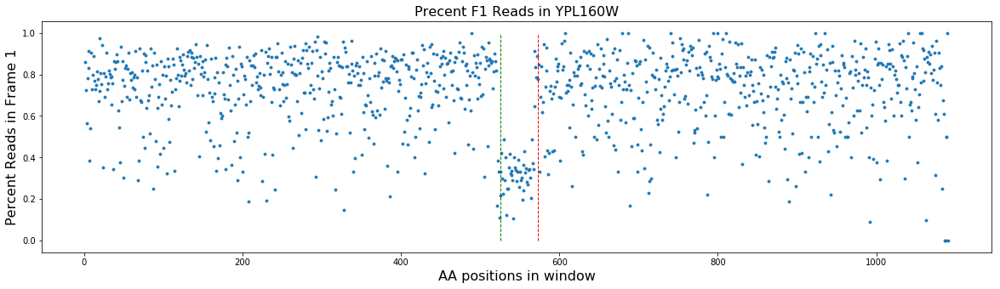

Simulated Percent: 0.2
621 829


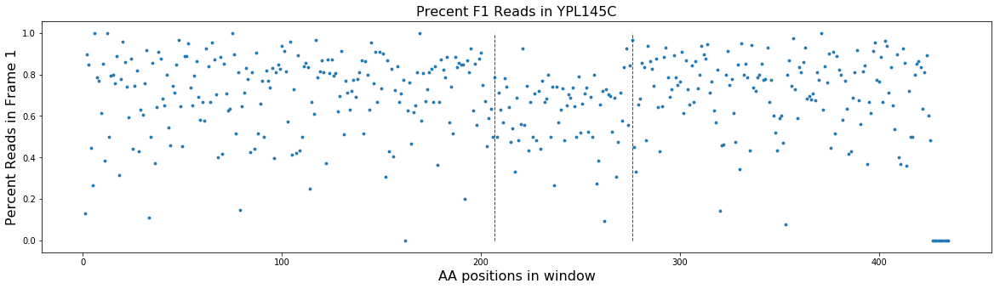

Simulated Percent: 0.3
513 569


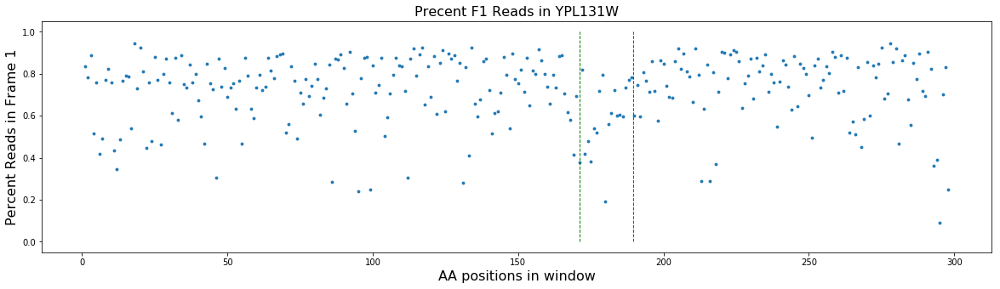

Simulated Percent: 0.8
228 280


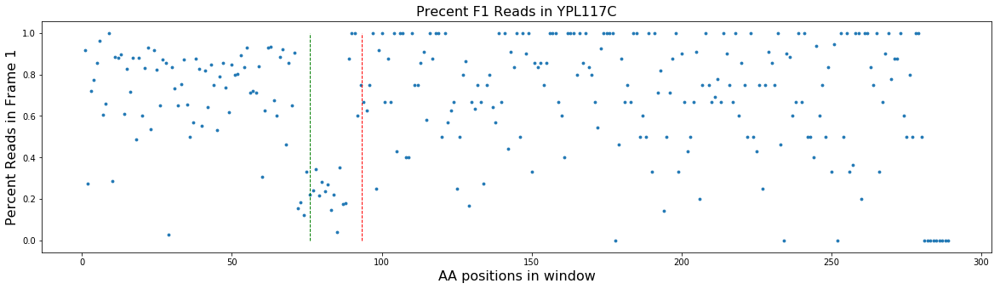

Simulated Percent: 0.1
558 611


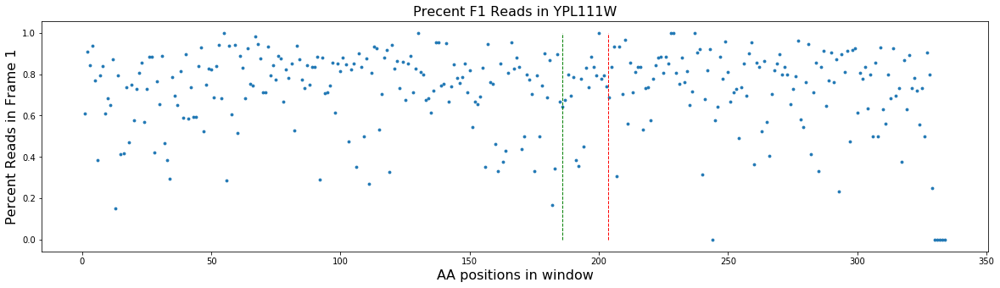

Simulated Percent: 0.9
33 146


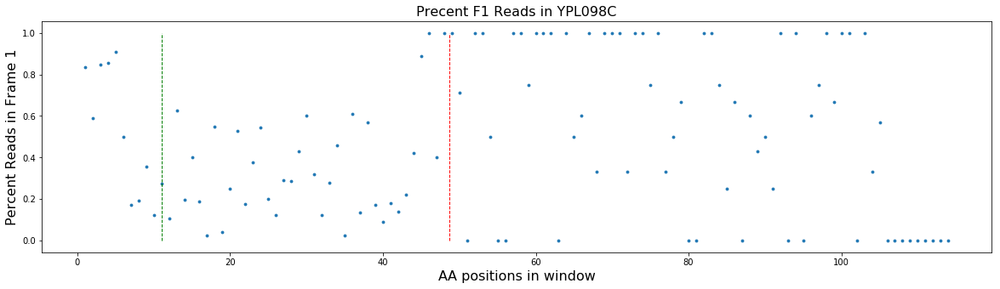

Simulated Percent: 0.1
561 634


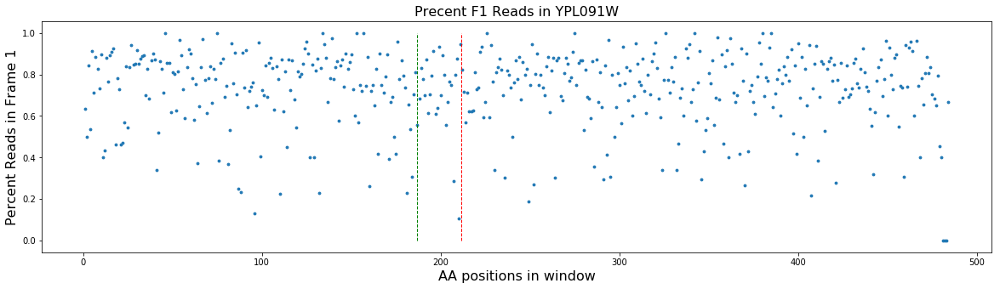

Simulated Percent: 0.4
633 727


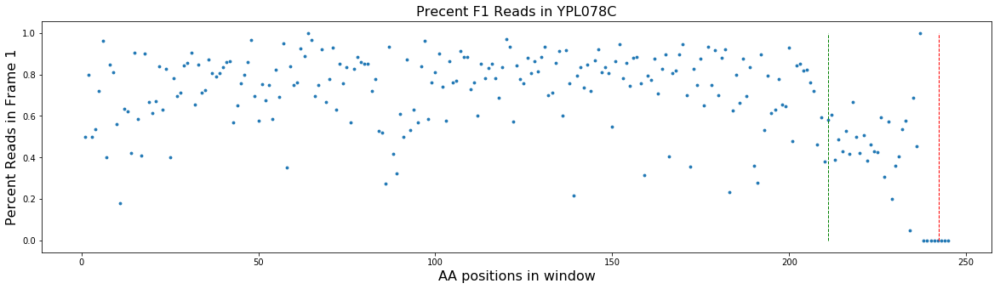

Simulated Percent: 0.2
351 434


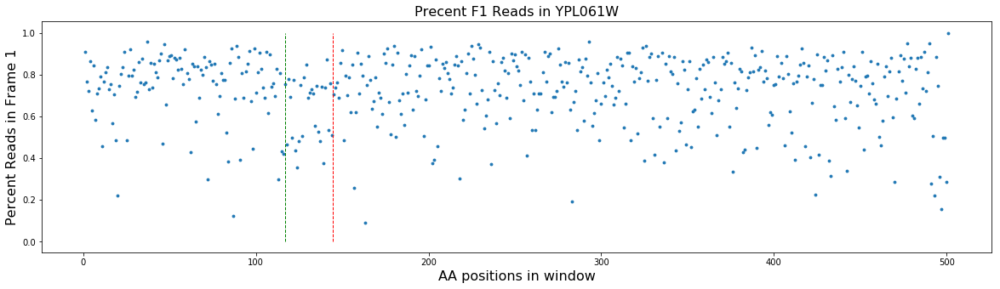

Simulated Percent: 0.1
1158 1240


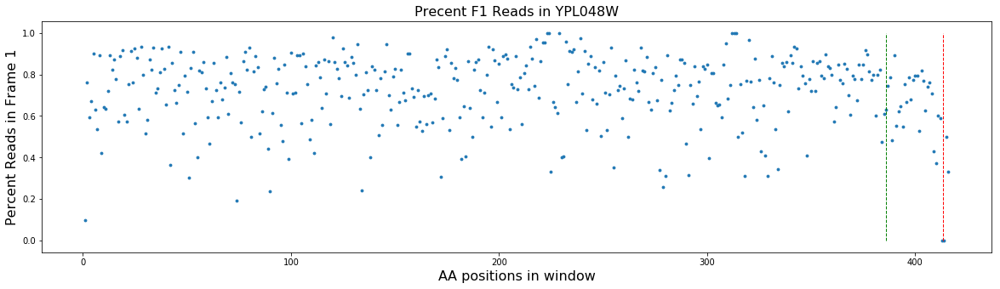

Simulated Percent: 0.3
294 436


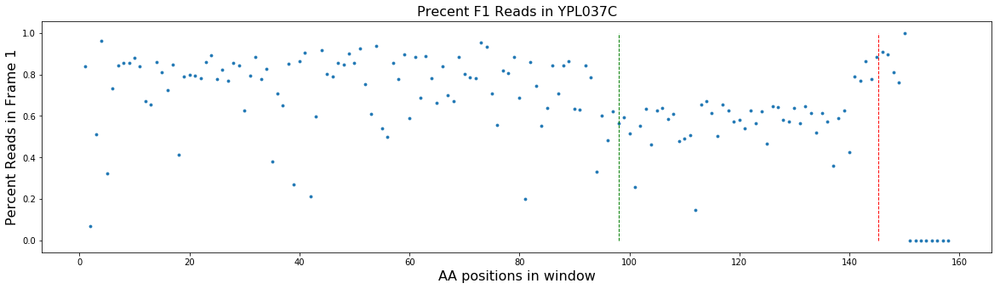

Simulated Percent: 0.2
591 694


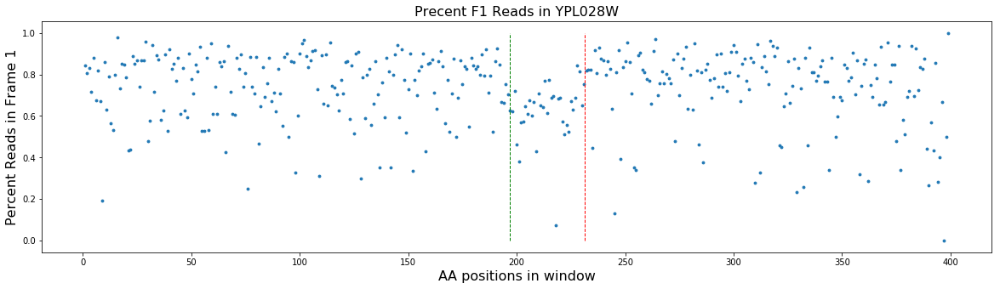

Simulated Percent: 0.05
426 490


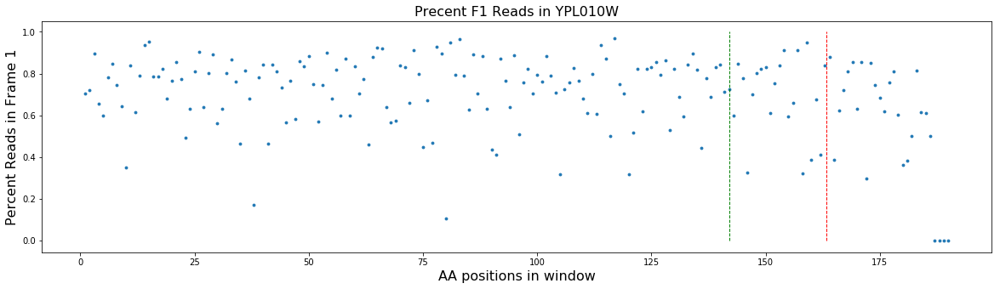

Simulated Percent: 0.8
126 184


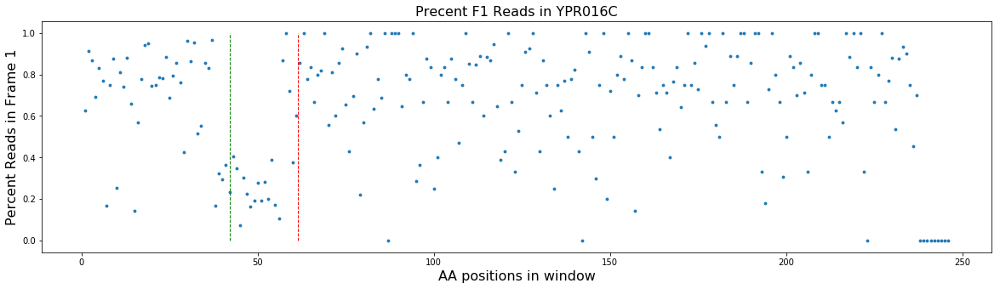

Simulated Percent: 0.2
327 388


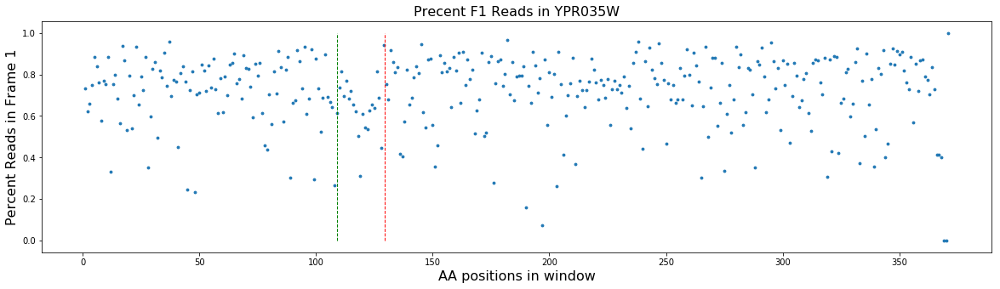

Simulated Percent: 0.05
1302 1360


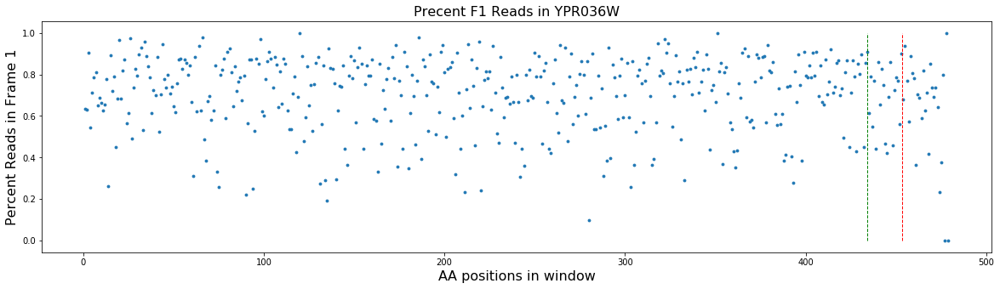

Simulated Percent: 0.9
33 115


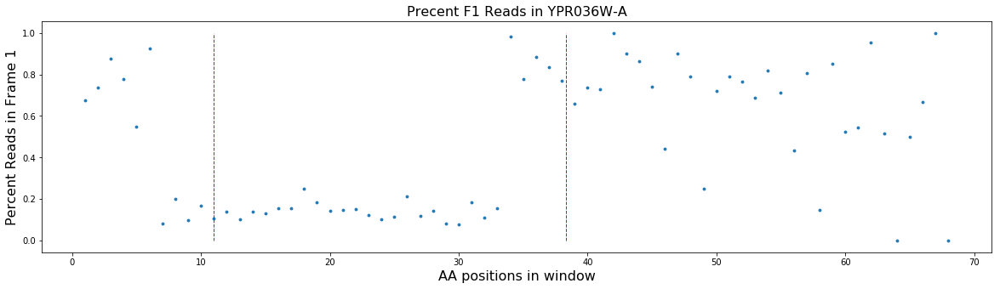

Simulated Percent: 0.3
1068 1121


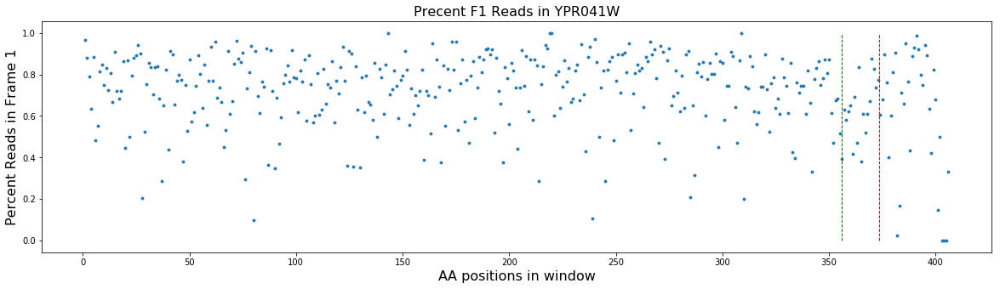

Simulated Percent: 0.05
276 421


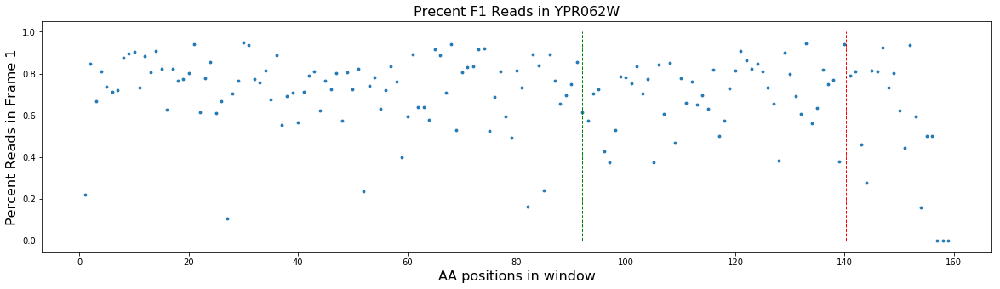

Simulated Percent: 0.7
1344 1459


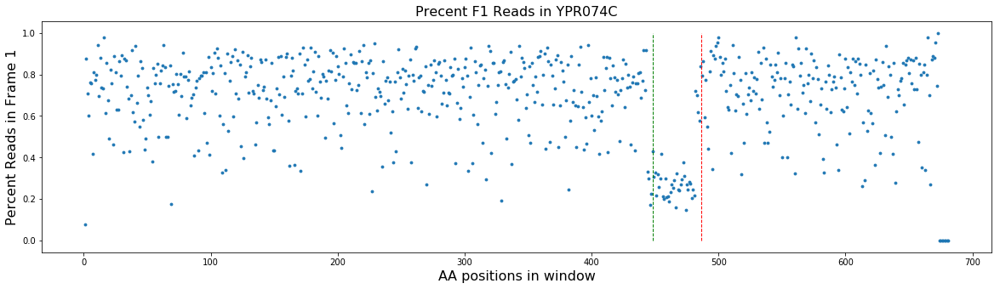

Simulated Percent: 0.5
912 1033


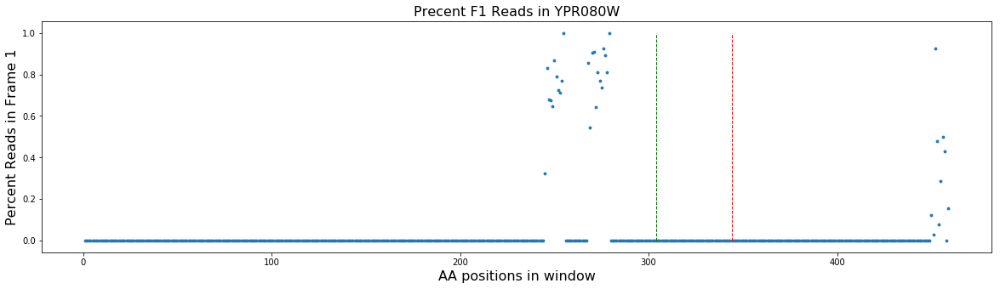

Simulated Percent: 0.8
129 250


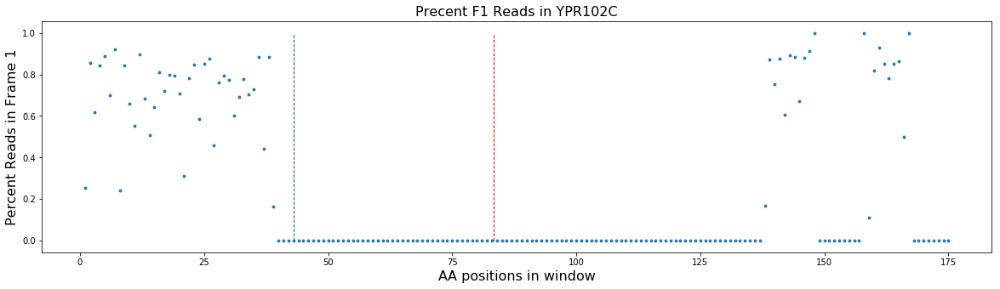

Simulated Percent: 0.2
738 791


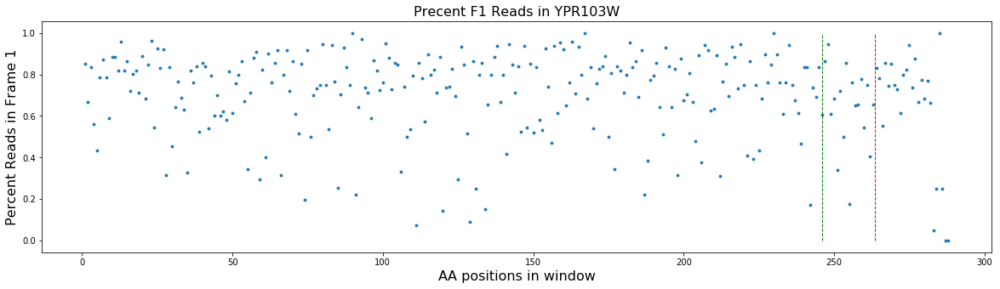

Simulated Percent: 0.9
594 661


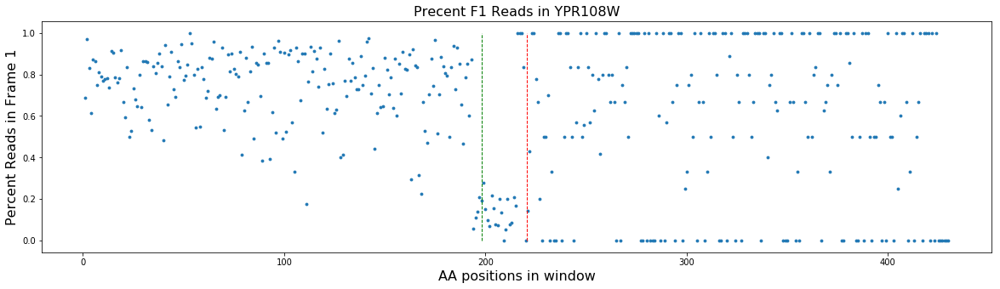

Simulated Percent: 0.3
648 838


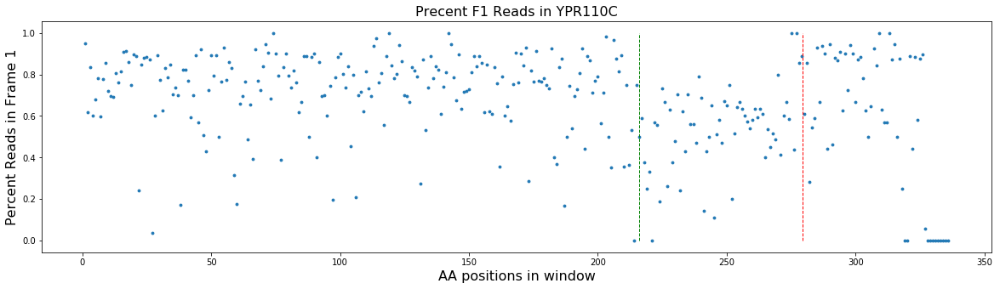

Simulated Percent: 0.7
465 544


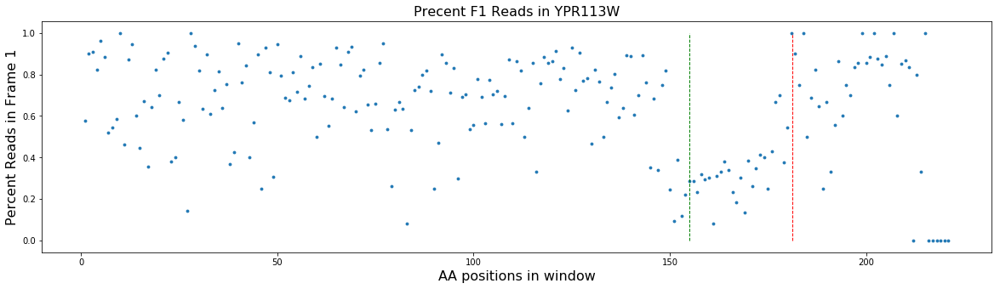

Simulated Percent: 0.8
108 185


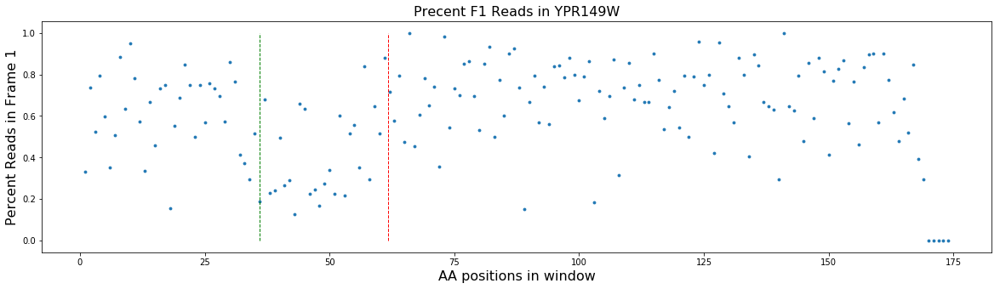

Simulated Percent: 0.4
1143 1264


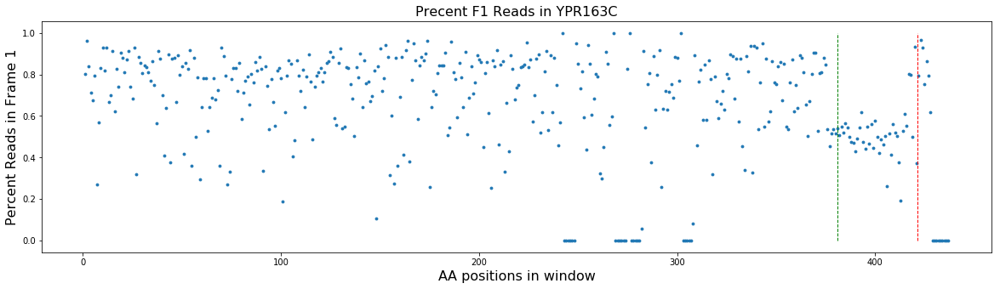

Simulated Percent: 0.4
36 118


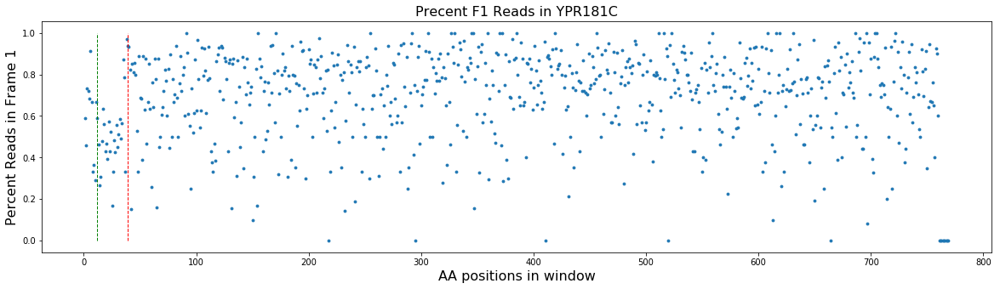

Simulated Percent: 0.4
264 386


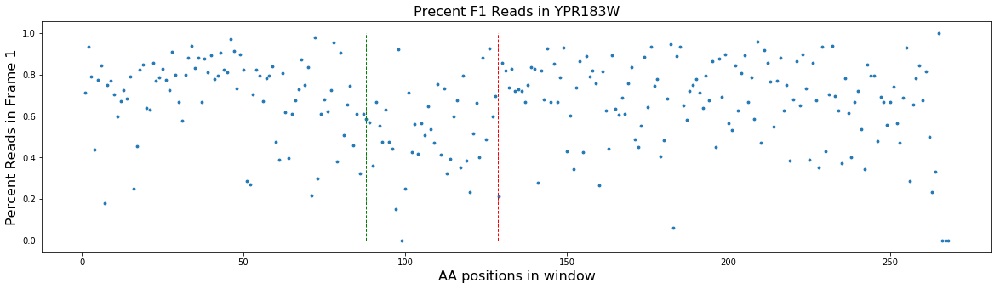

In [32]:
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib.pyplot import subplot


inFile = open("output/all_jan2014_25_to_32_starts_with_simulated_shifts_without_threshold_frameshifts", "r")

for line in inFile:
    Info_string = line.strip()
    percents = inFile.readline().rstrip("\n").split(",")
    percents = [float(x) for x in percents]
    blank = inFile.readline()
    gene_name = Info_string.split("\t")[0].split(" ")[1]
    
    if (gene_name in shift_info_dict):
        
        print("Simulated Percent: " + str(shift_info_dict[gene_name]["percent"]))
        xs = [i+1 for i in range(0,len(percents))]
        fig, ax = plt.subplots(figsize=(20, 5))
        plt.scatter(xs, percents, s=8)
        
        #plt.ylim(0.0, 1.0)
        real_start = shift_info_dict[gene_name]["shift_start"]/3
        plt.plot([real_start, real_start], [0.0, 1.0], '--', lw=1, c="green")
        real_end = shift_info_dict[gene_name]["shift_end"]/3
        plt.plot([real_end, real_end], [0.0, 1.0], '--', lw=1, c="red")
        print(str(shift_info_dict[gene_name]["shift_start"]) + " " + str(shift_info_dict[gene_name]["shift_end"]))
        #plt.plot([522, 522], [0.0, 1.0], '--', lw=1, c="red")
        ax.autoscale_view()
        plt.title('Precent F1 Reads in ' + gene_name,fontsize=16)
        plt.xlabel('AA positions in window',fontsize=16)
        plt.ylabel('Percent Reads in Frame 1',fontsize=16)
        plt.show()